In [127]:
import pandas as pd
from pathlib import Path
import zipfile
import os
import sqlite3
from datetime import datetime
import glob
from pprint import pprint
import praw
import pprint
import pandas as pd
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.util import ngrams
import string
import seaborn as sns
import matplotlib.pyplot as plt
from wordcloud import WordCloud
import spacy
import contractions
import re
from langdetect import detect
from langdetect.lang_detect_exception import LangDetectException
from collections import Counter
import gensim
from gensim import corpora
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import time
import gensim.downloader as api
from gensim.models.ldamodel import LdaModel
from sklearn.feature_extraction.text import CountVectorizer
from dateutil.parser import parse
from datetime import datetime
from pandas import json_normalize

In [183]:
df = pd.read_csv(r"C:\Users\PRAGYA\MSC Project\news\historical_news\news_052023_032024_042024.csv")
df['Date'] = pd.to_datetime(df['Date'])
df

,Title,Description,Date,Source,Topic
0,Marex cancels London listing,"Broker Marex has pulled its planned listing, r...",2021-09-06 00:00:00,Financial Times,Private equity
1,Gensler says SEC to review payment for order flow,The top US stock market regulator is looking t...,2021-09-06 00:00:00,Financial Times,US financial regulation
2,Global banking regulator urges toughest capita...,Global regulators are calling for cryptocurren...,2021-10-06 00:00:00,Financial Times,Cryptocurrencies
3,Bank of England orders Euroclear to bolster re...,The Bank of England has ordered Euroclear to i...,2021-06-25 00:00:00,Financial Times,Clearing & Settlement
4,Europe seeks to kick-start sluggish corporate ...,"Banks, regulators and fund managers are gearin...",2021-06-28 00:00:00,Financial Times,Corporate bonds
...,...,...,...,...,...
34635,"Snakelets, Lizards in Bihar’s Mid/Day Meals fo...","Amid the rise in such incidents, CNN/News18 sp...",2023-05-31 14:36:00,CNN,NaN
34636,'Badlav' Buzzword for 2024? Cong Banks on RaGa...,"As results of 2014 and 2019 poured in, the Con...",2023-05-31 14:35:00,CNN,NaN
34637,"The Curious Case of a Famous Sweets Shop, CM E...",The Shinde faction of Shiv Sena alleged that S...,2023-05-31 12:10:00,CNN,NaN
34638,Sick of Traffic Between IGI Airport & Mehrauli...,The five/kilometer road will not only offer an...,2023-05-31 10:21:00,CNN,NaN


In [184]:
df['Source'].unique()

array(['Financial Times', 'BBC', 'Sun', 'Mirror', 'Daily Mail',
       'Independent', 'Guardian', 'Telegraph', 'Manchester Evening News',
       'Sky News', 'Metro', 'Daily Express', 'Times', 'Liverpool Echo',
       'Birmingham Live', 'Evening Standard', nan, 'The New York Times',
       'CNN'], dtype=object)

In [185]:
df.rename(columns = {'Title':'headline','Topic':'category','Description':'short_description','Date':'date'},inplace=True)
df

,headline,short_description,date,Source,category
0,Marex cancels London listing,"Broker Marex has pulled its planned listing, r...",2021-09-06 00:00:00,Financial Times,Private equity
1,Gensler says SEC to review payment for order flow,The top US stock market regulator is looking t...,2021-09-06 00:00:00,Financial Times,US financial regulation
2,Global banking regulator urges toughest capita...,Global regulators are calling for cryptocurren...,2021-10-06 00:00:00,Financial Times,Cryptocurrencies
3,Bank of England orders Euroclear to bolster re...,The Bank of England has ordered Euroclear to i...,2021-06-25 00:00:00,Financial Times,Clearing & Settlement
4,Europe seeks to kick-start sluggish corporate ...,"Banks, regulators and fund managers are gearin...",2021-06-28 00:00:00,Financial Times,Corporate bonds
...,...,...,...,...,...
34635,"Snakelets, Lizards in Bihar’s Mid/Day Meals fo...","Amid the rise in such incidents, CNN/News18 sp...",2023-05-31 14:36:00,CNN,NaN
34636,'Badlav' Buzzword for 2024? Cong Banks on RaGa...,"As results of 2014 and 2019 poured in, the Con...",2023-05-31 14:35:00,CNN,NaN
34637,"The Curious Case of a Famous Sweets Shop, CM E...",The Shinde faction of Shiv Sena alleged that S...,2023-05-31 12:10:00,CNN,NaN
34638,Sick of Traffic Between IGI Airport & Mehrauli...,The five/kilometer road will not only offer an...,2023-05-31 10:21:00,CNN,NaN


In [186]:
news_json = pd.read_json(r'C:\Users\PRAGYA\MSC Project\news\historical_news\News_12-22_Dataset_v3.json',lines=True)
news_json

,link,headline,category,short_description,authors,date
0,https://www.huffpost.com/entry/covid-boosters-...,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,"Carla K. Johnson, AP",2022-09-23
1,https://www.huffpost.com/entry/american-airlin...,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,Mary Papenfuss,2022-09-23
2,https://www.huffpost.com/entry/funniest-tweets...,23 Of The Funniest Tweets About Cats And Dogs ...,COMEDY,"""Until you have a dog you don't understand wha...",Elyse Wanshel,2022-09-23
3,https://www.huffpost.com/entry/funniest-parent...,The Funniest Tweets From Parents This Week (Se...,PARENTING,"""Accidentally put grown-up toothpaste on my to...",Caroline Bologna,2022-09-23
4,https://www.huffpost.com/entry/amy-cooper-lose...,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,Nina Golgowski,2022-09-22
...,...,...,...,...,...,...
209522,https://www.huffingtonpost.com/entry/rim-ceo-t...,RIM CEO Thorsten Heins' 'Significant' Plans Fo...,TECH,Verizon Wireless and AT&T are already promotin...,"Reuters, Reuters",2012-01-28
209523,https://www.huffingtonpost.com/entry/maria-sha...,Maria Sharapova Stunned By Victoria Azarenka I...,SPORTS,"Afterward, Azarenka, more effusive with the pr...",,2012-01-28
209524,https://www.huffingtonpost.com/entry/super-bow...,"Giants Over Patriots, Jets Over Colts Among M...",SPORTS,"Leading up to Super Bowl XLVI, the most talked...",,2012-01-28
209525,https://www.huffingtonpost.com/entry/aldon-smi...,Aldon Smith Arrested: 49ers Linebacker Busted ...,SPORTS,CORRECTION: An earlier version of this story i...,,2012-01-28


In [187]:
news_json['category'].unique()

array(['U.S. NEWS', 'COMEDY', 'PARENTING', 'WORLD NEWS', 'CULTURE & ARTS',
       'TECH', 'SPORTS', 'ENTERTAINMENT', 'POLITICS', 'WEIRD NEWS',
       'ENVIRONMENT', 'EDUCATION', 'CRIME', 'SCIENCE', 'WELLNESS',
       'BUSINESS', 'STYLE & BEAUTY', 'FOOD & DRINK', 'MEDIA',
       'QUEER VOICES', 'HOME & LIVING', 'WOMEN', 'BLACK VOICES', 'TRAVEL',
       'MONEY', 'RELIGION', 'LATINO VOICES', 'IMPACT', 'WEDDINGS',
       'COLLEGE', 'PARENTS', 'ARTS & CULTURE', 'STYLE', 'GREEN', 'TASTE',
       'HEALTHY LIVING', 'THE WORLDPOST', 'GOOD NEWS', 'WORLDPOST',
       'FIFTY', 'ARTS', 'DIVORCE'], dtype=object)

In [188]:
news_json[news_json['category'] == 'WEIRD NEWS']['headline']

29        'French Spider-Man' Celebrates 60th Birthday W...
38        German Customs Officials Follow Trail Of Slime...
154       A Fisherman Thought He Caught A Rock. He Snagg...
159       FINISH HIM: Fighting Kangaroo Pulls Wild Move ...
239       Feathers Fly As Wild Turkey Dodges Cops In Sla...
                                ...                        
133464    10 Surprising History Facts That Will Warp You...
133465                                          LEFT TO DIE
133473    Gulag-Themed Holidays Are All the Rage in Sunn...
133505    This Cruise Ship From Hell Will Make You Wish ...
133537    Tailgating Cabbie Dodges Bridge Toll 3,000 Tim...
Name: headline, Length: 2777, dtype: object

In [189]:
news_json[news_json['category'] == 'FIFTY']['headline'].iloc[1000]

'I Hope We Recognize Each Other'

In [190]:
news_column = ['U.S. NEWS',  'WORLD NEWS',
       'TECH', 'POLITICS', 'WEIRD NEWS',
       'ENVIRONMENT', 'EDUCATION', 'CRIME', 'SCIENCE', 
       'BUSINESS', 'MEDIA',
        'WOMEN', 'BLACK VOICES', 'TRAVEL',
       'MONEY', 'RELIGION',  'IMPACT', 
       'HEALTHY LIVING', 'THE WORLDPOST', 'GOOD NEWS', 'WORLDPOST']

In [191]:
filtered_df = news_json[news_json['category'].isin(news_column)][['headline','category','short_description','date']]
filtered_df['Source'] = 'HuffPost'
filtered_df['date'] = pd.to_datetime(filtered_df['date'])
filtered_df

,headline,category,short_description,date,Source
0,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,2022-09-23,HuffPost
1,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,2022-09-23,HuffPost
4,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,2022-09-22,HuffPost
5,Cleaner Was Dead In Belk Bathroom For 4 Days B...,U.S. NEWS,The 63-year-old woman was seen working at the ...,2022-09-22,HuffPost
6,Reporter Gets Adorable Surprise From Her Boyfr...,U.S. NEWS,"""Who's that behind you?"" an anchor for New Yor...",2022-09-22,HuffPost
...,...,...,...,...,...
209518,Google+ Now Open for Teens With Some Safeguards,TECH,"For the most part, teens' experience on Google...",2012-01-28,HuffPost
209519,Web Wars,TECH,"These ""Web Wars"" threaten to rage on for some ...",2012-01-28,HuffPost
209520,"First White House Chief Technology Officer, An...",TECH,He was appointed with a fair bit of fanfare as...,2012-01-28,HuffPost
209521,Watch The Top 9 YouTube Videos Of The Week,TECH,If you're looking to see the most popular YouT...,2012-01-28,HuffPost


In [192]:
combined_df = pd.concat([filtered_df, df], axis=0)
combined_df

,headline,category,short_description,date,Source
0,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,2022-09-23 00:00:00,HuffPost
1,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,2022-09-23 00:00:00,HuffPost
4,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,2022-09-22 00:00:00,HuffPost
5,Cleaner Was Dead In Belk Bathroom For 4 Days B...,U.S. NEWS,The 63-year-old woman was seen working at the ...,2022-09-22 00:00:00,HuffPost
6,Reporter Gets Adorable Surprise From Her Boyfr...,U.S. NEWS,"""Who's that behind you?"" an anchor for New Yor...",2022-09-22 00:00:00,HuffPost
...,...,...,...,...,...
34635,"Snakelets, Lizards in Bihar’s Mid/Day Meals fo...",NaN,"Amid the rise in such incidents, CNN/News18 sp...",2023-05-31 14:36:00,CNN
34636,'Badlav' Buzzword for 2024? Cong Banks on RaGa...,NaN,"As results of 2014 and 2019 poured in, the Con...",2023-05-31 14:35:00,CNN
34637,"The Curious Case of a Famous Sweets Shop, CM E...",NaN,The Shinde faction of Shiv Sena alleged that S...,2023-05-31 12:10:00,CNN
34638,Sick of Traffic Between IGI Airport & Mehrauli...,NaN,The five/kilometer road will not only offer an...,2023-05-31 10:21:00,CNN


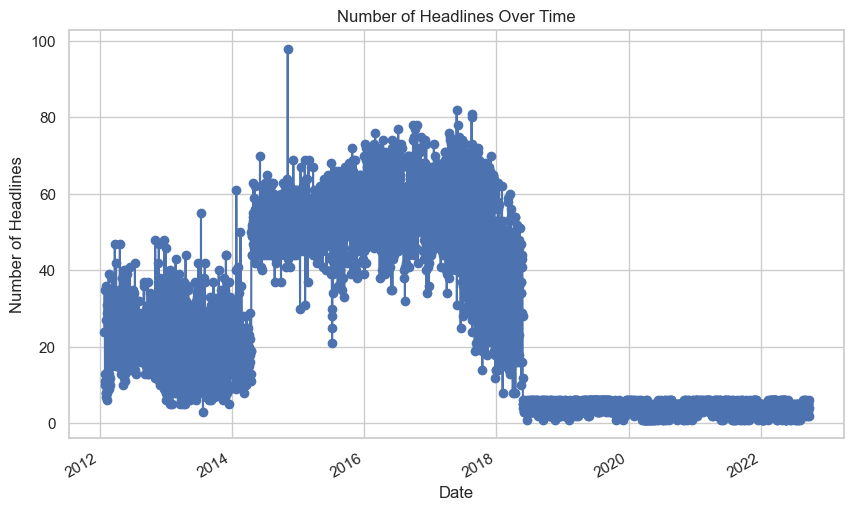

In [193]:
plt.figure(figsize=(10, 6))
filtered_df.groupby('date').size().plot(kind='line', marker='o')
plt.title('Number of Headlines Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Headlines')
plt.grid(True)
plt.show()


# Top 10 categories

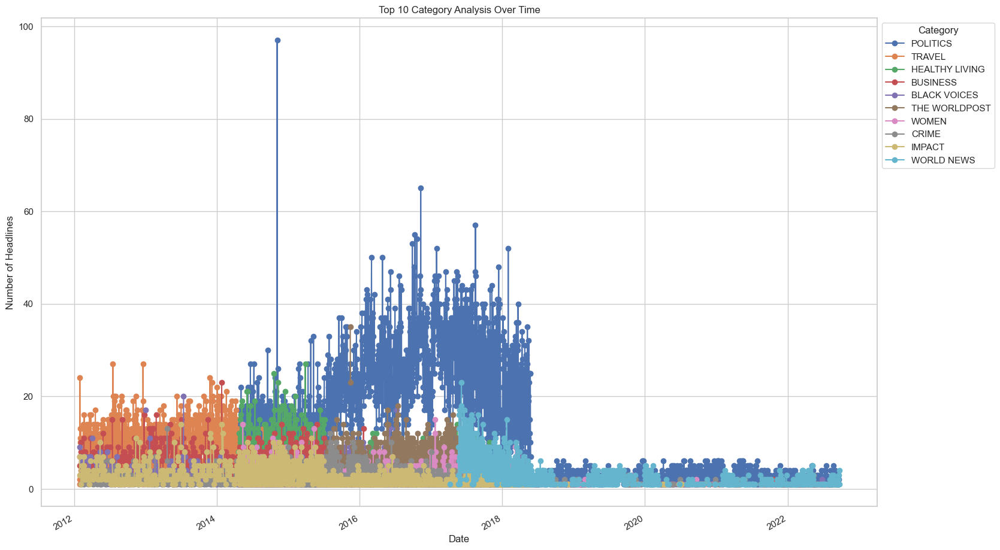

In [194]:
# Identify top 10 categories
top_categories = combined_df['category'].value_counts().head(10).index

# Filter the DataFrame to include only the top 10 categories
cat_df = combined_df[combined_df['category'].isin(top_categories)]

# Create a category order based on frequency
category_order = combined_df['category'].value_counts().loc[top_categories].index

# Plotting the top 10 categories over time
plt.figure(figsize=(18, 12))

# Plot with ordered categories
plot_data = cat_df.groupby(['date', 'category']).size().unstack().reindex(columns=category_order)
plot_data.plot(kind='line', marker='o', ax=plt.gca())

plt.title('Top 10 Category Analysis Over Time')
plt.xlabel('Date')
plt.ylabel('Number of Headlines')
plt.legend(title='Category', loc='upper left', bbox_to_anchor=(1, 1))  # Adjust legend position
plt.grid(True)
plt.show()

In [195]:
nlp = spacy.load("en_core_web_sm")

In [196]:
# Get the current date and time
processing_date = datetime.now().strftime('%Y-%m-%d %H:%M:%S')

In [197]:
# combined_df = pd.concat([combined_df, bloom_df])
combined_df.to_csv(r'C:\Users\PRAGYA\MSC Project\news\combined_news_latest.csv')  

# Print the combined dataframe
combined_df

,headline,category,short_description,date,Source
0,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,2022-09-23 00:00:00,HuffPost
1,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,2022-09-23 00:00:00,HuffPost
4,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,2022-09-22 00:00:00,HuffPost
5,Cleaner Was Dead In Belk Bathroom For 4 Days B...,U.S. NEWS,The 63-year-old woman was seen working at the ...,2022-09-22 00:00:00,HuffPost
6,Reporter Gets Adorable Surprise From Her Boyfr...,U.S. NEWS,"""Who's that behind you?"" an anchor for New Yor...",2022-09-22 00:00:00,HuffPost
...,...,...,...,...,...
34635,"Snakelets, Lizards in Bihar’s Mid/Day Meals fo...",NaN,"Amid the rise in such incidents, CNN/News18 sp...",2023-05-31 14:36:00,CNN
34636,'Badlav' Buzzword for 2024? Cong Banks on RaGa...,NaN,"As results of 2014 and 2019 poured in, the Con...",2023-05-31 14:35:00,CNN
34637,"The Curious Case of a Famous Sweets Shop, CM E...",NaN,The Shinde faction of Shiv Sena alleged that S...,2023-05-31 12:10:00,CNN
34638,Sick of Traffic Between IGI Airport & Mehrauli...,NaN,The five/kilometer road will not only offer an...,2023-05-31 10:21:00,CNN


In [198]:
# combined_df = pd.read_csv(r'C:\Users\PRAGYA\MSC Project\news\combined_news_latest - Copy.csv')  
# combined_df['date'] = pd.to_datetime(combined_df['date'])
# combined_df

In [199]:
# Remove stop words
stop_words = set(stopwords.words('english'))
stop_words

{'a',
 'about',
 'above',
 'after',
 'again',
 'against',
 'ain',
 'all',
 'am',
 'an',
 'and',
 'any',
 'are',
 'aren',
 "aren't",
 'as',
 'at',
 'be',
 'because',
 'been',
 'before',
 'being',
 'below',
 'between',
 'both',
 'but',
 'by',
 'can',
 'couldn',
 "couldn't",
 'd',
 'did',
 'didn',
 "didn't",
 'do',
 'does',
 'doesn',
 "doesn't",
 'doing',
 'don',
 "don't",
 'down',
 'during',
 'each',
 'few',
 'for',
 'from',
 'further',
 'had',
 'hadn',
 "hadn't",
 'has',
 'hasn',
 "hasn't",
 'have',
 'haven',
 "haven't",
 'having',
 'he',
 'her',
 'here',
 'hers',
 'herself',
 'him',
 'himself',
 'his',
 'how',
 'i',
 'if',
 'in',
 'into',
 'is',
 'isn',
 "isn't",
 'it',
 "it's",
 'its',
 'itself',
 'just',
 'll',
 'm',
 'ma',
 'me',
 'mightn',
 "mightn't",
 'more',
 'most',
 'mustn',
 "mustn't",
 'my',
 'myself',
 'needn',
 "needn't",
 'no',
 'nor',
 'not',
 'now',
 'o',
 'of',
 'off',
 'on',
 'once',
 'only',
 'or',
 'other',
 'our',
 'ours',
 'ourselves',
 'out',
 'over',
 'own',
 'r

In [200]:
add_words = {'news','read','story','world','newsbrief','huffpost','short',
            'wrapup'}
# Combine stopwords, negative words, and additional custom stop words
stop_words = stop_words.union(add_words)
stop_words

{'a',
 'about',
 'above',
 'after',
 'again',
 'against',
 'ain',
 'all',
 'am',
 'an',
 'and',
 'any',
 'are',
 'aren',
 "aren't",
 'as',
 'at',
 'be',
 'because',
 'been',
 'before',
 'being',
 'below',
 'between',
 'both',
 'but',
 'by',
 'can',
 'couldn',
 "couldn't",
 'd',
 'did',
 'didn',
 "didn't",
 'do',
 'does',
 'doesn',
 "doesn't",
 'doing',
 'don',
 "don't",
 'down',
 'during',
 'each',
 'few',
 'for',
 'from',
 'further',
 'had',
 'hadn',
 "hadn't",
 'has',
 'hasn',
 "hasn't",
 'have',
 'haven',
 "haven't",
 'having',
 'he',
 'her',
 'here',
 'hers',
 'herself',
 'him',
 'himself',
 'his',
 'how',
 'huffpost',
 'i',
 'if',
 'in',
 'into',
 'is',
 'isn',
 "isn't",
 'it',
 "it's",
 'its',
 'itself',
 'just',
 'll',
 'm',
 'ma',
 'me',
 'mightn',
 "mightn't",
 'more',
 'most',
 'mustn',
 "mustn't",
 'my',
 'myself',
 'needn',
 "needn't",
 'news',
 'newsbrief',
 'no',
 'nor',
 'not',
 'now',
 'o',
 'of',
 'off',
 'on',
 'once',
 'only',
 'or',
 'other',
 'our',
 'ours',
 'ours

In [201]:
# keep_words = { 'about',
#  'above',
#  'after',
#  'again',
#  'against','because','few', 'most','no','not',
#  'now',
#     'not', 'no', 'none', 'never', 'nobody', 'nothing', 'neither', 'nowhere',
#     'cannot', 'can\'t', 'won\'t', 'don\'t', 'doesn\'t', 'didn\'t', 'isn\'t', 'aren\'t', 'wasn’t', 'weren’t', 'hasn’t', 'haven’t', 'hadn’t', 
#     'couldn’t', 'shouldn’t', 'wouldn’t', 'mightn’t', 'mustn’t','hasn\'t', 'hasn\'','hadn\'t', 'hadn\'',
# }
# Filter stopwords to keep only the negative words
# keep_words = {}
# stop_words =stop_words - keep_words
# stop_words

# Function to clean text

In [202]:
import pandas as pd
import re
import string
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer

# Download required NLTK resources
import nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\PRAGYA\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\PRAGYA\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\PRAGYA\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [203]:
# List of specific phrases to remove
phrases_to_remove = [
    'new york city', 
    'new york times', 
    'rise morning',
    'huffpost rise morning newsbrief', 
    'morning newsbrief short wrapup',
    'welcome to the huffPost rise Morning Newsbrief',
    'a short wrap-up of the news to help you start your day',
    'welcome huffpost rise morning newsbrief short wrapup help start day',
    'HuffPost Rise What You Need To Know On',
]

In [204]:
combined_df['Source'].fillna('OtherSources', inplace=True)

In [205]:
news_source_words = combined_df['Source'].unique()
phrases_to_remove.extend(news_source_words)
phrases_to_remove

['new york city',
 'new york times',
 'rise morning',
 'huffpost rise morning newsbrief',
 'morning newsbrief short wrapup',
 'welcome to the huffPost rise Morning Newsbrief',
 'a short wrap-up of the news to help you start your day',
 'welcome huffpost rise morning newsbrief short wrapup help start day',
 'HuffPost Rise What You Need To Know On',
 'HuffPost',
 'Financial Times',
 'BBC',
 'Sun',
 'Mirror',
 'Daily Mail',
 'Independent',
 'Guardian',
 'Telegraph',
 'Manchester Evening News',
 'Sky News',
 'Metro',
 'Daily Express',
 'Times',
 'Liverpool Echo',
 'Birmingham Live',
 'Evening Standard',
 'OtherSources',
 'The New York Times',
 'CNN']

In [206]:
# Function to clean text
def clean_text(text):
    if not isinstance(text, str):
        return ""

    # Contractions expansion
    try:
        text = contractions.fix(text)
    except:
        print(text)
    
    # 1. Convert text to lowercase
    text = text.lower()

    # 2. Remove URLs
    text = re.sub(r'http\S+|www\S+|https\S+', '', text, flags=re.MULTILINE)

    # 3. Remove HTML tags
    text = re.sub(r'<.*?>', '', text)

    # 4. Remove punctuation
    text = text.translate(str.maketrans('', '', string.punctuation))

    # 5. Remove numbers
    text = re.sub(r'\d+', '', text)
    # 5.0 Remove non-alphanumeric characters (except spaces)
    text = re.sub(r'[^\w\s]', '', text)
    text = re.sub('[\?|$|.|!-/,]',"", text)
    
    # 5.1. Remove specific phrases
    for phrase in phrases_to_remove:
        text = re.sub(re.escape(phrase.lower()), '', text)

    # 6. Tokenize text
    tokens = word_tokenize(text)

    # 7. Remove stopwords
    tokens = [word for word in tokens if word not in stop_words]

    # 8. Lemmatize words
    lemmatizer = WordNetLemmatizer()
    tokens = [lemmatizer.lemmatize(word) for word in tokens]

    # 9. Remove special characters 
    tokens = [re.sub(r'\W+', '', word) for word in tokens]
    
    # Remove single alphabet characters
    tokens = [word for word in tokens if len(word) > 1 and word.isalpha()]

    # 10. Remove extra whitespace and join tokens back into a single string
    cleaned_text = ' '.join(tokens).strip()

    return cleaned_text

In [152]:
# print(combined_df['short_description'].iloc[2])
# clean_text(combined_df['short_description'].iloc[2])

In [207]:
clean_text('i am not a data researcher but a americans american scientist this news is from huffpost not a story 213 @/ wrapup')

'data researcher american american scientist'

# Combine all news on day Level

In [208]:
combined_df['combined'] = combined_df['headline'] + combined_df['short_description']
combined_df.head()

,headline,category,short_description,date,Source,combined
0,Over 4 Million Americans Roll Up Sleeves For O...,U.S. NEWS,Health experts said it is too early to predict...,2022-09-23,HuffPost,Over 4 Million Americans Roll Up Sleeves For O...
1,"American Airlines Flyer Charged, Banned For Li...",U.S. NEWS,He was subdued by passengers and crew when he ...,2022-09-23,HuffPost,"American Airlines Flyer Charged, Banned For Li..."
4,Woman Who Called Cops On Black Bird-Watcher Lo...,U.S. NEWS,Amy Cooper accused investment firm Franklin Te...,2022-09-22,HuffPost,Woman Who Called Cops On Black Bird-Watcher Lo...
5,Cleaner Was Dead In Belk Bathroom For 4 Days B...,U.S. NEWS,The 63-year-old woman was seen working at the ...,2022-09-22,HuffPost,Cleaner Was Dead In Belk Bathroom For 4 Days B...
6,Reporter Gets Adorable Surprise From Her Boyfr...,U.S. NEWS,"""Who's that behind you?"" an anchor for New Yor...",2022-09-22,HuffPost,Reporter Gets Adorable Surprise From Her Boyfr...


In [209]:
combined_df['combined'] = combined_df['combined'].fillna('').astype(str)

In [210]:
combined_df = combined_df.groupby('date').agg({
    'combined': ' '.join
}).reset_index()
combined_df

,date,combined
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...
4,2012-02-01,The World Is A ClassroomIs now the time to be ...
...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su..."
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...


# clean_text

In [211]:
# Apply the clean text function to the 'title' column
combined_df['clean_title'] = combined_df['combined'].apply(clean_text)
combined_df.head()

,date,combined,clean_title
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...


In [212]:
combined_df.to_csv('combined_df_run_v2.csv')

In [213]:
combined_df_clean = combined_df.copy()
combined_df_clean

,date,combined,clean_title
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...
...,...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...,happened german car factory went electrichow c...
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su...",modis power keep growing india look sure give ...
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...,hiring sophisticated parttime chatbot tutorsch...
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...,apple lift restriction iphone repairsvar mista...


# Named Entity Recongnition Analysis

In [223]:
comment_combined =''
for each in combined_df_clean['clean_title']:
    comment_combined = comment_combined + " " + each
# print(comment_combined)

In [224]:
len(comment_combined)

16530585

In [161]:
startofdoc = 0
endofdoc = 1000000

df_ner = pd.DataFrame(columns=['Text','Label'])

while startofdoc < len(comment_combined) :
    print(startofdoc, endofdoc)
    doc = nlp(comment_combined[startofdoc:endofdoc])

    for ent in doc.ents:
        df_ner.loc[len(df_ner)]  = [ent.text, ent.label_]
    startofdoc = startofdoc + 1000000 + 1
    endofdoc = endofdoc + 1000000 - 2
    #     break
df_ner.head()

0 1000000
1000001 1999998
2000002 2999996
3000003 3999994
4000004 4999992
5000005 5999990
6000006 6999988
7000007 7999986
8000008 8999984
9000009 9999982
10000010 10999980
11000011 11999978
12000012 12999976
13000013 13999974
14000014 14999972
15000015 15999970
16000016 16999968


,Text,Label
0,russian,NORP
1,russian,NORP
2,rollin justin,PERSON
3,justin,ORG
4,thomas edison,PERSON


In [162]:
df_ner['Label'].unique()

array(['NORP', 'PERSON', 'ORG', 'DATE', 'CARDINAL', 'GPE', 'ORDINAL',
       'TIME', 'LOC', 'EVENT', 'LANGUAGE', 'LAW', 'FAC', 'MONEY',
       'PRODUCT', 'QUANTITY', 'WORK_OF_ART', 'PERCENT'], dtype=object)

In [163]:
for each in df_ner['Label'].unique():
    print(each)
    xorg = df_ner[df_ner['Label'] ==each]
    print(xorg['Text'].value_counts()[:10])
    print("-----"*20)

NORP
american      3262
republican    3017
democrat      1590
russian       1335
muslim         888
british        788
christian      542
chinese        528
french         485
syrian         469
Name: Text, dtype: int64
----------------------------------------------------------------------------------------------------
PERSON
donald trump        2295
hillary clinton     1466
clinton              749
bernie               530
putin                482
boris johnson        303
paul                 264
jeff                 246
joe biden            240
elizabeth warren     233
Name: Text, dtype: int64
----------------------------------------------------------------------------------------------------
ORG
gop              2691
senate           1245
white house      1208
congress          989
supreme court     896
fbi               631
un                448
united state      236
fox               229
epa               226
Name: Text, dtype: int64
-----------------------------------------------

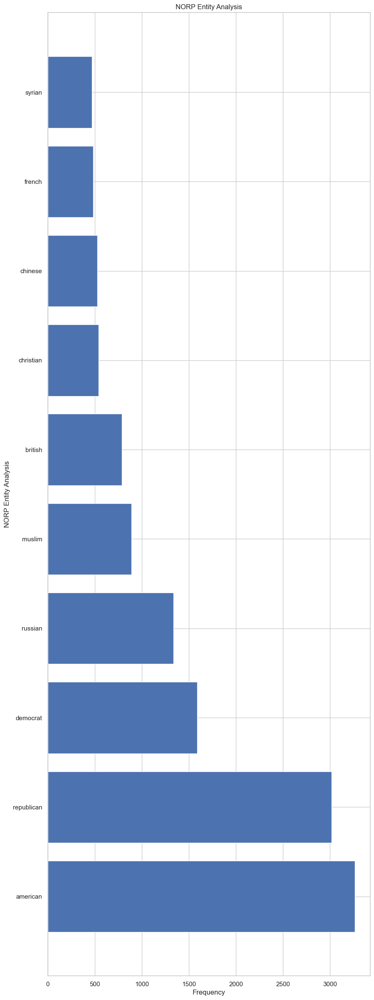

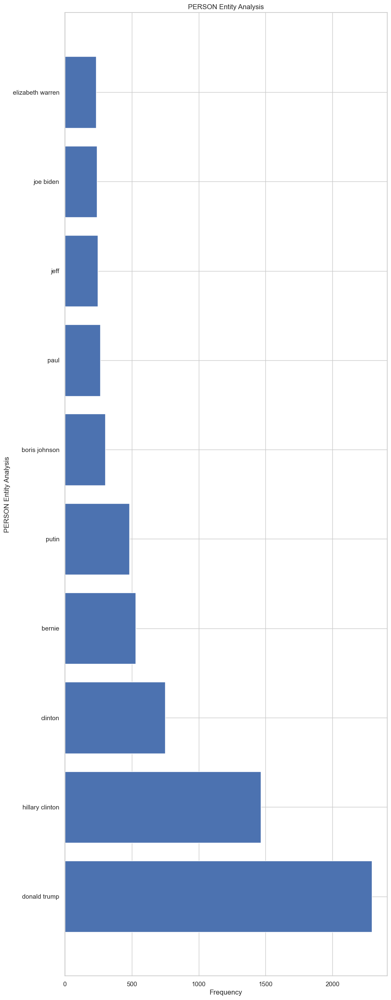

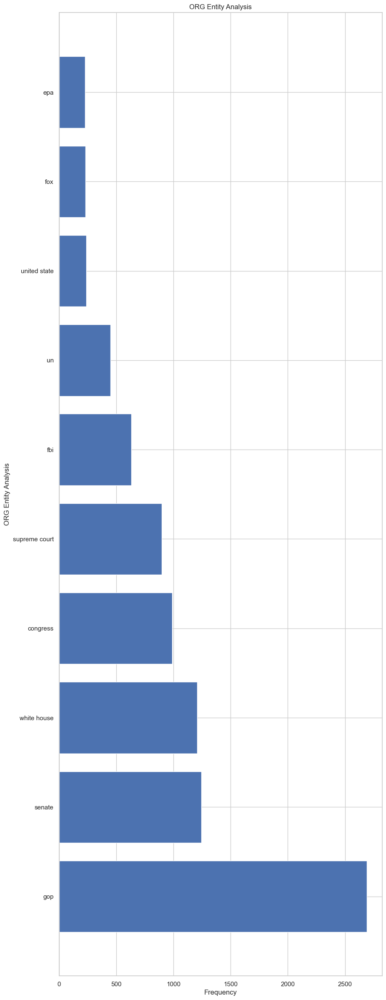

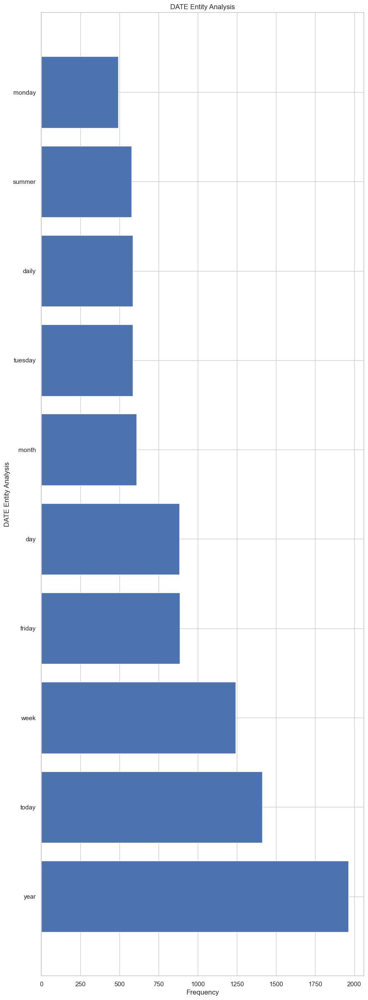

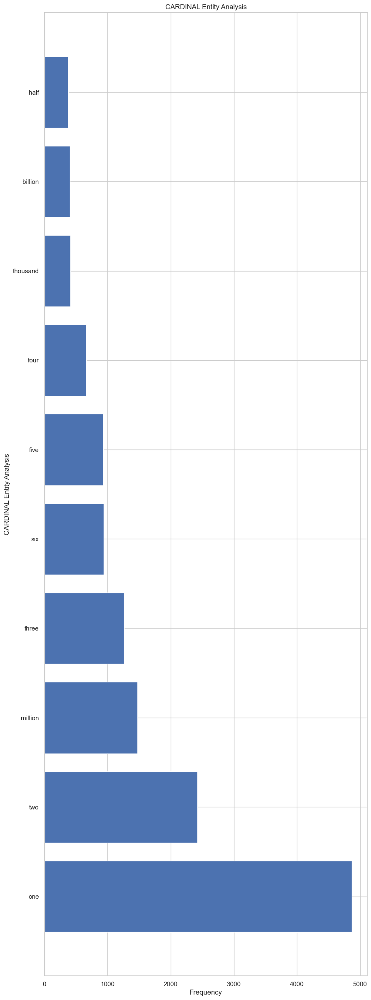

...

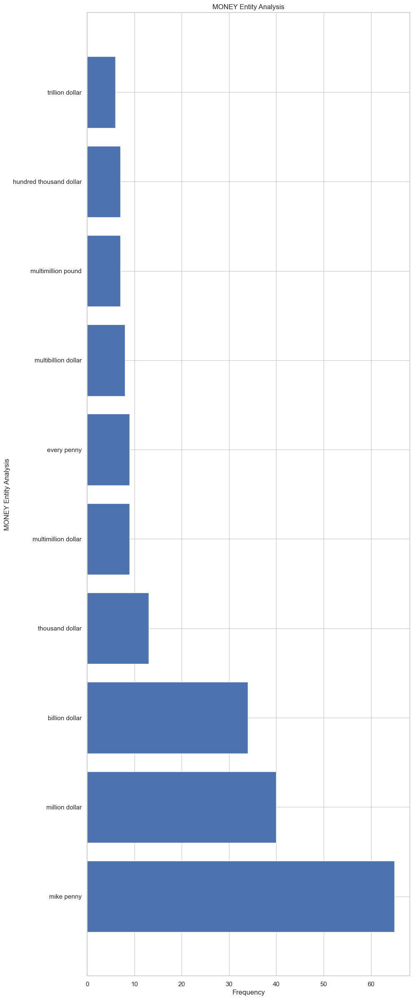

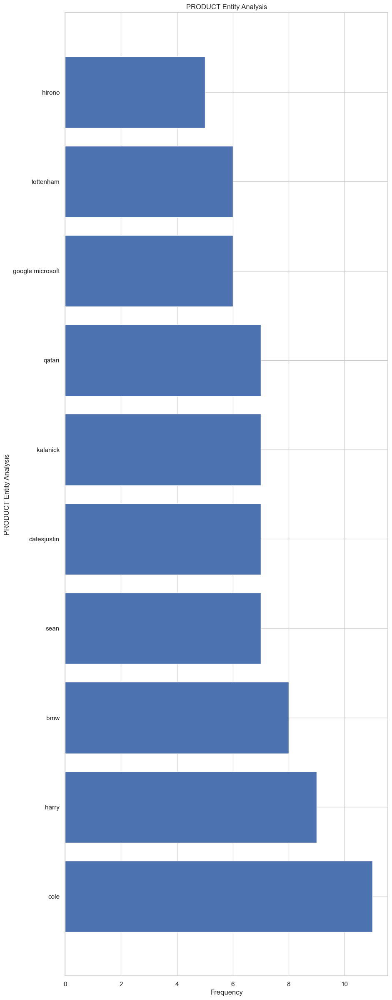

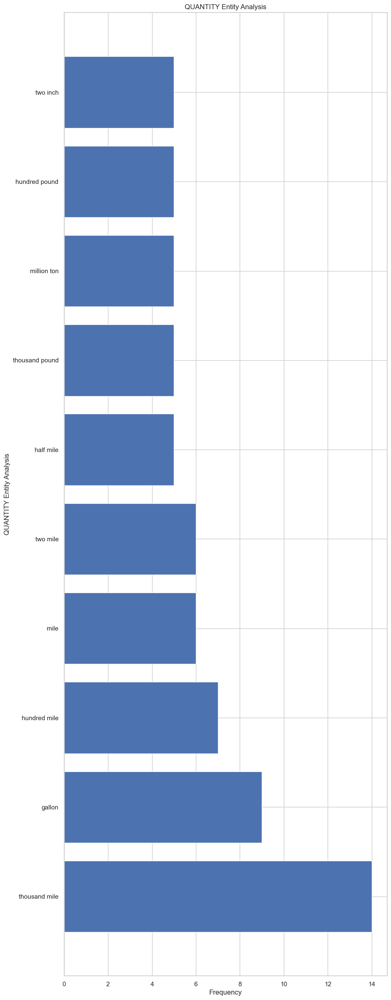

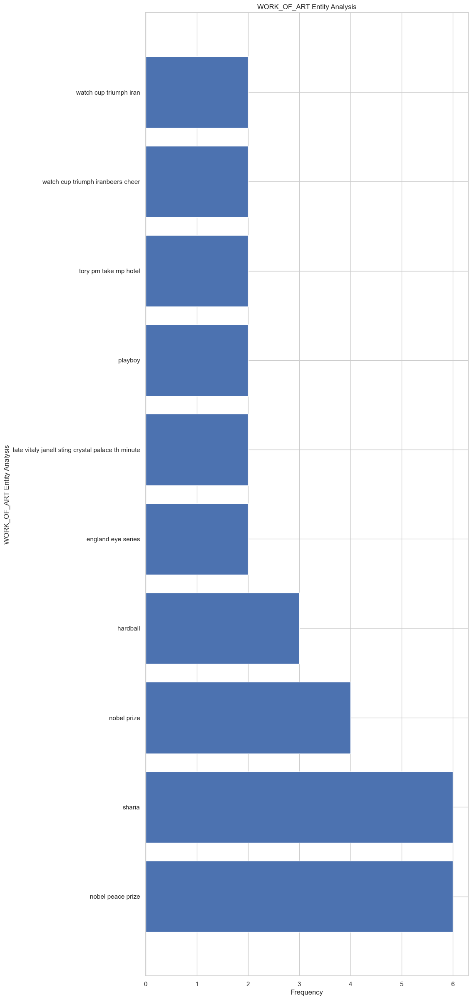

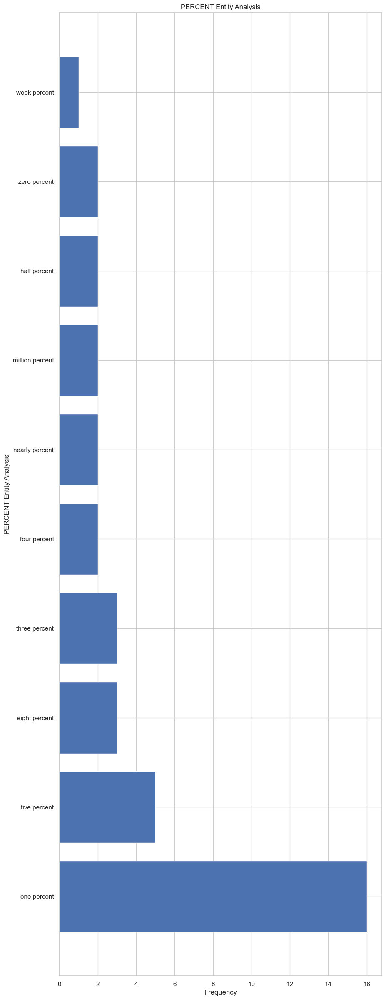

In [164]:
for name_val in df_ner['Label'].unique():
    xdf = pd.DataFrame(df_ner[df_ner['Label'] ==name_val]['Text'].value_counts()[:10]).reset_index()
    xdf = xdf.rename(columns = {'index':name_val})
    xdf = xdf.rename(columns = {'Text':'frequency'})
    plt.barh(xdf[name_val], xdf.frequency)

    # setting label of y-axis
    plt.ylabel( name_val + " Entity Analysis")

    # setting label of x-axis
    plt.xlabel("Frequency")
    plt.title(name_val + " Entity Analysis")
    plt.show()

# Select NER Which is relevant

In [165]:
df_ner_columns = [ 'NORP', 'PERSON', 'ORG','CARDINAL','GPE',
        'ORDINAL','TIME', 'LOC', 'EVENT', 'LAW',  'FAC',
                  'MONEY','PRODUCT', 'QUANTITY', 'PERCENT']

# Word Frequency

In [166]:
word_counter = Counter()
for row in combined_df_clean.to_dict("records"): #converts_to_dictionary
    word_counter.update(row["clean_title"].split()) #tokenization
# df_tf = pd.DataFrame(word_counter.most_common(10))
df_tf = pd.DataFrame(word_counter.most_common())
df_tf.columns = ["term", "frequency"]
df_tf

,term,frequency
0,trump,15373
1,new,11381
2,say,9978
3,year,7980
4,one,7821
...,...,...
155207,repairsvar,1
155208,prominencewomens,1
155209,awardtiger,1
155210,teslaparis,1


In [167]:
df_tf.head(20)

,term,frequency
0,trump,15373
1,new,11381
2,say,9978
3,year,7980
4,one,7821
5,woman,7590
6,people,7476
7,day,7472
8,get,5794
9,said,5732


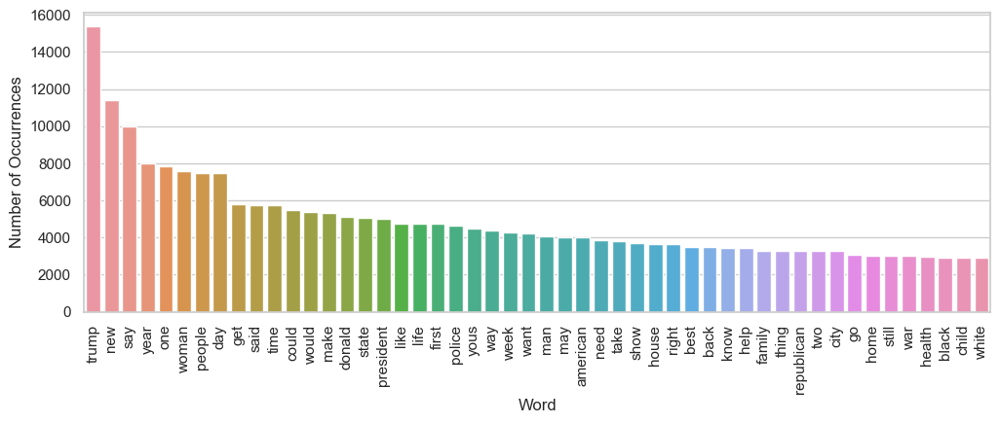

In [168]:
plt.figure(figsize=(12,4))
sns.barplot(data=df_tf[:50], x='term', y='frequency') #plot only the top 10 by slicing the df
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Word', fontsize=12)
plt.xticks(rotation=90)
plt.show()

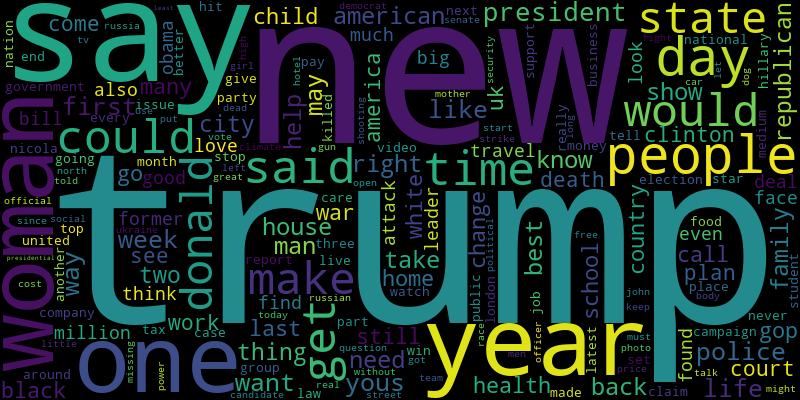

In [169]:
cloud = WordCloud(width=800, height=400)
cloud.generate_from_frequencies(dict(word_counter.most_common(200)))
image = cloud.to_image()
image

In [225]:
documents = [comment.split() for comment in combined_df_clean['clean_title']]
documents

[['tea',
  'time',
  'beneath',
  'western',
  'ghat',
  'photosas',
  'stepped',
  'serene',
  'plantation',
  'followed',
  'narrow',
  'damp',
  'twisty',
  'trail',
  'thick',
  'humid',
  'wilderness',
  'russian',
  'cargo',
  'ship',
  'dock',
  'international',
  'space',
  'stationgallery',
  'space',
  'station',
  'expedition',
  'mission',
  'great',
  'russian',
  'rocket',
  'launch',
  'photo',
  'vote',
  'best',
  'spaceship',
  'robot',
  'play',
  'catch',
  'starring',
  'agile',
  'justin',
  'rollin',
  'justin',
  'videoimage',
  'throw',
  'hizook',
  'report',
  'dlr',
  'started',
  'rolling',
  'justin',
  'added',
  'faster',
  'arm',
  'different',
  'gear',
  'ratio',
  'thomas',
  'edison',
  'voted',
  'iconic',
  'inventor',
  'yous',
  'historythat',
  'mean',
  'job',
  'lack',
  'fan',
  'wake',
  'death',
  'last',
  'year',
  'man',
  'relentlessly',
  'drove',
  'apple',
  'create',
  'aurora',
  'borealis',
  'caused',
  'huge',
  'solar',
  'sto

# Tokenization

In [226]:
 #tokenizing_the_words
vocab = corpora.Dictionary(documents) #creating_dictionaries
vocab

In [227]:

corpus = [vocab.doc2bow(text) for text in documents] #converts_to_bag-of-words_format(IDandFrequency)
# corpus

In [228]:

num_topics = 20
lda = gensim.models.LdaMulticore(corpus=corpus, id2word=vocab, num_topics=num_topics)
print(lda.print_topics())

[(0, '0.009*"trump" + 0.005*"new" + 0.004*"woman" + 0.004*"day" + 0.003*"said" + 0.003*"people" + 0.003*"donald" + 0.003*"say" + 0.003*"one" + 0.003*"year"'), (1, '0.006*"trump" + 0.006*"new" + 0.004*"say" + 0.004*"day" + 0.003*"year" + 0.003*"one" + 0.003*"time" + 0.003*"people" + 0.003*"get" + 0.002*"would"'), (2, '0.008*"trump" + 0.005*"new" + 0.005*"say" + 0.004*"one" + 0.003*"day" + 0.003*"year" + 0.003*"woman" + 0.003*"donald" + 0.003*"time" + 0.003*"get"'), (3, '0.006*"new" + 0.005*"say" + 0.004*"trump" + 0.004*"year" + 0.003*"one" + 0.003*"people" + 0.003*"day" + 0.003*"make" + 0.003*"like" + 0.003*"time"'), (4, '0.007*"trump" + 0.005*"say" + 0.004*"new" + 0.004*"one" + 0.003*"woman" + 0.003*"day" + 0.003*"said" + 0.003*"people" + 0.003*"year" + 0.002*"first"'), (5, '0.010*"trump" + 0.005*"new" + 0.004*"say" + 0.004*"people" + 0.003*"woman" + 0.003*"year" + 0.003*"one" + 0.003*"said" + 0.003*"donald" + 0.003*"could"'), (6, '0.005*"trump" + 0.005*"say" + 0.004*"people" + 0.004*"

In [229]:
# Alternatively, format topics as sentences
formatted_topics = [f"Topic {idx + 1}: " + " ".join([word for word, _ in lda.show_topic(idx, topn=10)]) for idx in range(num_topics)]
for topic in formatted_topics:
    print(topic)

Topic 1: trump new woman day said people donald say one year
Topic 2: trump new say day year one time people get would
Topic 3: trump new say one day year woman donald time get
Topic 4: new say trump year one people day make like time
Topic 5: trump say new one woman day said people year first
Topic 6: trump new say people woman year one said donald could
Topic 7: trump say people new woman year like day time make
Topic 8: trump new one people woman year say day time life
Topic 9: trump new year one say day woman people get said
Topic 10: trump say new woman people one said yous year get
Topic 11: trump new say year day people one would woman make
Topic 12: trump woman say people one year new day make would
Topic 13: trump new year day woman people time say one get
Topic 14: trump say new year day time would one donald woman
Topic 15: trump new say year president one said woman could people
Topic 16: trump new people day say one woman get year way
Topic 17: trump say new day year peopl

# Analysis of word associations/correlations

In [230]:
def get_top_n_bigram(corpus, n=None, grams = 2):
    vec = CountVectorizer(ngram_range=(grams, grams), stop_words='english').fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0, idx]) for word, idx in vec.vocabulary_.items()]
    words_freq =sorted(words_freq, key = lambda x: x[1], reverse=True)
    return words_freq[:n]

In [231]:
for range_val in range(2,7):
    common_words = get_top_n_bigram(combined_df_clean['clean_title'], 10,range_val)
    print("Top 10 Word Association - " + str(range_val) + " grams in All comments")
    counter_val = 0
    for word, freq in common_words:
        print(str(counter_val) + ". '" + word + "' : with Frequency - " + str(freq))
        counter_val = counter_val + 1
    print("-"*40)

Top 10 Word Association - 2 grams in All comments
0. 'donald trump' : with Frequency - 4529
1. 'hillary clinton' : with Frequency - 1565
2. 'white house' : with Frequency - 1408
3. 'supreme court' : with Frequency - 997
4. 'nicola bulley' : with Frequency - 972
5. 'new york' : with Frequency - 955
6. 'health care' : with Frequency - 823
7. 'bernie sander' : with Frequency - 822
8. 'united state' : with Frequency - 698
9. 'climate change' : with Frequency - 645
----------------------------------------
Top 10 Word Association - 3 grams in All comments
0. 'northern ireland protocol' : with Frequency - 194
1. 'help start day' : with Frequency - 193
2. 'welcome help start' : with Frequency - 192
3. 'president donald trump' : with Frequency - 186
4. 'tv live stream' : with Frequency - 170
5. 'time tv live' : with Frequency - 162
6. 'kickoff time tv' : with Frequency - 157
7. 'live stream team' : with Frequency - 152
8. 'stream team hh' : with Frequency - 152
9. 'funniest tweet woman' : with 

In [177]:
import pandas as pd
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from gensim import corpora
from gensim.models import LdaModel
from sklearn.feature_extraction.text import CountVectorizer

nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\PRAGYA\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\PRAGYA\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\PRAGYA\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


True

In [232]:
df = combined_df_clean.copy()
df

,date,combined,clean_title
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...
...,...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...,happened german car factory went electrichow c...
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su...",modis power keep growing india look sure give ...
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...,hiring sophisticated parttime chatbot tutorsch...
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...,apple lift restriction iphone repairsvar mista...


# Take Topics as a Feature

In [233]:
df_topic = df.copy()

# Preprocessing Function
def preprocess_news(news):
    lemmatizer = WordNetLemmatizer()
    stop_words = set(stopwords.words('english'))
    
    # Tokenization
    tokens = word_tokenize(news.lower())
    
    # Removing stopwords and lemmatization
    tokens = [lemmatizer.lemmatize(word) for word in tokens if word.isalpha() and word not in stop_words]
    
    return tokens

# Apply preprocessing
df_topic['tokens'] = df_topic['clean_title'].apply(preprocess_news)
df_topic

,date,combined,clean_title,tokens
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...,"[tea, time, beneath, western, ghat, photosas, ..."
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...,"[traveling, roaring, twenty, photosthe, fashio..."
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...,"[indiana, welcome, super, bowl, fan, childrens..."
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...,"[tsa, supervisor, wait, hour, report, possible..."
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...,"[classroomis, time, devoting, precious, public..."
...,...,...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...,happened german car factory went electrichow c...,"[happened, german, car, factory, went, electri..."
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su...",modis power keep growing india look sure give ...,"[modis, power, keep, growing, india, look, sur..."
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...,hiring sophisticated parttime chatbot tutorsch...,"[hiring, sophisticated, parttime, chatbot, tut..."
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...,apple lift restriction iphone repairsvar mista...,"[apple, lift, restriction, iphone, repairsvar,..."


# Check Best Topic Number

In [237]:
# Create a dictionary representation of the documents.
dictionary = corpora.Dictionary(df_topic['tokens'])

# Create a corpus: List of lists of (token_id, token_count)
corpus = [dictionary.doc2bow(text) for text in df_topic['tokens']]

In [240]:
no_of_topics = 20

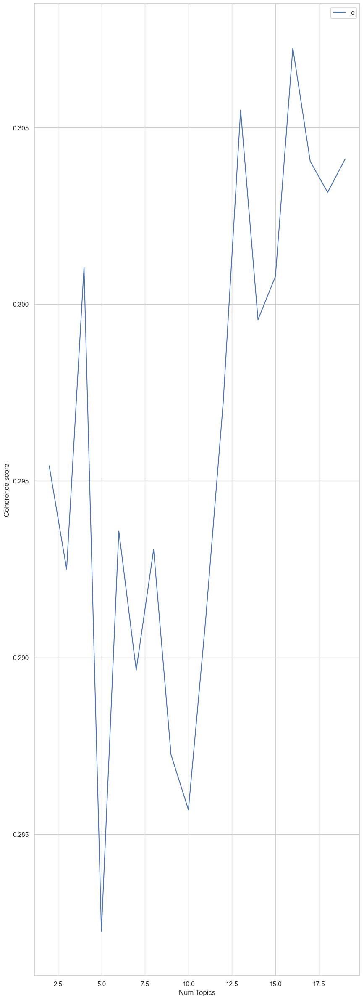

In [241]:
from gensim.models.coherencemodel import CoherenceModel

def compute_coherence_values(dictionary, corpus, texts, limit, start=2, step=1):
    coherence_values = []
    model_list = []
    for num_topics in range(start, limit, step):
        model = LdaModel(corpus=corpus, id2word=dictionary, num_topics=num_topics, random_state=42)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=texts, dictionary=dictionary, coherence='c_v')
        coherence_values.append(coherencemodel.get_coherence())
    return model_list, coherence_values

# Running the function
model_list, coherence_values = compute_coherence_values(dictionary=dictionary, corpus=corpus, texts=df_topic['tokens'], start=2, limit=no_of_topics, step=1)




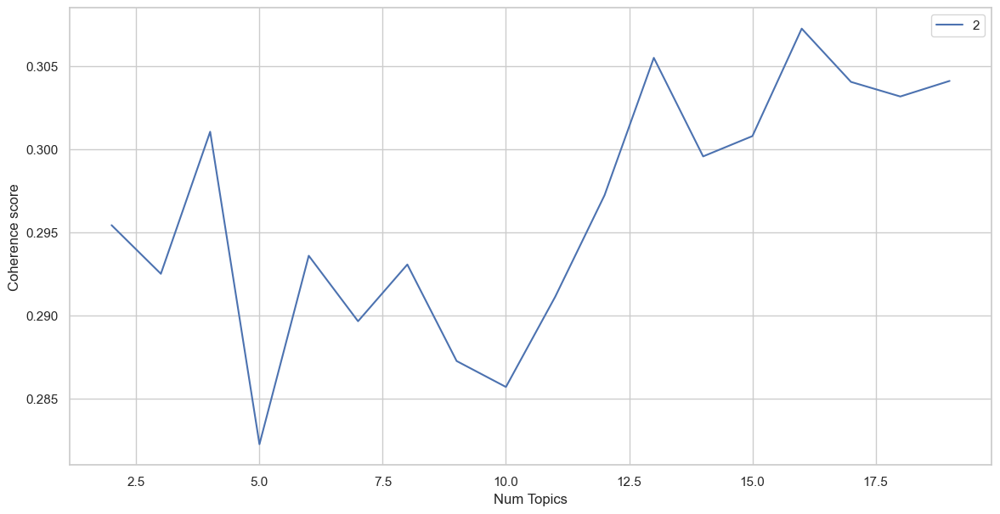

In [247]:
# Plotting
plt.subplots(figsize=(14, 7))
import matplotlib.pyplot as plt
x = range(2, no_of_topics, 1)
plt.plot(x, coherence_values)
plt.xlabel("Num Topics")
plt.ylabel("Coherence score")
plt.legend(x)
plt.show()

In [244]:
print(x,coherence_values )

range(2, 20) [0.2954243474870376, 0.2924995042515512, 0.3010479202561392, 0.2822426702542186, 0.2935858717178334, 0.28964498855473725, 0.2930579369263777, 0.28725006970513045, 0.28568963913429524, 0.29112098112162343, 0.297224643496608, 0.3054961281303952, 0.29956392555713096, 0.3007855073548478, 0.3072525198759106, 0.30404646008737507, 0.3031684347523209, 0.304105506916814]


In [248]:
# Find the number of topics that gives the highest coherence value
max_coherence_value = max(coherence_values)
optimal_num_topics = range(2, 30, 1)[coherence_values.index(max_coherence_value)]

print(f"The optimal number of topics is {optimal_num_topics} with a coherence value of {max_coherence_value:.4f}")


The optimal number of topics is 16 with a coherence value of 0.3073


# Pass the Number of topics as a Parameter

In [249]:
# Train the LDA model
lda_model = LdaModel(corpus=corpus, 
                     id2word=dictionary, 
                     num_topics=optimal_num_topics, 
                     random_state=42, 
                     passes=10,
                    update_every=1,
                    alpha='auto',
                    per_word_topics=True
                    )

# Display topics and their associated words
topics = lda_model.print_topics(num_words=5)
for topic in topics:
    print(f"Topic {topic[0]}: {topic[1]}")

Topic 0: 0.001*"repaying" + 0.000*"validity" + 0.000*"practical" + 0.000*"cm" + 0.000*"aspect"
Topic 1: 0.013*"bengal" + 0.001*"isda" + 0.001*"kashmiri" + 0.001*"grover" + 0.001*"miscreant"
Topic 2: 0.000*"new" + 0.000*"trump" + 0.000*"one" + 0.000*"say" + 0.000*"woman"
Topic 3: 0.001*"dal" + 0.000*"affiliation" + 0.000*"selfproclaimed" + 0.000*"jauntaroo" + 0.000*"trump"
Topic 4: 0.000*"mushing" + 0.000*"stratton" + 0.000*"profusion" + 0.000*"sedona" + 0.000*"madaba"
Topic 5: 0.008*"say" + 0.005*"minister" + 0.005*"india" + 0.004*"pakistan" + 0.003*"marten"
Topic 6: 0.002*"expressway" + 0.001*"inaugurated" + 0.001*"tractor" + 0.001*"hydraulic" + 0.001*"auto"
Topic 7: 0.001*"forcibly" + 0.001*"component" + 0.001*"govt" + 0.001*"abducted" + 0.001*"revisit"
Topic 8: 0.001*"pia" + 0.000*"reclining" + 0.000*"rai" + 0.000*"clearwater" + 0.000*"tinsel"
Topic 9: 0.000*"necrophilia" + 0.000*"trump" + 0.000*"new" + 0.000*"one" + 0.000*"year"
Topic 10: 0.000*"avant" + 0.000*"trump" + 0.000*"day"

In [257]:
# Get the topics from the best LDA model
topics = lda_model.print_topics(-1)

# Function to clean up the topics
def clean_topic(topic):
    # Remove the numeric weights (e.g., '0.007*') using a regular expression
    cleaned_topic = ''.join([word.split("*")[1] for word in topic.split(" + ")])
    cleaned_topic = cleaned_topic.replace('"',' ')
    return cleaned_topic.strip(' ')  # Remove any extra quotation marks

for topic in topics:
    print(f"Topic {topic[0]}: {clean_topic(topic[1])}")
    

Topic 0: repaying  validity  practical  cm  aspect  portfolio  setup  repealing  locally  caliphate
Topic 1: bengal  isda  kashmiri  grover  miscreant  west  semifinal  facilitator  changethe  cherish
Topic 2: new  trump  one  say  woman  donald  life  people  day  get
Topic 3: dal  affiliation  selfproclaimed  jauntaroo  trump  associate  one  year  new  day
Topic 4: mushing  stratton  profusion  sedona  madaba  carmichael  hoagy  macho  ahold  arizonan
Topic 5: say  minister  india  pakistan  marten  pm  delhi  government  khan  woman
Topic 6: expressway  inaugurated  tractor  hydraulic  auto  connect  stretch  section  passing  cover
Topic 7: forcibly  component  govt  abducted  revisit  invitational  supplying  manufactured  instrument  renegotiate
Topic 8: pia  reclining  rai  clearwater  tinsel  shooin  patisserie  goldilocks  pachyderm  decked
Topic 9: necrophilia  trump  new  one  year  woman  donald  could  say  people
Topic 10: avant  trump  day  people  say  new  year  yous 

In [250]:
# Assign topic distribution to each day
def get_topic_distribution(text):
    bow = dictionary.doc2bow(text)
    return lda_model.get_document_topics(bow)

df_topic['topic_distribution'] = df_topic['tokens'].apply(get_topic_distribution)

# # Display the topic distribution for each day
# for index, row in df.iterrows():
#     print(f"Date: {row['date']}, Topic Distribution: {row['topic_distribution']}")
df_topic

,date,combined,clean_title,tokens,topic_distribution
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...,"[tea, time, beneath, western, ghat, photosas, ...","[(12, 0.5340123), (14, 0.3357806), (15, 0.1294..."
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...,"[traveling, roaring, twenty, photosthe, fashio...","[(12, 0.43310112), (14, 0.5368437), (15, 0.029..."
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...,"[indiana, welcome, super, bowl, fan, childrens...","[(12, 0.6686953), (14, 0.22223479), (15, 0.108..."
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...,"[tsa, supervisor, wait, hour, report, possible...","[(12, 0.5717533), (14, 0.3682191), (15, 0.0583..."
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...,"[classroomis, time, devoting, precious, public...","[(12, 0.7271622), (14, 0.20539111), (15, 0.066..."
...,...,...,...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...,happened german car factory went electrichow c...,"[happened, german, car, factory, went, electri...","[(14, 0.6245774), (15, 0.36150712)]"
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su...",modis power keep growing india look sure give ...,"[modis, power, keep, growing, india, look, sur...","[(5, 0.28323692), (12, 0.5623266), (14, 0.1366..."
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...,hiring sophisticated parttime chatbot tutorsch...,"[hiring, sophisticated, parttime, chatbot, tut...","[(5, 0.8795994), (14, 0.089250326)]"
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...,apple lift restriction iphone repairsvar mista...,"[apple, lift, restriction, iphone, repairsvar,...","[(7, 0.0292349), (14, 0.10639649), (15, 0.8521..."


In [258]:
from collections import defaultdict

def aggregate_topics_by_date(group):
    topic_sums = defaultdict(float)
    for dist in group['topic_distribution']:
        for topic_id, prob in dist:
            topic_sums[topic_id] += prob
    total = sum(topic_sums.values())
    return {f"topic_{k}": v/total for k, v in topic_sums.items()}

# Group by date and aggregate topics
topic_features = df_topic.groupby('date').apply(aggregate_topics_by_date).apply(pd.Series).reset_index()

print(topic_features)


           date  topic_12  topic_14  topic_15  topic_4   topic_5  topic_1  \
0    2012-01-28  0.534414  0.336033  0.129553      NaN       NaN      NaN   
1    2012-01-29  0.433312  0.537105  0.029583      NaN       NaN      NaN   
2    2012-01-30  0.669137  0.222382  0.108482      NaN       NaN      NaN   
3    2012-01-31  0.572719  0.368841  0.058440      NaN       NaN      NaN   
4    2012-02-01  0.728204  0.205685  0.066111      NaN       NaN      NaN   
...         ...       ...       ...       ...      ...       ...      ...   
4371 2024-09-04       NaN  0.633391  0.366609      NaN       NaN      NaN   
4372 2024-09-05  0.572521  0.139108       NaN      NaN  0.288372      NaN   
4373 2024-10-04       NaN  0.092120       NaN      NaN  0.907880      NaN   
4374 2024-11-04       NaN  0.107711  0.862693      NaN       NaN      NaN   
4375 2024-12-04       NaN  0.159972  0.662358      NaN  0.177670      NaN   

      topic_8   topic_7  topic_10  topic_6  topic_9  topic_3  topic_0  
0  

# Take Featuers as NER

In [259]:
df_ner_columns
df_ner = df_ner[df_ner['Label'].isin(df_ner_columns)]
df_ner = df_ner.rename(columns= {'Text':'entity','Label':'label'})
df_ner

,entity,label
0,russian,NORP
1,russian,NORP
2,rollin justin,PERSON
3,justin,ORG
4,thomas edison,PERSON
...,...,...
198170,million,CARDINAL
198171,munich kingsley coman,PERSON
198172,german,NORP
198173,manchester city,GPE


# Total top NER Features

In [260]:
top_ner = 5

In [261]:
# Group by 'label' and 'entity' to count occurrences
entity_counts = df_ner.groupby(['label', 'entity']).size().reset_index(name='count')

# For each label, get the top 3 entities based on frequency
top_entities = entity_counts.groupby('label').apply(lambda x: x.nlargest(top_ner, 'count')).reset_index(drop=True)

# Convert to a dictionary for easy lookup
top_entities_dict = top_entities.groupby('label')['entity'].apply(list).to_dict()

# Display the top entities for each label
print(top_entities_dict)

{'CARDINAL': ['one', 'two', 'million', 'three', 'six'], 'EVENT': ['vietnam', 'wwii', 'super bowl', 'hurricane katrina', 'iraq war'], 'FAC': ['guantanamo', 'uva', 'notre dame', 'north london', 'nikki haley'], 'GPE': ['london', 'russia', 'america', 'california', 'china'], 'LAW': ['rico', 'camilla wear', 'crown new', 'superfund', 'west ham'], 'LOC': ['europe', 'middle east', 'africa', 'caribbean', 'asia'], 'MONEY': ['mike penny', 'million dollar', 'billion dollar', 'thousand dollar', 'every penny'], 'NORP': ['american', 'republican', 'democrat', 'russian', 'muslim'], 'ORDINAL': ['first', 'second', 'third', 'fourth', 'fifth'], 'ORG': ['gop', 'senate', 'white house', 'congress', 'supreme court'], 'PERCENT': ['one percent', 'five percent', 'eight percent', 'three percent', 'four percent'], 'PERSON': ['donald trump', 'hillary clinton', 'clinton', 'bernie', 'putin'], 'PRODUCT': ['cole', 'harry', 'bmw', 'datesjustin', 'kalanick'], 'QUANTITY': ['thousand mile', 'gallon', 'hundred mile', 'mile', 

In [262]:
df_ner_feat = df.copy()
df_ner_feat

,date,combined,clean_title
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...
...,...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...,happened german car factory went electrichow c...
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su...",modis power keep growing india look sure give ...
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...,hiring sophisticated parttime chatbot tutorsch...
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...,apple lift restriction iphone repairsvar mista...


In [263]:
# Initialize columns for the top NER entities
for label, entities in top_entities_dict.items():
    for entity in entities:
        df_ner_feat[f'{label}_{entity}'] = df_ner_feat['clean_title'].apply(lambda x: 1 if entity in x else 0)

# Display the DataFrame with new features
df_ner_feat.head()

,date,combined,clean_title,CARDINAL_one,CARDINAL_two,CARDINAL_million,CARDINAL_three,CARDINAL_six,EVENT_vietnam,EVENT_wwii,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...,1,1,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...,1,1,0,0,0,0,0,...,0,0,0,0,0,0,1,0,0,1
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...,1,1,1,0,1,1,0,...,0,0,0,1,0,0,1,0,0,0
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...,1,1,0,1,0,0,0,...,0,0,0,0,0,0,1,1,0,0
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...,1,1,1,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0


# Event Cluster

In [264]:
df_clust = df.copy()
df_clust

,date,combined,clean_title
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...
...,...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...,happened german car factory went electrichow c...
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su...",modis power keep growing india look sure give ...
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...,hiring sophisticated parttime chatbot tutorsch...
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...,apple lift restriction iphone repairsvar mista...


In [265]:
import pandas as pd
import spacy
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.cluster import DBSCAN
import numpy as np

# Function to extract entities and key phrases
def extract_phrases(text):
    doc = nlp(text)
    # Extract named entities and noun chunks (key phrases)
    entities = [ent.text for ent in doc.ents]
    noun_chunks = [chunk.text for chunk in doc.noun_chunks]
    return entities + noun_chunks

# Apply the function to the news articles
df_clust['phrases'] = df_clust['clean_title'].apply(extract_phrases)
df_clust

,date,combined,clean_title,phrases
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...,"[russian, russian, rollin justin, justin, thom..."
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...,"[twenty, james love, gamein weekly, week, jean..."
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...,"[indiana, new york, new england, two, one, per..."
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...,"[hour, monday, one, ben flajnik, photosmonday,..."
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...,"[million, manhattan, spring, two hour, mexican..."
...,...,...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...,happened german car factory went electrichow c...,"[german, china, russia, putin, happened german..."
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su...",modis power keep growing india look sure give ...,"[india, modis power, india, moredisabled peopl..."
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...,hiring sophisticated parttime chatbot tutorsch...,[sophisticated parttime chatbot tutorschampion...
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...,apple lift restriction iphone repairsvar mista...,"[israel, million, apple lift restriction iphon..."


In [266]:
from sklearn.feature_extraction.text import CountVectorizer

# Flatten the list of phrases for vectorization
df_clust['phrases_flat'] = df_clust['phrases'].apply(lambda x: ' '.join(x))

# Vectorize the phrases
vectorizer = CountVectorizer()
X = vectorizer.fit_transform(df_clust['phrases_flat'])


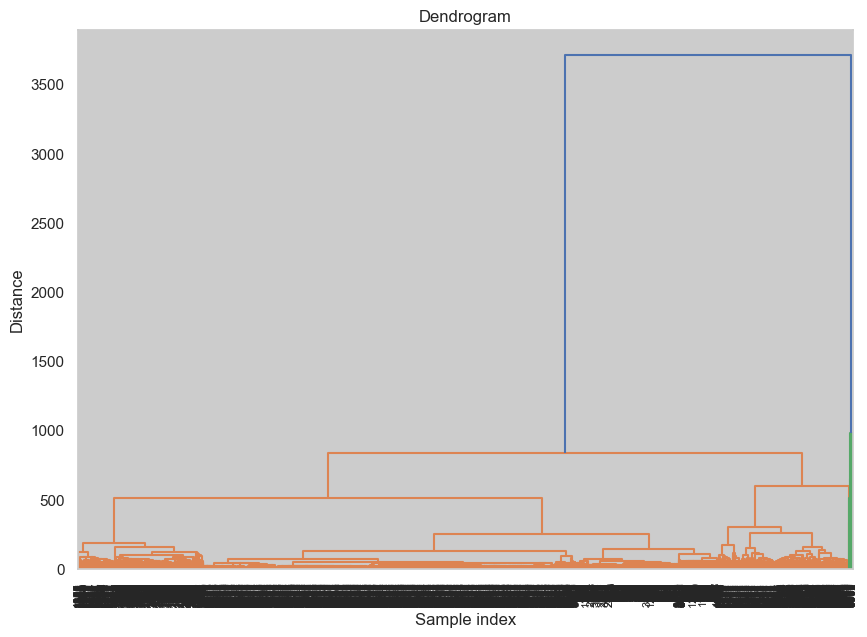

In [271]:
import matplotlib.pyplot as plt
from scipy.cluster.hierarchy import dendrogram, linkage

# Generate the linkage matrix
Z = linkage(X.toarray(), method='ward')  # You can also try 'average', 'single', 'complete'

# Plot the dendrogram
plt.figure(figsize=(10, 7))
dendrogram(Z, leaf_rotation=90, leaf_font_size=8)
plt.title('Dendrogram')
plt.xlabel('Sample index')
plt.ylabel('Distance')
plt.show()


In [272]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
import numpy as np

# # Define ranges for hyperparameters
eps_values = [1.0, 5.0, 10, 30, 50]
min_samples_values = [2, 5, 10, 15, 20]

best_eps = best_min_samples = 0
best_score = -1

for eps in eps_values:
    for min_samples in min_samples_values:
#         dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        dbscan = DBSCAN(eps=eps)
        labels = dbscan.fit_predict(X.toarray())
        
        # Ensure at least two clusters to compute silhouette score
        if len(set(labels)) > 1:
            score = silhouette_score(X.toarray(), labels)
            
            if score > best_score:
                best_score = score
                best_eps = eps
                best_min_samples = min_samples

print(f"Best eps: {best_eps}, Best min_samples: {best_min_samples} with Silhouette Score: {best_score:.4f}")


Best eps: 50, Best min_samples: 2 with Silhouette Score: 0.8824


In [302]:
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
import numpy as np

# # Define ranges for hyperparameters
eps_values = [30, 100,200,500]
min_samples_values = [2, 5, 10]

best_eps = best_min_samples = 0
best_score = -1

for eps in eps_values:
    for min_samples in min_samples_values:
#         dbscan = DBSCAN(eps=eps, min_samples=min_samples)
        dbscan = DBSCAN(eps=eps)
        labels = dbscan.fit_predict(X.toarray())
        
        # Ensure at least two clusters to compute silhouette score
        if len(set(labels)) > 1:
            score = silhouette_score(X.toarray(), labels)
            
            if score > best_score:
                best_score = score
                best_eps = eps
                best_min_samples = min_samples

print(f"Best eps: {best_eps}, Best min_samples: {best_min_samples} with Silhouette Score: {best_score:.4f}")


Best eps: 200, Best min_samples: 2 with Silhouette Score: 0.9459


# clustering adjust the DBSCAN eps

In [303]:
# Apply DBSCAN clustering
dbscan = DBSCAN(eps=best_eps, min_samples=best_min_samples)
df_clust['event_cluster'] = dbscan.fit_predict(X.toarray())

# Label events as significant if they belong to a cluster
df_clust['is_event'] = df_clust['event_cluster'].apply(lambda x: 1 if x != -1 else 0)
df_clust

,date,combined,clean_title,phrases,phrases_flat,event_cluster,is_event
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...,"[russian, russian, rollin justin, justin, thom...",russian russian rollin justin justin thomas ed...,0,1
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...,"[twenty, james love, gamein weekly, week, jean...",twenty james love gamein weekly week jean jean...,0,1
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...,"[indiana, new york, new england, two, one, per...",indiana new york new england two one peruvian ...,0,1
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...,"[hour, monday, one, ben flajnik, photosmonday,...",hour monday one ben flajnik photosmonday night...,0,1
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...,"[million, manhattan, spring, two hour, mexican...",million manhattan spring two hour mexican bill...,0,1
...,...,...,...,...,...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...,happened german car factory went electrichow c...,"[german, china, russia, putin, happened german...",german china russia putin happened german car ...,0,1
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su...",modis power keep growing india look sure give ...,"[india, modis power, india, moredisabled peopl...",india modis power india moredisabled people book,0,1
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...,hiring sophisticated parttime chatbot tutorsch...,[sophisticated parttime chatbot tutorschampion...,sophisticated parttime chatbot tutorschampions...,0,1
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...,apple lift restriction iphone repairsvar mista...,"[israel, million, apple lift restriction iphon...",israel million apple lift restriction iphone r...,0,1


In [304]:
df_clust['is_event'].value_counts()

1    4355
0      21
Name: is_event, dtype: int64

In [307]:
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score

# Set the number of clusters based on the dendrogram
n_clusters = 2  # Adjust based on your dendrogram observation

# Apply Agglomerative Hierarchical Clustering
hierarchical = AgglomerativeClustering(n_clusters=n_clusters, affinity='euclidean', linkage='ward')
labels = hierarchical.fit_predict(X.toarray())

# Compute the silhouette score to evaluate clustering quality
score = silhouette_score(X.toarray(), labels)
print(f"Hierarchical Clustering with {n_clusters} clusters Silhouette Score: {score:.4f}")

# Add cluster labels to DataFrame
df_clust['event_cluster1'] = labels

Hierarchical Clustering with 2 clusters Silhouette Score: 0.9485


In [308]:
df_clust['event_cluster1'].value_counts()

1    4357
0      19
Name: event_cluster1, dtype: int64

In [305]:
df_clust.to_csv('df_clust.csv')

# VADER  Sentiment Analysis

In [274]:
sia = SentimentIntensityAnalyzer()
def score_vader(text):
    return sia.polarity_scores(text)["compound"]

In [275]:
print(combined_df_clean['clean_title'].iloc[0])
print(score_vader(combined_df_clean['clean_title'].iloc[0]))
print(combined_df_clean['clean_title'].iloc[1])
print(score_vader(combined_df_clean['clean_title'].iloc[1]))
print(combined_df_clean['clean_title'].iloc[3])
print(score_vader(combined_df_clean['clean_title'].iloc[3]))

tea time beneath western ghat photosas stepped serene plantation followed narrow damp twisty trail thick humid wilderness russian cargo ship dock international space stationgallery space station expedition mission great russian rocket launch photo vote best spaceship robot play catch starring agile justin rollin justin videoimage throw hizook report dlr started rolling justin added faster arm different gear ratio thomas edison voted iconic inventor yous historythat mean job lack fan wake death last year man relentlessly drove apple create aurora borealis caused huge solar storm shimmer norway videoaurora borealis typically seen high northern latitude period high solar activity tinker change worldtinkering handson garagebased tradition making comeback among average american promising change life better several front pregnant displaced double dangerits time step effort ensure woman everywhere decide freely want child mother deliver baby safely service available woman suffered violence to

In [277]:
combined_df_clean['vader_sentiment'] = combined_df_clean['clean_title'].apply(score_vader)
combined_df_clean.head()

,date,combined,clean_title,vader_sentiment
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...,0.9946
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...,0.9951
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...,0.9806
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...,0.9766
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...,0.9977


In [441]:
!pip install textblob

  Obtaining dependency information for textblob from https://files.pythonhosted.org/packages/02/07/5fd2945356dd839974d3a25de8a142dc37293c21315729a41e775b5f3569/textblob-0.18.0.post0-py3-none-any.whl.metadata
   ---------------------------------------- 0.0/626.3 kB ? eta -:--:--
    --------------------------------------- 10.2/626.3 kB ? eta -:--:--
   - ------------------------------------- 20.5/626.3 kB 330.3 kB/s eta 0:00:02
   --- ----------------------------------- 61.4/626.3 kB 469.7 kB/s eta 0:00:02
   ------ ------------------------------- 112.6/626.3 kB 656.4 kB/s eta 0:00:01
   ------- ------------------------------ 122.9/626.3 kB 654.9 kB/s eta 0:00:01
   ---------- --------------------------- 174.1/626.3 kB 618.3 kB/s eta 0:00:01
   ------------- ------------------------ 225.3/626.3 kB 724.0 kB/s eta 0:00:01
   ---------------- --------------------- 276.5/626.3 kB 776.2 kB/s eta 0:00:01
   ------------------ ------------------- 307.2/626.3 kB 791.9 kB/s eta 0:00:01
   ------

# textblob Sentiment Analysis

In [442]:
from textblob import TextBlob

def score_textblob(text):
    blob = TextBlob(text)
    return blob.sentiment.polarity  # You can also include subjectivity if needed

combined_df_clean['textblob_sentiment'] = combined_df_clean['clean_title'].apply(score_textblob)


In [449]:
!pip install tensorflow

^C


# Transformers-Based Models for Sentiment Analysis

In [450]:
# from transformers import pipeline

# # Initialize sentiment analysis pipeline
# sentiment_pipeline = pipeline('sentiment-analysis')

# def score_transformers(text):
#     result = sentiment_pipeline(text)[0]
#     return result['score'] if result['label'] == 'POSITIVE' else -result['score']

# combined_df_clean['transformers_sentiment'] = combined_df_clean['clean_title'].apply(score_transformers)


In [451]:
combined_df_clean

,date,combined,clean_title,vader_sentiment,textblob_sentiment
0,2012-01-28,Tea Time Beneath The Western Ghats (PHOTOS)As ...,tea time beneath western ghat photosas stepped...,0.9946,0.129496
1,2012-01-29,Traveling To The Roaring Twenties (PHOTOS)The ...,traveling roaring twenty photosthe fashion fil...,0.9951,0.026796
2,2012-01-30,Indiana Welcomes Super Bowl Fans With Children...,indiana welcome super bowl fan childrens postc...,0.9806,0.136525
3,2012-01-31,TSA Supervisor Waits Hours To Report Possible ...,tsa supervisor wait hour report possible pipe ...,0.9766,0.102778
4,2012-02-01,The World Is A ClassroomIs now the time to be ...,classroomis time devoting precious public fund...,0.9977,0.332493
...,...,...,...,...,...
4371,2024-09-04,What Happened When a German Car Factory Went A...,happened german car factory went electrichow c...,-0.8807,-0.150000
4372,2024-09-05,"Modi's Power Keeps Growing, and India Looks Su...",modis power keep growing india look sure give ...,0.6597,0.477778
4373,2024-10-04,Now Hiring: Sophisticated (but Part-Time) Chat...,hiring sophisticated parttime chatbot tutorsch...,0.8393,0.500000
4374,2024-11-04,Apple Lifts Some Restrictions on iPhone Repair...,apple lift restriction iphone repairsvar mista...,0.6486,0.700000


  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/ed/b6/62345568cd07de5d9254fcf64d7e44aacbb6abde11ea953b3cb320e58d19/tensorflow-2.17.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for tensorflow-intel==2.17.0 from https://files.pythonhosted.org/packages/66/03/5c447feceb72f5a38ac2aa79d306fa5b5772f982c2b480c1329c7e382900/tensorflow_intel-2.17.0-cp311-cp311-win_amd64.whl.metadata
  Obtaining dependency information for astunparse>=1.6.0 from https://files.pythonhosted.org/packages/2b/03/13dde6512ad7b4557eb792fbcf0c653af6076b81e5941d36ec61f7ce6028/astunparse-1.6.3-py2.py3-none-any.whl.metadata
  Obtaining dependency information for flatbuffers>=24.3.25 from https://files.pythonhosted.org/packages/41/f0/7e988a019bc54b2dbd0ad4182ef2d53488bb02e58694cd79d61369e85900/flatbuffers-24.3.25-py2.py3-none-any.whl.metadata
  Obtaining dependency information for gast!=0.5.0,!=0.5.1,!=0.5.2,>=0.2.1 from https://files.pythonhosted.org/p

In [452]:
df_clean = combined_df_clean.copy()

In [453]:
df_clean = df_clean[['date','vader_sentiment','textblob_sentiment']]
df_clean = df_clean.merge(df_clust[['date','is_event']], on ='date')
df_clean = df_clean.merge(topic_features, on ='date')
df_clean = df_clean.merge(df_ner_feat, on ='date')
df_clean.drop(columns=['combined','clean_title'],inplace=True)
df_clean.fillna(0,inplace=True)
df_clean

,date,vader_sentiment,textblob_sentiment,is_event,topic_12,topic_14,topic_15,topic_4,topic_5,topic_1,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2012-01-28,0.9946,0.129496,1,0.534414,0.336033,0.129553,0.0,0.000000,0.0,...,0,0,0,1,0,0,0,0,0,1
1,2012-01-29,0.9951,0.026796,1,0.433312,0.537105,0.029583,0.0,0.000000,0.0,...,0,0,0,0,0,0,1,0,0,1
2,2012-01-30,0.9806,0.136525,1,0.669137,0.222382,0.108482,0.0,0.000000,0.0,...,0,0,0,1,0,0,1,0,0,0
3,2012-01-31,0.9766,0.102778,1,0.572719,0.368841,0.058440,0.0,0.000000,0.0,...,0,0,0,0,0,0,1,1,0,0
4,2012-02-01,0.9977,0.332493,1,0.728204,0.205685,0.066111,0.0,0.000000,0.0,...,0,0,0,0,0,0,0,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4371,2024-09-04,-0.8807,-0.150000,1,0.000000,0.633391,0.366609,0.0,0.000000,0.0,...,0,0,0,0,0,0,0,0,0,0
4372,2024-09-05,0.6597,0.477778,1,0.572521,0.139108,0.000000,0.0,0.288372,0.0,...,0,0,0,0,0,0,0,0,0,0
4373,2024-10-04,0.8393,0.500000,1,0.000000,0.092120,0.000000,0.0,0.907880,0.0,...,0,0,0,0,0,0,0,0,0,0
4374,2024-11-04,0.6486,0.700000,1,0.000000,0.107711,0.862693,0.0,0.000000,0.0,...,0,0,0,0,0,0,0,0,0,0


In [454]:
df_clean.to_csv('df_clean_NEW.csv')

  Obtaining dependency information for tensorflow from https://files.pythonhosted.org/packages/ed/b6/62345568cd07de5d9254fcf64d7e44aacbb6abde11ea953b3cb320e58d19/tensorflow-2.17.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow-2.17.0-cp311-cp311-win_amd64.whl.metadata (3.2 kB)
  Obtaining dependency information for tensorflow-intel==2.17.0 from https://files.pythonhosted.org/packages/66/03/5c447feceb72f5a38ac2aa79d306fa5b5772f982c2b480c1329c7e382900/tensorflow_intel-2.17.0-cp311-cp311-win_amd64.whl.metadata
  Using cached tensorflow_intel-2.17.0-cp311-cp311-win_amd64.whl.metadata (5.0 kB)
  Obtaining dependency information for astunparse>=1.6.0 from https://files.pythonhosted.org/packages/2b/03/13dde6512ad7b4557eb792fbcf0c653af6076b81e5941d36ec61f7ce6028/astunparse-1.6.3-py2.py3-none-any.whl.metadata
  Using cached astunparse-1.6.3-py2.py3-none-any.whl.metadata (4.4 kB)
  Obtaining dependency information for flatbuffers>=24.3.25 from https://files.pythonhosted.org/package

# Stocks Data

In [761]:
stocks_df = pd.read_csv(r"C:\Users\PRAGYA\MSC Project\market_stocks\FTSE 100 Historical Results Price Data_12_24.csv")
stocks_df.dropna(inplace=True)
stocks_df

,Date,Price,Open,High,Low,Vol.,Change %
0,27/08/2024,"8,345.46","8,327.78","8,400.43","8,327.78",772.31M,0.21%
1,23/08/2024,"8,327.78","8,288.00","8,331.90","8,288.00",614.51M,0.48%
2,22/08/2024,"8,288.00","8,283.43","8,318.55","8,276.99",796.91M,0.06%
3,21/08/2024,"8,283.43","8,273.32","8,295.94","8,263.01",824.97M,0.12%
4,20/08/2024,"8,273.32","8,356.94","8,356.94","8,270.69",490.22M,-1.00%
...,...,...,...,...,...,...,...
3191,09/01/2012,"5,612.26","5,649.68","5,673.82","5,604.62",785.65M,-0.66%
3192,06/01/2012,"5,649.68","5,624.26","5,682.78","5,623.36",705.02M,0.45%
3193,05/01/2012,"5,624.26","5,668.45","5,689.33","5,614.38",794.28M,-0.78%
3194,04/01/2012,"5,668.45","5,699.91","5,719.83","5,646.36",696.94M,-0.55%


In [762]:
# Convert 'Date' to datetime
stocks_df['Date'] = pd.to_datetime(stocks_df['Date'], format='%d/%m/%Y')

In [763]:
# Create a full date range from the min to max date in the DataFrame
full_date_range = pd.date_range(start=stocks_df['Date'].min(), end=stocks_df['Date'].max())
full_date_range

DatetimeIndex(['2012-01-03', '2012-01-04', '2012-01-05', '2012-01-06',
               '2012-01-07', '2012-01-08', '2012-01-09', '2012-01-10',
               '2012-01-11', '2012-01-12',
               ...
               '2024-08-18', '2024-08-19', '2024-08-20', '2024-08-21',
               '2024-08-22', '2024-08-23', '2024-08-24', '2024-08-25',
               '2024-08-26', '2024-08-27'],
              dtype='datetime64[ns]', length=4621, freq='D')

In [764]:
# Create a DataFrame with the full date range
full_dates_df = pd.DataFrame(full_date_range, columns=['Date'])
full_dates_df

,Date
0,2012-01-03
1,2012-01-04
2,2012-01-05
3,2012-01-06
4,2012-01-07
...,...
4616,2024-08-23
4617,2024-08-24
4618,2024-08-25
4619,2024-08-26


In [765]:
# Merge the full date range DataFrame with the original data
stocks_df = pd.merge(full_dates_df, stocks_df, on='Date', how='left')
stocks_df

,Date,Price,Open,High,Low,Vol.,Change %
0,2012-01-03,"5,699.91","5,572.28","5,699.91","5,572.28",778.53M,2.29%
1,2012-01-04,"5,668.45","5,699.91","5,719.83","5,646.36",696.94M,-0.55%
2,2012-01-05,"5,624.26","5,668.45","5,689.33","5,614.38",794.28M,-0.78%
3,2012-01-06,"5,649.68","5,624.26","5,682.78","5,623.36",705.02M,0.45%
4,2012-01-07,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...
4616,2024-08-23,"8,327.78","8,288.00","8,331.90","8,288.00",614.51M,0.48%
4617,2024-08-24,NaN,NaN,NaN,NaN,NaN,NaN
4618,2024-08-25,NaN,NaN,NaN,NaN,NaN,NaN
4619,2024-08-26,NaN,NaN,NaN,NaN,NaN,NaN


# # Forward fill the missing values

In [766]:

stocks_df.ffill(inplace=True)
stocks_df

,Date,Price,Open,High,Low,Vol.,Change %
0,2012-01-03,"5,699.91","5,572.28","5,699.91","5,572.28",778.53M,2.29%
1,2012-01-04,"5,668.45","5,699.91","5,719.83","5,646.36",696.94M,-0.55%
2,2012-01-05,"5,624.26","5,668.45","5,689.33","5,614.38",794.28M,-0.78%
3,2012-01-06,"5,649.68","5,624.26","5,682.78","5,623.36",705.02M,0.45%
4,2012-01-07,"5,649.68","5,624.26","5,682.78","5,623.36",705.02M,0.45%
...,...,...,...,...,...,...,...
4616,2024-08-23,"8,327.78","8,288.00","8,331.90","8,288.00",614.51M,0.48%
4617,2024-08-24,"8,327.78","8,288.00","8,331.90","8,288.00",614.51M,0.48%
4618,2024-08-25,"8,327.78","8,288.00","8,331.90","8,288.00",614.51M,0.48%
4619,2024-08-26,"8,327.78","8,288.00","8,331.90","8,288.00",614.51M,0.48%


# Pre-process data

In [743]:
# Convert Date to datetime
stocks_df['Date'] = pd.to_datetime(stocks_df['Date'], format='%d/%m/%Y')

# Remove commas from numeric columns and convert to float
for column in ['Price', 'Open', 'High', 'Low']:
    stocks_df[column] = stocks_df[column].str.replace(',', '').astype(float)

In [744]:
# Convert Vol. to numeric
def convert_volume(vol_str):
    if isinstance(vol_str, str):
        vol_str = vol_str.upper()  # Ensure consistency in case
        if 'M' in vol_str:
            return float(vol_str.replace('M', '').replace(',', '')) * 1_000_000
        elif 'B' in vol_str:
            return float(vol_str.replace('B', '').replace(',', '')) * 1_000_000_000
        else:
            return float(vol_str.replace(',', ''))
    else:
        return vol_str

stocks_df['Vol.'] = stocks_df['Vol.'].apply(convert_volume)

In [745]:
# Convert Change % to numeric
stocks_df['Change %'] = stocks_df['Change %'].str.replace('%', '').astype(float)
stocks_df

,Date,Price,Open,High,Low,Vol.,Change %
0,2012-01-03,5699.91,5572.28,5699.91,5572.28,778530000.0,2.29
1,2012-01-04,5668.45,5699.91,5719.83,5646.36,696940000.0,-0.55
2,2012-01-05,5624.26,5668.45,5689.33,5614.38,794280000.0,-0.78
3,2012-01-06,5649.68,5624.26,5682.78,5623.36,705020000.0,0.45
4,2012-01-07,5649.68,5624.26,5682.78,5623.36,705020000.0,0.45
...,...,...,...,...,...,...,...
4616,2024-08-23,8327.78,8288.00,8331.90,8288.00,614510000.0,0.48
4617,2024-08-24,8327.78,8288.00,8331.90,8288.00,614510000.0,0.48
4618,2024-08-25,8327.78,8288.00,8331.90,8288.00,614510000.0,0.48
4619,2024-08-26,8327.78,8288.00,8331.90,8288.00,614510000.0,0.48


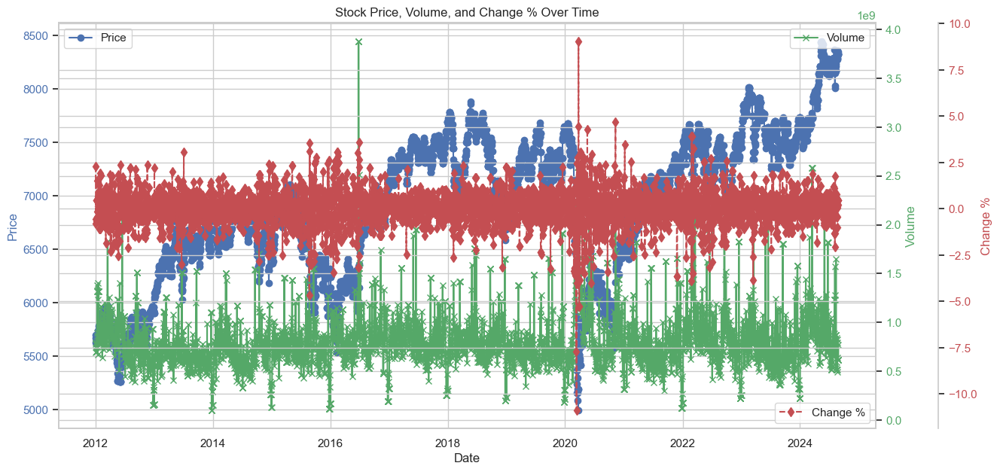

In [746]:
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure that the seaborn style is applied for better aesthetics
sns.set(style="whitegrid")

# Create a figure and axis objects
fig, ax1 = plt.subplots(figsize=(14, 7))

# Plot the closing price
ax1.plot(stocks_df['Date'], stocks_df['Price'], color='b', marker='o', label='Price')
ax1.set_xlabel('Date')
ax1.set_ylabel('Price', color='b')
ax1.tick_params(axis='y', labelcolor='b')

# Create a twin axis to plot volume
ax2 = ax1.twinx()
ax2.plot(stocks_df['Date'], stocks_df['Vol.'], color='g', marker='x', label='Volume')
ax2.set_ylabel('Volume', color='g')
ax2.tick_params(axis='y', labelcolor='g')

# Create another twin axis to plot percentage change
ax3 = ax1.twinx()
ax3.spines['right'].set_position(('outward', 60))  # Offset the third axis
ax3.plot(stocks_df['Date'], stocks_df['Change %'], color='r', marker='d', linestyle='--', label='Change %')
ax3.set_ylabel('Change %', color='r')
ax3.tick_params(axis='y', labelcolor='r')

# Set the title
plt.title('Stock Price, Volume, and Change % Over Time')

# Show legends for each axis
ax1.legend(loc='upper left')
ax2.legend(loc='upper right')
ax3.legend(loc='lower right')

# Show grid for better readability
ax1.grid(True)

# Display the plot
plt.show()


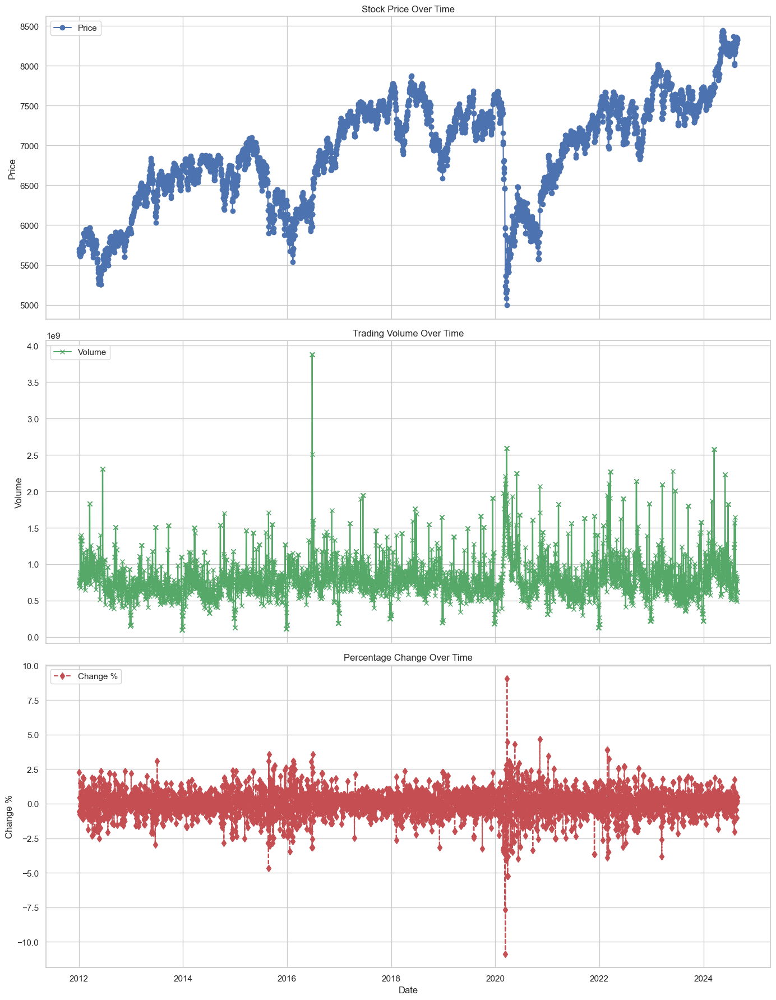

In [747]:
import matplotlib.pyplot as plt
import seaborn as sns

# Set the style for the plots
sns.set(style="whitegrid")

# Create a figure with 3 subplots, arranged vertically
fig, axs = plt.subplots(3, 1, figsize=(14, 18), sharex=True)

# Plot the Price
axs[0].plot(stocks_df['Date'], stocks_df['Price'], color='b', marker='o', linestyle='-', label='Price')
axs[0].set_ylabel('Price')
axs[0].set_title('Stock Price Over Time')
axs[0].legend(loc='upper left')
axs[0].grid(True)

# Plot the Volume
axs[1].plot(stocks_df['Date'], stocks_df['Vol.'], color='g', marker='x', linestyle='-', label='Volume')
axs[1].set_ylabel('Volume')
axs[1].set_title('Trading Volume Over Time')
axs[1].legend(loc='upper left')
axs[1].grid(True)

# Plot the Change %
axs[2].plot(stocks_df['Date'], stocks_df['Change %'], color='r', marker='d', linestyle='--', label='Change %')
axs[2].set_ylabel('Change %')
axs[2].set_title('Percentage Change Over Time')
axs[2].legend(loc='upper left')
axs[2].grid(True)

# Set the x-axis label for the bottom plot
axs[2].set_xlabel('Date')

# Adjust the layout to avoid overlapping labels
plt.tight_layout()

# Show the plots
plt.show()


In [748]:
stocks_grouped_df = stocks_df.groupby('Date').mean().reset_index()
stocks_grouped_df = stocks_grouped_df.rename(columns={'Date':'date'})
stocks_grouped_df

,date,Price,Open,High,Low,Vol.,Change %
0,2012-01-03,5699.91,5572.28,5699.91,5572.28,778530000.0,2.29
1,2012-01-04,5668.45,5699.91,5719.83,5646.36,696940000.0,-0.55
2,2012-01-05,5624.26,5668.45,5689.33,5614.38,794280000.0,-0.78
3,2012-01-06,5649.68,5624.26,5682.78,5623.36,705020000.0,0.45
4,2012-01-07,5649.68,5624.26,5682.78,5623.36,705020000.0,0.45
...,...,...,...,...,...,...,...
4616,2024-08-23,8327.78,8288.00,8331.90,8288.00,614510000.0,0.48
4617,2024-08-24,8327.78,8288.00,8331.90,8288.00,614510000.0,0.48
4618,2024-08-25,8327.78,8288.00,8331.90,8288.00,614510000.0,0.48
4619,2024-08-26,8327.78,8288.00,8331.90,8288.00,614510000.0,0.48


In [749]:
stocks_grouped_df['Vol.'].max()/1000000, stocks_grouped_df['Vol.'].min()/1000000

(3880.0, 101.67)

In [750]:
stocks_grouped_df['Vol.'] = stocks_grouped_df['Vol.']/1000000

In [751]:
df_clean['date'] = pd.to_datetime(df['date'])

In [752]:
# Convert 'Date' and 'date' to datetime
stocks_grouped_df['date'] = pd.to_datetime(stocks_grouped_df['date'], format='%d/%m/%Y')
df_clean['date'] = pd.to_datetime(df_clean['date'], format='%d/%m/%Y')

# Combine Stocks Data & News Data

In [840]:
# Merge DataFrames on the date column
merged_df = pd.merge(stocks_grouped_df, df_clean, on='date', how='left')
merged_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2012-01-03,5699.91,5572.28,5699.91,5572.28,778.53,2.29,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2012-01-04,5668.45,5699.91,5719.83,5646.36,696.94,-0.55,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2012-01-05,5624.26,5668.45,5689.33,5614.38,794.28,-0.78,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2012-01-06,5649.68,5624.26,5682.78,5623.36,705.02,0.45,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2012-01-07,5649.68,5624.26,5682.78,5623.36,705.02,0.45,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4616,2024-08-23,8327.78,8288.00,8331.90,8288.00,614.51,0.48,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4617,2024-08-24,8327.78,8288.00,8331.90,8288.00,614.51,0.48,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4618,2024-08-25,8327.78,8288.00,8331.90,8288.00,614.51,0.48,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4619,2024-08-26,8327.78,8288.00,8331.90,8288.00,614.51,0.48,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [841]:
merged_df.ffill(inplace=True)
merged_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2012-01-03,5699.91,5572.28,5699.91,5572.28,778.53,2.29,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2012-01-04,5668.45,5699.91,5719.83,5646.36,696.94,-0.55,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2012-01-05,5624.26,5668.45,5689.33,5614.38,794.28,-0.78,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2012-01-06,5649.68,5624.26,5682.78,5623.36,705.02,0.45,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2012-01-07,5649.68,5624.26,5682.78,5623.36,705.02,0.45,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4616,2024-08-23,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4617,2024-08-24,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4618,2024-08-25,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4619,2024-08-26,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [842]:
merged_df = merged_df.fillna(merged_df.mean(numeric_only=True))
merged_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2012-01-03,5699.91,5572.28,5699.91,5572.28,778.53,2.29,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
1,2012-01-04,5668.45,5699.91,5719.83,5646.36,696.94,-0.55,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
2,2012-01-05,5624.26,5668.45,5689.33,5614.38,794.28,-0.78,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
3,2012-01-06,5649.68,5624.26,5682.78,5623.36,705.02,0.45,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
4,2012-01-07,5649.68,5624.26,5682.78,5623.36,705.02,0.45,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4616,2024-08-23,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4617,2024-08-24,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4618,2024-08-25,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4619,2024-08-26,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000


In [843]:
merged_df_org = merged_df.copy()

# ACF & PCF

Processing column: Price


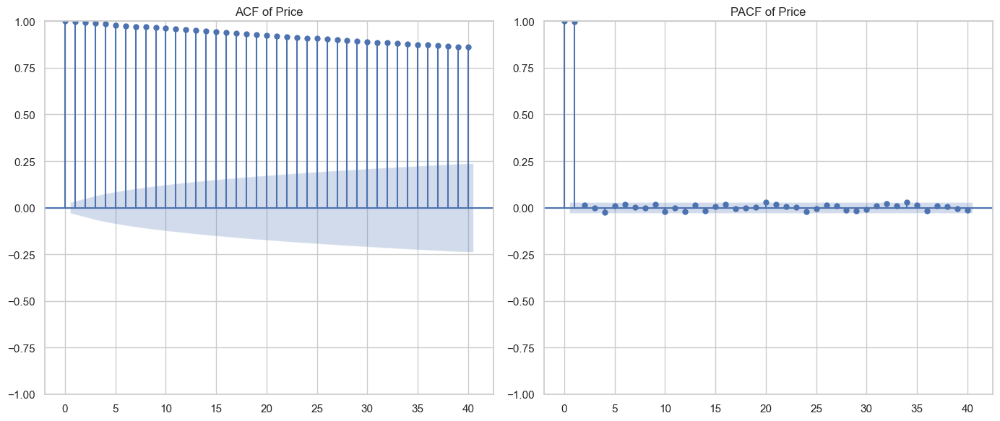

Processing column: Open


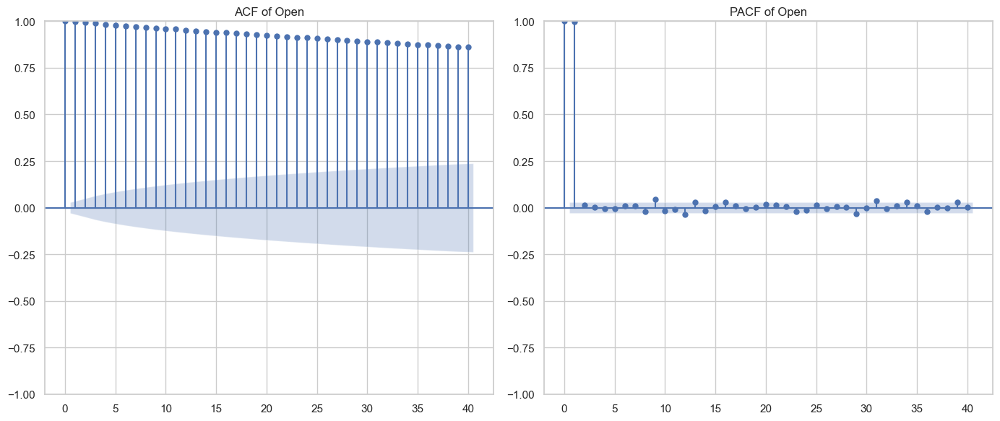

Processing column: High


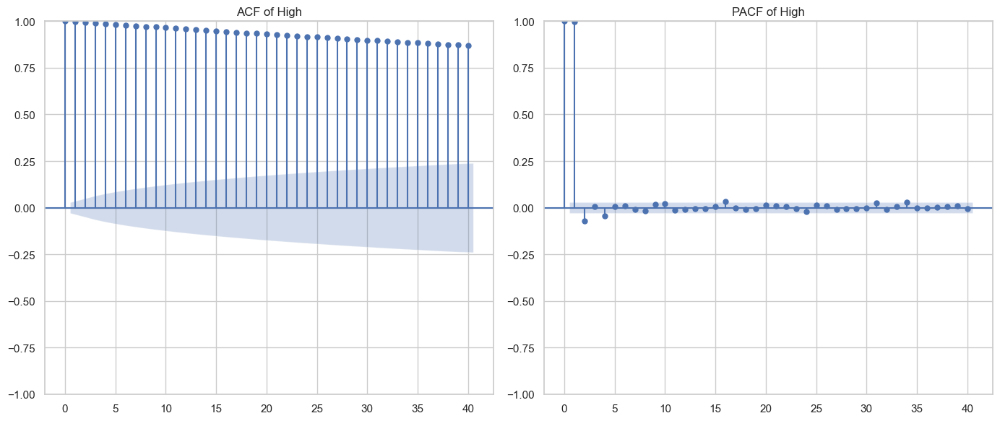

Processing column: Low


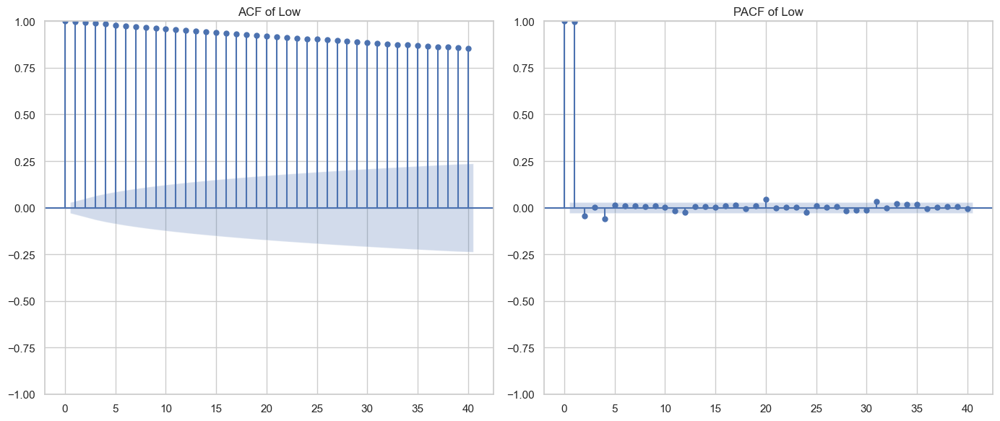

Processing column: Vol.


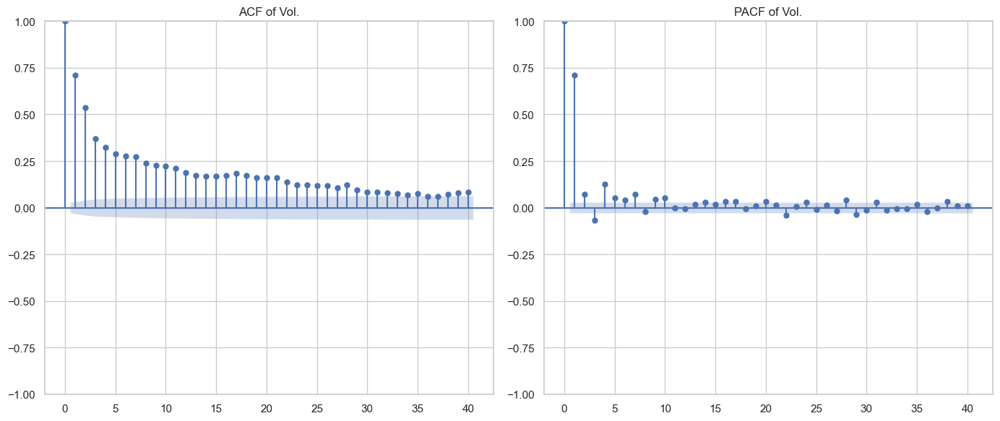

Processing column: Change %


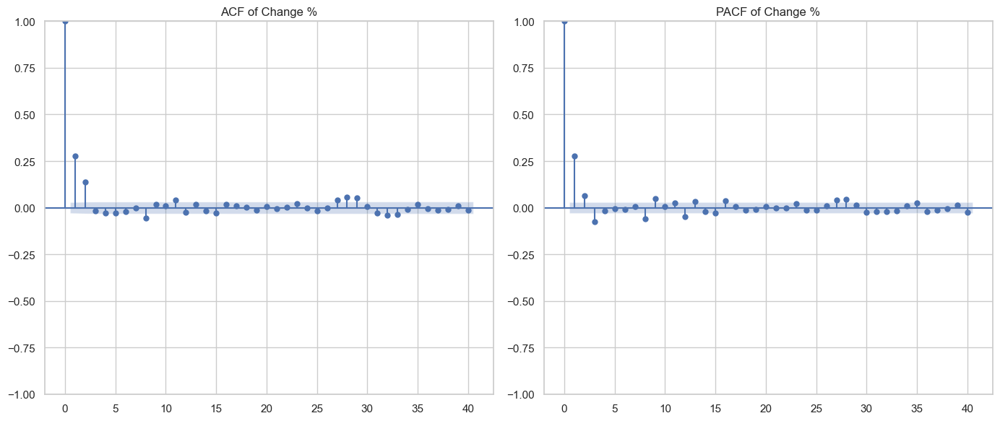

Processing column: vader_sentiment


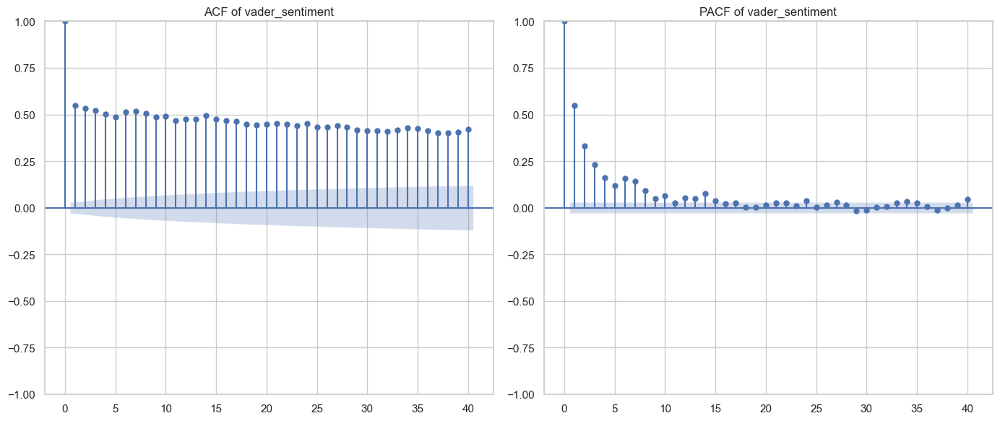

Processing column: textblob_sentiment


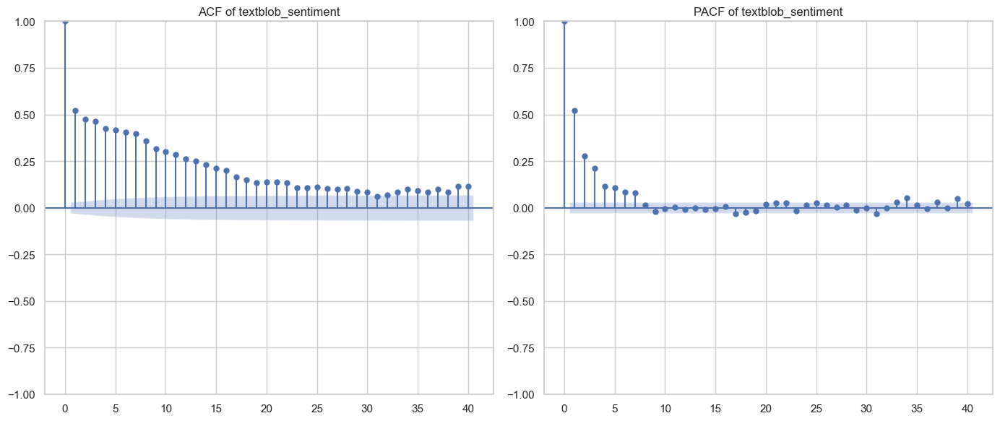

Processing column: is_event


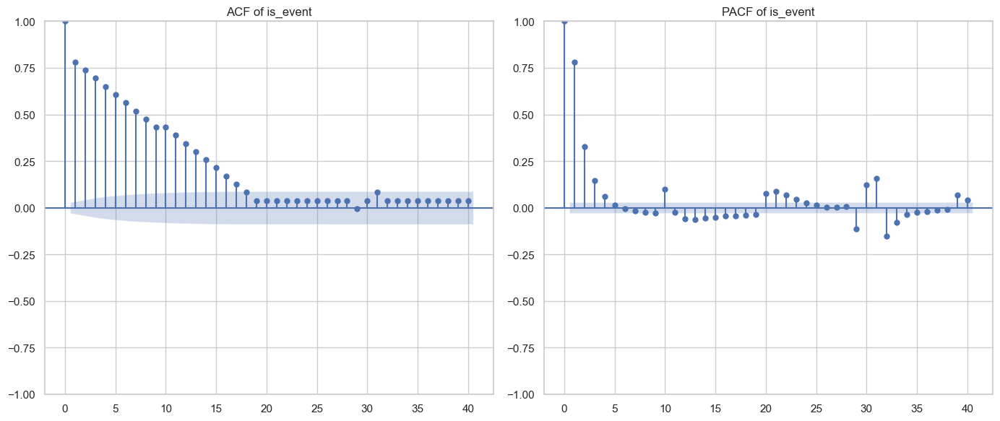

Processing column: topic_12


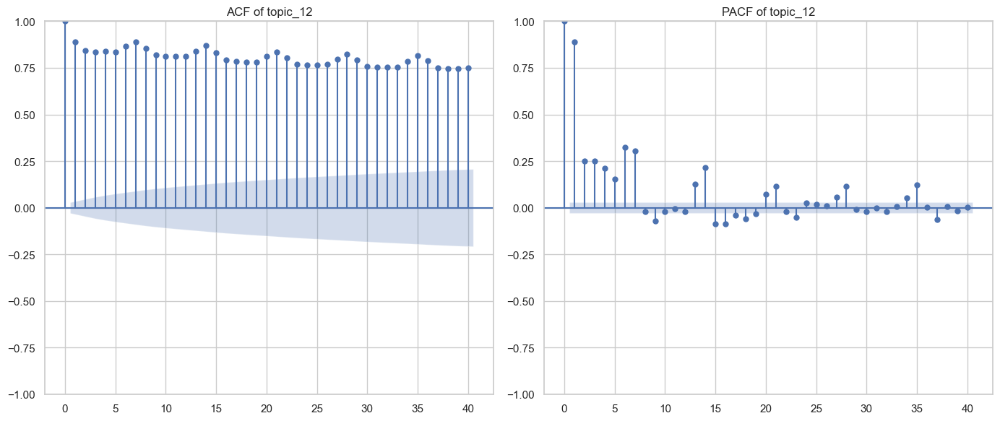

Processing column: topic_14


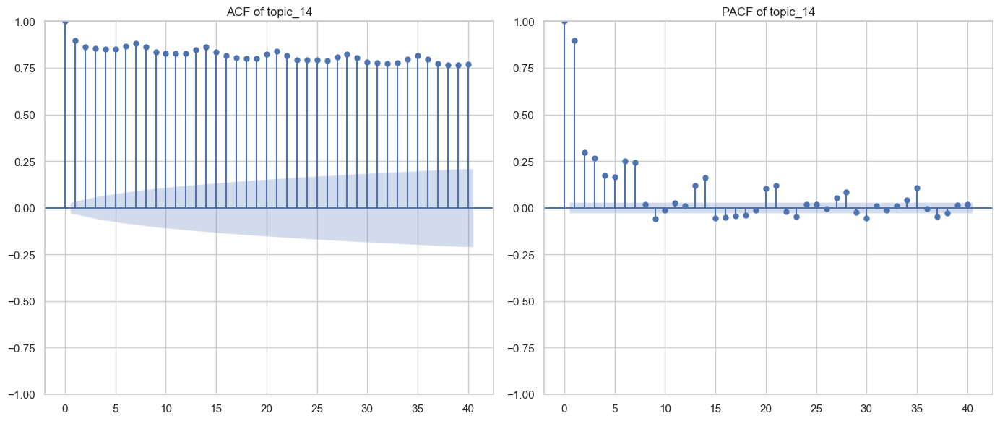

Processing column: topic_15


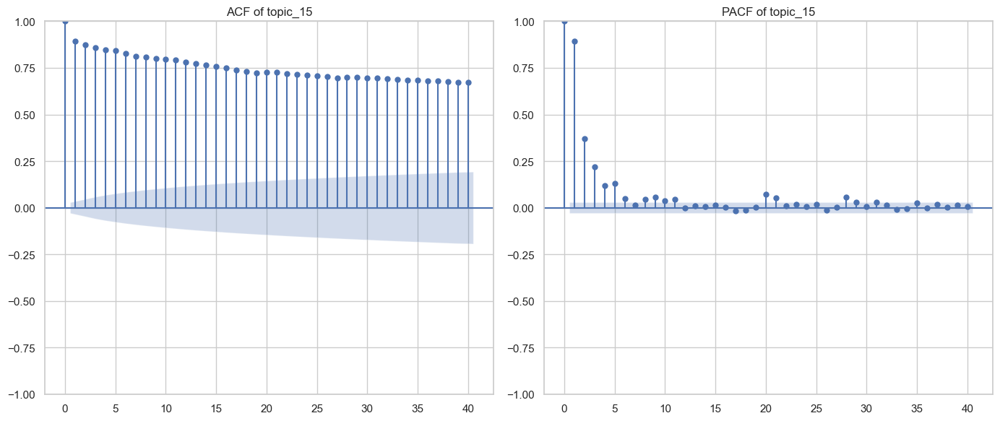

Processing column: topic_4


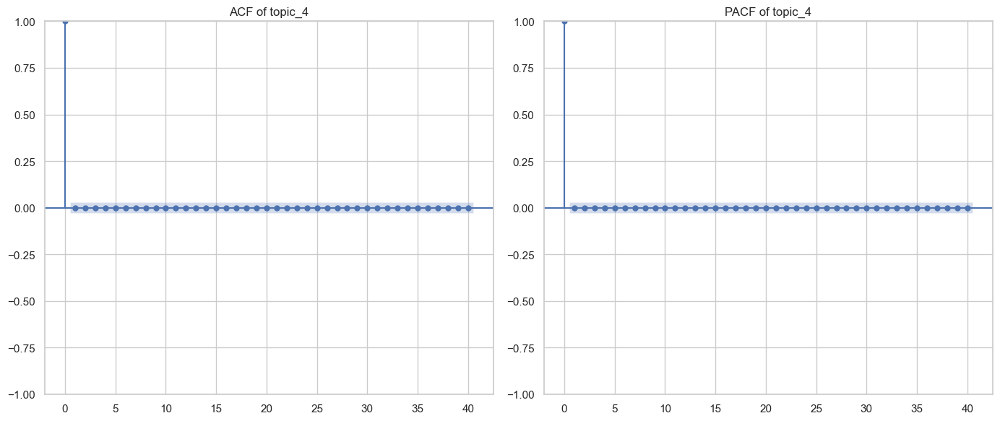

Processing column: topic_5


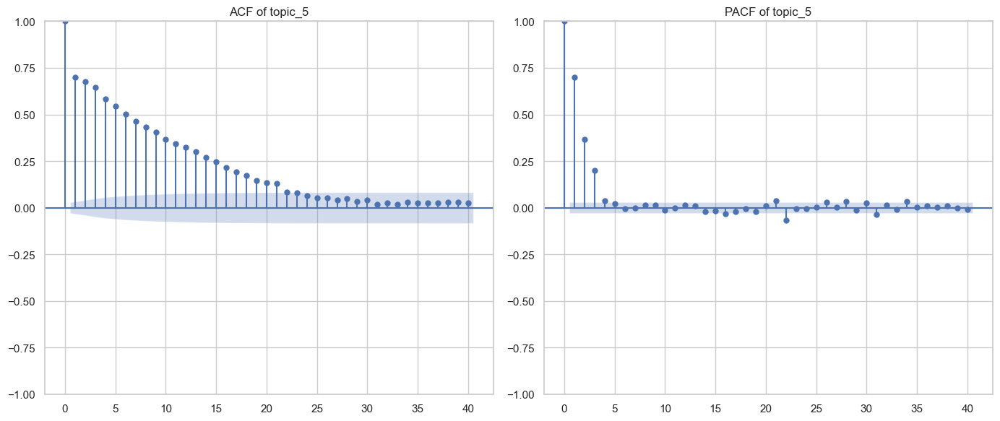

Processing column: topic_1


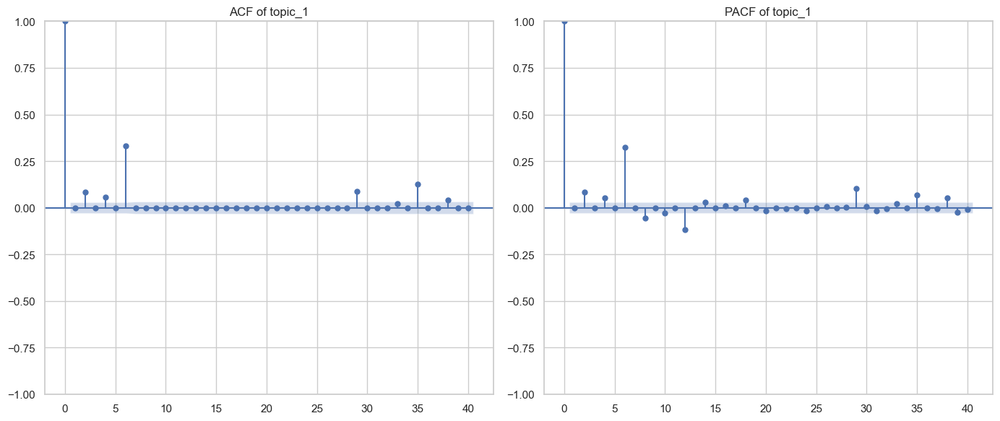

Processing column: topic_8


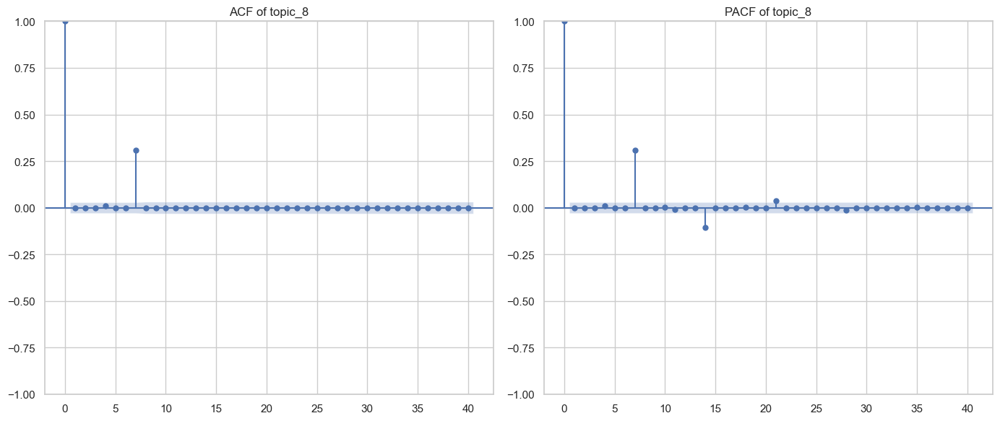

Processing column: topic_7


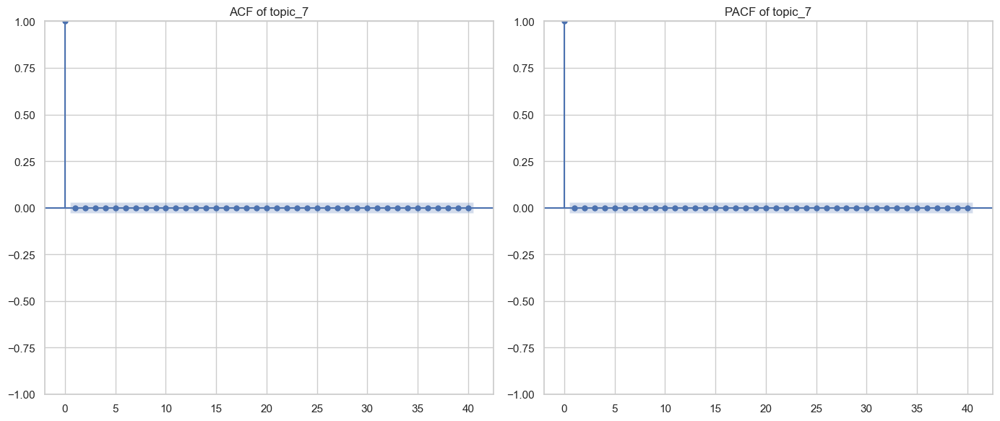

Processing column: topic_10


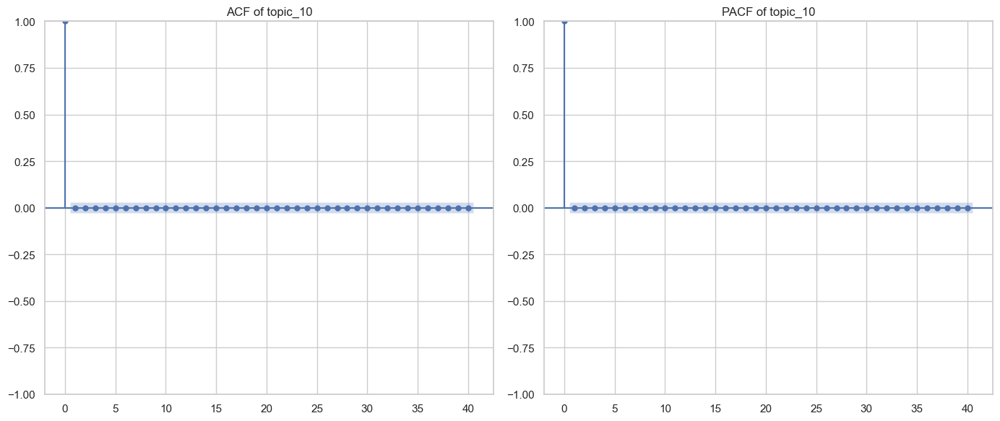

Processing column: topic_6


C:\Users\PRAGYA\anaconda3\Lib\site-packages\statsmodels\regression\linear_model.py:1489: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


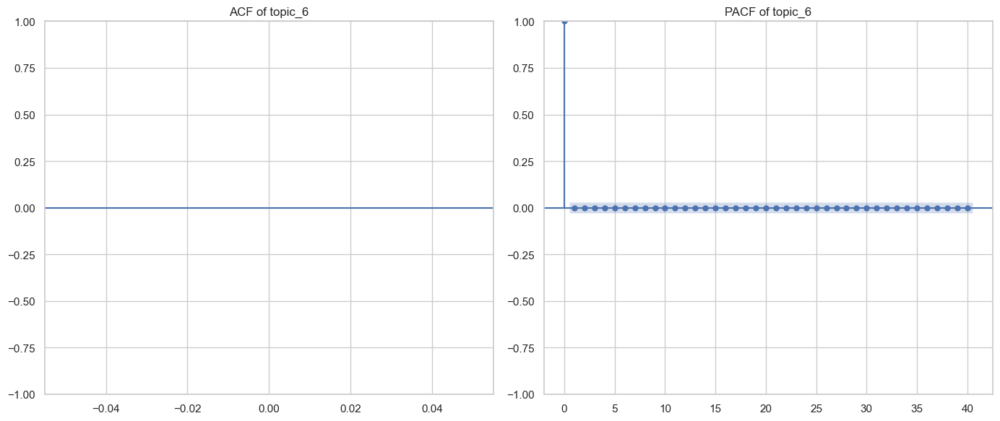

Processing column: topic_9


C:\Users\PRAGYA\anaconda3\Lib\site-packages\statsmodels\regression\linear_model.py:1489: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


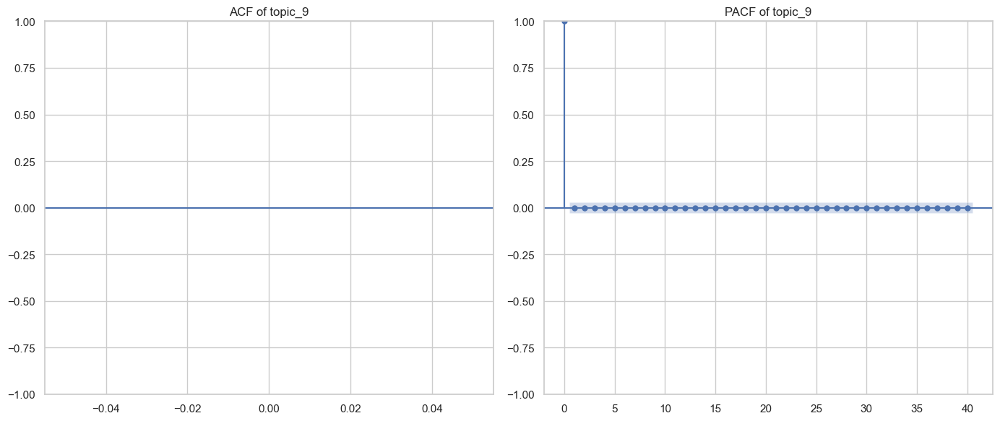

Processing column: topic_3


C:\Users\PRAGYA\anaconda3\Lib\site-packages\statsmodels\regression\linear_model.py:1489: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


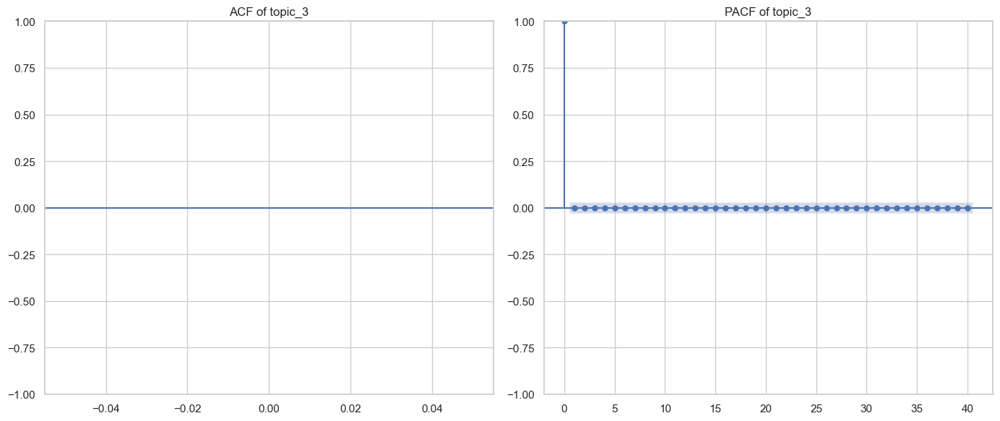

Processing column: topic_0


C:\Users\PRAGYA\anaconda3\Lib\site-packages\statsmodels\regression\linear_model.py:1489: ValueWarning: Matrix is singular. Using pinv.
  warnings.warn("Matrix is singular. Using pinv.", ValueWarning)


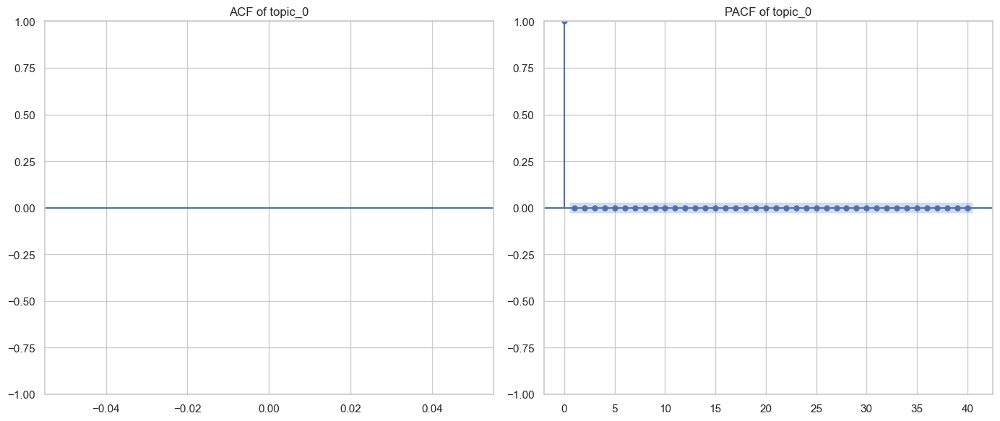

Processing column: CARDINAL_one


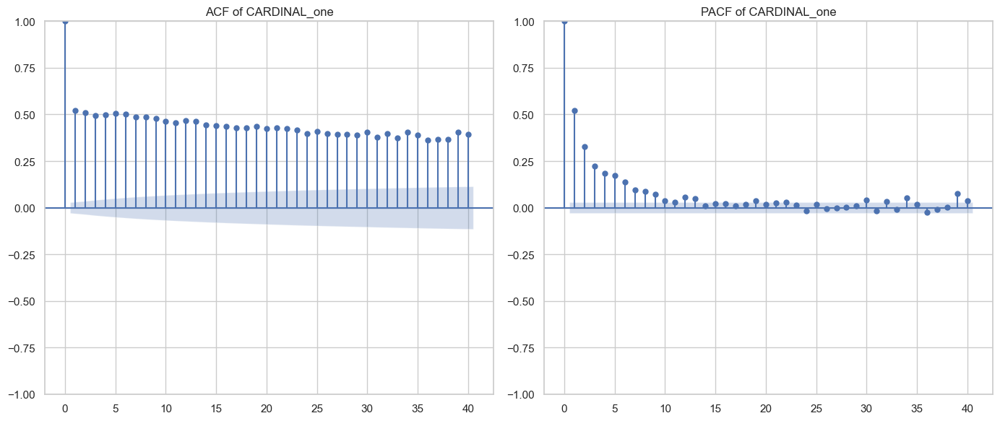

Processing column: CARDINAL_two


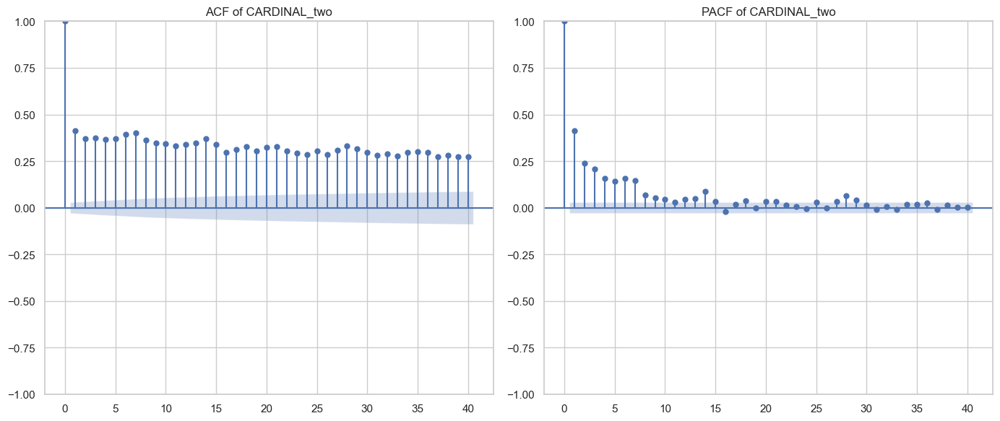

Processing column: CARDINAL_million


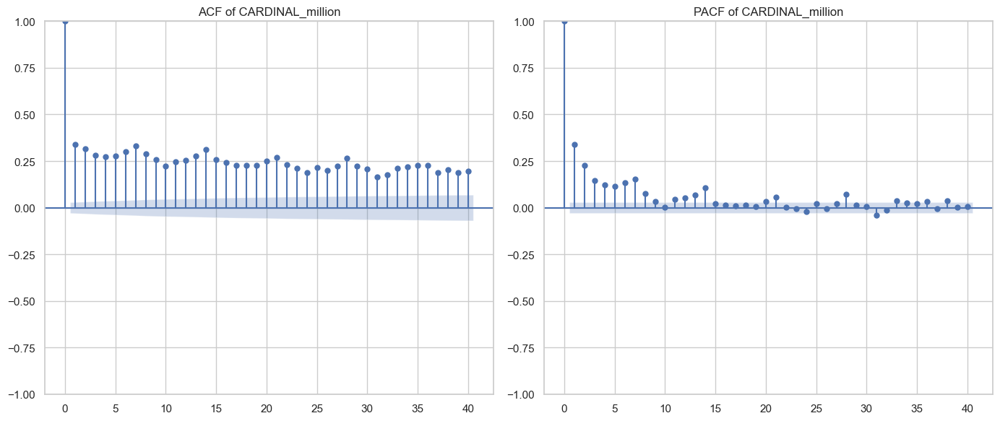

Processing column: CARDINAL_three


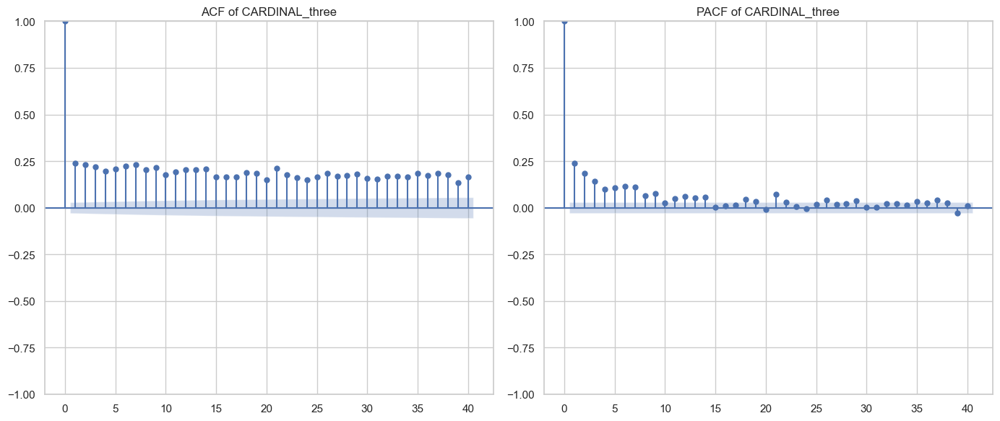

Processing column: CARDINAL_six


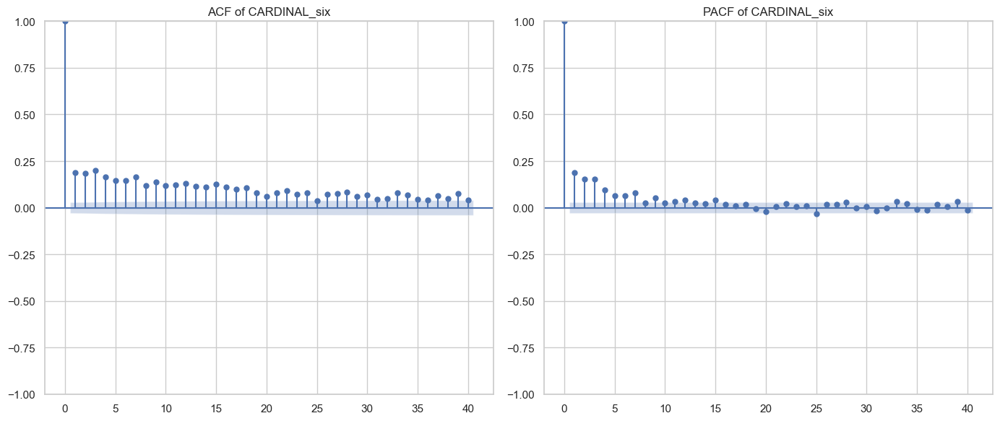

Processing column: EVENT_vietnam


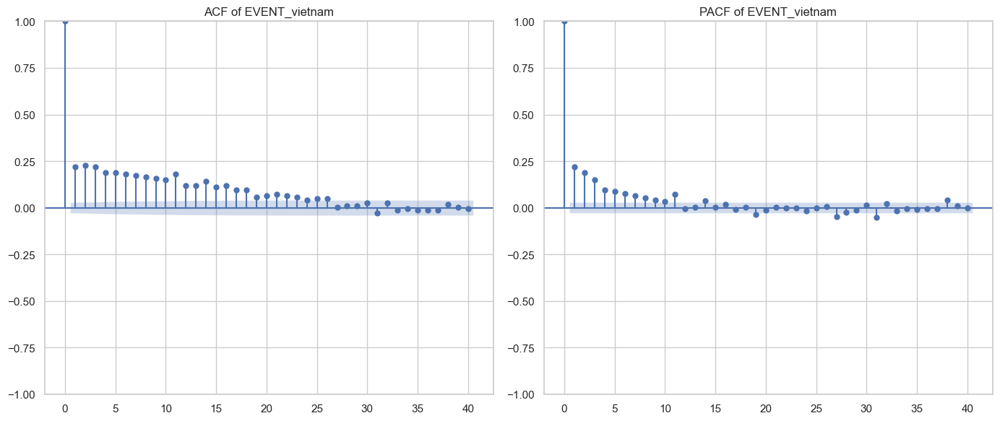

Processing column: EVENT_wwii


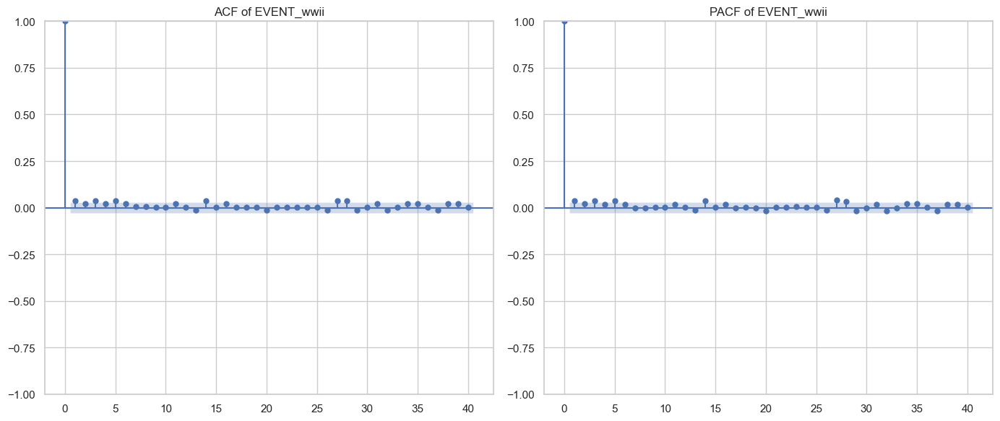

Processing column: EVENT_super bowl


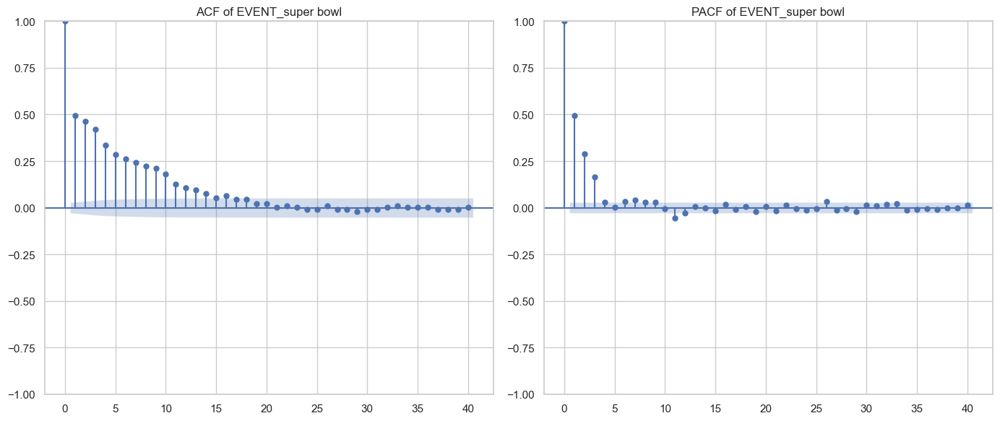

Processing column: EVENT_hurricane katrina


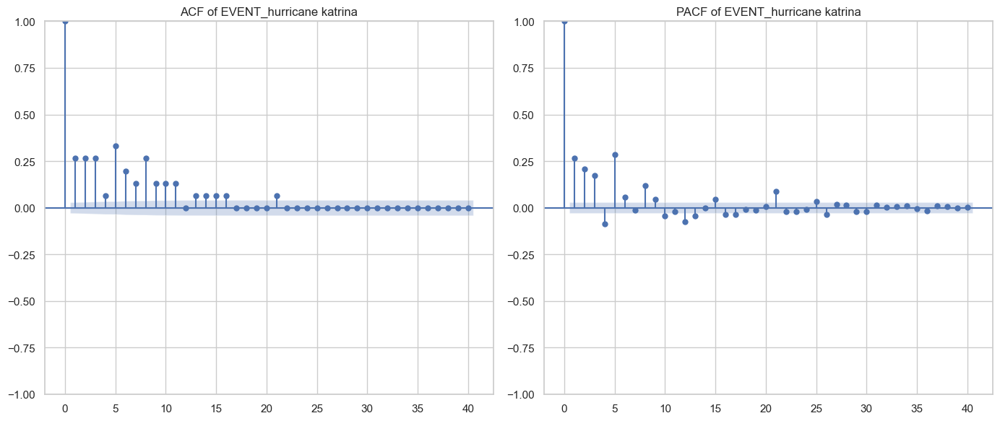

Processing column: EVENT_iraq war


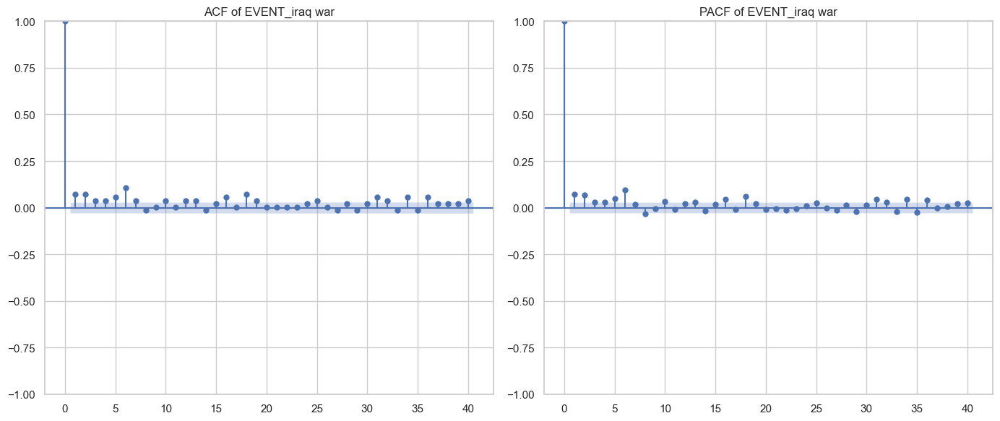

Processing column: FAC_guantanamo


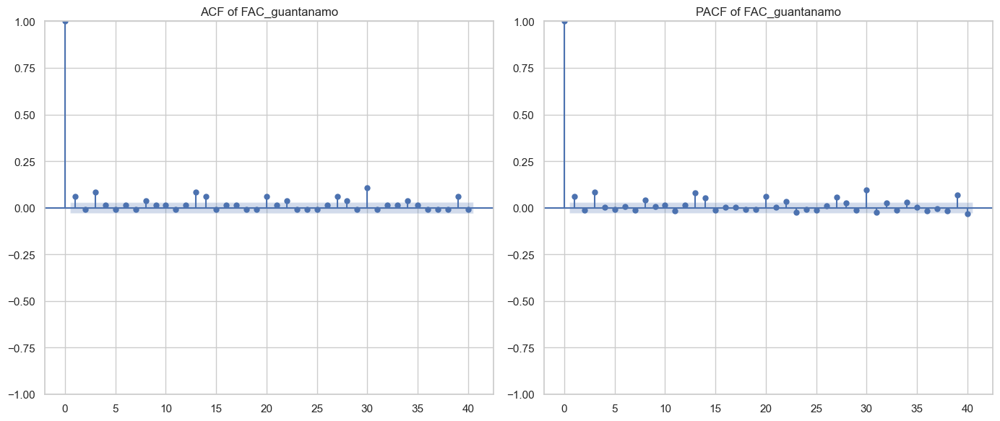

Processing column: FAC_uva


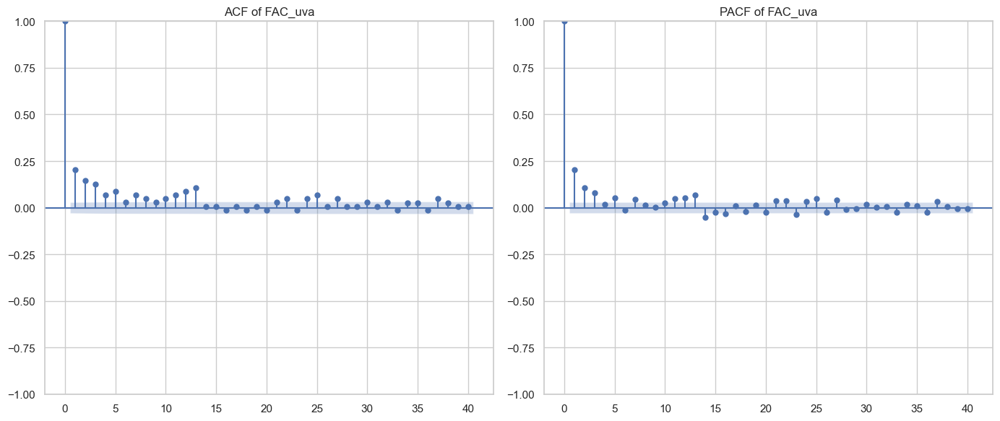

Processing column: FAC_notre dame


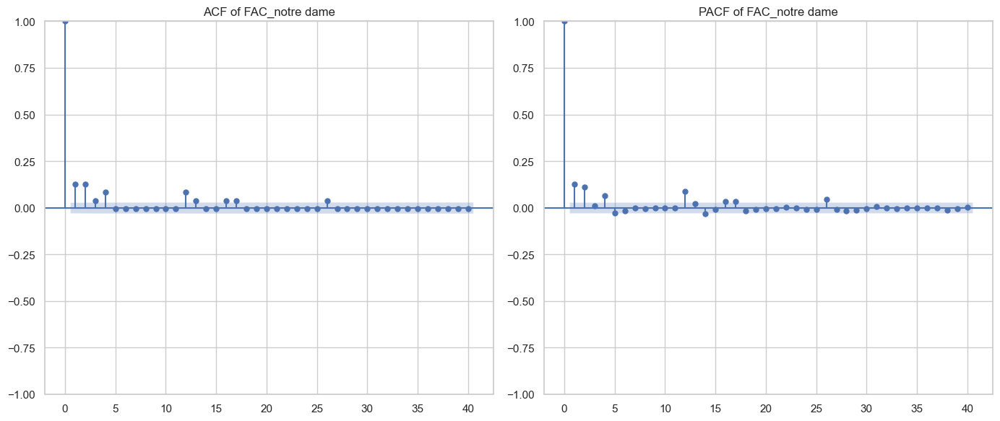

Processing column: FAC_north london


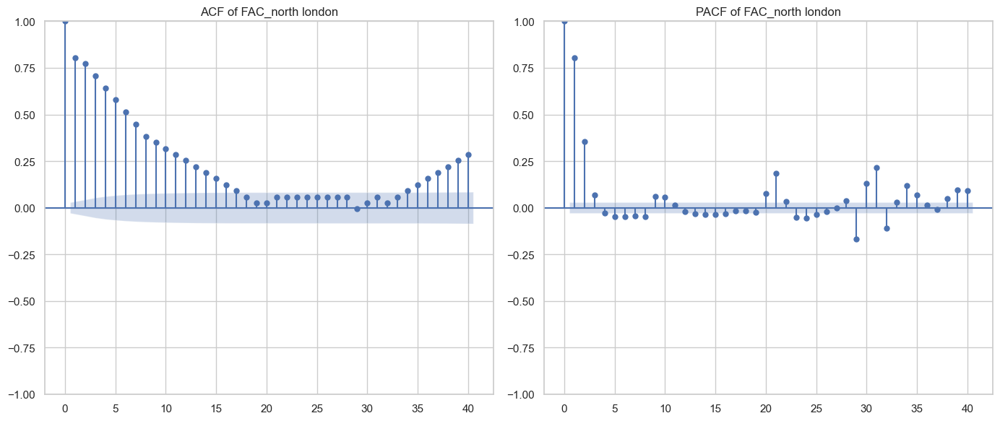

Processing column: FAC_nikki haley


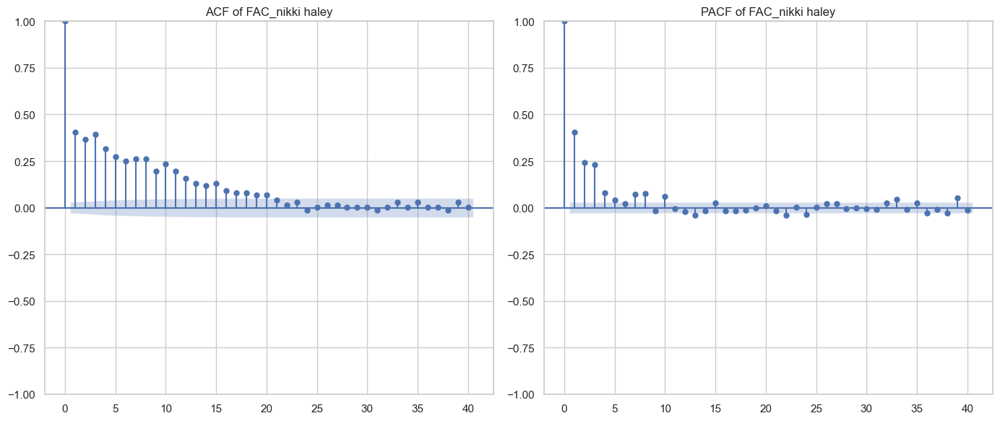

Processing column: GPE_london


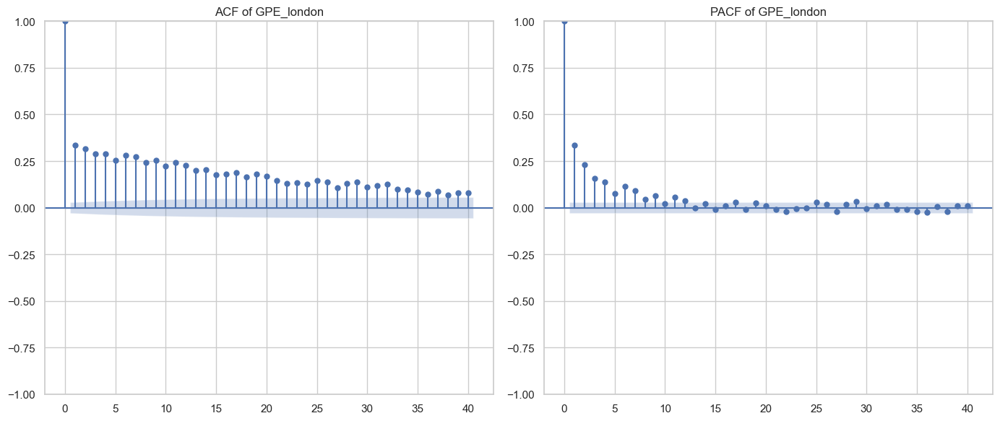

Processing column: GPE_russia


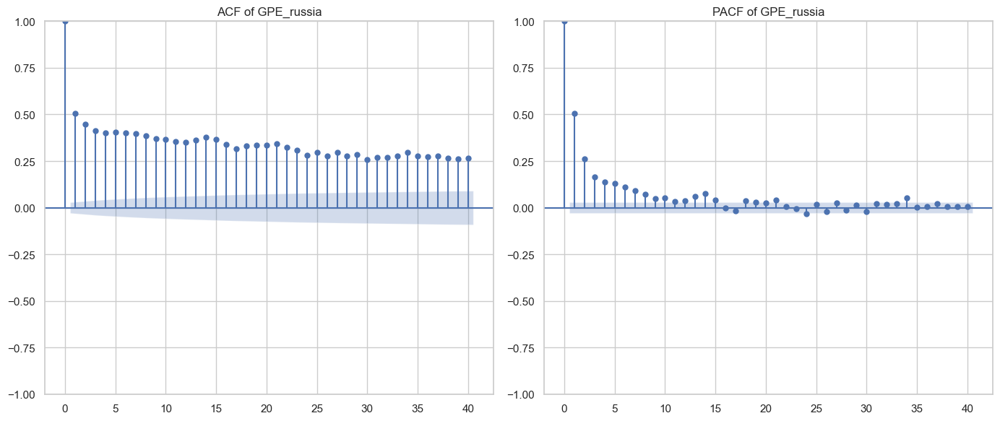

Processing column: GPE_america


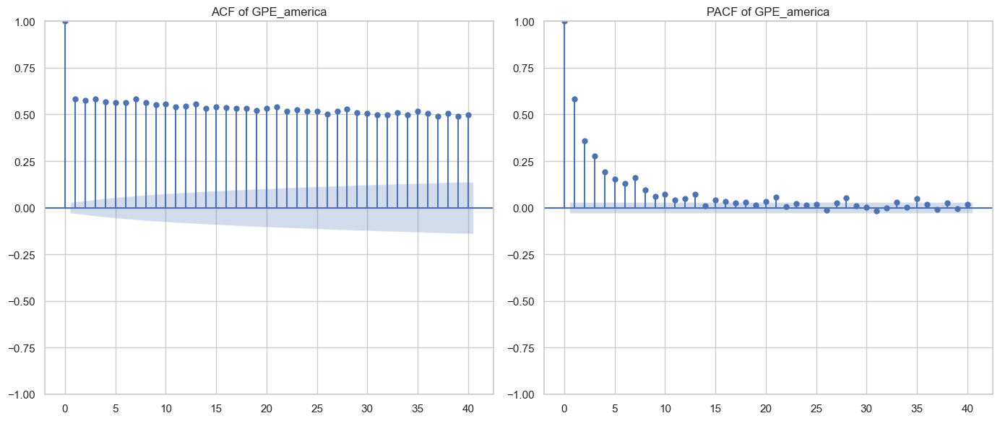

Processing column: GPE_california


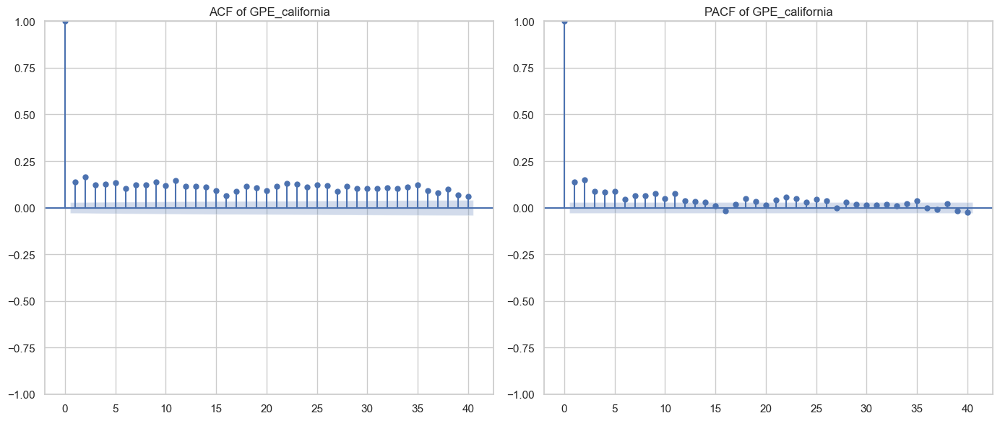

Processing column: GPE_china


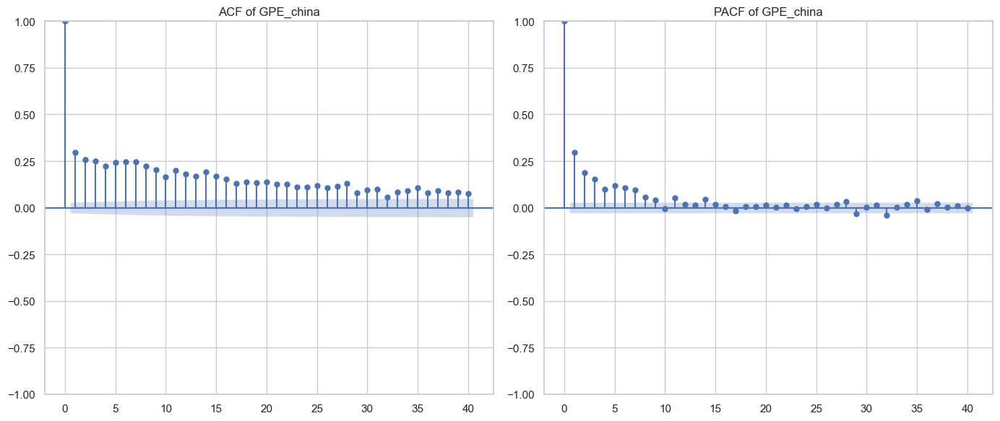

Processing column: LAW_rico


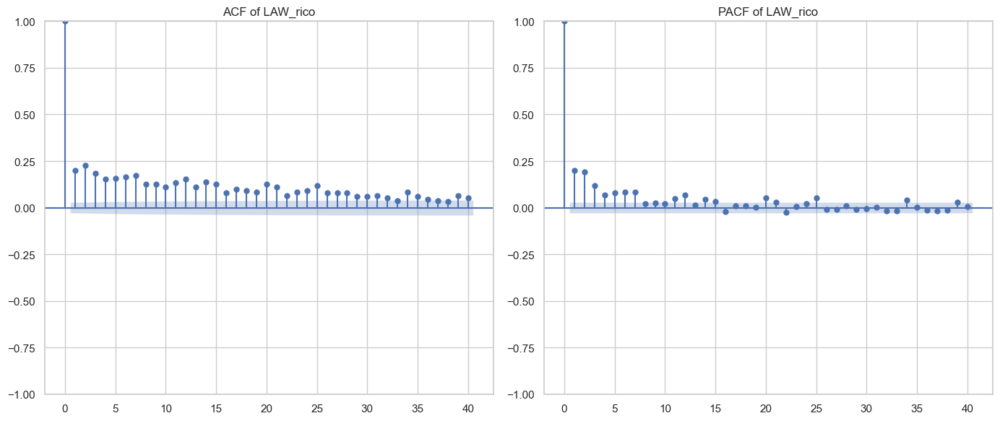

Processing column: LAW_camilla wear


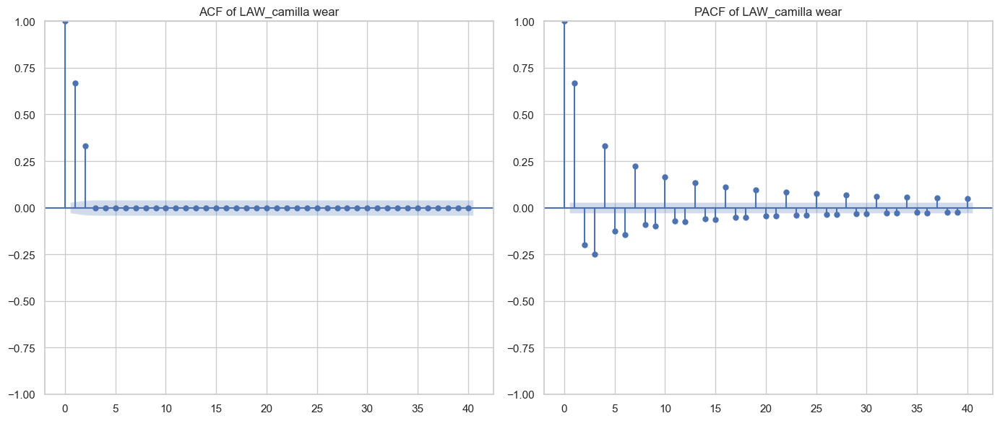

Processing column: LAW_crown new


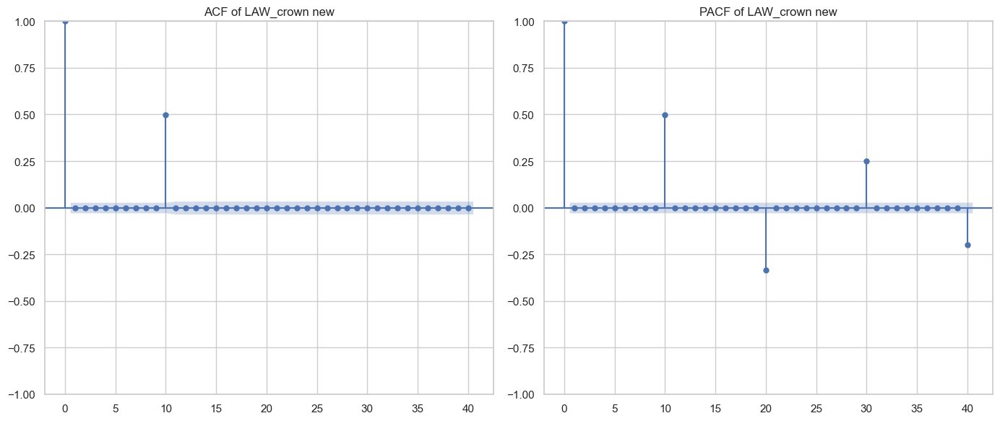

Processing column: LAW_superfund


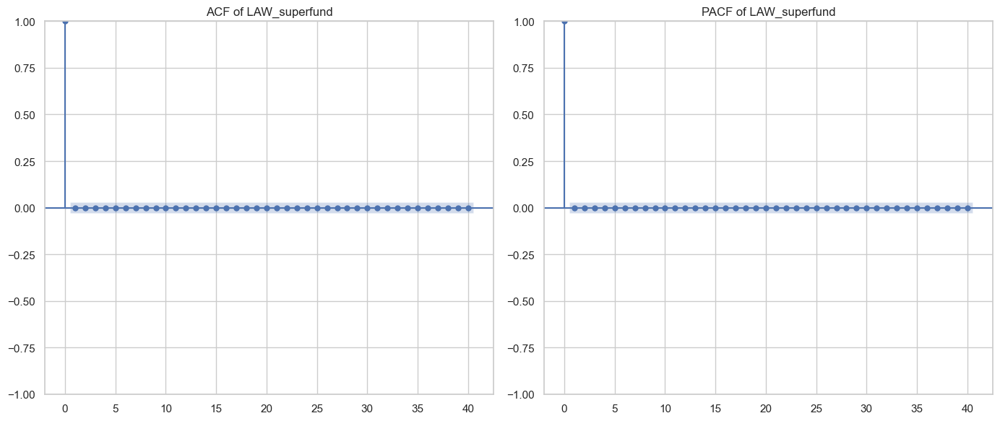

Processing column: LAW_west ham


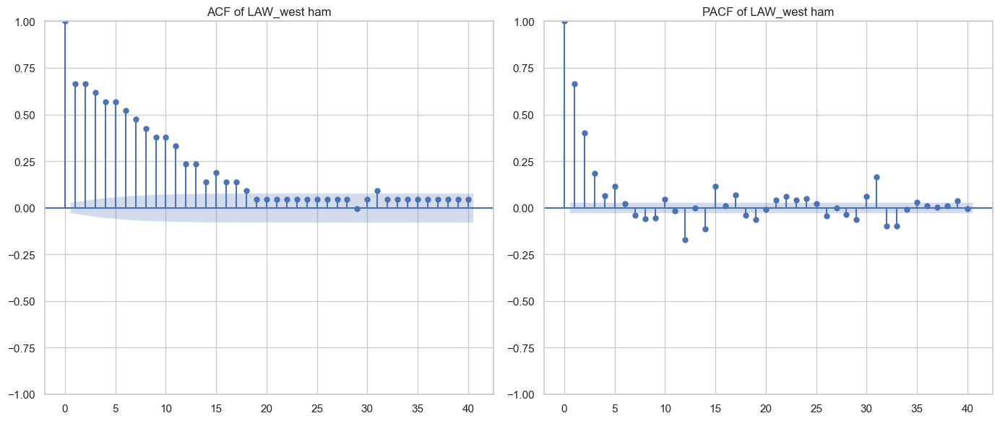

Processing column: LOC_europe


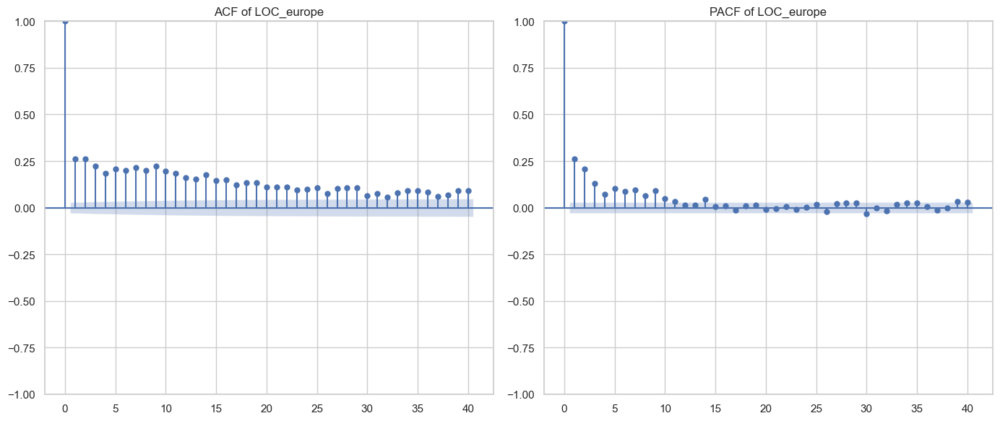

Processing column: LOC_middle east


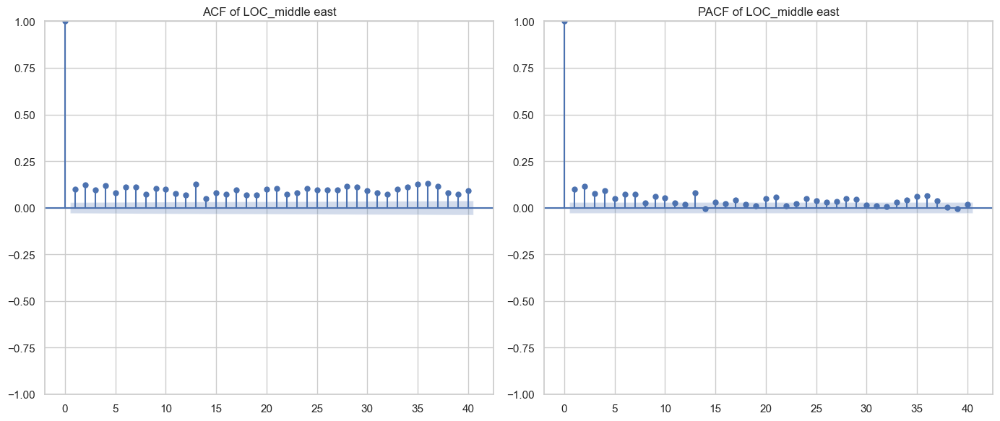

Processing column: LOC_africa


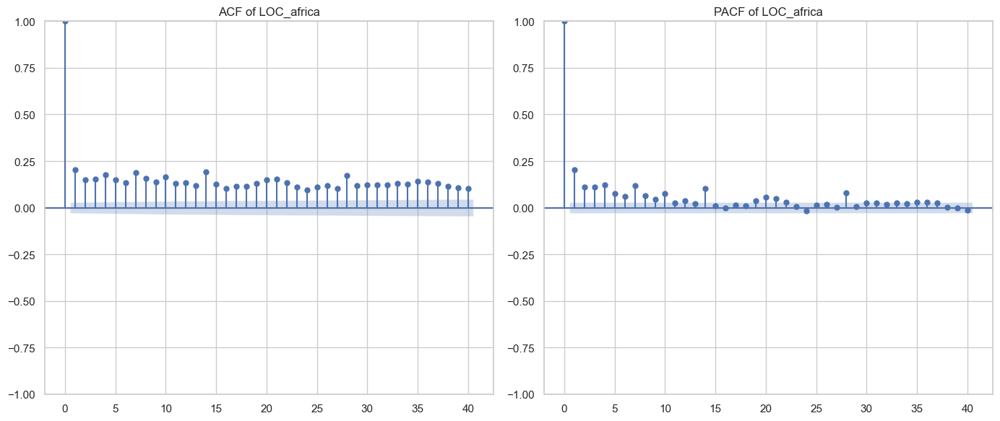

Processing column: LOC_caribbean


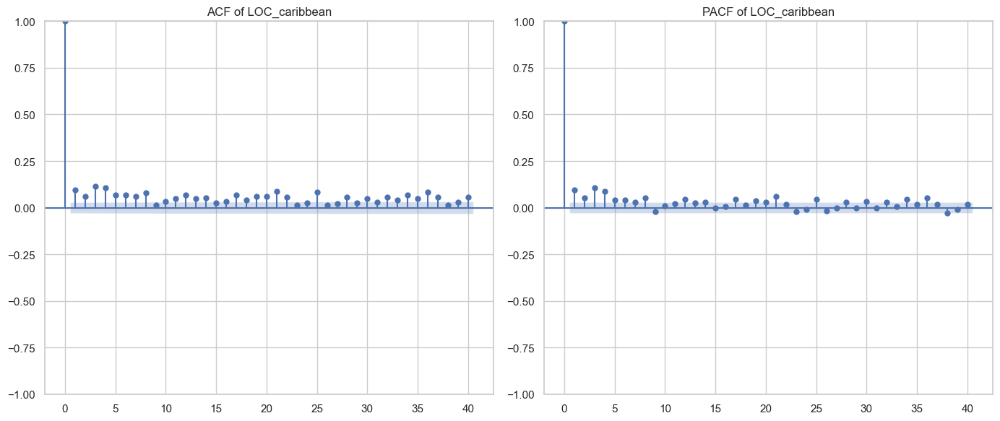

Processing column: LOC_asia


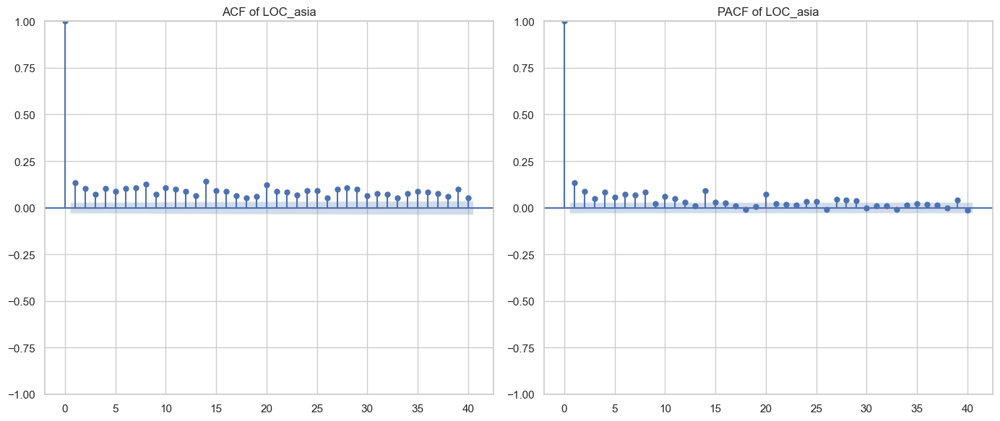

Processing column: MONEY_mike penny


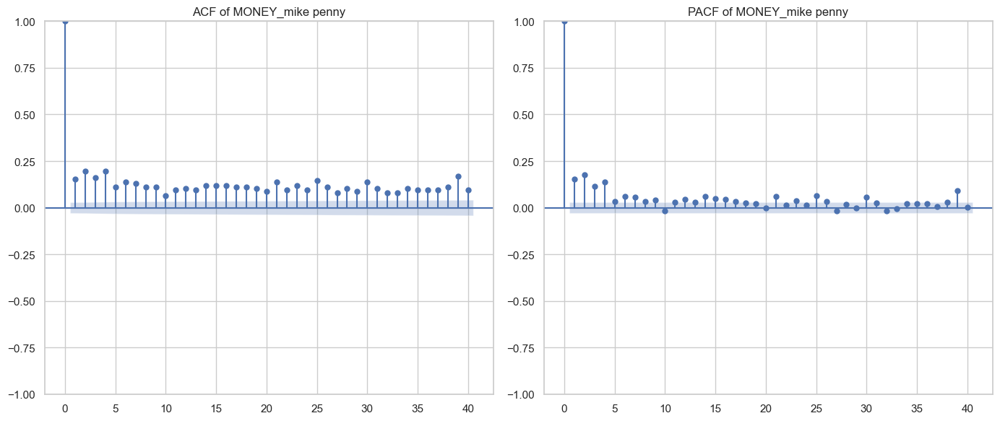

Processing column: MONEY_million dollar


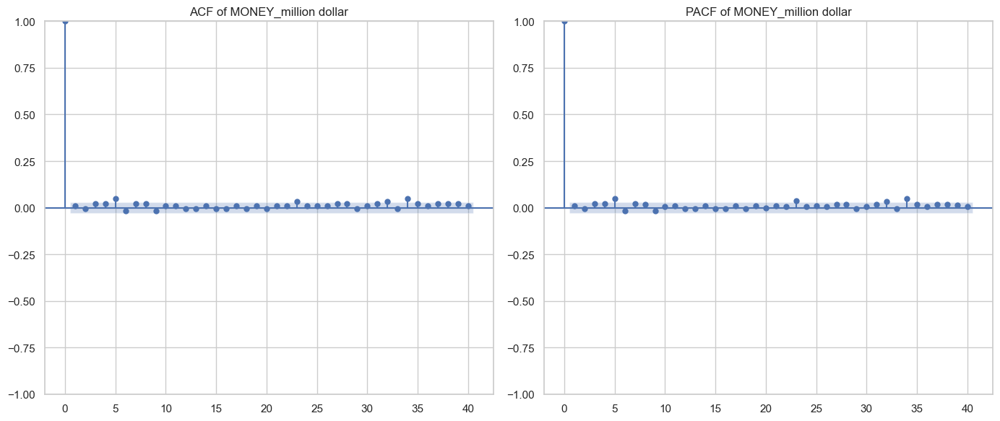

Processing column: MONEY_billion dollar


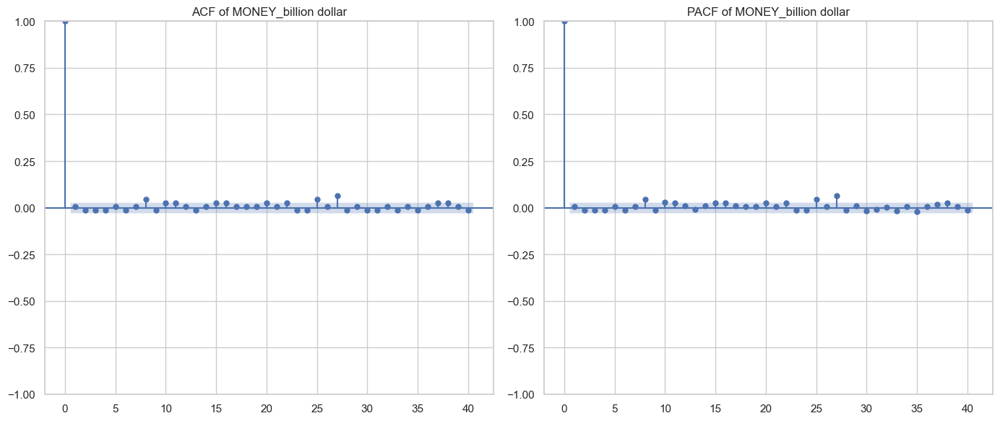

Processing column: MONEY_thousand dollar


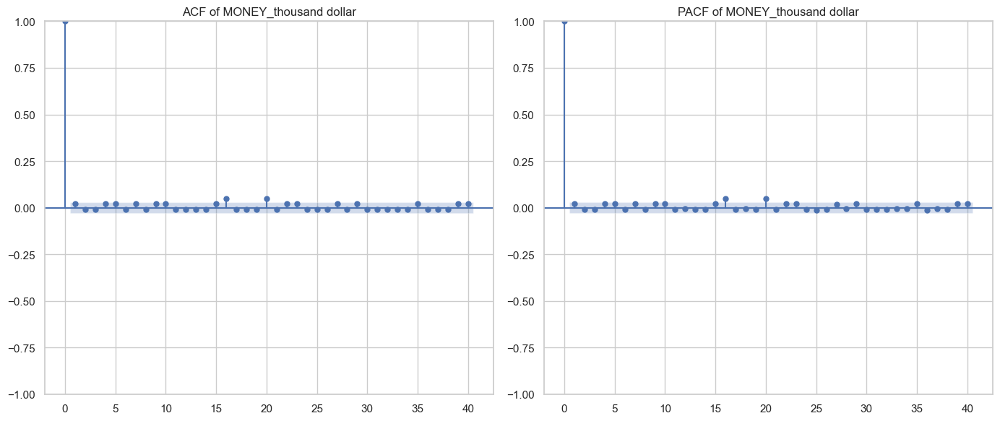

Processing column: MONEY_every penny


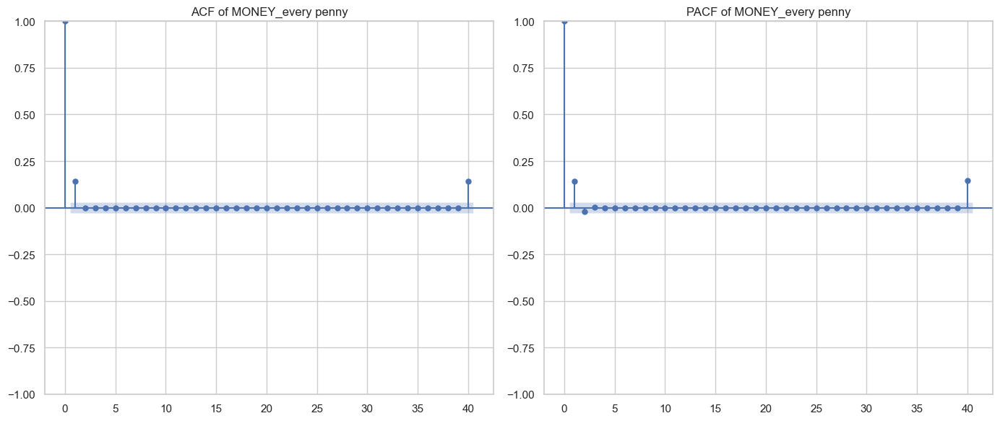

Processing column: NORP_american


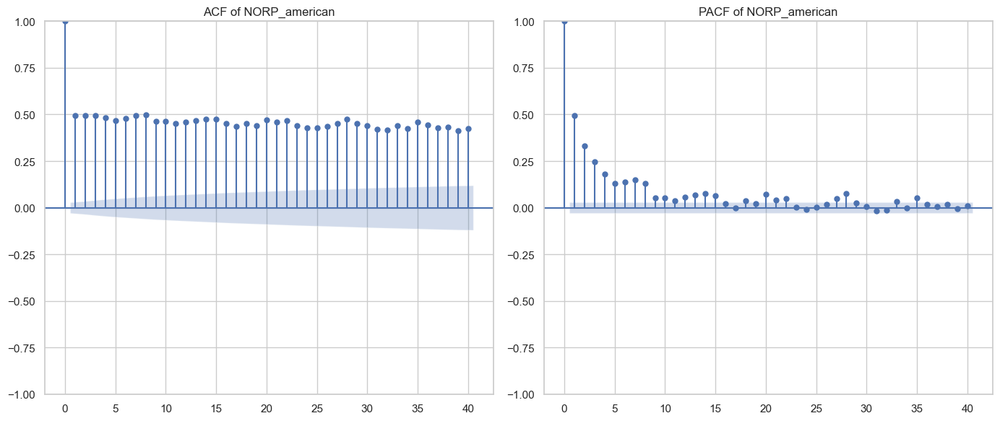

Processing column: NORP_republican


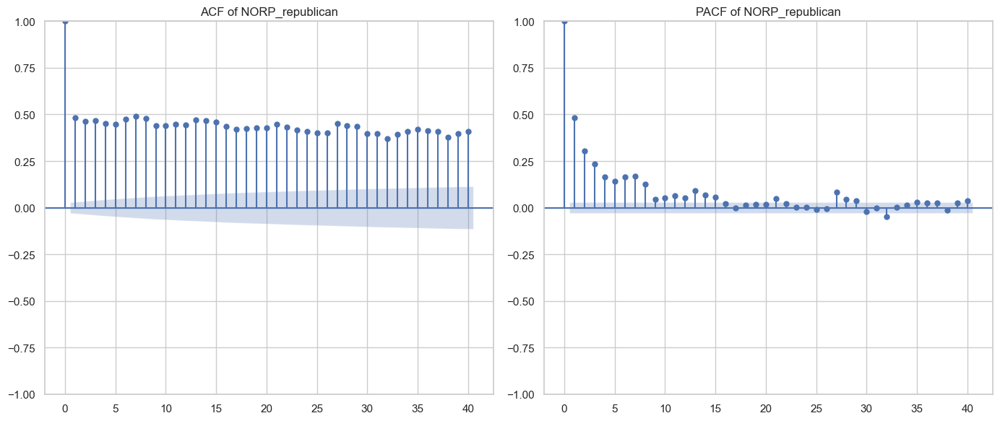

Processing column: NORP_democrat


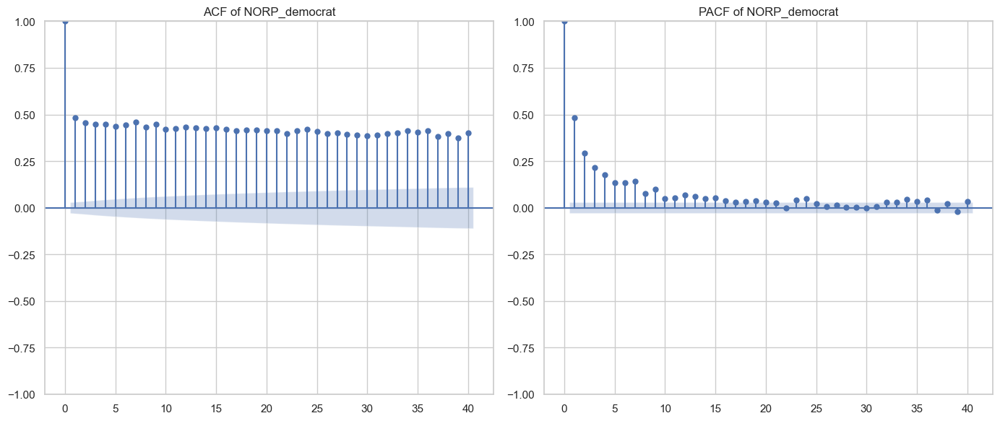

Processing column: NORP_russian


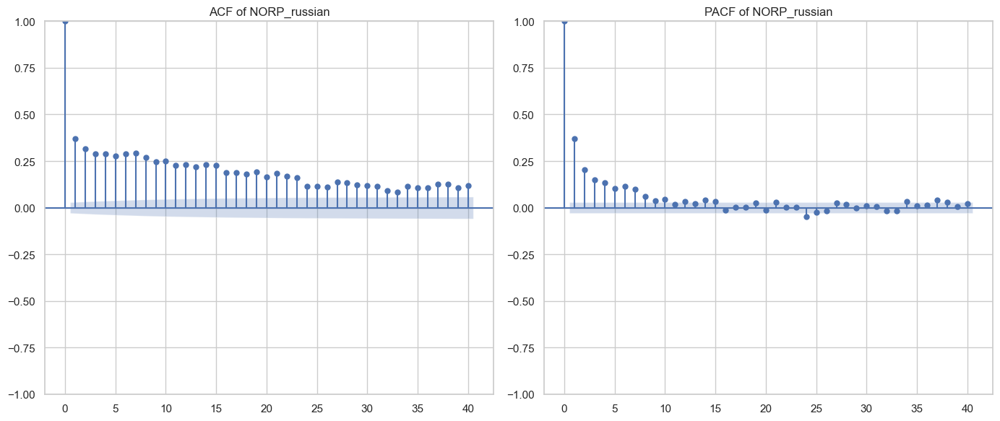

Processing column: NORP_muslim


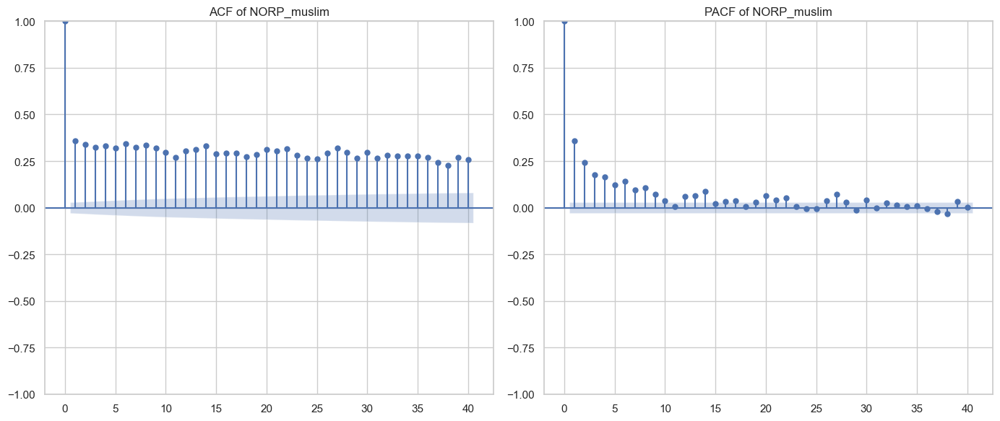

Processing column: ORDINAL_first


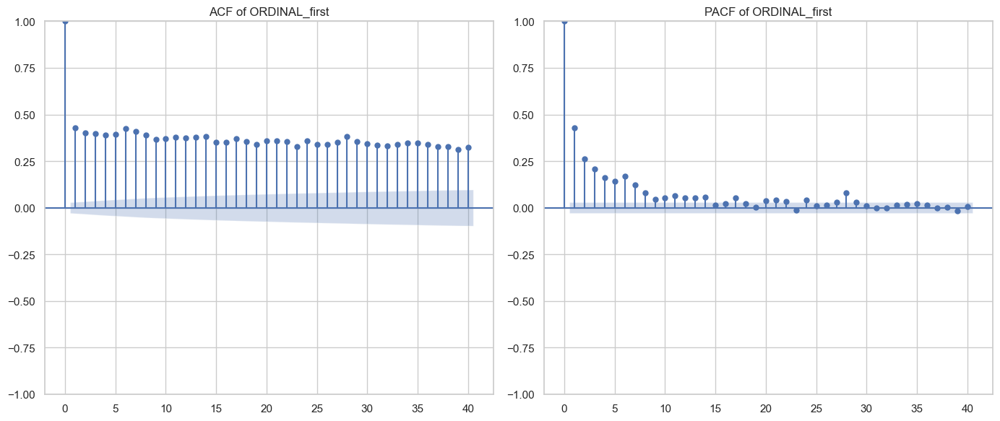

Processing column: ORDINAL_second


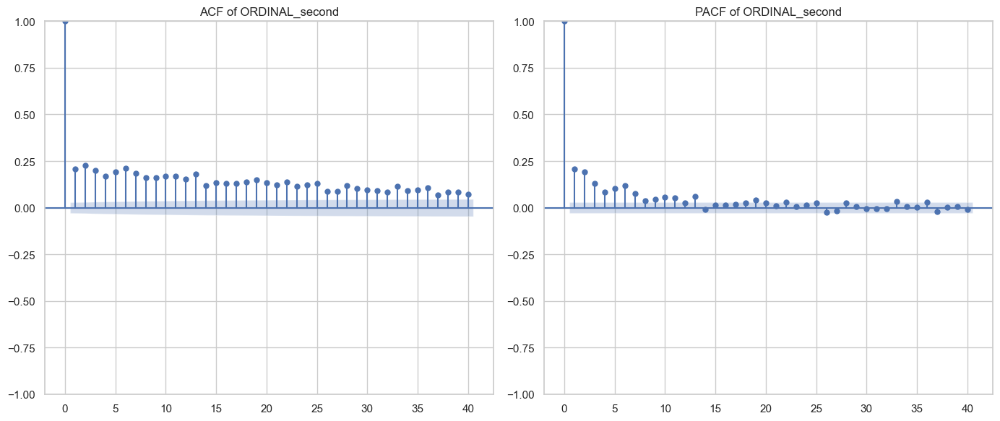

Processing column: ORDINAL_third


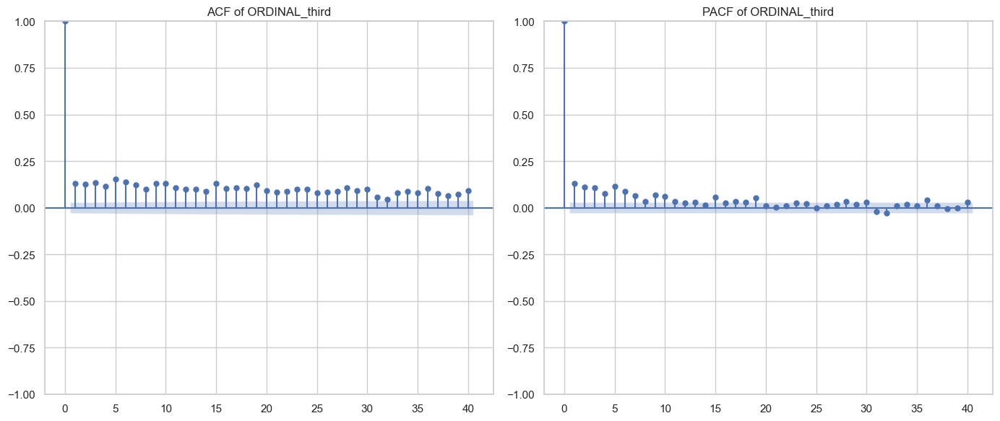

Processing column: ORDINAL_fourth


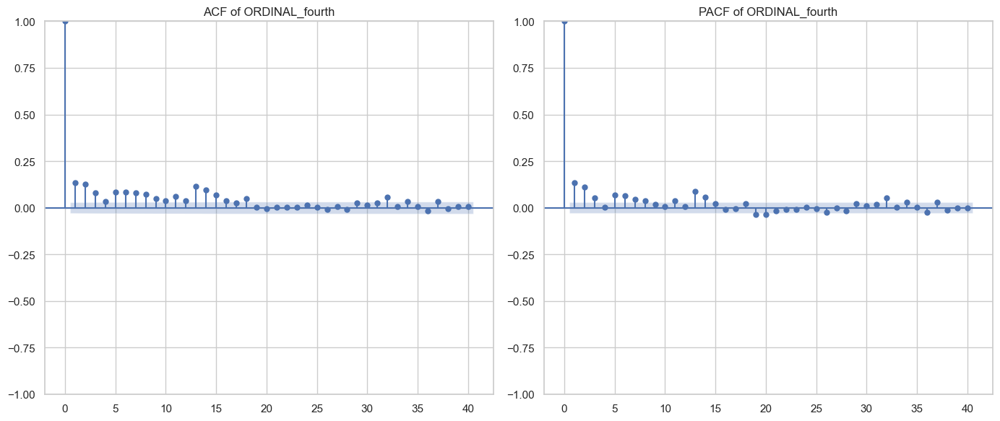

Processing column: ORDINAL_fifth


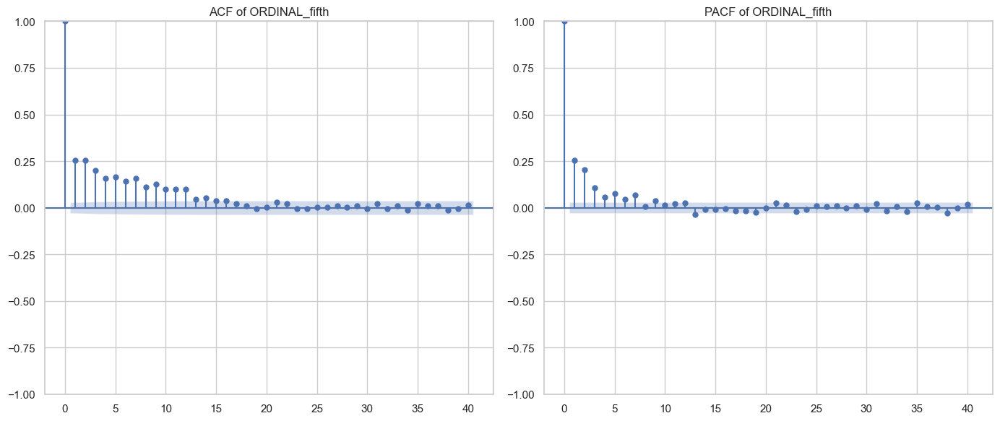

Processing column: ORG_gop


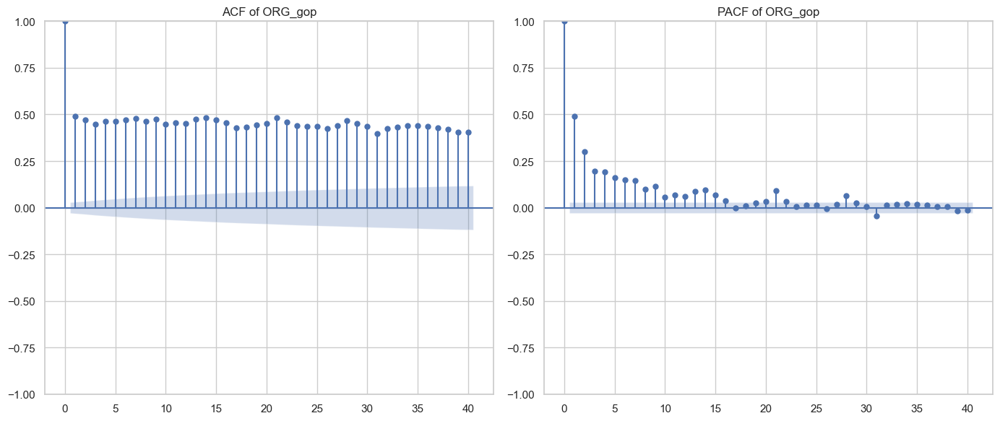

Processing column: ORG_senate


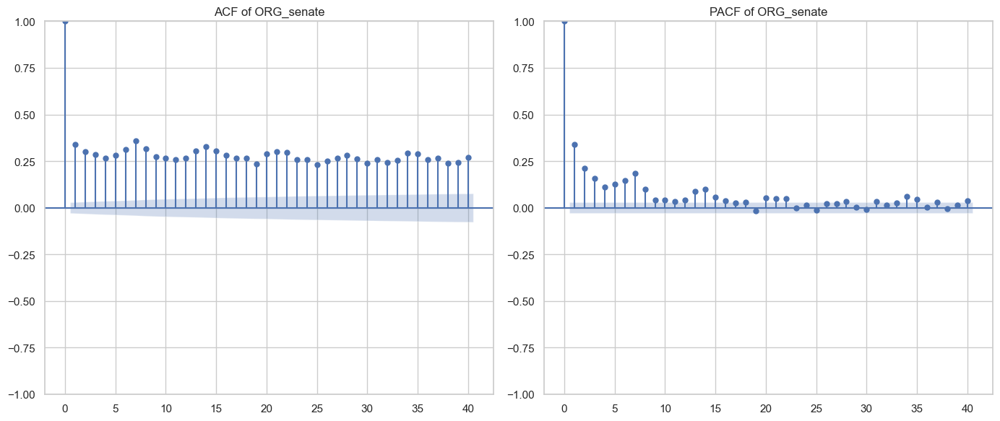

Processing column: ORG_white house


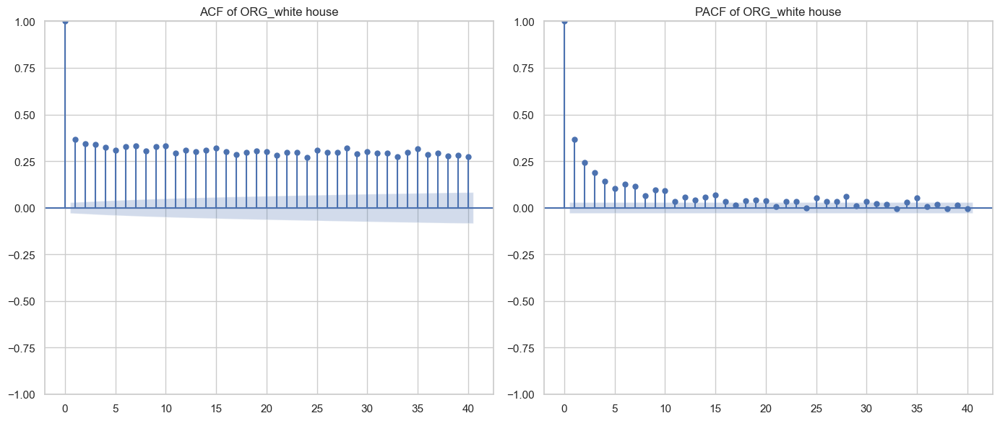

Processing column: ORG_congress


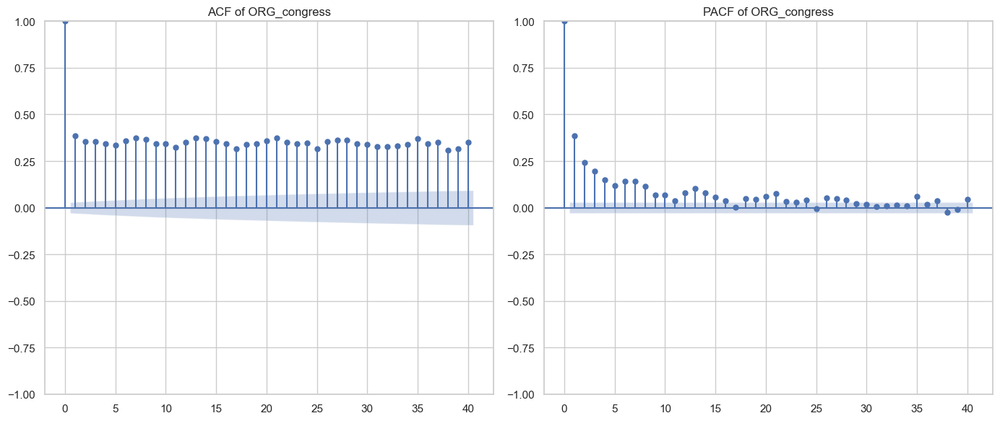

Processing column: ORG_supreme court


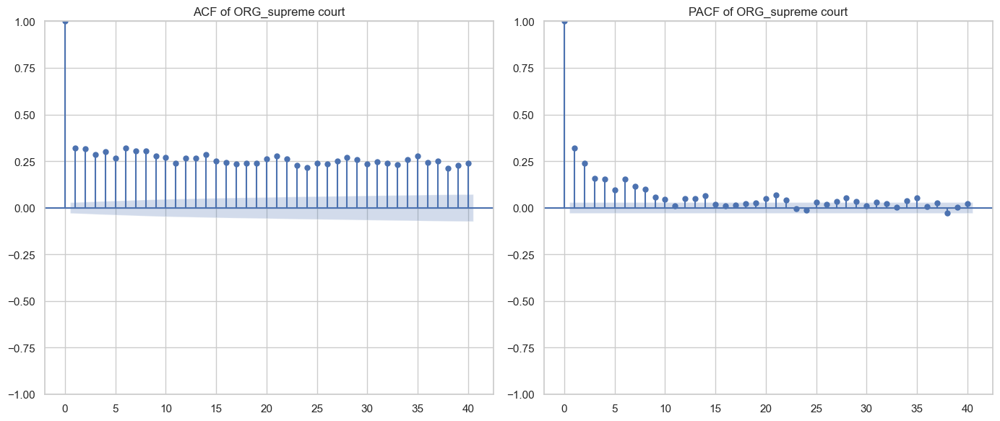

Processing column: PERCENT_one percent


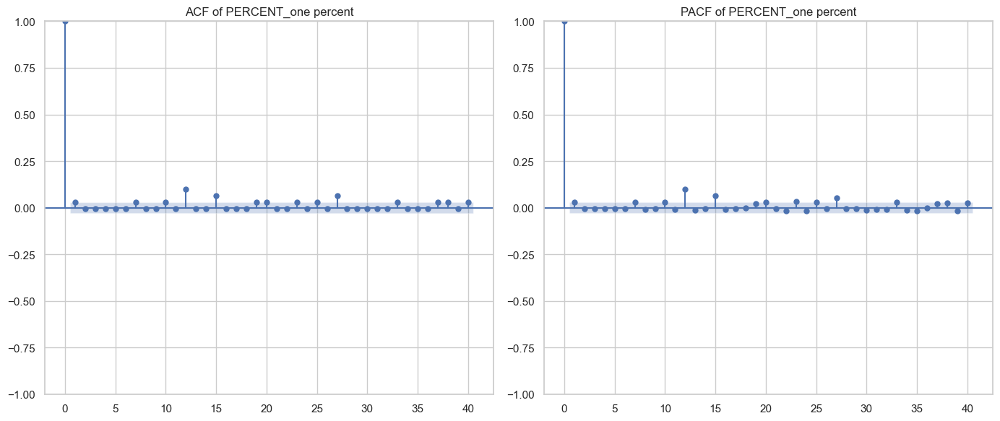

Processing column: PERCENT_five percent


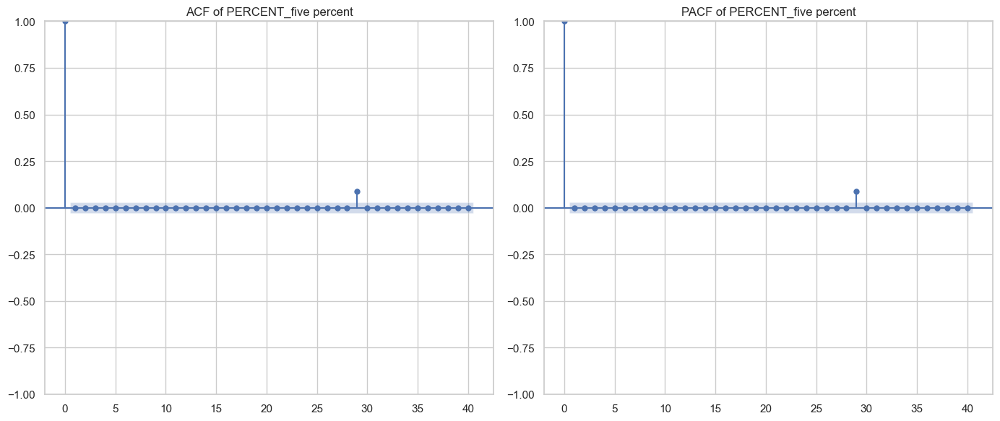

Processing column: PERCENT_eight percent


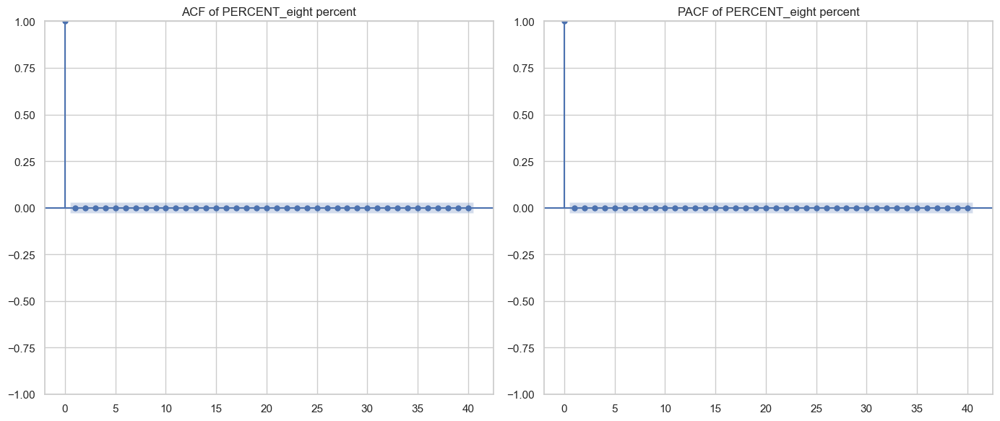

Processing column: PERCENT_three percent


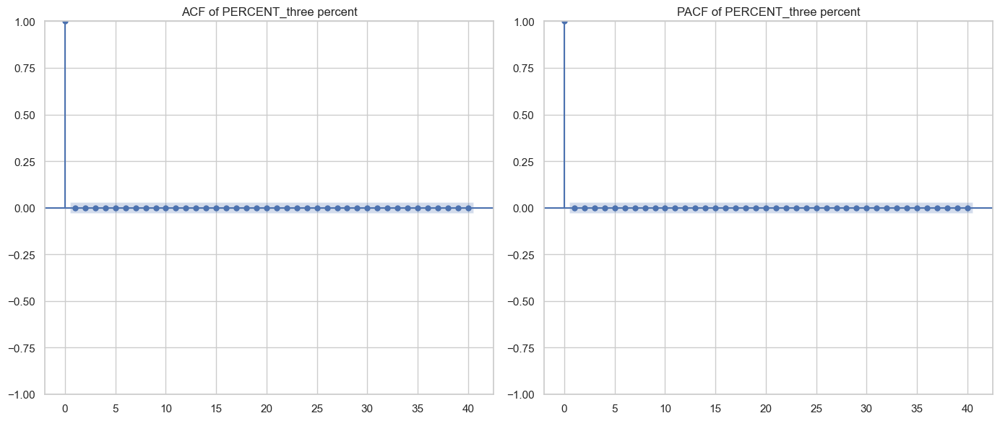

Processing column: PERCENT_four percent


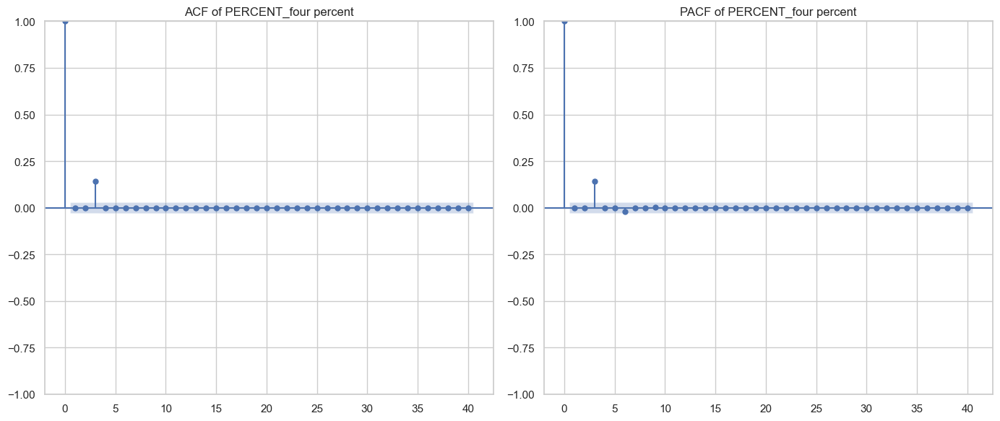

Processing column: PERSON_donald trump


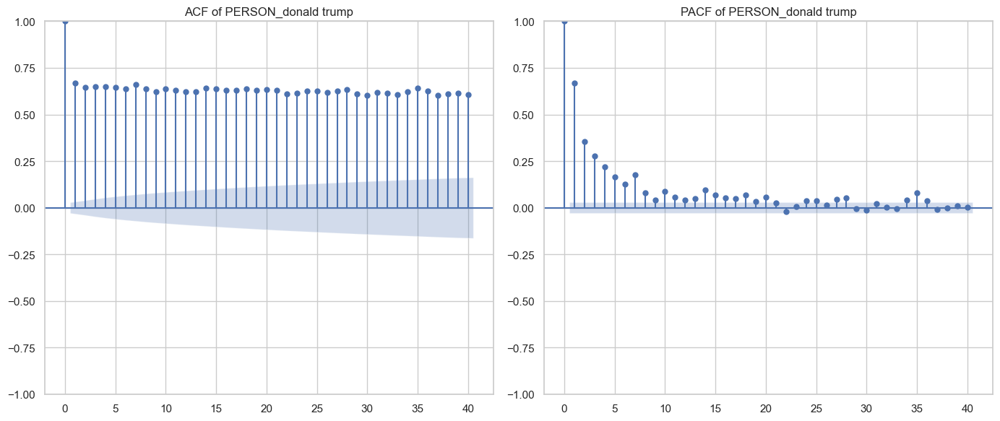

Processing column: PERSON_hillary clinton


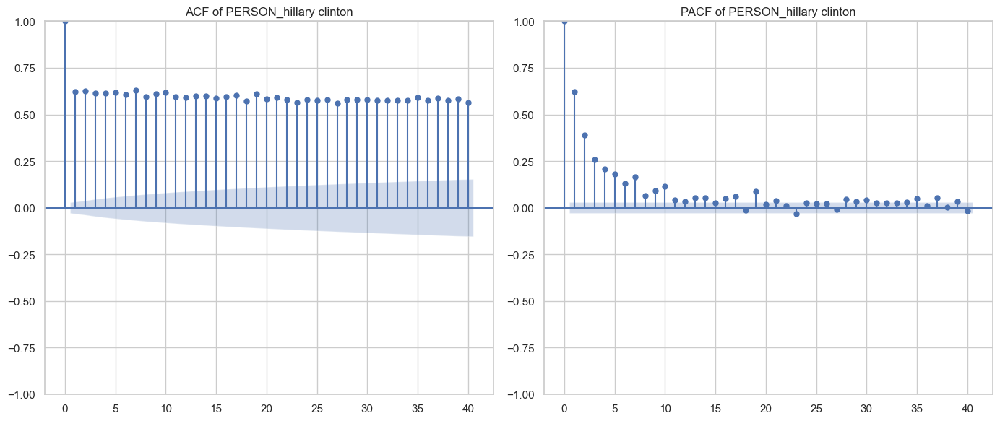

Processing column: PERSON_clinton


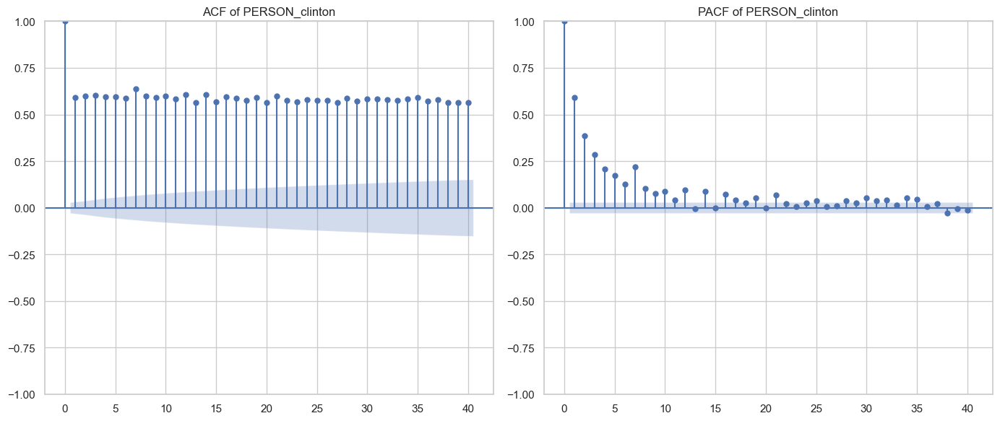

Processing column: PERSON_bernie


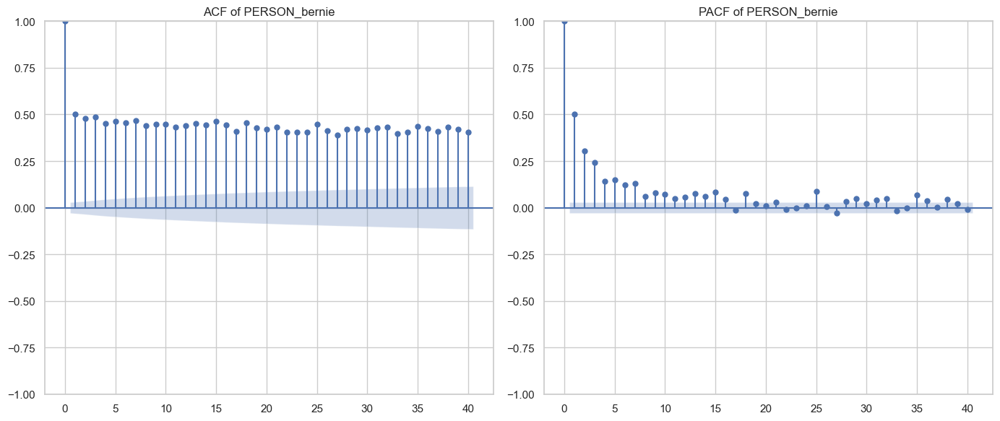

Processing column: PERSON_putin


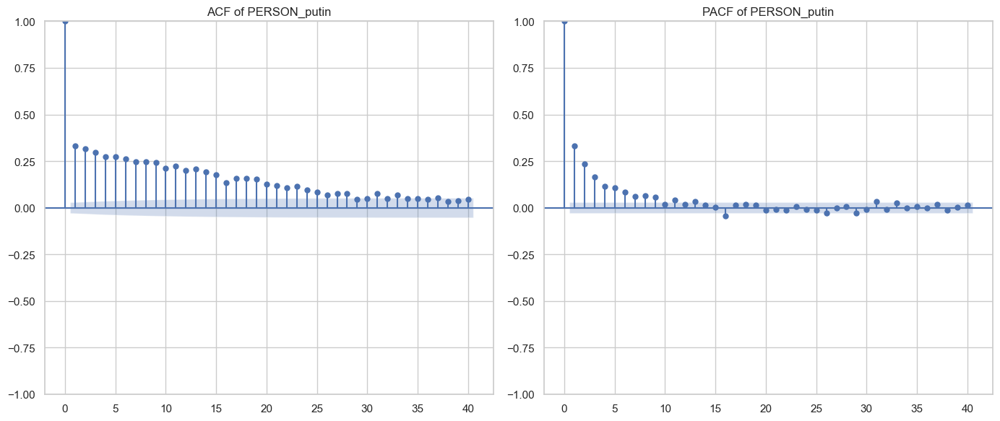

Processing column: PRODUCT_cole


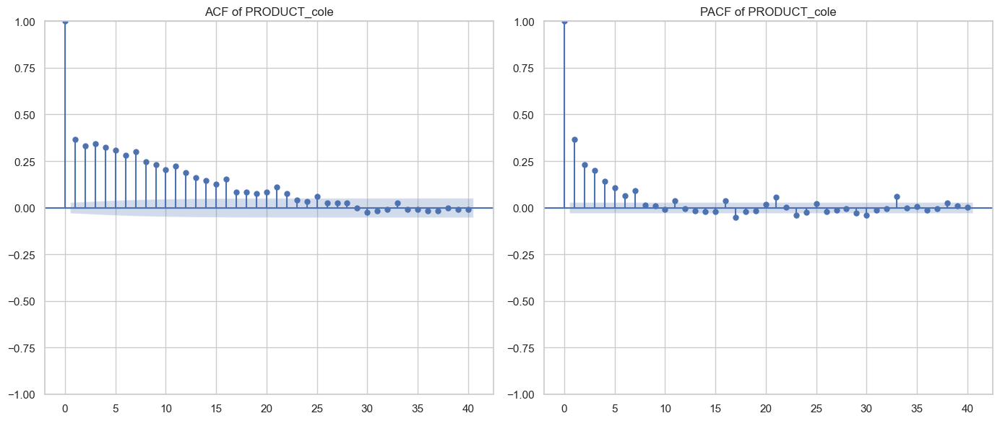

Processing column: PRODUCT_harry


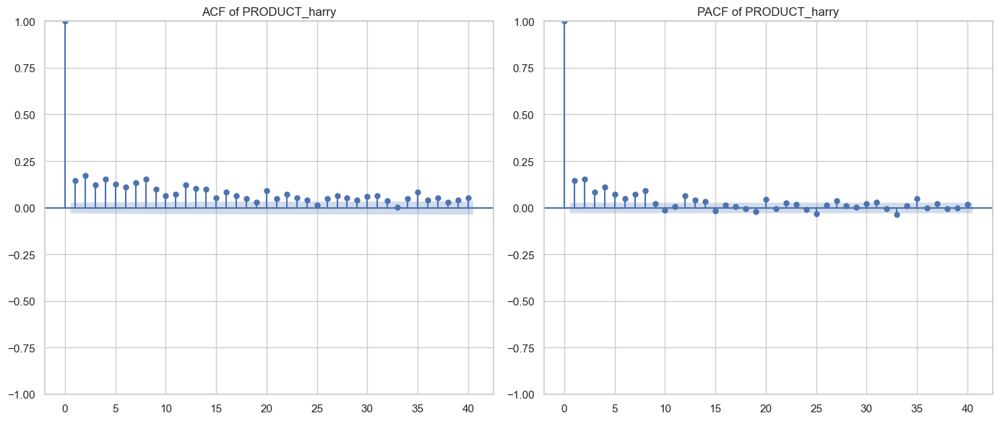

Processing column: PRODUCT_bmw


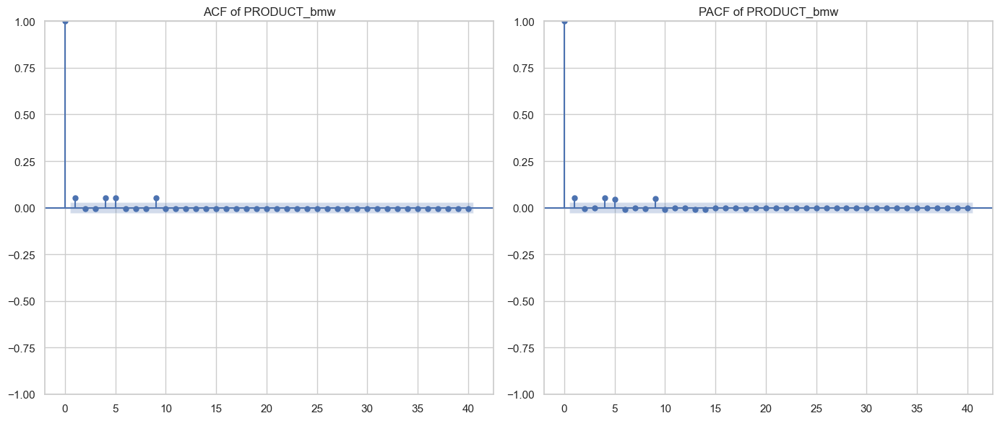

Processing column: PRODUCT_datesjustin


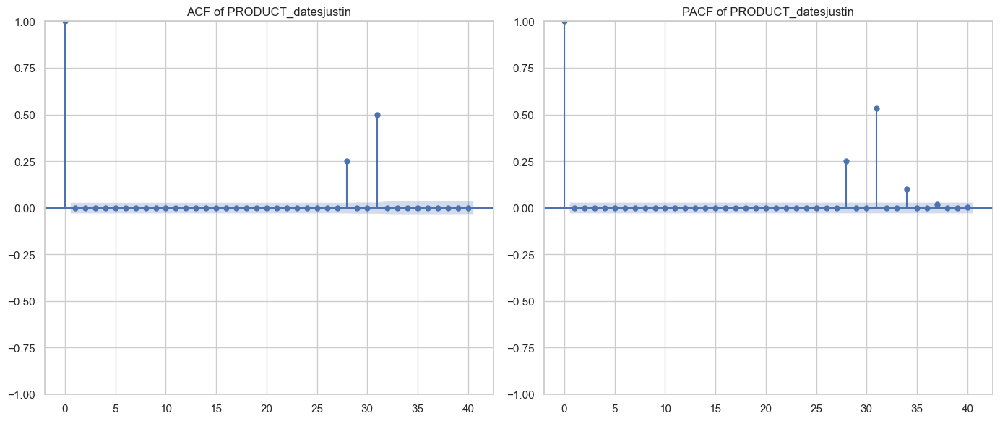

Processing column: PRODUCT_kalanick


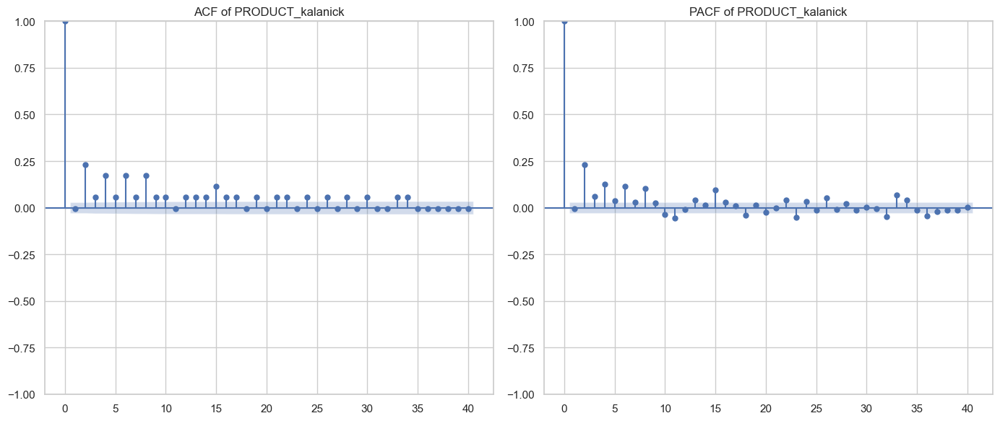

Processing column: QUANTITY_thousand mile


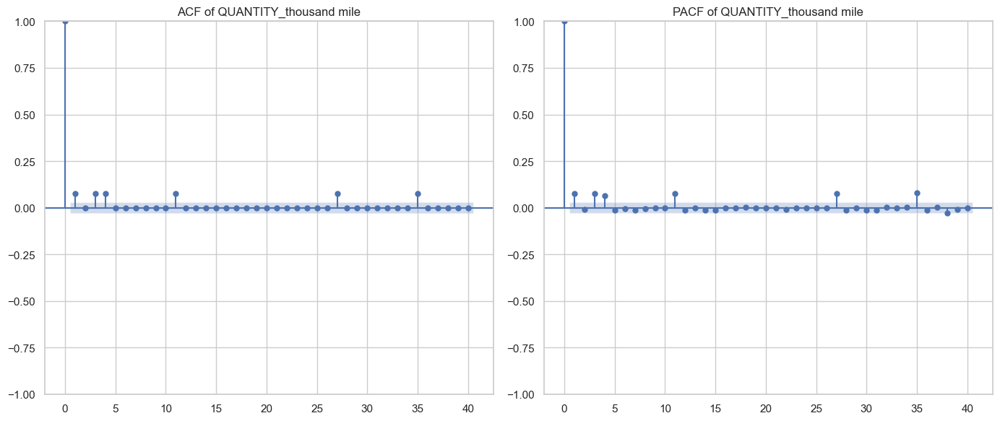

Processing column: QUANTITY_gallon


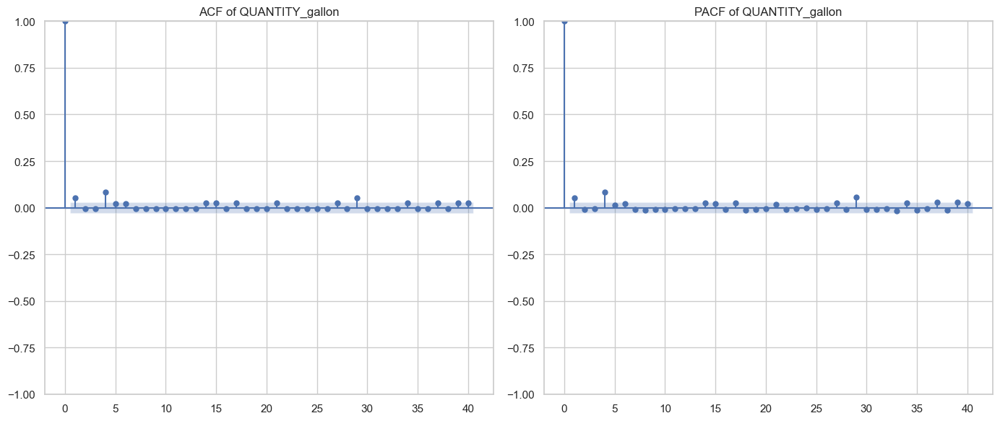

Processing column: QUANTITY_hundred mile


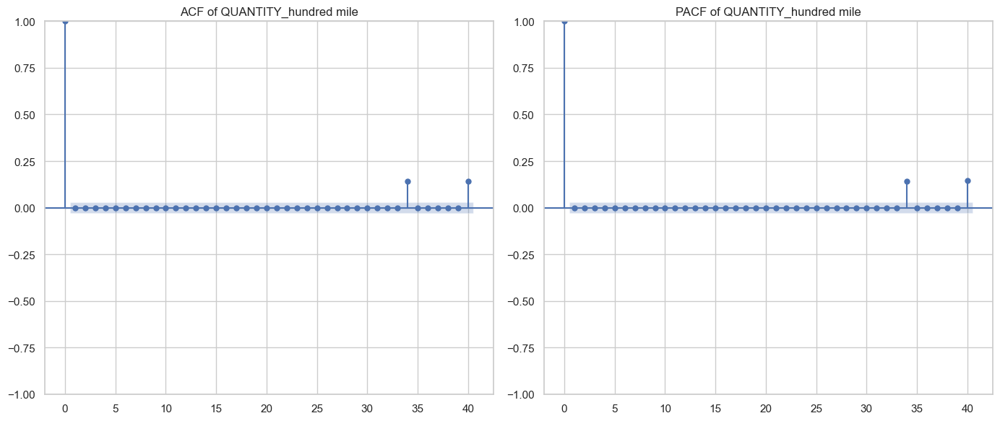

Processing column: QUANTITY_mile


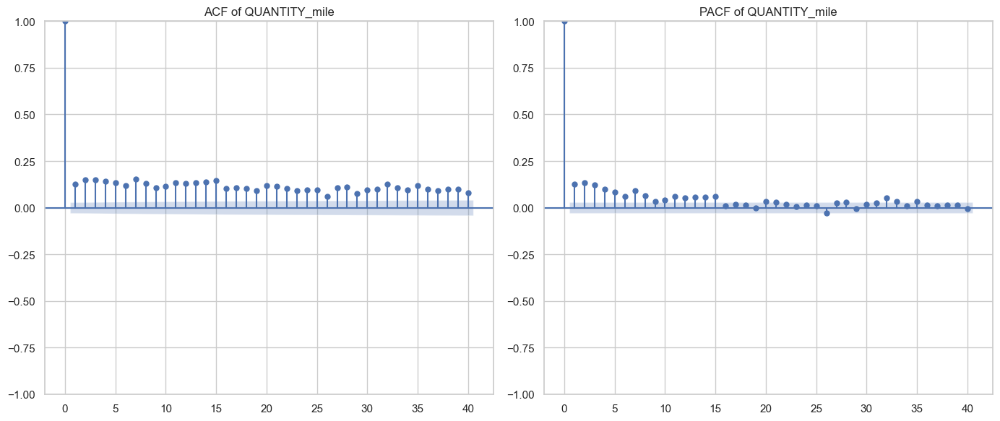

Processing column: QUANTITY_two mile


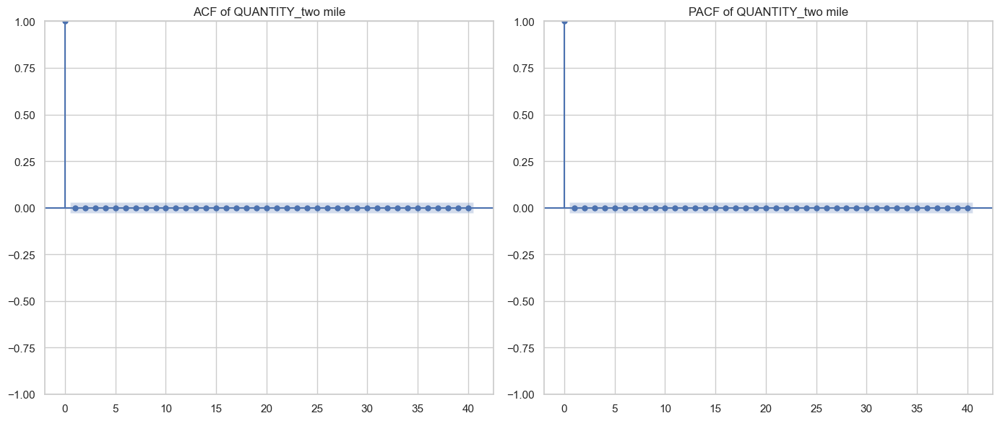

Processing column: TIME_morning


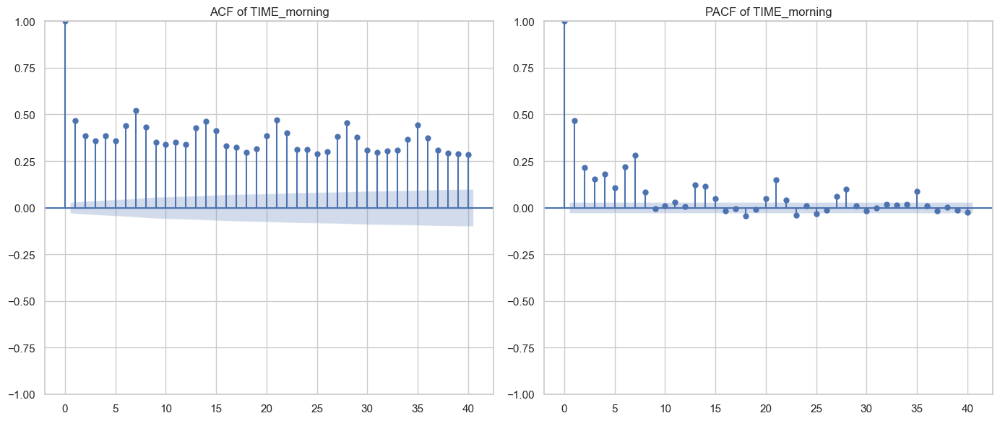

Processing column: TIME_night


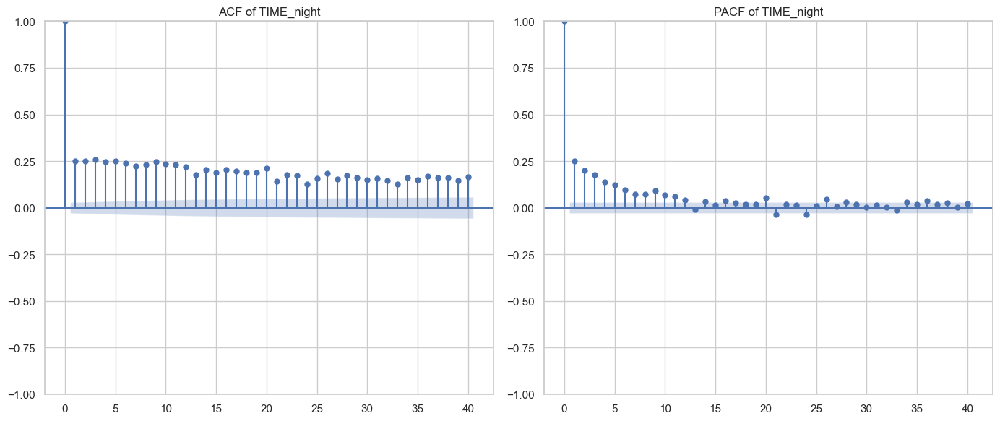

Processing column: TIME_hour


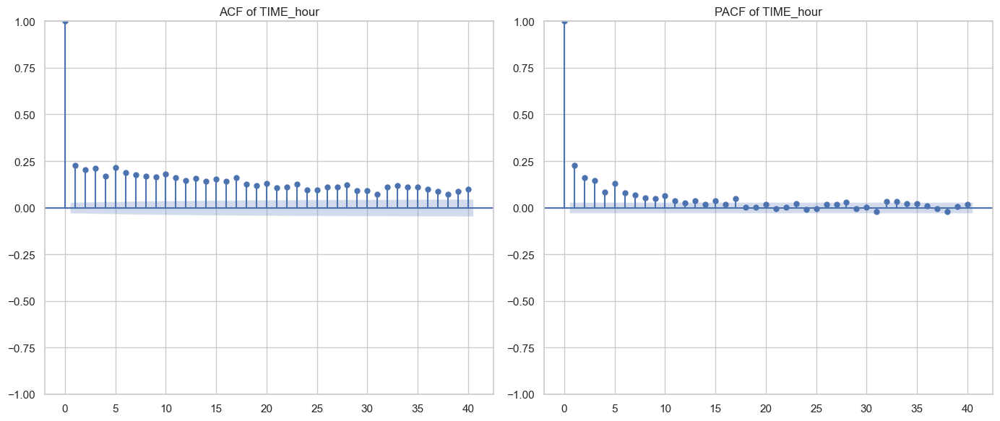

Processing column: TIME_tonight


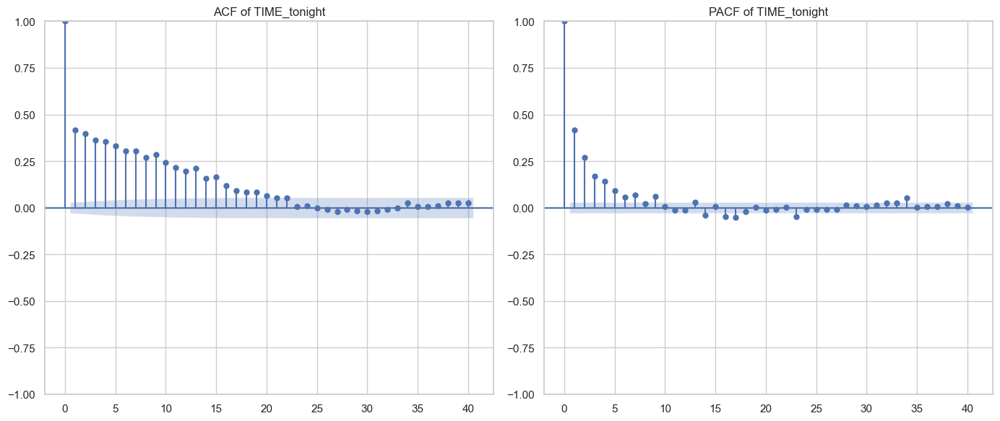

Processing column: TIME_evening


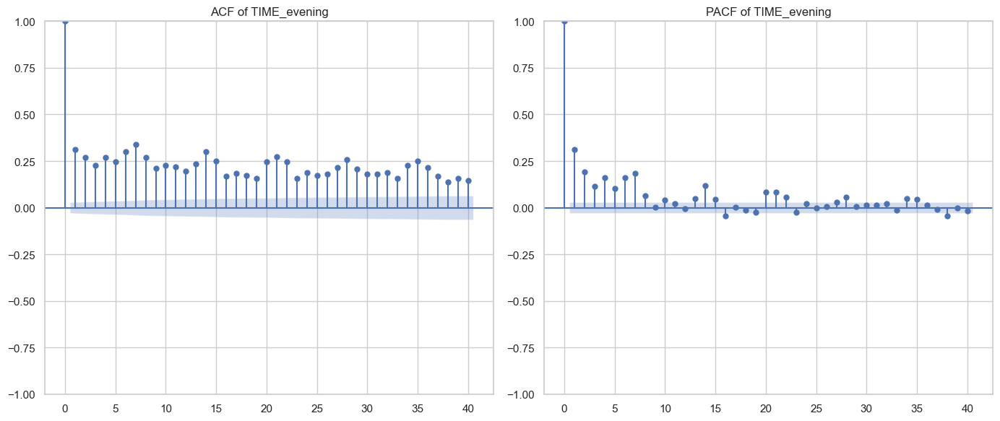

In [769]:
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

merged_df['time_index'] = merged_df['date']

merged_df.drop(columns=['date'],inplace=True)
# Convert 'Date' to index
merged_df.set_index('time_index', inplace=True)

# Iterate through numerical columns
numerical_columns = merged_df.select_dtypes(include=['float64', 'int64']).columns

for column in numerical_columns:
    print(f"Processing column: {column}")
    
    # Extract time series data
    time_series = merged_df[column]
    
    # Plot ACF
    plt.figure(figsize=(14, 6))
    plt.subplot(1, 2, 1)
    plot_acf(time_series, ax=plt.gca(), lags=40)
    plt.title(f'ACF of {column}')
    
    # Plot PACF
    plt.subplot(1, 2, 2)
    plot_pacf(time_series, ax=plt.gca(), lags=40)
    plt.title(f'PACF of {column}')
    
    # Show plots
    plt.tight_layout()
    plt.show()


In [1453]:
# Merge DataFrames on the date column
merged_df = pd.merge(stocks_grouped_df, df_clean, on='date', how='inner')
merged_df.columns

Index(['date', 'Price', 'Open', 'High', 'Low', 'Vol.', 'Change %',
       'vader_sentiment', 'textblob_sentiment', 'is_event', 'topic_12',
       'topic_14', 'topic_15', 'topic_4', 'topic_5', 'topic_1', 'topic_8',
       'topic_7', 'topic_10', 'topic_6', 'topic_9', 'topic_3', 'topic_0',
       'CARDINAL_one', 'CARDINAL_two', 'CARDINAL_million', 'CARDINAL_three',
       'CARDINAL_six', 'EVENT_vietnam', 'EVENT_wwii', 'EVENT_super bowl',
       'EVENT_hurricane katrina', 'EVENT_iraq war', 'FAC_guantanamo',
       'FAC_uva', 'FAC_notre dame', 'FAC_north london', 'FAC_nikki haley',
       'GPE_london', 'GPE_russia', 'GPE_america', 'GPE_california',
       'GPE_china', 'LAW_rico', 'LAW_camilla wear', 'LAW_crown new',
       'LAW_superfund', 'LAW_west ham', 'LOC_europe', 'LOC_middle east',
       'LOC_africa', 'LOC_caribbean', 'LOC_asia', 'MONEY_mike penny',
       'MONEY_million dollar', 'MONEY_billion dollar', 'MONEY_thousand dollar',
       'MONEY_every penny', 'NORP_american', 'NORP_repub

# Feature Engineering

##  Choose lag features for -
## Stocks - As it will be continuous Data & Rolling Average will be useful
## News - As some news impact stays for morning/next day or even for a week/month and it affects the buy/sell stock trading

### Stocks: Use short-term and medium-term lags along with rolling averages to capture trends and seasonality.
### News: Use immediate and longer-term lags along with rolling averages to capture the impact of news on stock prices.

# generate_lag_features

In [1459]:
def generate_lag_features(df: pd.DataFrame, target_col: str) -> pd.DataFrame:
    df = df.copy()  # Avoid modifying the original DataFrame
    df[target_col+'_lag_1d'] = df[target_col].shift(1)
    df[target_col+'_lag_2d'] = df[target_col].shift(2)
    df[target_col+'_lag_4d'] = df[target_col].shift(4)
    df[target_col+'_lag_8d'] = df[target_col].shift(8)
    df[target_col+'_lag_10d'] = df[target_col].shift(10)
    df[target_col+'_lag_12d'] = df[target_col].shift(12)
    
   # Stock Data Rolling Averages
    df[target_col+'_RollingAvg_3d'] = df[target_col].rolling(window=3).mean()
    df[target_col+'_RollingAvg_5d'] = df[target_col].rolling(window=5).mean()
    df[target_col+'_RollingAvg_7d'] = df[target_col].rolling(window=7).mean()
    df[target_col+'_RollingAvg_14d'] = df[target_col].rolling(window=14).mean()
    
    df.fillna(df[target_col].mean(), inplace=True)  # Handle NaNs by filling with the mean
    return df


In [1460]:
merged_df = generate_lag_features(merged_df, target_col = 'Price')

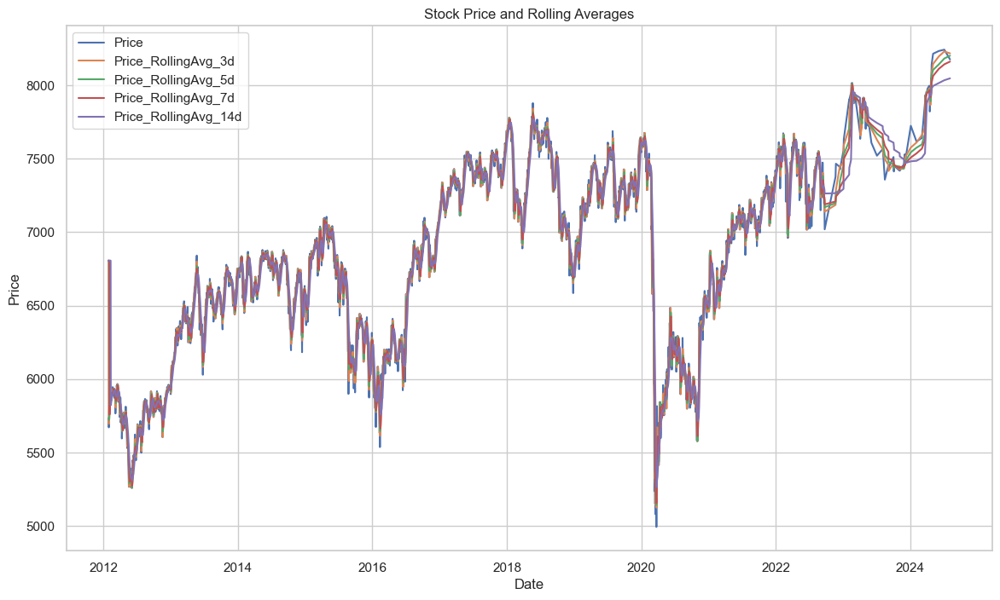

In [1461]:
import matplotlib.pyplot as plt

# Define the features you want to plot
features_to_plot = [
    'Price', 
    'Price_RollingAvg_3d', 
    'Price_RollingAvg_5d', 
    'Price_RollingAvg_7d', 
    'Price_RollingAvg_14d'
]

# Plot each feature
plt.figure(figsize=(14, 8))

for feature in features_to_plot:
    plt.plot(merged_df['date'], merged_df[feature], label=feature)

plt.title('Stock Price and Rolling Averages')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.grid(True)
plt.show()


In [1462]:
# Calculate the last date in the dataset
last_date = merged_df['date'].max()

# Calculate the date 4 weeks (28 days) before the last date
four_weeks_ago = last_date - pd.Timedelta(weeks=20)

# Filter the DataFrame for the last 4 weeks
filtered_df = merged_df[merged_df['date'] >= four_weeks_ago]
filtered_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,Price_lag_12d,Price_RollingAvg_3d,Price_RollingAvg_5d,Price_RollingAvg_7d,Price_RollingAvg_14d,quarter,month,year,week,dayofweek
3956,2024-03-21,7882.55,7737.38,7901.80,7737.38,1280.00,1.88,-0.6908,0.308333,1,...,7510.72,7712.806667,7670.266,7627.662857,7535.888571,1,3,2024,12,3
3957,2024-03-22,7930.92,7882.55,7961.43,7882.19,978.39,0.61,0.4588,-0.094628,1,...,7412.45,7817.933333,7758.482,7685.030000,7571.102143,1,3,2024,12,4
3958,2024-03-23,7930.92,7882.55,7961.43,7882.19,978.39,0.61,-0.1531,-0.125000,1,...,7451.54,7914.796667,7800.052,7744.738571,7601.116429,1,3,2024,12,5
3959,2024-03-24,7930.92,7882.55,7961.43,7882.19,978.39,0.61,0.2263,0.000000,1,...,7417.73,7930.920000,7863.128,7807.750000,7638.150000,1,3,2024,12,6
3960,2024-03-25,7917.57,7930.92,7939.38,7891.72,977.20,-0.17,0.0772,0.013889,1,...,7417.73,7926.470000,7918.576,7835.535714,7671.437857,1,3,2024,13,0
3961,2024-03-26,7930.96,7917.57,7934.37,7892.08,1180.00,0.17,0.0000,0.068182,1,...,7460.70,7926.483333,7928.258,7880.595714,7708.097143,1,3,2024,13,1
3962,2024-03-27,7931.98,7930.96,7938.14,7893.00,891.54,0.01,0.5859,0.178571,1,...,7529.35,7926.836667,7928.470,7922.260000,7744.829286,1,3,2024,13,2
3963,2024-03-28,7952.62,7931.98,7975.38,7931.36,906.58,0.26,-0.1027,0.100000,1,...,7512.96,7938.520000,7932.810,7932.270000,7779.966429,1,3,2024,13,3
3964,2024-03-29,7952.62,7931.98,7975.38,7931.36,906.58,0.26,0.1779,0.010714,1,...,7489.84,7945.740000,7937.150,7935.370000,7810.200000,1,3,2024,13,4
3965,2024-03-30,7952.62,7931.98,7975.38,7931.36,906.58,0.26,0.4215,0.500000,1,...,7723.07,7952.620000,7944.160,7938.470000,7841.604286,1,3,2024,13,5


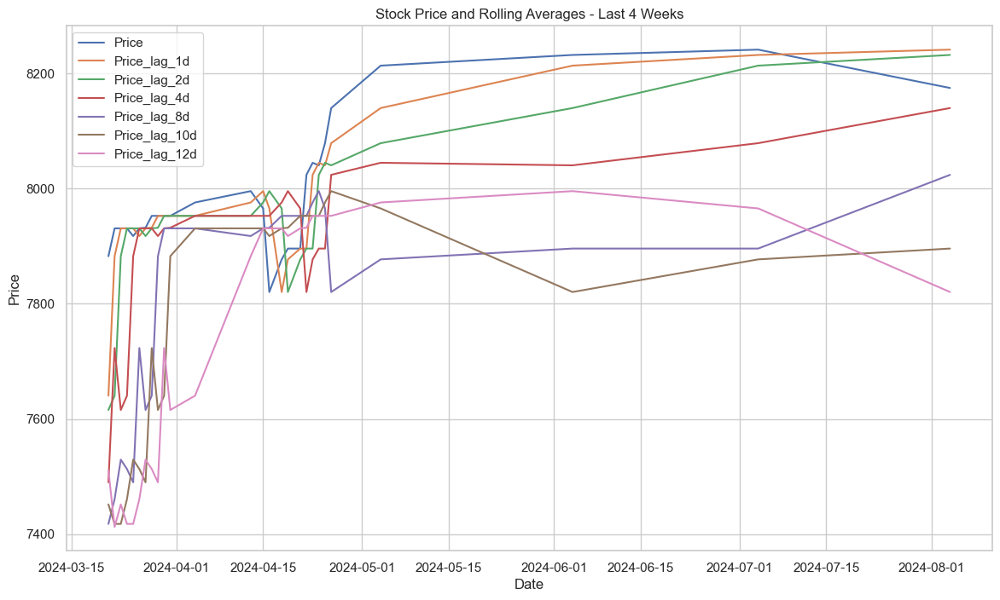

In [1463]:
import matplotlib.pyplot as plt

# Define the features you want to plot
features_to_plot = [
    'Price', 
    'Price_lag_1d', 
    'Price_lag_2d', 
    'Price_lag_4d', 
    'Price_lag_8d', 
    'Price_lag_10d', 
    'Price_lag_12d'
]

# Plot each feature for the last 4 weeks
plt.figure(figsize=(14, 8))

for feature in features_to_plot:
    plt.plot(filtered_df['date'], filtered_df[feature], label=feature)

plt.title('Stock Price and Rolling Averages - Last 4 Weeks')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.grid(True)
plt.show()


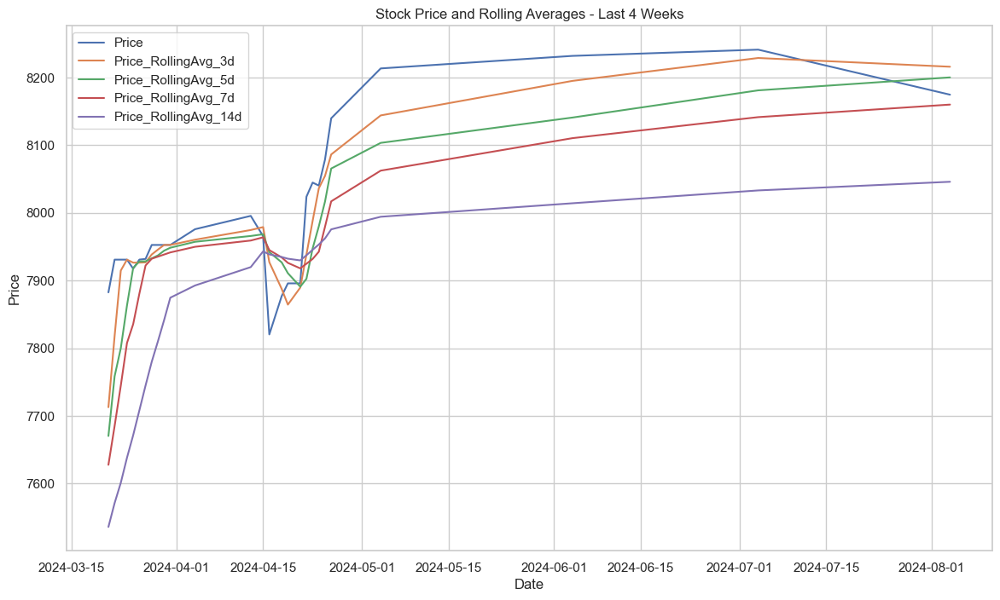

In [1464]:
import matplotlib.pyplot as plt

# Define the features you want to plot
features_to_plot = [
    'Price', 
    'Price_RollingAvg_3d', 
    'Price_RollingAvg_5d', 
    'Price_RollingAvg_7d', 
    'Price_RollingAvg_14d'
]

# Plot each feature for the last 4 weeks
plt.figure(figsize=(14, 8))

for feature in features_to_plot:
    plt.plot(filtered_df['date'], filtered_df[feature], label=feature)

plt.title('Stock Price and Rolling Averages - Last 4 Weeks')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.grid(True)
plt.show()


In [1465]:
# Loop through columns and print names excluding 'Price' and 'date'
for col in merged_df.columns:
    if 'Price' not in col   and col != 'date':
        print(col)
        merged_df = generate_lag_features(merged_df, target_col = col)    

Open
High
Low
Vol.
Change %
vader_sentiment
textblob_sentiment
is_event
topic_12
topic_14
topic_15
topic_4
topic_5
topic_1
topic_8
topic_7
topic_10
topic_6
topic_9
topic_3
topic_0
CARDINAL_one
CARDINAL_two
CARDINAL_million
CARDINAL_three
CARDINAL_six
EVENT_vietnam
EVENT_wwii
EVENT_super bowl
EVENT_hurricane katrina
EVENT_iraq war
FAC_guantanamo
FAC_uva
FAC_notre dame
FAC_north london
FAC_nikki haley
GPE_london
GPE_russia
GPE_america
GPE_california
GPE_china
LAW_rico
LAW_camilla wear
LAW_crown new
LAW_superfund
LAW_west ham
LOC_europe
LOC_middle east
LOC_africa
LOC_caribbean
LOC_asia
MONEY_mike penny
MONEY_million dollar
MONEY_billion dollar
MONEY_thousand dollar
MONEY_every penny
NORP_american
NORP_republican
NORP_democrat
NORP_russian
NORP_muslim
ORDINAL_first
ORDINAL_second
ORDINAL_third
ORDINAL_fourth
ORDINAL_fifth
ORG_gop
ORG_senate
ORG_white house
ORG_congress
ORG_supreme court
PERCENT_one percent
PERCENT_five percent
PERCENT_eight percent
PERCENT_three percent
PERCENT_four percen

TypeError: Invalid value '26.082349987446648' for dtype UInt32

# create_time_features

In [1466]:
def create_time_features(df: pd.DataFrame) -> pd.DataFrame:
    df['date'] = pd.to_datetime(df['date'])
    df['quarter'] = df['date'].dt.quarter
    df['month'] = df['date'].dt.month
    df['year'] = df['date'].dt.year
    df['week'] = df['date'].dt.isocalendar().week
    df['dayofweek'] = df['date'].dt.dayofweek
    return df


In [1467]:
# Create time features
merged_df = create_time_features(merged_df)
merged_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,year_lag_1d,year_lag_2d,year_lag_4d,year_lag_8d,year_lag_10d,year_lag_12d,year_RollingAvg_3d,year_RollingAvg_5d,year_RollingAvg_7d,year_RollingAvg_14d
0,2012-01-28,5733.45,5795.20,5795.20,5728.96,790.05,-1.07,0.9946,0.129496,1,...,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022
1,2012-01-29,5733.45,5795.20,5795.20,5728.96,790.05,-1.07,0.9951,0.026796,1,...,2012.000000,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022
2,2012-01-30,5671.09,5733.45,5733.45,5651.56,778.10,-1.09,0.9806,0.136525,1,...,2012.000000,2012.000000,2017.064022,2017.064022,2017.064022,2017.064022,2012.000000,2017.064022,2017.064022,2017.064022
3,2012-01-31,5681.61,5671.09,5730.32,5671.09,1020.00,0.19,0.9766,0.102778,1,...,2012.000000,2012.000000,2017.064022,2017.064022,2017.064022,2017.064022,2012.000000,2017.064022,2017.064022,2017.064022
4,2012-02-01,5790.72,5681.61,5790.72,5680.67,985.25,1.92,0.9977,0.332493,1,...,2012.000000,2012.000000,2012.000000,2017.064022,2017.064022,2017.064022,2012.000000,2012.000000,2017.064022,2017.064022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3978,2024-04-26,8139.83,8078.86,8146.79,8078.86,801.60,0.75,0.0000,0.200000,1,...,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000
3979,2024-05-04,8213.49,8172.15,8248.73,8172.15,593.36,0.51,0.1280,0.000000,1,...,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000
3980,2024-06-04,8232.04,8262.75,8263.38,8200.26,1100.00,-0.37,-0.9042,-0.300000,1,...,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000
3981,2024-07-04,8241.26,8171.12,8257.95,8170.97,558.64,0.86,-0.5106,0.003125,1,...,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000


In [1468]:
print(f'Length of feat {len(merged_df.columns)}')
print(merged_df.columns)

Length of feat 1103
Index(['date', 'Price', 'Open', 'High', 'Low', 'Vol.', 'Change %',
       'vader_sentiment', 'textblob_sentiment', 'is_event',
       ...
       'year_lag_1d', 'year_lag_2d', 'year_lag_4d', 'year_lag_8d',
       'year_lag_10d', 'year_lag_12d', 'year_RollingAvg_3d',
       'year_RollingAvg_5d', 'year_RollingAvg_7d', 'year_RollingAvg_14d'],
      dtype='object', length=1103)


In [1469]:
merged_df_copy = merged_df.copy()

In [1470]:
# !pip install catboost
# !pip install xgboost
# !pip install lightgbm

In [1471]:
import inspect
import os

import time
import datetime as dt
from datetime import timedelta
import calendar
from datetime import datetime
from datetime import date

import warnings
warnings.filterwarnings('ignore')

import matplotlib.pyplot as plt
import seaborn as sns

import scipy.stats
from scipy.stats import uniform, randint
from scipy.stats.distributions import chi2

import pylab

from statsmodels.tsa.holtwinters import ExponentialSmoothing, SimpleExpSmoothing, Holt
from statsmodels.tsa.seasonal import seasonal_decompose

import statsmodels.tsa.stattools as sts
import statsmodels.graphics.tsaplots as sgt
import statsmodels.graphics.tsaplots as plot_acf

from statsmodels.tools.eval_measures import mse,rmse

from sklearn.metrics import accuracy_score
from sklearn import linear_model
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge

from sklearn.model_selection   import GridSearchCV, cross_val_score
from sklearn.model_selection   import TimeSeriesSplit, RandomizedSearchCV
from sklearn.model_selection   import RepeatedKFold
from sklearn.feature_selection import VarianceThreshold

from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble          import ExtraTreesRegressor
from sklearn.neighbors         import KNeighborsRegressor

import catboost
from catboost import CatBoostClassifier
from catboost import CatBoostRegressor

import xgboost as xgb
import lightgbm as lgb

from sklearn.preprocessing import MinMaxScaler

from tqdm import tqdm
tqdm.pandas()

# Visualization
# import ipyleaflet
import matplotlib.pyplot as plt

import requests

# Supress Warnings
import warnings
warnings.filterwarnings('ignore')


from IPython.display import Image
import seaborn as sns

# Data Science
import numpy as np
import pandas as pd

# Feature Engineering
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split

# Machine Learning 
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import f1_score, accuracy_score,classification_report,confusion_matrix
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.tree import DecisionTreeRegressor

# Others
from itertools import cycle
import pickle

# 70-30 % train test

In [1472]:
lentest = round((30/100)*len(merged_df))
lentest

1195

In [1473]:
merged_df[:lentest]

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,year_lag_1d,year_lag_2d,year_lag_4d,year_lag_8d,year_lag_10d,year_lag_12d,year_RollingAvg_3d,year_RollingAvg_5d,year_RollingAvg_7d,year_RollingAvg_14d
0,2012-01-28,5733.45,5795.20,5795.20,5728.96,790.05,-1.07,0.9946,0.129496,1,...,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022
1,2012-01-29,5733.45,5795.20,5795.20,5728.96,790.05,-1.07,0.9951,0.026796,1,...,2012.000000,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022,2017.064022
2,2012-01-30,5671.09,5733.45,5733.45,5651.56,778.10,-1.09,0.9806,0.136525,1,...,2012.000000,2012.000000,2017.064022,2017.064022,2017.064022,2017.064022,2012.000000,2017.064022,2017.064022,2017.064022
3,2012-01-31,5681.61,5671.09,5730.32,5671.09,1020.00,0.19,0.9766,0.102778,1,...,2012.000000,2012.000000,2017.064022,2017.064022,2017.064022,2017.064022,2012.000000,2017.064022,2017.064022,2017.064022
4,2012-02-01,5790.72,5681.61,5790.72,5680.67,985.25,1.92,0.9977,0.332493,1,...,2012.000000,2012.000000,2012.000000,2017.064022,2017.064022,2017.064022,2012.000000,2012.000000,2017.064022,2017.064022
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1190,2015-05-02,6985.95,6960.63,6995.41,6919.39,863.40,0.36,-0.9871,-0.008508,1,...,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000
1191,2015-05-03,6985.95,6960.63,6995.41,6919.39,863.40,0.36,0.9949,0.101730,1,...,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000
1192,2015-05-04,6985.95,6960.63,6995.41,6919.39,863.40,0.36,0.9991,0.116300,1,...,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000
1193,2015-05-05,6927.58,6985.95,7053.18,6927.58,1050.00,-0.84,0.9991,0.148423,1,...,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000,2015.000000


In [1474]:
merged_df.describe()

,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,topic_12,...,year_lag_1d,year_lag_2d,year_lag_4d,year_lag_8d,year_lag_10d,year_lag_12d,year_RollingAvg_3d,year_RollingAvg_5d,year_RollingAvg_7d,year_RollingAvg_14d
count,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,...,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000,3983.000000
mean,6805.785983,6804.655275,6844.003522,6765.672137,800.447022,0.021346,-0.042927,0.069001,0.994728,0.177597,...,2017.062281,2017.060539,2017.057057,2017.050091,2017.046608,2017.043125,2017.063552,2017.063082,2017.062612,2017.060967
std,605.041114,604.599131,600.102976,609.857144,289.666126,0.970443,0.882680,0.111509,0.072429,0.264959,...,3.207559,3.205674,3.201897,3.194319,3.190518,3.186708,3.206347,3.203290,3.200236,3.189534
min,4993.890000,4993.890000,5181.040000,4898.790000,101.670000,-10.870000,-1.000000,-1.000000,0.000000,0.000000,...,2012.000000,2012.000000,2012.000000,2012.000000,2012.000000,2012.000000,2012.000000,2012.000000,2012.000000,2012.000000
25%,6374.515000,6371.755000,6405.670000,6328.390000,639.950000,-0.440000,-0.951700,0.017546,1.000000,0.000000,...,2014.000000,2014.000000,2014.000000,2014.000000,2014.000000,2014.000000,2014.000000,2014.000000,2014.000000,2014.000000
50%,6838.050000,6836.300000,6865.380000,6806.470000,755.070000,0.070000,-0.318200,0.073636,1.000000,0.000000,...,2017.000000,2017.000000,2017.000000,2017.000000,2017.000000,2017.000000,2017.000000,2017.000000,2017.000000,2017.000000
75%,7310.165000,7304.000000,7346.815000,7270.030000,888.460000,0.500000,0.984800,0.127778,1.000000,0.318861,...,2020.000000,2020.000000,2020.000000,2020.000000,2020.000000,2020.000000,2020.000000,2020.000000,2020.000000,2020.000000
max,8241.260000,8283.360000,8283.360000,8200.260000,3880.000000,9.050000,0.999800,1.000000,1.000000,1.000000,...,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000,2024.000000


# Categorical & Continuous Column

In [1475]:
# stocks_df_columns = ['Open', 'High', 'Low', 'Vol.', 'Change %']
stocks_df_columns = []

In [1476]:

# Categorical columns: These can be identified as object (string) types or those with a low number of unique values
categorical_columns = merged_df.select_dtypes(include=['object', 'category']).columns.tolist()


# Alternatively, include numeric columns that have a low number of unique values (likely categorical)
for col in merged_df.select_dtypes(include=['number']).columns:
    if merged_df[col].nunique() < 54:  # Threshold for categorical, can be adjusted
        categorical_columns.append(col)

categorical_columns = list(set(categorical_columns) - set(stocks_df_columns))

# Continuous columns: These are typically numeric columns with a wide range of values
continuous_columns = merged_df.select_dtypes(include=['number']).columns.difference(categorical_columns).tolist()

continuous_columns = list(set(continuous_columns) - set(stocks_df_columns))

print(f"Categorical Columns: {categorical_columns}")
print('-------------------------------------------------------')
print(f"Continuous Columns: {continuous_columns}")


Categorical Columns: ['PERCENT_five percent_lag_1d', 'ORG_gop_lag_4d', 'PERSON_putin_lag_8d', 'EVENT_vietnam_RollingAvg_14d', 'CARDINAL_two_RollingAvg_7d', 'ORDINAL_first_lag_10d', 'CARDINAL_one_lag_2d', 'FAC_nikki haley_RollingAvg_3d', 'PERSON_hillary clinton_RollingAvg_3d', 'year_lag_1d', 'ORG_supreme court_lag_10d', 'EVENT_hurricane katrina', 'PERSON_hillary clinton_lag_2d', 'topic_1_lag_1d', 'QUANTITY_mile_RollingAvg_5d', 'EVENT_iraq war_lag_10d', 'ORDINAL_fourth_lag_4d', 'topic_9_lag_4d', 'ORG_supreme court_RollingAvg_3d', 'CARDINAL_million_RollingAvg_3d', 'CARDINAL_two_lag_4d', 'LOC_europe_lag_10d', 'ORDINAL_fourth_lag_1d', 'MONEY_million dollar_lag_2d', 'LOC_caribbean_lag_1d', 'PERCENT_three percent_RollingAvg_7d', 'PRODUCT_bmw_lag_8d', 'PRODUCT_datesjustin_RollingAvg_14d', 'quarter_lag_8d', 'topic_1', 'ORDINAL_fourth_lag_12d', 'PRODUCT_bmw_RollingAvg_7d', 'NORP_republican_lag_4d', 'LAW_superfund_RollingAvg_5d', 'LAW_rico_RollingAvg_3d', 'CARDINAL_six_lag_12d', 'GPE_london_Rolli

In [1477]:
target_column = 'Price'

In [1522]:
train_df = merged_df[:-lentest]
test_df = merged_df[:lentest]  # Exclude the split date itself from test

# Example 2: Using a proportion (e.g., 80% train, 20% test)
# split_index = int(len(merged_df) * 0.8)
# train_df = merged_df.iloc[:split_index]
# test_df = merged_df.iloc[split_index:]

# Display the results
print("Training Data:")
print(len(train_df))
print("\nTesting Data:")
print(len(test_df))
print(len(merged_df))

Training Data:
2788

Testing Data:
1195
3983


In [1479]:
removelist = ['Price', 'date']

In [1480]:
# Remove elements from all_columns that are in removelist
continuous_columns = [col for col in continuous_columns if col not in removelist]
# Remove elements from all_columns that are in removelist
categorical_columns = [col for col in categorical_columns if col not in removelist]

In [1481]:
merged_df[['topic_0','topic_9']].describe()

,topic_0,topic_9
count,3983.0,3983.0
mean,0.0,0.0
std,0.0,0.0
min,0.0,0.0
25%,0.0,0.0
50%,0.0,0.0
75%,0.0,0.0
max,0.0,0.0


In [1482]:
stocks_df.columns

Index(['Date', 'Price', 'Open', 'High', 'Low', 'Vol.', 'Change %'], dtype='object')

In [1483]:
# Filter continuous_columns based on whether they start with any column in stocks_df_columns
filtered_columns = [col for col in continuous_columns if any(col.startswith(prefix) for prefix in stocks_df.columns)]
filtered_columns

['Low_RollingAvg_14d',
 'Price_lag_12d',
 'Vol._lag_8d',
 'High_lag_1d',
 'Low_lag_12d',
 'Vol._RollingAvg_14d',
 'Vol.',
 'Open_RollingAvg_3d',
 'Vol._lag_1d',
 'Change %_lag_10d',
 'Low_lag_10d',
 'Price_lag_8d',
 'Low_RollingAvg_7d',
 'Price_RollingAvg_7d',
 'Vol._lag_12d',
 'Open_RollingAvg_7d',
 'Open_lag_1d',
 'High_RollingAvg_5d',
 'High_lag_4d',
 'Vol._RollingAvg_3d',
 'Change %',
 'Low_RollingAvg_3d',
 'High_RollingAvg_3d',
 'Change %_lag_1d',
 'Price_lag_1d',
 'Open',
 'Change %_RollingAvg_7d',
 'Change %_lag_2d',
 'Price_lag_4d',
 'Open_lag_8d',
 'Low',
 'Price_RollingAvg_5d',
 'Open_lag_10d',
 'High',
 'Price_lag_2d',
 'Change %_RollingAvg_14d',
 'Vol._RollingAvg_5d',
 'Low_RollingAvg_5d',
 'High_RollingAvg_14d',
 'Vol._lag_4d',
 'Open_RollingAvg_14d',
 'Price_RollingAvg_14d',
 'Change %_RollingAvg_5d',
 'High_lag_12d',
 'Open_RollingAvg_5d',
 'Low_lag_8d',
 'Change %_RollingAvg_3d',
 'Open_lag_12d',
 'High_RollingAvg_7d',
 'Change %_lag_4d',
 'Low_lag_4d',
 'Change %_lag_1

In [1484]:
news_columns = [col for col in continuous_columns if col not in filtered_columns]
news_columns

['topic_15_RollingAvg_14d',
 'vader_sentiment_RollingAvg_7d',
 'topic_5_RollingAvg_7d',
 'vader_sentiment_lag_12d',
 'topic_5_lag_8d',
 'textblob_sentiment_RollingAvg_14d',
 'topic_14_lag_10d',
 'topic_14_lag_8d',
 'topic_5_RollingAvg_14d',
 'textblob_sentiment_lag_8d',
 'topic_12_RollingAvg_5d',
 'topic_5_RollingAvg_5d',
 'topic_12_RollingAvg_3d',
 'vader_sentiment_RollingAvg_5d',
 'year_RollingAvg_14d',
 'topic_15_lag_12d',
 'topic_5',
 'textblob_sentiment_lag_1d',
 'textblob_sentiment_RollingAvg_7d',
 'textblob_sentiment_RollingAvg_5d',
 'year_RollingAvg_7d',
 'topic_12_RollingAvg_7d',
 'textblob_sentiment_RollingAvg_3d',
 'textblob_sentiment_lag_4d',
 'topic_12_lag_10d',
 'topic_12_lag_4d',
 'topic_14_RollingAvg_5d',
 'topic_14_lag_4d',
 'topic_15_RollingAvg_7d',
 'vader_sentiment_RollingAvg_14d',
 'textblob_sentiment_lag_12d',
 'topic_12_lag_12d',
 'vader_sentiment_lag_4d',
 'topic_14_RollingAvg_7d',
 'textblob_sentiment',
 'topic_12',
 'topic_14_RollingAvg_14d',
 'topic_12_lag_1d

# Feature Correlation

Top 20 Correlations with Target:
year_RollingAvg_5d         0.567103
year_RollingAvg_7d         0.565962
year_RollingAvg_14d        0.562259
topic_14_RollingAvg_14d    0.386468
topic_14_RollingAvg_7d     0.383374
topic_14_RollingAvg_5d     0.380506
topic_14_RollingAvg_3d     0.374007
topic_14_lag_12d           0.361144
topic_14_lag_10d           0.359842
topic_14_lag_8d            0.358345
topic_14_lag_4d            0.356283
topic_14_lag_2d            0.355195
topic_14_lag_1d            0.354507
topic_14                   0.353957
topic_5_RollingAvg_14d     0.284198
topic_5_RollingAvg_7d      0.236197
topic_5_RollingAvg_5d      0.210599
topic_15_RollingAvg_7d     0.184015
topic_15_RollingAvg_14d    0.182482
topic_15_RollingAvg_5d     0.182480
topic_5_RollingAvg_3d      0.178976
topic_15_RollingAvg_3d     0.175751
topic_15_lag_1d            0.150657
topic_15_lag_2d            0.148037
topic_15                   0.147699
topic_15_lag_4d            0.142852
topic_15_lag_8d            0.12

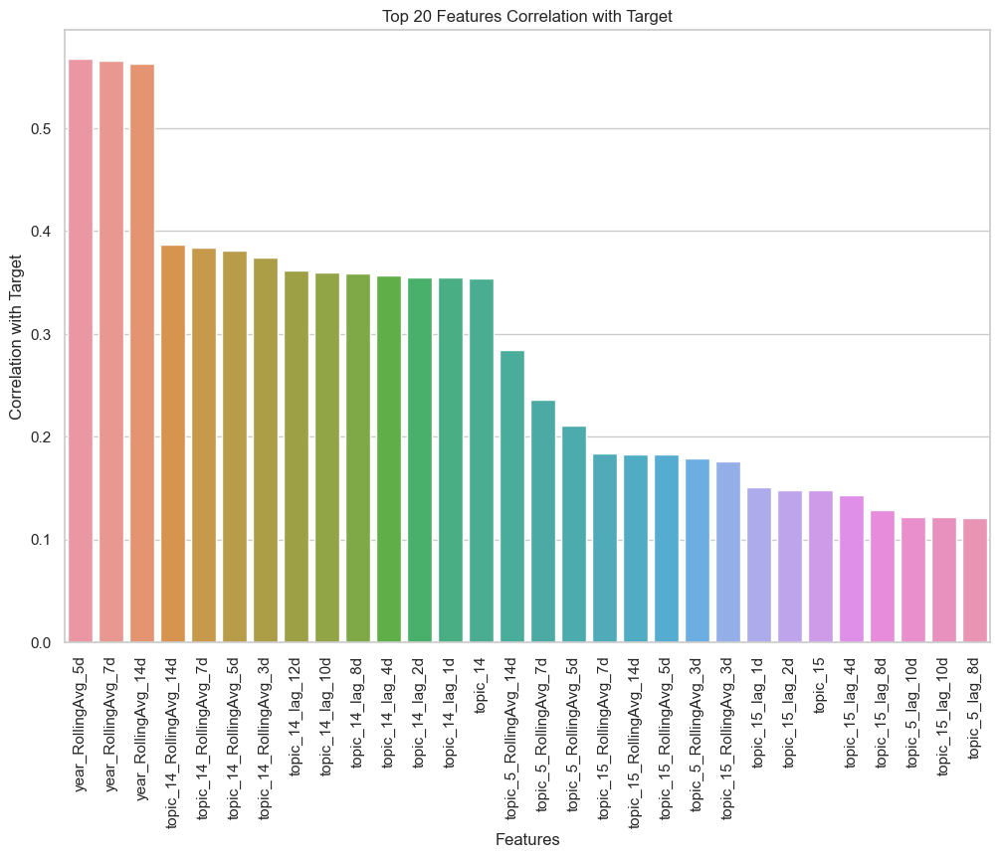

In [1485]:
X = merged_df[news_columns]
y = merged_df[target_column]

# Calculate correlation with the target
correlations = X.corrwith(y)

# Sort correlations in descending order and select the top 20
top_20_correlations = correlations.sort_values(ascending=False).head(30)

# Display top 20 correlations
print("Top 20 Correlations with Target:")
print(top_20_correlations)

# Plot top 20 correlations
plt.figure(figsize=(12, 8))
sns.barplot(x=top_20_correlations.index, y=top_20_correlations.values)
plt.xticks(rotation=90)
plt.title("Top 20 Features Correlation with Target")
plt.xlabel("Features")
plt.ylabel("Correlation with Target")
plt.show()

['topic_15_RollingAvg_14d', 'Low_RollingAvg_14d', 'Price_lag_12d', 'vader_sentiment_RollingAvg_7d', 'topic_5_RollingAvg_7d', 'vader_sentiment_lag_12d', 'Vol._lag_8d', 'High_lag_1d', 'Low_lag_12d', 'Vol._RollingAvg_14d', 'topic_5_lag_8d', 'textblob_sentiment_RollingAvg_14d', 'topic_14_lag_10d', 'Vol.', 'topic_14_lag_8d', 'topic_5_RollingAvg_14d', 'textblob_sentiment_lag_8d', 'topic_12_RollingAvg_5d', 'topic_5_RollingAvg_5d', 'topic_12_RollingAvg_3d']
Chunk 1:
High_lag_1d                          0.993212
Low_RollingAvg_14d                   0.977706
Price_lag_12d                        0.950030
Low_lag_12d                          0.947948
topic_14_lag_10d                     0.359842
topic_14_lag_8d                      0.358345
topic_5_RollingAvg_14d               0.284198
topic_5_RollingAvg_7d                0.236197
topic_5_RollingAvg_5d                0.210599
topic_15_RollingAvg_14d              0.182482
topic_5_lag_8d                       0.121236
Vol._lag_8d                    

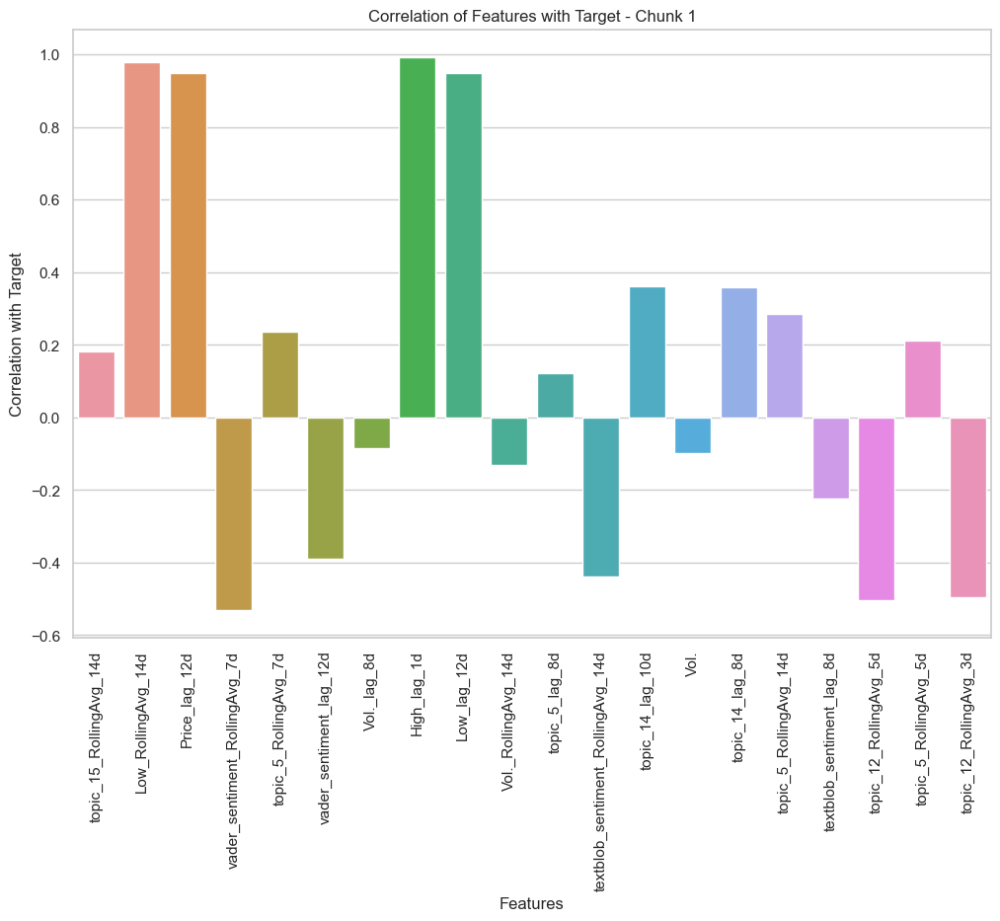

['vader_sentiment_RollingAvg_5d', 'year_RollingAvg_14d', 'topic_15_lag_12d', 'topic_5', 'Open_RollingAvg_3d', 'Vol._lag_1d', 'Change %_lag_10d', 'Low_lag_10d', 'Price_lag_8d', 'textblob_sentiment_lag_1d', 'textblob_sentiment_RollingAvg_7d', 'textblob_sentiment_RollingAvg_5d', 'Low_RollingAvg_7d', 'Price_RollingAvg_7d', 'Vol._lag_12d', 'Open_RollingAvg_7d', 'year_RollingAvg_7d', 'Open_lag_1d', 'topic_12_RollingAvg_7d', 'High_RollingAvg_5d']
Chunk 2:
Open_RollingAvg_3d                  0.991686
High_RollingAvg_5d                  0.990456
Price_RollingAvg_7d                 0.990392
Open_lag_1d                         0.990255
Low_RollingAvg_7d                   0.988395
Open_RollingAvg_7d                  0.985284
Price_lag_8d                        0.966121
Low_lag_10d                         0.956184
year_RollingAvg_7d                  0.565962
year_RollingAvg_14d                 0.562259
topic_5                             0.120886
topic_15_lag_12d                    0.120660
Change 

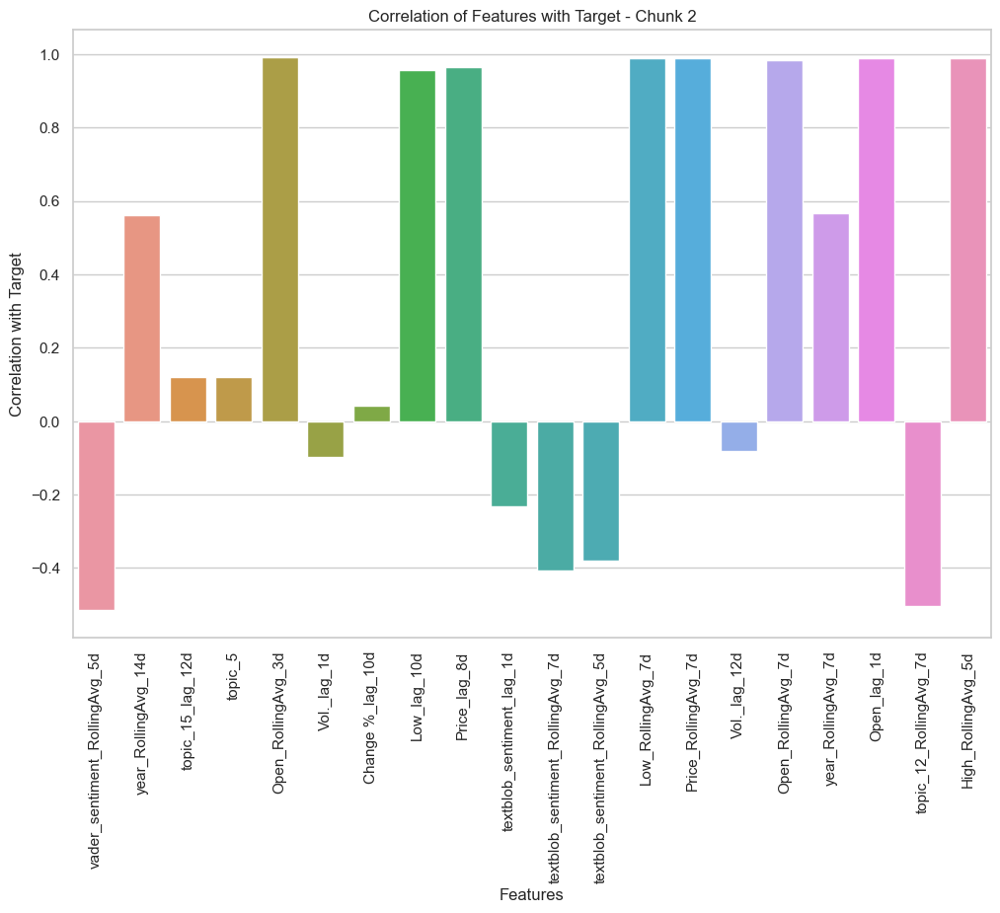

['High_lag_4d', 'Vol._RollingAvg_3d', 'Change %', 'Low_RollingAvg_3d', 'textblob_sentiment_RollingAvg_3d', 'textblob_sentiment_lag_4d', 'topic_12_lag_10d', 'topic_12_lag_4d', 'High_RollingAvg_3d', 'topic_14_RollingAvg_5d', 'Change %_lag_1d', 'Price_lag_1d', 'topic_14_lag_4d', 'topic_15_RollingAvg_7d', 'vader_sentiment_RollingAvg_14d', 'Open', 'textblob_sentiment_lag_12d', 'topic_12_lag_12d', 'vader_sentiment_lag_4d', 'Change %_RollingAvg_7d']
Chunk 3:
Price_lag_1d                        0.995602
Low_RollingAvg_3d                   0.994972
Open                                0.994547
High_RollingAvg_3d                  0.994093
High_lag_4d                         0.980485
topic_14_RollingAvg_5d              0.380506
topic_14_lag_4d                     0.356283
topic_15_RollingAvg_7d              0.184015
Change %_RollingAvg_7d              0.103308
Change %                            0.053465
Change %_lag_1d                     0.052996
Vol._RollingAvg_3d                 -0.111138
text

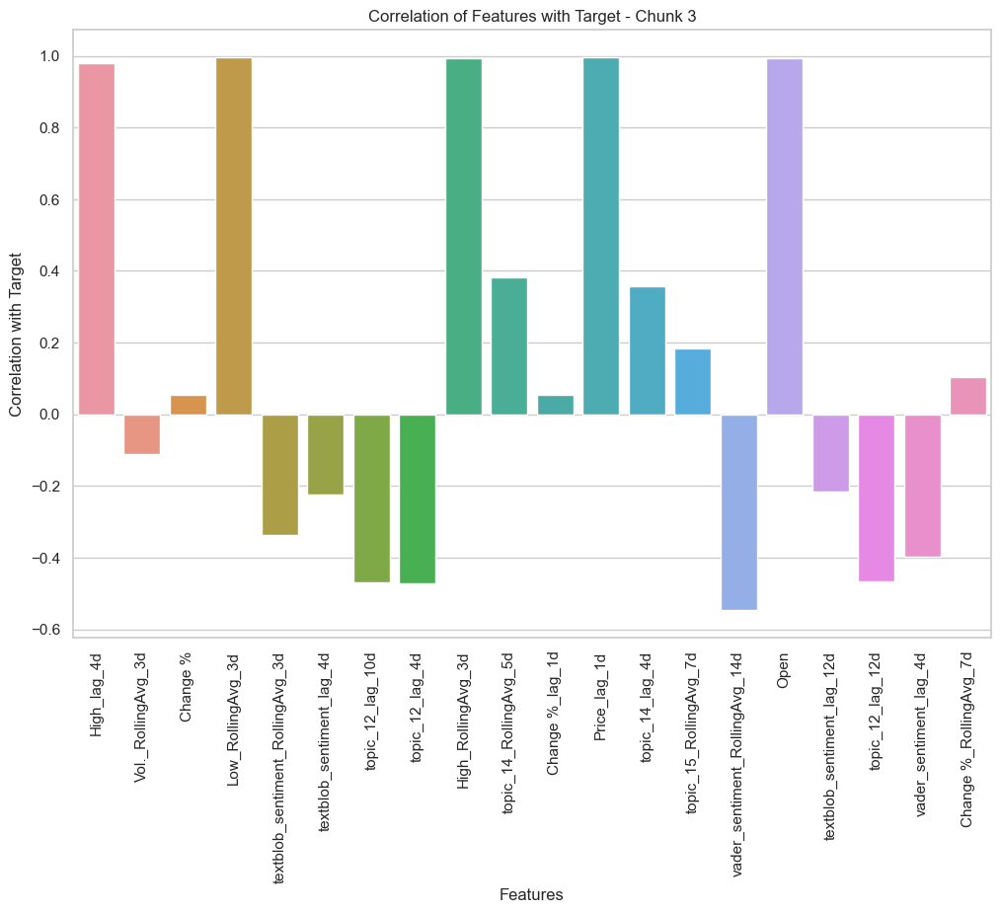

['topic_14_RollingAvg_7d', 'Change %_lag_2d', 'textblob_sentiment', 'Price_lag_4d', 'topic_12', 'topic_14_RollingAvg_14d', 'Open_lag_8d', 'topic_12_lag_1d', 'Low', 'Price_RollingAvg_5d', 'vader_sentiment_lag_10d', 'topic_5_lag_2d', 'Open_lag_10d', 'High', 'topic_14', 'Price_lag_2d', 'topic_5_lag_10d', 'textblob_sentiment_lag_10d', 'vader_sentiment_lag_2d', 'topic_15_lag_4d']
Chunk 4:
Low                           0.998158
High                          0.997584
Price_RollingAvg_5d           0.993679
Price_lag_2d                  0.991414
Price_lag_4d                  0.982812
Open_lag_8d                   0.961514
Open_lag_10d                  0.953530
topic_14_RollingAvg_14d       0.386468
topic_14_RollingAvg_7d        0.383374
topic_14                      0.353957
topic_15_lag_4d               0.142852
topic_5_lag_10d               0.122273
topic_5_lag_2d                0.115731
Change %_lag_2d               0.051727
textblob_sentiment_lag_10d   -0.220221
textblob_sentiment          

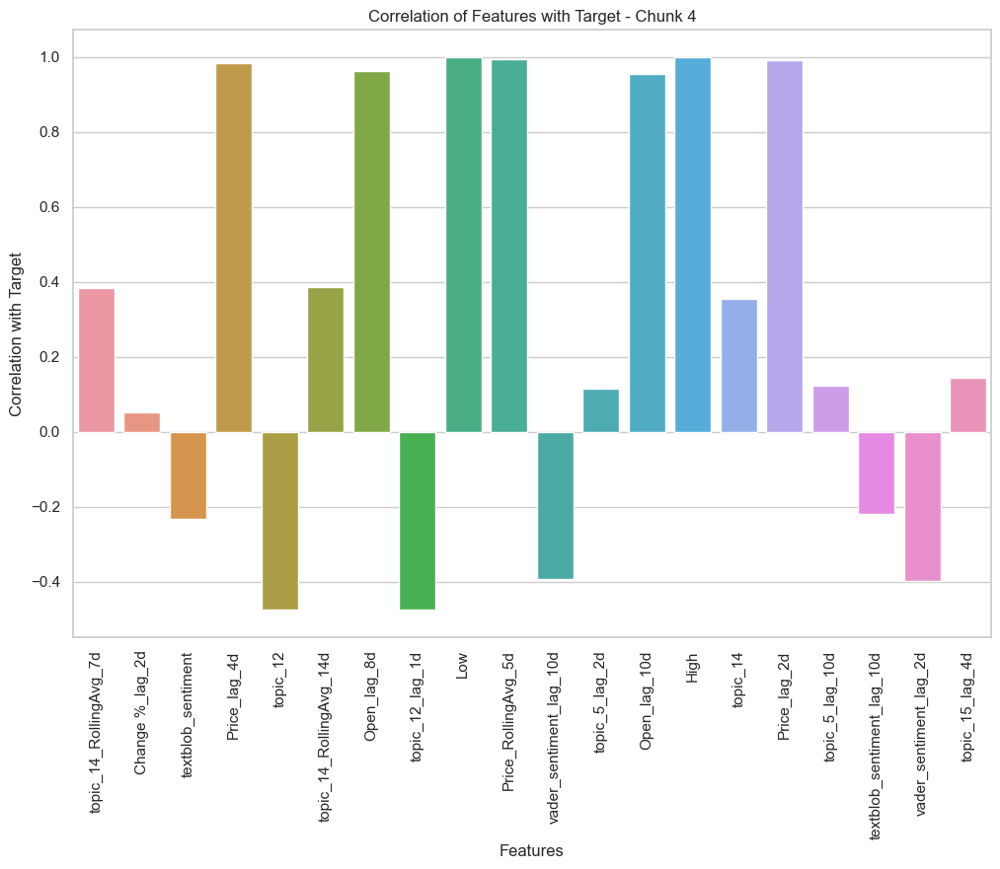

['Change %_RollingAvg_14d', 'Vol._RollingAvg_5d', 'month_RollingAvg_7d', 'vader_sentiment_lag_1d', 'topic_15_lag_1d', 'vader_sentiment_RollingAvg_3d', 'Low_RollingAvg_5d', 'High_RollingAvg_14d', 'topic_14_lag_2d', 'Vol._lag_4d', 'Open_RollingAvg_14d', 'topic_15', 'topic_5_lag_12d', 'vader_sentiment', 'Price_RollingAvg_14d', 'Change %_RollingAvg_5d', 'topic_5_RollingAvg_3d', 'topic_12_RollingAvg_14d', 'High_lag_12d', 'Open_RollingAvg_5d']
Chunk 5:
Low_RollingAvg_5d                0.991635
Open_RollingAvg_5d               0.988420
Price_RollingAvg_14d             0.979492
High_RollingAvg_14d              0.975729
Open_RollingAvg_14d              0.974541
High_lag_12d                     0.948225
topic_14_lag_2d                  0.355195
topic_5_RollingAvg_3d            0.178976
topic_15_lag_1d                  0.150657
topic_15                         0.147699
Change %_RollingAvg_14d          0.142208
topic_5_lag_12d                  0.115212
Change %_RollingAvg_5d           0.090626
mon

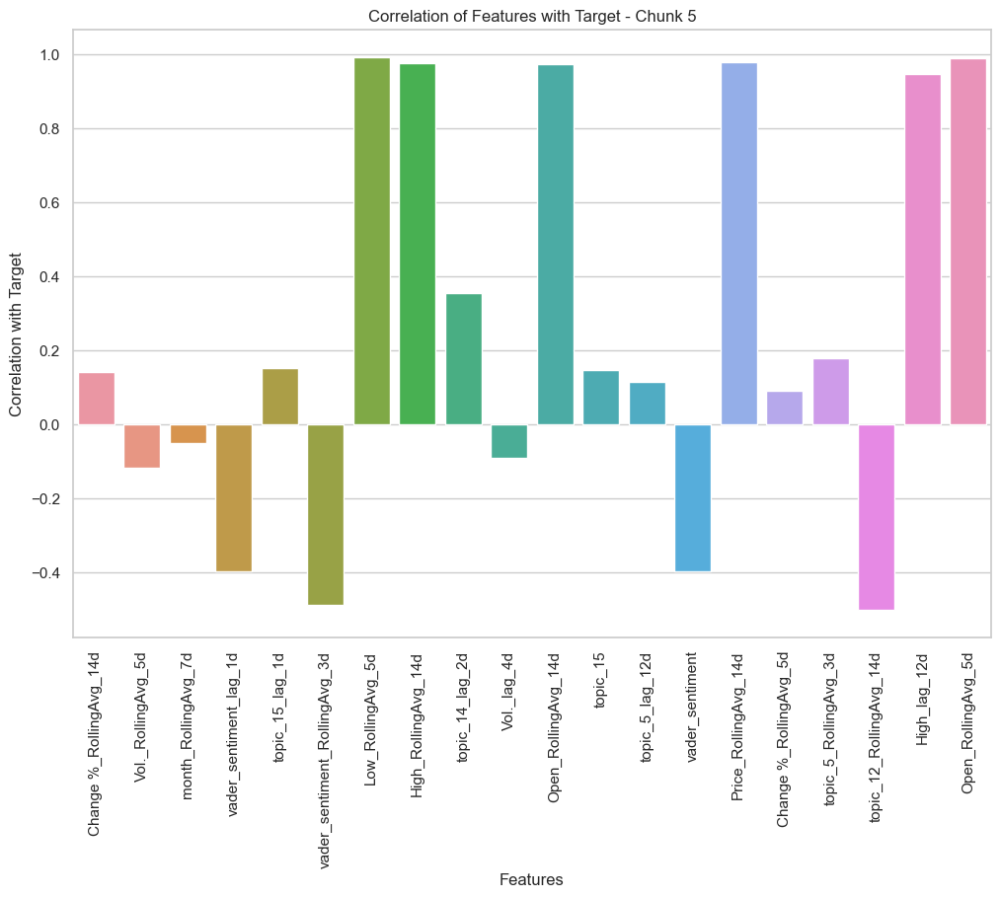

['Low_lag_8d', 'Change %_RollingAvg_3d', 'topic_14_lag_12d', 'topic_14_RollingAvg_3d', 'month_RollingAvg_5d', 'Open_lag_12d', 'High_RollingAvg_7d', 'Change %_lag_4d', 'topic_15_RollingAvg_3d', 'textblob_sentiment_lag_2d', 'topic_14_lag_1d', 'Low_lag_4d', 'topic_5_lag_4d', 'Change %_lag_12d', 'topic_15_RollingAvg_5d', 'month_RollingAvg_14d', 'topic_12_lag_2d', 'High_lag_10d', 'topic_12_lag_8d', 'Open_lag_2d']
Chunk 6:
High_RollingAvg_7d           0.987024
Open_lag_2d                  0.986146
Low_lag_4d                   0.980940
Low_lag_8d                   0.964104
High_lag_10d                 0.956198
Open_lag_12d                 0.945064
topic_14_RollingAvg_3d       0.374007
topic_14_lag_12d             0.361144
topic_14_lag_1d              0.354507
topic_15_RollingAvg_5d       0.182480
topic_15_RollingAvg_3d       0.175751
topic_5_lag_4d               0.116621
Change %_RollingAvg_3d       0.074828
Change %_lag_4d              0.049920
Change %_lag_12d             0.045864
month_Rol

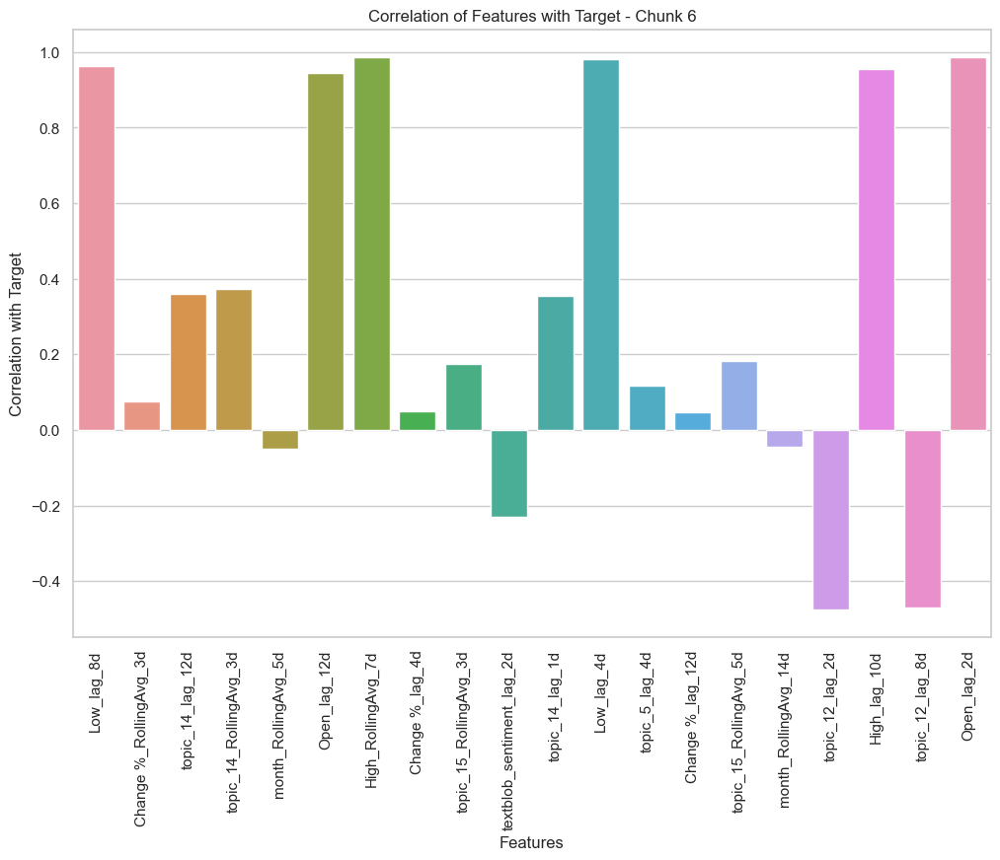

['topic_15_lag_2d', 'vader_sentiment_lag_8d', 'Open_lag_4d', 'Low_lag_2d', 'topic_15_lag_8d', 'topic_5_lag_1d', 'High_lag_8d', 'Vol._RollingAvg_7d', 'Low_lag_1d', 'year_RollingAvg_5d', 'Change %_lag_8d', 'Vol._lag_2d', 'topic_15_lag_10d', 'Price_lag_10d', 'Price_RollingAvg_3d', 'High_lag_2d', 'Vol._lag_10d']
Chunk 7:
Price_RollingAvg_3d       0.997032
Low_lag_1d                0.993658
Low_lag_2d                0.989524
High_lag_2d               0.989046
Open_lag_4d               0.977667
High_lag_8d               0.964001
Price_lag_10d             0.958166
year_RollingAvg_5d        0.567103
topic_15_lag_2d           0.148037
topic_15_lag_8d           0.128747
topic_15_lag_10d          0.121728
topic_5_lag_1d            0.113169
Change %_lag_8d           0.043809
Vol._lag_10d             -0.083911
Vol._lag_2d              -0.096380
Vol._RollingAvg_7d       -0.121653
vader_sentiment_lag_8d   -0.396086
dtype: float64


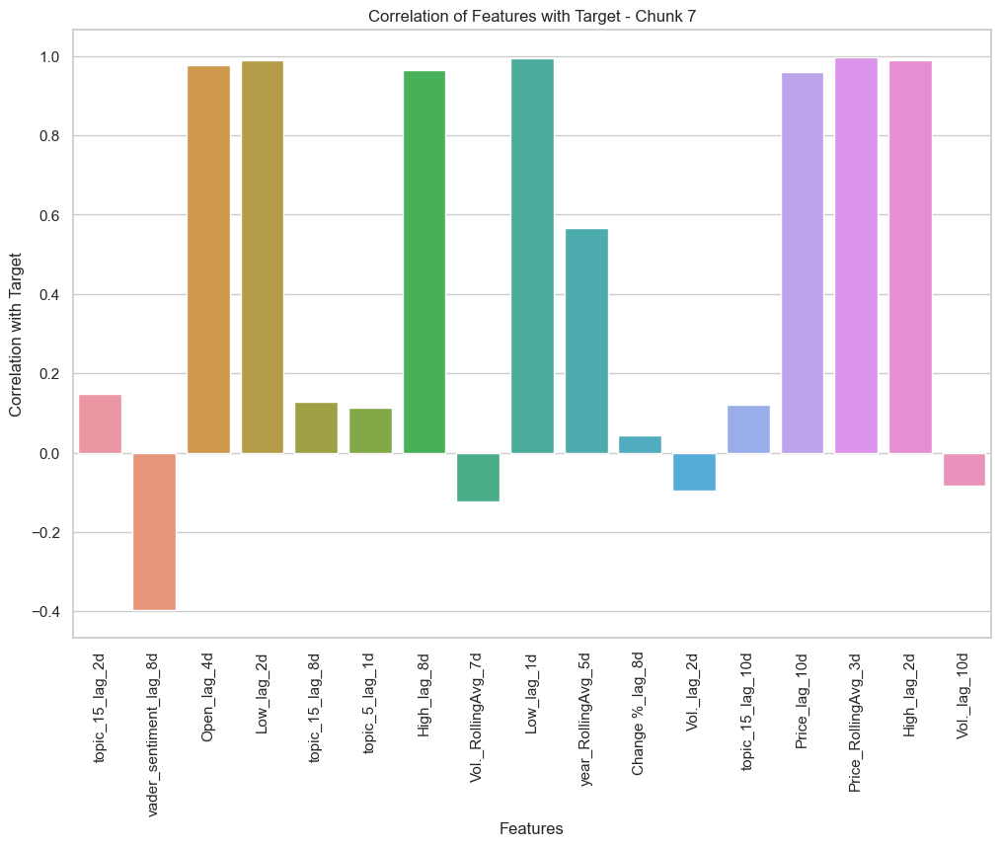

In [1486]:
# Define the number of columns per iteration
chunk_size = 20

# Iterate over columns in chunks
for i in range(0, len(continuous_columns), chunk_size):
    # Select the current chunk of columns
    chunk_columns = continuous_columns[i:i + chunk_size]
    print(chunk_columns)
    X = merged_df[chunk_columns]
    y = merged_df[target_column]
    
    # Calculate correlation with the target
    correlations = X.corrwith(y)
    
    # Display correlations
    print(f'Chunk {i // chunk_size + 1}:')
    print(correlations.sort_values(ascending=False))
    
    # Plot correlations
    plt.figure(figsize=(12, 8))
    sns.barplot(x=correlations.index, y=correlations.values)
    plt.xticks(rotation=90)
    plt.title(f"Correlation of Features with Target - Chunk {i // chunk_size + 1}")
    plt.xlabel("Features")
    plt.ylabel("Correlation with Target")
    plt.show()

In [1487]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.feature_selection import RFE
from sklearn.metrics import mean_squared_error
import seaborn as sns
import matplotlib.pyplot as plt


Top 20 Scores with Target:
                              Feature        Score
70                 year_RollingAvg_5d  1887.274352
20                 year_RollingAvg_7d  1876.105019
14                year_RollingAvg_14d  1840.328891
29     vader_sentiment_RollingAvg_14d  1694.956963
1       vader_sentiment_RollingAvg_7d  1554.167110
13      vader_sentiment_RollingAvg_5d  1436.551761
21             topic_12_RollingAvg_7d  1361.911653
10             topic_12_RollingAvg_5d  1349.460210
54            topic_12_RollingAvg_14d  1344.510016
12             topic_12_RollingAvg_3d  1302.699758
48      vader_sentiment_RollingAvg_3d  1239.905661
35                           topic_12  1160.397909
64                    topic_12_lag_2d  1157.462533
37                    topic_12_lag_1d  1157.384635
25                    topic_12_lag_4d  1147.084824
65                    topic_12_lag_8d  1123.604406
24                   topic_12_lag_10d  1114.991302
31                   topic_12_lag_12d  1105.890122
5   

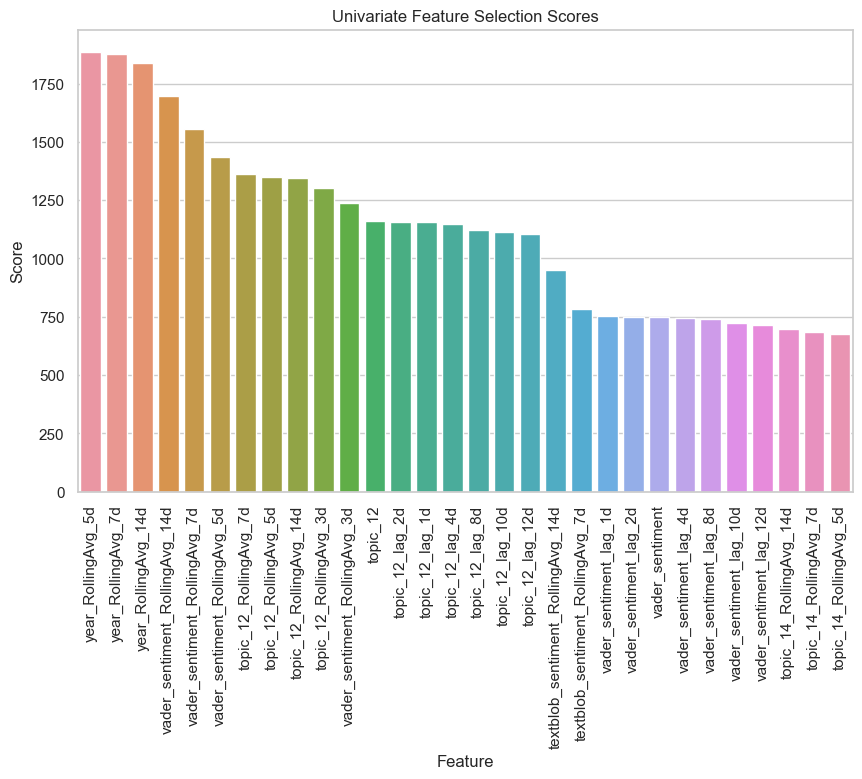

In [1488]:
X = merged_df[news_columns]
y = merged_df[target_column]

# Apply SelectKBest with f_regression
k_best = SelectKBest(score_func=f_regression, k='all')
k_best.fit(X, y)

# Display the scores
scores = pd.DataFrame({'Feature': news_columns, 'Score': k_best.scores_})

# Sort correlations in descending order and select the top 20
top_20_scores = scores.sort_values(by='Score', ascending=False).head(30)

# Display top 20 correlations
print("Top 20 Scores with Target:")
print(top_20_scores)

# Plot scores
plt.figure(figsize=(10, 6))
sns.barplot(x=top_20_scores['Feature'], y=top_20_scores['Score'])
plt.xticks(rotation=90)
plt.title("Univariate Feature Selection Scores")
plt.show()

Top 20 Scores with Target:
                  Feature         Score
68                    Low  1.077794e+06
73                   High  8.209023e+05
134   Price_RollingAvg_3d  6.675905e+05
51           Price_lag_1d  4.496192e+05
43      Low_RollingAvg_3d  3.929315e+05
55                   Open  3.620481e+05
48     High_RollingAvg_3d  3.339982e+05
69    Price_RollingAvg_5d  3.119280e+05
128            Low_lag_1d  3.108747e+05
7             High_lag_1d  2.902366e+05
24     Open_RollingAvg_3d  2.364407e+05
86      Low_RollingAvg_5d  2.349878e+05
75           Price_lag_2d  2.288594e+05
39     High_RollingAvg_5d  2.055788e+05
33    Price_RollingAvg_7d  2.041885e+05
37            Open_lag_1d  2.012742e+05
123            Low_lag_2d  1.870166e+05
135           High_lag_2d  1.787386e+05
99     Open_RollingAvg_5d  1.689097e+05
32      Low_RollingAvg_7d  1.685453e+05
106    High_RollingAvg_7d  1.504173e+05
119           Open_lag_2d  1.406942e+05
35     Open_RollingAvg_7d  1.322868e+05
63           

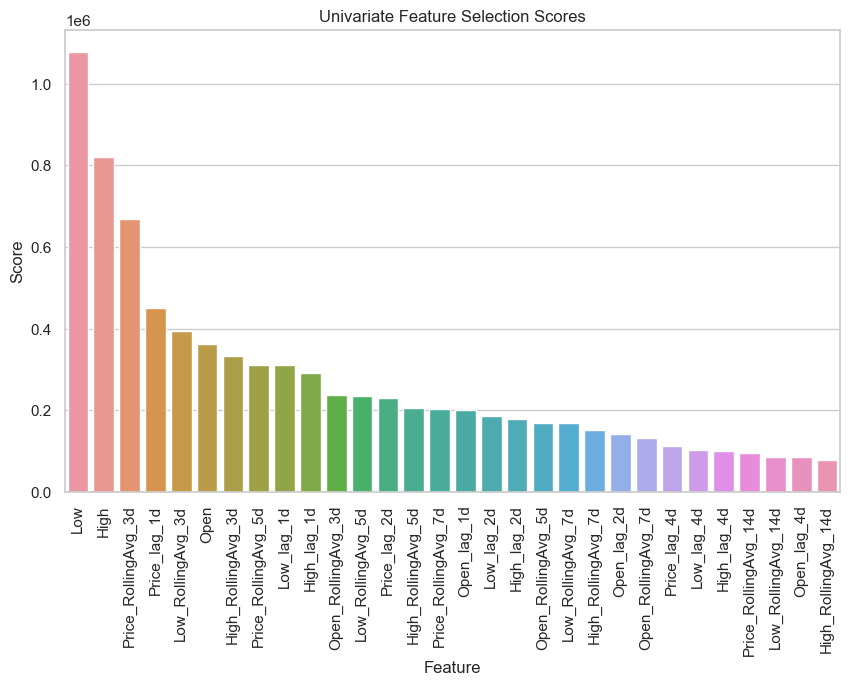

In [1489]:
X = merged_df[continuous_columns]
y = merged_df[target_column]

# Apply SelectKBest with f_regression
k_best = SelectKBest(score_func=f_regression, k='all')
k_best.fit(X, y)

# Display the scores
scores = pd.DataFrame({'Feature': continuous_columns, 'Score': k_best.scores_})

# Sort correlations in descending order and select the top 20
top_20_scores = scores.sort_values(by='Score', ascending=False).head(30)

# Display top 20 correlations
print("Top 20 Scores with Target:")
print(top_20_scores)

# Plot scores
plt.figure(figsize=(10, 6))
sns.barplot(x=top_20_scores['Feature'], y=top_20_scores['Score'])
plt.xticks(rotation=90)
plt.title("Univariate Feature Selection Scores")
plt.show()


In [1523]:
# # Define the model
# model = RandomForestRegressor()

# # Initialize RFE
# rfe = RFE(estimator=model, n_features_to_select=20)  # You can set n_features_to_select as needed
# rfe.fit(X, y)

# # Display the rankings
# rfe_ranking = pd.DataFrame({'Feature': continuous_columns, 'Ranking': rfe.ranking_})
# print(rfe_ranking.sort_values(by='Ranking'))

# # Plot RFE rankings
# plt.figure(figsize=(10, 6))
# sns.barplot(x=rfe_ranking['Feature'], y=rfe_ranking['Ranking'])
# plt.xticks(rotation=90)
# plt.title("RFE Feature Ranking")
# plt.show()


In [ ]:
# # Fit a RandomForestRegressor
# model.fit(X, y)

# # Get feature importances
# importances = model.feature_importances_

# # Display feature importances
# feature_importance_df = pd.DataFrame({'Feature': continuous_columns, 'Importance': importances})
# print(feature_importance_df.sort_values(by='Importance', ascending=False))

# # Plot feature importances
# plt.figure(figsize=(10, 6))
# sns.barplot(x=feature_importance_df['Feature'], y=feature_importance_df['Importance'])
# plt.xticks(rotation=90)
# plt.title("Feature Importance from RandomForest")
# plt.show()


# Feature Selection

In [802]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.feature_selection import SelectFromModel
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt

In [803]:
X = merged_df[continuous_columns]
y = merged_df[target_column]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [804]:
# 1. Correlation Analysis
correlation_with_target = X_train.corrwith(y_train)
highly_correlated_features = correlation_with_target[abs(correlation_with_target) > 0.1].index.tolist()
print(f"Features highly correlated with target: {highly_correlated_features}")


Features highly correlated with target: ['topic_15_RollingAvg_14d', 'Low_RollingAvg_14d', 'Price_lag_12d', 'vader_sentiment_RollingAvg_7d', 'topic_5_RollingAvg_7d', 'vader_sentiment_lag_12d', 'High_lag_1d', 'Low_lag_12d', 'Vol._RollingAvg_14d', 'topic_5_lag_8d', 'textblob_sentiment_RollingAvg_14d', 'topic_14_lag_10d', 'topic_14_lag_8d', 'topic_5_RollingAvg_14d', 'textblob_sentiment_lag_8d', 'topic_12_RollingAvg_5d', 'topic_5_RollingAvg_5d', 'topic_12_RollingAvg_3d', 'vader_sentiment_RollingAvg_5d', 'topic_15_lag_12d', 'topic_5', 'Open_RollingAvg_3d', 'Low_lag_10d', 'Price_lag_8d', 'textblob_sentiment_lag_1d', 'textblob_sentiment_RollingAvg_7d', 'textblob_sentiment_RollingAvg_5d', 'Low_RollingAvg_7d', 'Price_RollingAvg_7d', 'Open_RollingAvg_7d', 'Open_lag_1d', 'topic_12_RollingAvg_7d', 'High_RollingAvg_5d', 'High_lag_4d', 'Vol._RollingAvg_3d', 'Low_RollingAvg_3d', 'textblob_sentiment_RollingAvg_3d', 'textblob_sentiment_lag_4d', 'topic_12_lag_10d', 'topic_12_lag_4d', 'High_RollingAvg_3d'

In [434]:
# Train a Random Forest model
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Get feature importances
importances = model.feature_importances_

# Create a DataFrame for visualization
feature_importances = pd.DataFrame({'Feature': X.columns, 'Importance': importances})
feature_importances = feature_importances.sort_values(by='Importance', ascending=False)

# Display the top features
print(feature_importances.head(10))


                   Feature  Importance
3                 topic_12    0.291170
5          vader_sentiment    0.167016
1                 topic_14    0.071508
4                 topic_15    0.068923
26  PERSON_hillary clinton    0.039235
32              GPE_russia    0.028820
2                  topic_5    0.026878
15           PERSON_bernie    0.023487
82        CARDINAL_million    0.022321
67            TIME_morning    0.014537


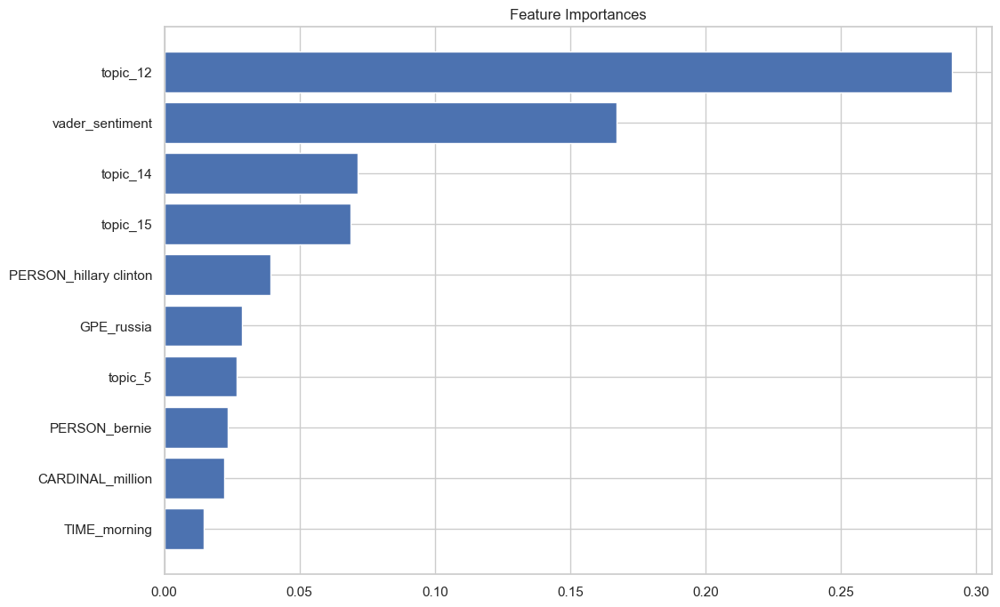

In [435]:
# Plot the feature importances
plt.figure(figsize=(12, 8))
plt.barh(feature_importances['Feature'].head(10), feature_importances['Importance'].head(10))
plt.gca().invert_yaxis()
plt.title('Feature Importances')
plt.show()


In [436]:
# Automatically select the best features using SelectFromModel
selector = SelectFromModel(model, prefit=True, threshold="mean")  # Keep features above the mean importance
best_features = X.columns[selector.get_support()]

print(f"Best Features: {best_features.tolist()}")


Best Features: ['topic_14', 'topic_5', 'topic_12', 'topic_15', 'vader_sentiment', 'PERSON_bernie', 'PERSON_hillary clinton', 'GPE_america', 'GPE_russia', 'NORP_republican', 'CARDINAL_one', 'ORG_gop', 'TIME_morning', 'CARDINAL_million']


# Checking the distribution

KeyboardInterrupt: 

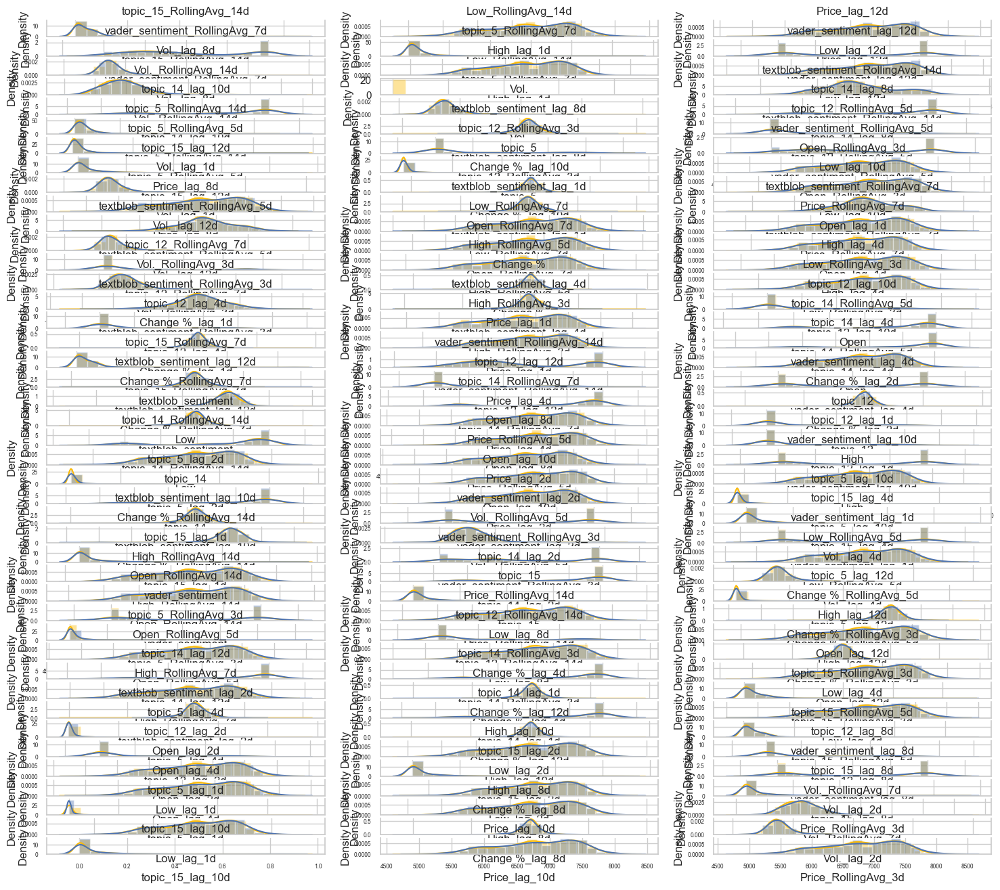

In [691]:
plt.rcParams['figure.figsize'] =[18,16]
cols = X_train.columns
fig,axes = plt.subplots(nrows =len(cols)//3, ncols= 3)
fig.figsize = [10,6]
axes = axes.flatten()
for i in range(len(cols)):
    try:
        sns.distplot(X_train[cols[i]],bins =20,hist = True,kde = True,color = "#fcba03",ax = axes[i])
        sns.distplot(X_test[cols[i]],bins =20,hist = True,kde = True,color = "b",ax = axes[i])
        axes[i].set_title(cols[i])
        axes[i].spines["top"].set_alpha(0)
        axes[i].tick_params(labelsize = 6)
    except:
        pass
plt.tight_layout()

# Feature Selection - pvalue -> Continuous 
# ADF Fuller Test for Timeseries Feature Selection

In [1442]:
from statsmodels.tsa.stattools import adfuller
def adf_test(series):
    result = adfuller(series.dropna(), autolag='AIC')
    return result[1] 

In [1490]:
selected_features = []
for column in X_train.columns:
    p_value = adf_test(X_train[column])
    if p_value < 0.05:  # Assuming 5% significance level
        selected_features.append(column)

selected_features

['Change %_RollingAvg_7d',
 'Change %_RollingAvg_14d',
 'textblob_sentiment_lag_2d',
 'Change %_lag_1d',
 'Vol.',
 'Vol._RollingAvg_14d',
 'Change %_lag_4d',
 'Change %_RollingAvg_5d',
 'topic_15_lag_12d',
 'topic_5_lag_12d',
 'topic_5_RollingAvg_3d',
 'textblob_sentiment_lag_8d',
 'Vol._lag_12d',
 'Change %_lag_2d',
 'Change %_RollingAvg_3d',
 'topic_5_lag_1d',
 'topic_5_lag_4d',
 'topic_5_lag_2d',
 'Vol._lag_10d',
 'Change %_lag_10d',
 'vader_sentiment_lag_2d',
 'Change %_lag_8d',
 'topic_5_RollingAvg_5d',
 'topic_5_RollingAvg_14d',
 'Change %_lag_12d',
 'topic_5',
 'topic_15_lag_8d',
 'topic_15',
 'topic_15_lag_4d',
 'topic_5_lag_8d',
 'Vol._lag_1d',
 'topic_5_lag_10d',
 'GPE_russia_RollingAvg_14d',
 'GPE_russia_RollingAvg_7d',
 'NORP_russian_RollingAvg_14d',
 'GPE_russia_RollingAvg_5d',
 'NORP_russian_RollingAvg_7d',
 'TIME_night_RollingAvg_14d',
 'GPE_russia_RollingAvg_3d',
 'NORP_russian_RollingAvg_5d',
 'PERSON_putin_RollingAvg_14d',
 'CARDINAL_one_RollingAvg_14d',
 'TIME_night_

In [1548]:
X = merged_df[selected_features]
y = merged_df[target_column]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [1549]:
from scipy.stats import ks_2samp
import numpy as np

'''
    Under the null hypothesis the two distributions are identical. 
    If the K-S statistic is small or the p-value is high (greater than the significance level, say 5%),
    then we cannot reject the hypothesis that the distributions of the two samples are the same. 
    Conversely, we can reject the null hypothesis if the p-value is low.
'''
np.random.seed(42)
good_dist = []
statistics = []
pvalue = []
cols = selected_features

for i in range(len(cols)):
#     print(cols[i])
    ks_result = ks_2samp(X_train[cols[i]], X_test[cols[i]])
    p = ks_result[1]
    
    statistics.append(ks_result[0])
    pvalue.append(ks_result[1])
    
    if p>0.05:
        good_dist.append((cols[i],p))
    else:
        print((cols[i],p))
        
ks_results = pd.DataFrame(data = {'features':cols,'statistics':statistics,'pvalue':pvalue},).sort_values('pvalue').reset_index(drop = True)
# ks_results = ks_results[:60]
continuous_features = list(ks_results[ks_results['pvalue']>=0.5]['features'])
print(f'There are {len(continuous_features)} features which have similar distribution in train and test data.')
print("---"*20)
print(f'There are {ks_results.shape[0]-len(continuous_features)} features which don\'t have similar distribution in train and test data.')
print(continuous_features)

There are 727 features which have similar distribution in train and test data.
------------------------------------------------------------
There are 25 features which don't have similar distribution in train and test data.
['ORG_gop_RollingAvg_7d', 'Change %_RollingAvg_7d', 'ORDINAL_first_lag_10d', 'CARDINAL_three_RollingAvg_14d', 'NORP_democrat_RollingAvg_5d', 'CARDINAL_million_RollingAvg_3d', 'CARDINAL_million_RollingAvg_14d', 'GPE_russia_RollingAvg_14d', 'Change %_RollingAvg_14d', 'GPE_london_lag_2d', 'dayofweek', 'TIME_tonight_RollingAvg_7d', 'CARDINAL_two', 'textblob_sentiment_lag_2d', 'GPE_china_RollingAvg_14d', 'Change %_lag_1d', 'NORP_russian_RollingAvg_5d', 'ORG_gop_lag_4d', 'CARDINAL_three_RollingAvg_3d', 'Vol.', 'CARDINAL_one_RollingAvg_5d', 'ORDINAL_first_RollingAvg_5d', 'LOC_africa_lag_1d', 'CARDINAL_three_lag_12d', 'LOC_caribbean_RollingAvg_14d', 'ORDINAL_first_RollingAvg_3d', 'CARDINAL_three_lag_8d', 'Vol._RollingAvg_14d', 'Change %_lag_4d', 'Change %_RollingAvg_5d', 't

In [806]:
ks_results

,features,statistics,pvalue
0,topic_14_lag_1d,0.061151,0.003640
1,Vol._lag_2d,0.049555,0.031528
2,topic_14_RollingAvg_3d,0.046323,0.053141
3,textblob_sentiment_lag_1d,0.045359,0.061724
4,topic_14_lag_12d,0.044172,0.073723
...,...,...,...
126,topic_15,0.016233,0.976979
127,topic_15_lag_4d,0.015650,0.984086
128,topic_5_lag_8d,0.015207,0.988403
129,Vol._lag_1d,0.013247,0.998056


# regression_features

In [1491]:
# From selected Features
X = merged_df[selected_features]
y = merged_df[target_column]

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [1492]:
from sklearn.feature_selection import f_regression
'''
Formulate the test statistic for the F-test a.k.a. the F-statistic.
Identify the Probability Density Function of the random variable that
the F-statistic represents under the assumption that the null hypothesis is true.
Plug in the values into the formula for the F-statistic and 
calculate the corresponding probability value using the Probability Density Function found in step 2.
This is the probability of observing the F-statistic value assuming that the null hypothesis is true.
If the probability found in step 3 is less than the error threshold such as 0.05, 
reject the null hypothesis and accept the alternate hypothesis
at a confidence level of (1.0 — error threshold), for e.g. 1–0.05 = 0.95 (i.e. 95% confidence level). 
Otherwise, accept the null hypothesis with a probability of error equal to the threshold error, for e.g. at 0.05 or 5%.

Null hypothesis (H0) : The model with no predictor variables (also known as an intercept-only model) fits the data as well as your regression model.

Alternative hypothesis (HA) : Your regression model fits the data better than the intercept-only model.

'''



f_statistic,p_value = f_regression(X_train,y_train)

f_result = pd.DataFrame({'Features':X_train.columns,"F-statistics":f_statistic,"p-value":p_value}).sort_values(by = 'p-value').reset_index(drop = True)
regression_features = list(f_result[f_result['p-value']<0.5]['Features'])

print(f'There are {len(regression_features)} features which have good relation with y.')
print(f'There are {f_result.shape[0]-len(regression_features)} features which don\'t have good relation with y.')
print(regression_features)


There are 752 features which have good relation with y.
There are 0 features which don't have good relation with y.
['GPE_russia_RollingAvg_14d', 'vader_sentiment_lag_2d', 'GPE_russia_RollingAvg_7d', 'NORP_russian_RollingAvg_14d', 'GPE_russia_RollingAvg_5d', 'NORP_russian_RollingAvg_7d', 'TIME_night_RollingAvg_14d', 'GPE_russia_RollingAvg_3d', 'NORP_russian_RollingAvg_5d', 'PERSON_putin_RollingAvg_14d', 'CARDINAL_one_RollingAvg_14d', 'TIME_night_RollingAvg_7d', 'CARDINAL_one_RollingAvg_7d', 'topic_5_RollingAvg_14d', 'NORP_russian_RollingAvg_3d', 'TIME_night_RollingAvg_5d', 'CARDINAL_one_RollingAvg_5d', 'PERSON_putin_RollingAvg_7d', 'QUANTITY_mile_RollingAvg_14d', 'GPE_russia', 'CARDINAL_one_RollingAvg_3d', 'GPE_russia_lag_10d', 'GPE_russia_lag_12d', 'GPE_america_RollingAvg_3d', 'GPE_russia_lag_1d', 'TIME_night_RollingAvg_3d', 'GPE_russia_lag_4d', 'PERSON_putin_RollingAvg_5d', 'GPE_russia_lag_8d', 'GPE_russia_lag_2d', 'QUANTITY_mile_RollingAvg_7d', 'textblob_sentiment_lag_2d', 'PERSON_p

# There are 752 features which have good relation with y.
# There are 0 features which don't have good relation with y.

In [1493]:
regression_features

['GPE_russia_RollingAvg_14d',
 'vader_sentiment_lag_2d',
 'GPE_russia_RollingAvg_7d',
 'NORP_russian_RollingAvg_14d',
 'GPE_russia_RollingAvg_5d',
 'NORP_russian_RollingAvg_7d',
 'TIME_night_RollingAvg_14d',
 'GPE_russia_RollingAvg_3d',
 'NORP_russian_RollingAvg_5d',
 'PERSON_putin_RollingAvg_14d',
 'CARDINAL_one_RollingAvg_14d',
 'TIME_night_RollingAvg_7d',
 'CARDINAL_one_RollingAvg_7d',
 'topic_5_RollingAvg_14d',
 'NORP_russian_RollingAvg_3d',
 'TIME_night_RollingAvg_5d',
 'CARDINAL_one_RollingAvg_5d',
 'PERSON_putin_RollingAvg_7d',
 'QUANTITY_mile_RollingAvg_14d',
 'GPE_russia',
 'CARDINAL_one_RollingAvg_3d',
 'GPE_russia_lag_10d',
 'GPE_russia_lag_12d',
 'GPE_america_RollingAvg_3d',
 'GPE_russia_lag_1d',
 'TIME_night_RollingAvg_3d',
 'GPE_russia_lag_4d',
 'PERSON_putin_RollingAvg_5d',
 'GPE_russia_lag_8d',
 'GPE_russia_lag_2d',
 'QUANTITY_mile_RollingAvg_7d',
 'textblob_sentiment_lag_2d',
 'PERSON_putin_RollingAvg_3d',
 'textblob_sentiment_lag_8d',
 'GPE_america_lag_2d',
 'GPE_amer

# Create Validation Test Set

## Reiterative Process to find the current week Features Selection as News Impact will chnage

## Ensemble Weight Also Changes according to the scenario

### Select last week DATA

# Important Create own future test features e.g. news_topic_1 by rolling average as we don't have the future data - So real scenario replicate in validation test as well

In [1494]:
forecast_duration = 7

In [1559]:
train_df = merged_df_org[:-forecast_duration]
train_df.tail(forecast_duration)

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
4607,2024-08-14,8281.05,8235.23,8288.72,8230.68,592.00,0.56,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4608,2024-08-15,8347.35,8281.05,8366.98,8277.08,842.33,0.80,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4609,2024-08-16,8311.41,8347.35,8350.35,8292.01,515.44,-0.43,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4610,2024-08-17,8311.41,8347.35,8350.35,8292.01,515.44,-0.43,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4611,2024-08-18,8311.41,8347.35,8350.35,8292.01,515.44,-0.43,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4612,2024-08-19,8356.94,8311.41,8374.02,8286.50,637.83,0.55,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4613,2024-08-20,8273.32,8356.94,8356.94,8270.69,490.22,-1.00,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [1560]:
test_df = merged_df_org[-forecast_duration:]
test_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
4614,2024-08-21,8283.43,8273.32,8295.94,8263.01,824.97,0.12,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4615,2024-08-22,8288.00,8283.43,8318.55,8276.99,796.91,0.06,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4616,2024-08-23,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4617,2024-08-24,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4618,2024-08-25,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4619,2024-08-26,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4620,2024-08-27,8345.46,8327.78,8400.43,8327.78,772.31,0.21,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [1561]:
test_df['time_index'] = test_df['date']

# Convert 'Date' to index
test_df.set_index('time_index', inplace=True)
test_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
time_index,,,,,,,,,,,,,,,,,,,,,
2024-08-21,2024-08-21,8283.43,8273.32,8295.94,8263.01,824.97,0.12,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2024-08-22,2024-08-22,8288.00,8283.43,8318.55,8276.99,796.91,0.06,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2024-08-23,2024-08-23,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2024-08-24,2024-08-24,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2024-08-25,2024-08-25,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2024-08-26,2024-08-26,8327.78,8288.00,8331.90,8288.00,614.51,0.48,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2024-08-27,2024-08-27,8345.46,8327.78,8400.43,8327.78,772.31,0.21,-0.8779,0.005556,1.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# Create Future Data - we can see Saturday & Sunday Data is missing in stock data - AS market is close

# For Validation do not take real value create from prvious values - Real Scenario

In [1562]:
# Create future dates for the next week
last_train_date = train_df['date'].max()
# Create future dates DataFrame
future_dates = pd.date_range(start=last_train_date + timedelta(days=1), periods=forecast_duration, freq='D')
future_df = pd.DataFrame({'date': future_dates})
future_df

,date
0,2024-08-21
1,2024-08-22
2,2024-08-23
3,2024-08-24
4,2024-08-25
5,2024-08-26
6,2024-08-27


In [1563]:
# Merge future dates with the original DataFrame
future_df = future_df.merge(train_df, on='date', how='left')
future_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2024-08-21,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2024-08-22,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2024-08-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2024-08-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2024-08-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,2024-08-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,2024-08-27,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1564]:
# Append the future dates DataFrame to the original training DataFrame
train_df = pd.concat([train_df, future_df], ignore_index=True)
train_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2012-01-03,5699.91,5572.28,5699.91,5572.28,778.53,2.29,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
1,2012-01-04,5668.45,5699.91,5719.83,5646.36,696.94,-0.55,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
2,2012-01-05,5624.26,5668.45,5689.33,5614.38,794.28,-0.78,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
3,2012-01-06,5649.68,5624.26,5682.78,5623.36,705.02,0.45,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
4,2012-01-07,5649.68,5624.26,5682.78,5623.36,705.02,0.45,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4616,2024-08-23,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4617,2024-08-24,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4618,2024-08-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4619,2024-08-26,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [1565]:
# Function to fill NaN values using previous 7 values
def fill_with_previous_forecast_duration(series):
    filled_series = series.copy()
    for i in range(len(series)):
        if pd.isna(series.iloc[i]):
            # Get previous 7 values
            previous_values = series[max(0, i-forecast_duration):i]
            # Calculate mean of previous 7 values
            mean_value = previous_values.mean()
            filled_series.iloc[i] = mean_value
    return filled_series


In [1566]:
# Loop through columns and print names excluding 'Price' and 'date'
for col in train_df.columns:
    if col != 'date':
#         print(col)   
        # Apply the function to the target column
        train_df[col] = fill_with_previous_forecast_duration(train_df[col])
        
train_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2012-01-03,5699.910,5572.280000,5699.910000,5572.280000,778.5300,2.290000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
1,2012-01-04,5668.450,5699.910000,5719.830000,5646.360000,696.9400,-0.550000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
2,2012-01-05,5624.260,5668.450000,5689.330000,5614.380000,794.2800,-0.780000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
3,2012-01-06,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
4,2012-01-07,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4616,2024-08-23,8312.898,8342.080000,8356.402000,8286.644000,534.8740,-0.348000,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4617,2024-08-24,8313.270,8340.762500,8357.915000,8285.302500,539.7325,-0.327500,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4618,2024-08-25,8313.890,8338.566667,8360.436667,8283.066667,547.8300,-0.293333,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4619,2024-08-26,8315.130,8334.175000,8365.480000,8278.595000,564.0250,-0.225000,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000


In [1567]:
# Forward-fill missing values in the future dates DataFrame
train_df.fillna(method='ffill', inplace=True)
train_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2012-01-03,5699.910,5572.280000,5699.910000,5572.280000,778.5300,2.290000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
1,2012-01-04,5668.450,5699.910000,5719.830000,5646.360000,696.9400,-0.550000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
2,2012-01-05,5624.260,5668.450000,5689.330000,5614.380000,794.2800,-0.780000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
3,2012-01-06,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
4,2012-01-07,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4616,2024-08-23,8312.898,8342.080000,8356.402000,8286.644000,534.8740,-0.348000,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4617,2024-08-24,8313.270,8340.762500,8357.915000,8285.302500,539.7325,-0.327500,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4618,2024-08-25,8313.890,8338.566667,8360.436667,8283.066667,547.8300,-0.293333,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4619,2024-08-26,8315.130,8334.175000,8365.480000,8278.595000,564.0250,-0.225000,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000


In [1568]:
# Fill missing values with mean of the columns
train_df = train_df.fillna(train_df.mean(numeric_only=True))
train_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,QUANTITY_thousand mile,QUANTITY_gallon,QUANTITY_hundred mile,QUANTITY_mile,QUANTITY_two mile,TIME_morning,TIME_night,TIME_hour,TIME_tonight,TIME_evening
0,2012-01-03,5699.910,5572.280000,5699.910000,5572.280000,778.5300,2.290000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
1,2012-01-04,5668.450,5699.910000,5719.830000,5646.360000,696.9400,-0.550000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
2,2012-01-05,5624.260,5668.450000,5689.330000,5614.380000,794.2800,-0.780000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
3,2012-01-06,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
4,2012-01-07,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.002829,0.00718,0.001523,0.124891,0.001088,0.1745,0.249782,0.181027,0.033943,0.053525
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4616,2024-08-23,8312.898,8342.080000,8356.402000,8286.644000,534.8740,-0.348000,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4617,2024-08-24,8313.270,8340.762500,8357.915000,8285.302500,539.7325,-0.327500,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4618,2024-08-25,8313.890,8338.566667,8360.436667,8283.066667,547.8300,-0.293333,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000
4619,2024-08-26,8315.130,8334.175000,8365.480000,8278.595000,564.0250,-0.225000,-0.877900,0.005556,1.000000,...,0.000000,0.00000,0.000000,0.000000,0.000000,0.0000,0.000000,0.000000,0.000000,0.000000


In [1569]:
# Loop through columns and print names excluding 'Price' and 'date'
for col in merged_df.columns:
    if col != 'date':
        print(col)
        try:
            train_df = generate_lag_features(train_df, target_col = col)
        except:
            pass
train_df

Price
Open
High
Low
Vol.
Change %
vader_sentiment
textblob_sentiment
is_event
topic_12
topic_14
topic_15
topic_4
topic_5
topic_1
topic_8
topic_7
topic_10
topic_6
topic_9
topic_3
topic_0
CARDINAL_one
CARDINAL_two
CARDINAL_million
CARDINAL_three
CARDINAL_six
EVENT_vietnam
EVENT_wwii
EVENT_super bowl
EVENT_hurricane katrina
EVENT_iraq war
FAC_guantanamo
FAC_uva
FAC_notre dame
FAC_north london
FAC_nikki haley
GPE_london
GPE_russia
GPE_america
GPE_california
GPE_china
LAW_rico
LAW_camilla wear
LAW_crown new
LAW_superfund
LAW_west ham
LOC_europe
LOC_middle east
LOC_africa
LOC_caribbean
LOC_asia
MONEY_mike penny
MONEY_million dollar
MONEY_billion dollar
MONEY_thousand dollar
MONEY_every penny
NORP_american
NORP_republican
NORP_democrat
NORP_russian
NORP_muslim
ORDINAL_first
ORDINAL_second
ORDINAL_third
ORDINAL_fourth
ORDINAL_fifth
ORG_gop
ORG_senate
ORG_white house
ORG_congress
ORG_supreme court
PERCENT_one percent
PERCENT_five percent
PERCENT_eight percent
PERCENT_three percent
PERCENT_four 

FAC_uva_lag_1d
FAC_uva_lag_2d
FAC_uva_lag_4d
FAC_uva_lag_8d
FAC_uva_lag_10d
FAC_uva_lag_12d
FAC_uva_RollingAvg_3d
FAC_uva_RollingAvg_5d
FAC_uva_RollingAvg_7d
FAC_uva_RollingAvg_14d
FAC_notre dame_lag_1d
FAC_notre dame_lag_2d
FAC_notre dame_lag_4d
FAC_notre dame_lag_8d
FAC_notre dame_lag_10d
FAC_notre dame_lag_12d
FAC_notre dame_RollingAvg_3d
FAC_notre dame_RollingAvg_5d
FAC_notre dame_RollingAvg_7d
FAC_notre dame_RollingAvg_14d
FAC_north london_lag_1d
FAC_north london_lag_2d
FAC_north london_lag_4d
FAC_north london_lag_8d
FAC_north london_lag_10d
FAC_north london_lag_12d
FAC_north london_RollingAvg_3d
FAC_north london_RollingAvg_5d
FAC_north london_RollingAvg_7d
FAC_north london_RollingAvg_14d
FAC_nikki haley_lag_1d
FAC_nikki haley_lag_2d
FAC_nikki haley_lag_4d
FAC_nikki haley_lag_8d
FAC_nikki haley_lag_10d
FAC_nikki haley_lag_12d
FAC_nikki haley_RollingAvg_3d
FAC_nikki haley_RollingAvg_5d
FAC_nikki haley_RollingAvg_7d
FAC_nikki haley_RollingAvg_14d
GPE_london_lag_1d
GPE_london_lag_2d


ORDINAL_fifth_RollingAvg_7d
ORDINAL_fifth_RollingAvg_14d
ORG_gop_lag_1d
ORG_gop_lag_2d
ORG_gop_lag_4d
ORG_gop_lag_8d
ORG_gop_lag_10d
ORG_gop_lag_12d
ORG_gop_RollingAvg_3d
ORG_gop_RollingAvg_5d
ORG_gop_RollingAvg_7d
ORG_gop_RollingAvg_14d
ORG_senate_lag_1d
ORG_senate_lag_2d
ORG_senate_lag_4d
ORG_senate_lag_8d
ORG_senate_lag_10d
ORG_senate_lag_12d
ORG_senate_RollingAvg_3d
ORG_senate_RollingAvg_5d
ORG_senate_RollingAvg_7d
ORG_senate_RollingAvg_14d
ORG_white house_lag_1d
ORG_white house_lag_2d
ORG_white house_lag_4d
ORG_white house_lag_8d
ORG_white house_lag_10d
ORG_white house_lag_12d
ORG_white house_RollingAvg_3d
ORG_white house_RollingAvg_5d
ORG_white house_RollingAvg_7d
ORG_white house_RollingAvg_14d
ORG_congress_lag_1d
ORG_congress_lag_2d
ORG_congress_lag_4d
ORG_congress_lag_8d
ORG_congress_lag_10d
ORG_congress_lag_12d
ORG_congress_RollingAvg_3d
ORG_congress_RollingAvg_5d
ORG_congress_RollingAvg_7d
ORG_congress_RollingAvg_14d
ORG_supreme court_lag_1d
ORG_supreme court_lag_2d
ORG_supre

month_lag_12d
month_RollingAvg_3d
month_RollingAvg_5d
month_RollingAvg_7d
month_RollingAvg_14d
year_lag_1d
year_lag_2d
year_lag_4d
year_lag_8d
year_lag_10d
year_lag_12d
year_RollingAvg_3d
year_RollingAvg_5d
year_RollingAvg_7d
year_RollingAvg_14d


,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,TIME_evening_RollingAvg_14d_lag_1d,TIME_evening_RollingAvg_14d_lag_2d,TIME_evening_RollingAvg_14d_lag_4d,TIME_evening_RollingAvg_14d_lag_8d,TIME_evening_RollingAvg_14d_lag_10d,TIME_evening_RollingAvg_14d_lag_12d,TIME_evening_RollingAvg_14d_RollingAvg_3d,TIME_evening_RollingAvg_14d_RollingAvg_5d,TIME_evening_RollingAvg_14d_RollingAvg_7d,TIME_evening_RollingAvg_14d_RollingAvg_14d
0,2012-01-03,5699.910,5572.280000,5699.910000,5572.280000,778.5300,2.290000,-0.071694,0.067315,0.994996,...,0.053600,0.053600,0.053600,0.0536,0.0536,0.0536,0.053600,0.053600,0.0536,0.0536
1,2012-01-04,5668.450,5699.910000,5719.830000,5646.360000,696.9400,-0.550000,-0.071694,0.067315,0.994996,...,0.053525,0.053600,0.053600,0.0536,0.0536,0.0536,0.053600,0.053600,0.0536,0.0536
2,2012-01-05,5624.260,5668.450000,5689.330000,5614.380000,794.2800,-0.780000,-0.071694,0.067315,0.994996,...,0.053525,0.053525,0.053600,0.0536,0.0536,0.0536,0.053525,0.053600,0.0536,0.0536
3,2012-01-06,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.053525,0.053525,0.053600,0.0536,0.0536,0.0536,0.053525,0.053600,0.0536,0.0536
4,2012-01-07,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.053525,0.053525,0.053525,0.0536,0.0536,0.0536,0.053525,0.053525,0.0536,0.0536
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4616,2024-08-23,8312.898,8342.080000,8356.402000,8286.644000,534.8740,-0.348000,-0.877900,0.005556,1.000000,...,0.000000,0.000000,0.000000,0.0000,0.0000,0.0000,0.000000,0.000000,0.0000,0.0000
4617,2024-08-24,8313.270,8340.762500,8357.915000,8285.302500,539.7325,-0.327500,-0.877900,0.005556,1.000000,...,0.000000,0.000000,0.000000,0.0000,0.0000,0.0000,0.000000,0.000000,0.0000,0.0000
4618,2024-08-25,8313.890,8338.566667,8360.436667,8283.066667,547.8300,-0.293333,-0.877900,0.005556,1.000000,...,0.000000,0.000000,0.000000,0.0000,0.0000,0.0000,0.000000,0.000000,0.0000,0.0000
4619,2024-08-26,8315.130,8334.175000,8365.480000,8278.595000,564.0250,-0.225000,-0.877900,0.005556,1.000000,...,0.000000,0.000000,0.000000,0.0000,0.0000,0.0000,0.000000,0.000000,0.0000,0.0000


In [1570]:
# Create time features
train_df = create_time_features(train_df)
train_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,TIME_evening_RollingAvg_14d_lag_12d,TIME_evening_RollingAvg_14d_RollingAvg_3d,TIME_evening_RollingAvg_14d_RollingAvg_5d,TIME_evening_RollingAvg_14d_RollingAvg_7d,TIME_evening_RollingAvg_14d_RollingAvg_14d,quarter,month,year,week,dayofweek
0,2012-01-03,5699.910,5572.280000,5699.910000,5572.280000,778.5300,2.290000,-0.071694,0.067315,0.994996,...,0.0536,0.053600,0.053600,0.0536,0.0536,1,1,2012,1,1
1,2012-01-04,5668.450,5699.910000,5719.830000,5646.360000,696.9400,-0.550000,-0.071694,0.067315,0.994996,...,0.0536,0.053600,0.053600,0.0536,0.0536,1,1,2012,1,2
2,2012-01-05,5624.260,5668.450000,5689.330000,5614.380000,794.2800,-0.780000,-0.071694,0.067315,0.994996,...,0.0536,0.053525,0.053600,0.0536,0.0536,1,1,2012,1,3
3,2012-01-06,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.0536,0.053525,0.053600,0.0536,0.0536,1,1,2012,1,4
4,2012-01-07,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.0536,0.053525,0.053525,0.0536,0.0536,1,1,2012,1,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4616,2024-08-23,8312.898,8342.080000,8356.402000,8286.644000,534.8740,-0.348000,-0.877900,0.005556,1.000000,...,0.0000,0.000000,0.000000,0.0000,0.0000,3,8,2024,34,4
4617,2024-08-24,8313.270,8340.762500,8357.915000,8285.302500,539.7325,-0.327500,-0.877900,0.005556,1.000000,...,0.0000,0.000000,0.000000,0.0000,0.0000,3,8,2024,34,5
4618,2024-08-25,8313.890,8338.566667,8360.436667,8283.066667,547.8300,-0.293333,-0.877900,0.005556,1.000000,...,0.0000,0.000000,0.000000,0.0000,0.0000,3,8,2024,34,6
4619,2024-08-26,8315.130,8334.175000,8365.480000,8278.595000,564.0250,-0.225000,-0.877900,0.005556,1.000000,...,0.0000,0.000000,0.000000,0.0000,0.0000,3,8,2024,35,0


In [1571]:
train_df['time_index'] = train_df['date']

# Convert 'Date' to index
train_df.set_index('time_index', inplace=True)
train_df

,date,Price,Open,High,Low,Vol.,Change %,vader_sentiment,textblob_sentiment,is_event,...,TIME_evening_RollingAvg_14d_lag_12d,TIME_evening_RollingAvg_14d_RollingAvg_3d,TIME_evening_RollingAvg_14d_RollingAvg_5d,TIME_evening_RollingAvg_14d_RollingAvg_7d,TIME_evening_RollingAvg_14d_RollingAvg_14d,quarter,month,year,week,dayofweek
time_index,,,,,,,,,,,,,,,,,,,,,
2012-01-03,2012-01-03,5699.910,5572.280000,5699.910000,5572.280000,778.5300,2.290000,-0.071694,0.067315,0.994996,...,0.0536,0.053600,0.053600,0.0536,0.0536,1,1,2012,1,1
2012-01-04,2012-01-04,5668.450,5699.910000,5719.830000,5646.360000,696.9400,-0.550000,-0.071694,0.067315,0.994996,...,0.0536,0.053600,0.053600,0.0536,0.0536,1,1,2012,1,2
2012-01-05,2012-01-05,5624.260,5668.450000,5689.330000,5614.380000,794.2800,-0.780000,-0.071694,0.067315,0.994996,...,0.0536,0.053525,0.053600,0.0536,0.0536,1,1,2012,1,3
2012-01-06,2012-01-06,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.0536,0.053525,0.053600,0.0536,0.0536,1,1,2012,1,4
2012-01-07,2012-01-07,5649.680,5624.260000,5682.780000,5623.360000,705.0200,0.450000,-0.071694,0.067315,0.994996,...,0.0536,0.053525,0.053525,0.0536,0.0536,1,1,2012,1,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-08-23,2024-08-23,8312.898,8342.080000,8356.402000,8286.644000,534.8740,-0.348000,-0.877900,0.005556,1.000000,...,0.0000,0.000000,0.000000,0.0000,0.0000,3,8,2024,34,4
2024-08-24,2024-08-24,8313.270,8340.762500,8357.915000,8285.302500,539.7325,-0.327500,-0.877900,0.005556,1.000000,...,0.0000,0.000000,0.000000,0.0000,0.0000,3,8,2024,34,5
2024-08-25,2024-08-25,8313.890,8338.566667,8360.436667,8283.066667,547.8300,-0.293333,-0.877900,0.005556,1.000000,...,0.0000,0.000000,0.000000,0.0000,0.0000,3,8,2024,34,6


In [1573]:
# train_df_copy = train_df

# Select the validated features

In [1554]:
target_columns = 'Price'

In [1590]:
selected_features

['Change %_RollingAvg_7d',
 'Change %_RollingAvg_14d',
 'textblob_sentiment_lag_2d',
 'Change %_lag_1d',
 'Vol.',
 'Vol._RollingAvg_14d',
 'Change %_lag_4d',
 'Change %_RollingAvg_5d',
 'topic_15_lag_12d',
 'topic_5_lag_12d',
 'topic_5_RollingAvg_3d',
 'textblob_sentiment_lag_8d',
 'Vol._lag_12d',
 'Change %_lag_2d',
 'Change %_RollingAvg_3d',
 'topic_5_lag_1d',
 'topic_5_lag_4d',
 'topic_5_lag_2d',
 'Vol._lag_10d',
 'Change %_lag_10d',
 'vader_sentiment_lag_2d',
 'Change %_lag_8d',
 'topic_5_RollingAvg_5d',
 'topic_5_RollingAvg_14d',
 'Change %_lag_12d',
 'topic_5',
 'topic_15_lag_8d',
 'topic_15',
 'topic_15_lag_4d',
 'topic_5_lag_8d',
 'Vol._lag_1d',
 'topic_5_lag_10d',
 'GPE_russia_RollingAvg_14d',
 'GPE_russia_RollingAvg_7d',
 'NORP_russian_RollingAvg_14d',
 'GPE_russia_RollingAvg_5d',
 'NORP_russian_RollingAvg_7d',
 'TIME_night_RollingAvg_14d',
 'GPE_russia_RollingAvg_3d',
 'NORP_russian_RollingAvg_5d',
 'PERSON_putin_RollingAvg_14d',
 'CARDINAL_one_RollingAvg_14d',
 'TIME_night_

In [1575]:
x = train_df[selected_features]
x[regression_features]
x[continuous_features]

,ORG_gop_RollingAvg_7d,Change %_RollingAvg_7d,ORDINAL_first_lag_10d,CARDINAL_three_RollingAvg_14d,NORP_democrat_RollingAvg_5d,CARDINAL_million_RollingAvg_3d,CARDINAL_million_RollingAvg_14d,GPE_russia_RollingAvg_14d,Change %_RollingAvg_14d,GPE_london_lag_2d,...,PRODUCT_datesjustin_lag_8d,ORDINAL_fifth_RollingAvg_7d,LOC_caribbean_lag_10d,LOC_caribbean_lag_12d,EVENT_hurricane katrina_lag_2d,GPE_london_lag_4d,PERCENT_one percent_lag_2d,LAW_rico_RollingAvg_5d,PRODUCT_datesjustin_lag_4d,PERCENT_four percent_lag_1d
time_index,,,,,,,,,,,,,,,,,,,,,
2012-01-03,0.289382,0.020319,0.449304,0.229983,0.312881,0.33812,0.33812,0.248477,0.020319,0.119017,...,0.00087,0.027633,0.033072,0.033072,0.003264,0.119017,0.00631,0.033725,0.00087,0.001523
2012-01-04,0.289382,0.020319,0.449304,0.229983,0.312881,0.33812,0.33812,0.248477,0.020319,0.119017,...,0.00087,0.027633,0.033072,0.033072,0.003264,0.119017,0.00631,0.033725,0.00087,0.001523
2012-01-05,0.289382,0.020319,0.449304,0.229983,0.312881,0.33812,0.33812,0.248477,0.020319,0.119017,...,0.00087,0.027633,0.033072,0.033072,0.003264,0.119017,0.00631,0.033725,0.00087,0.001523
2012-01-06,0.289382,0.020319,0.449304,0.229983,0.312881,0.33812,0.33812,0.248477,0.020319,0.119017,...,0.00087,0.027633,0.033072,0.033072,0.003264,0.119017,0.00631,0.033725,0.00087,0.001523
2012-01-07,0.289382,0.020319,0.449304,0.229983,0.312881,0.33812,0.33812,0.248477,0.020319,0.119017,...,0.00087,0.027633,0.033072,0.033072,0.003264,0.119017,0.00631,0.033725,0.00087,0.001523
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-08-23,0.000000,-0.266993,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.031503,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000
2024-08-24,0.000000,-0.252350,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,-0.011889,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000
2024-08-25,0.000000,-0.232827,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,-0.052842,0.000000,...,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.00000,0.000000


In [1576]:
X_train = train_df[selected_features] [:-forecast_duration]
X_test = train_df[target_columns] [:-forecast_duration]
y_train = train_df[selected_features] [-forecast_duration:]

# For Metrics Check take real Values

In [1577]:
y_test = test_df[target_columns] [-forecast_duration:] 

In [1578]:
X_train.shape,X_test.shape,y_train.shape,y_test.shape,

((4614, 752), (4614,), (7, 752), (7,))

In [1600]:
scaler = StandardScaler()

# Fit and transform the data
X_train_scale = scaler.fit_transform(X_train)
y_train_scale = scaler.fit_transform(y_train)
X_train_scale

array([[-9.90420096e-04, -7.85668893e-04, -9.12216686e-04, ...,
        -3.32421089e-04, -9.25249808e-05, -6.78502966e-05],
       [-9.90420096e-04, -7.85668893e-04, -9.12216686e-04, ...,
        -3.32421089e-04, -9.25249808e-05, -6.78502966e-05],
       [-9.90420096e-04, -7.85668893e-04, -9.12216686e-04, ...,
        -3.32421089e-04, -9.25249808e-05, -6.78502966e-05],
       ...,
       [ 2.35775531e-01,  2.49201145e-01, -4.68575304e-01, ...,
        -1.92056284e-01, -5.34563076e-02, -3.92005089e-02],
       [ 2.45274472e-01,  8.29611790e-01, -4.68575304e-01, ...,
        -1.92056284e-01, -5.34563076e-02, -3.92005089e-02],
       [-1.66346303e-01,  5.53972757e-01, -4.68575304e-01, ...,
        -1.92056284e-01, -5.34563076e-02, -3.92005089e-02]])

# Pipeline - All are continuous Feature - so select Standard scalar

In [1580]:
# # Preprocessing pipeline for categorical features
# cat_preprocessor = Pipeline(steps=[
#     ('onehot', OneHotEncoder(handle_unknown='ignore'))
# ])

# Preprocessing pipeline for continuous features

cont_preprocessor = Pipeline(steps=[
    ('scaler', StandardScaler())
])

# Combining preprocessor for both types of features
preprocessor = ColumnTransformer(transformers=[
    ('scaler', cont_preprocessor, selected_features)
])

# Cross-Validation with Grid Search

In [1581]:
def grid_search_regression_model(model, x_train, y_train, param_grid, **kwargs):
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, refit = True, verbose = 1,scoring = 'r2',cv=5)
    grid_search.fit(x_train, y_train, **kwargs)
    return grid_search

# GARCH Univariate Model for Time Series Forecasting

In [1582]:
# !pip install arch

In [1583]:

import pandas as pd
from datetime import timedelta

In [1584]:
Xtrain_df = train_df[selected_features + [target_columns,'date']][:-forecast_duration]
Xtrain_df

,Change %_RollingAvg_7d,Change %_RollingAvg_14d,textblob_sentiment_lag_2d,Change %_lag_1d,Vol.,Vol._RollingAvg_14d,Change %_lag_4d,Change %_RollingAvg_5d,topic_15_lag_12d,topic_5_lag_12d,...,QUANTITY_thousand mile_RollingAvg_14d,LOC_middle east_lag_4d,FAC_guantanamo_lag_1d,topic_8_lag_2d,topic_10_lag_10d,EVENT_wwii_RollingAvg_3d,QUANTITY_thousand mile_lag_1d,PERCENT_four percent_lag_1d,Price,date
time_index,,,,,,,,,,,,,,,,,,,,,
2012-01-03,0.020319,0.020319,0.067315,0.020319,778.53,804.387863,0.020319,0.020319,0.097224,0.020088,...,0.002829,0.049608,0.009574,0.00008,0.000007,0.012837,0.002829,0.001523,5699.91,2012-01-03
2012-01-04,0.020319,0.020319,0.067315,2.290000,696.94,804.387863,0.020319,0.020319,0.097224,0.020088,...,0.002829,0.049608,0.009574,0.00008,0.000007,0.012837,0.002829,0.001523,5668.45,2012-01-04
2012-01-05,0.020319,0.020319,0.067315,-0.550000,794.28,804.387863,0.020319,0.020319,0.097224,0.020088,...,0.002829,0.049608,0.009574,0.00008,0.000007,0.012837,0.002829,0.001523,5624.26,2012-01-05
2012-01-06,0.020319,0.020319,0.067315,-0.780000,705.02,804.387863,0.020319,0.020319,0.097224,0.020088,...,0.002829,0.049608,0.009574,0.00008,0.000007,0.012837,0.002829,0.001523,5649.68,2012-01-06
2012-01-07,0.020319,0.020319,0.067315,0.450000,705.02,804.387863,2.290000,0.372000,0.097224,0.020088,...,0.002829,0.049608,0.009574,0.00008,0.000007,0.012837,0.002829,0.001523,5649.68,2012-01-07
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2024-08-16,0.330000,-0.025714,0.005556,0.800000,515.44,971.681429,0.520000,0.350000,0.000000,0.802527,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,8311.41,2024-08-16
2024-08-17,0.228571,0.037143,0.005556,-0.430000,515.44,920.641429,0.300000,0.160000,0.000000,0.802527,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,8311.41,2024-08-17
2024-08-18,0.127143,0.100000,0.005556,-0.430000,515.44,869.601429,0.560000,0.014000,0.000000,0.802527,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,8311.41,2024-08-18


In [1585]:
all_model_copy = all_model.copy()

In [1586]:
all_model = pd.DataFrame()
all_result = pd.DataFrame()

# auto_arima

In [1542]:
continuous_features

['Change %_RollingAvg_7d',
 'Change %_RollingAvg_14d',
 'textblob_sentiment_lag_2d',
 'Change %_lag_1d',
 'Vol.',
 'Vol._RollingAvg_14d',
 'Change %_lag_4d',
 'Change %_RollingAvg_5d',
 'topic_15_lag_12d',
 'topic_5_lag_12d',
 'topic_5_RollingAvg_3d',
 'textblob_sentiment_lag_8d',
 'Vol._lag_12d',
 'Change %_lag_2d',
 'Change %_RollingAvg_3d',
 'topic_5_lag_1d',
 'topic_5_lag_4d',
 'topic_5_lag_2d',
 'Vol._lag_10d',
 'Change %_lag_10d',
 'vader_sentiment_lag_2d',
 'Change %_lag_8d',
 'topic_5_RollingAvg_5d',
 'topic_5_RollingAvg_14d',
 'Change %_lag_12d',
 'topic_5',
 'topic_15_lag_8d',
 'topic_15',
 'topic_15_lag_4d',
 'topic_5_lag_8d',
 'Vol._lag_1d',
 'topic_5_lag_10d',
 'GPE_russia_RollingAvg_14d',
 'GPE_russia_RollingAvg_7d',
 'NORP_russian_RollingAvg_14d',
 'GPE_russia_RollingAvg_5d',
 'NORP_russian_RollingAvg_7d',
 'TIME_night_RollingAvg_14d',
 'GPE_russia_RollingAvg_3d',
 'NORP_russian_RollingAvg_5d',
 'PERSON_putin_RollingAvg_14d',
 'CARDINAL_one_RollingAvg_14d',
 'TIME_night_

In [1614]:
import pmdarima as pm
from arch import arch_model
# Fit ARIMA model to the target variable
arima_model = pm.auto_arima( X_test,
                            start_p=0, max_p=5,     # Reduced range for p
                            start_q=0, max_q=5,     # Reduced range for q
                            d=None,                 # Let the algorithm decide the differencing order
                            start_P=0, max_P=2,     # Reduced range for seasonal p
                            start_Q=0, max_Q=2,     # Reduced range for seasonal q
                            seasonal=True,         # Set to False if seasonality is not expected
                            stepwise=True,          # Use stepwise search to reduce computation
                            suppress_warnings=True, # Suppress warnings to reduce log clutter
                            n_jobs=-1,              # Utilize multiple cores if available
                            random_state=42  ,       # For reproducibility
                            error_action='ignore',
                            test='adf',
                            trace=True)
p, d, q = arima_model.order
arima_residuals = arima_model.arima_res_.resid


Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0] intercept   : AIC=72889.576, Time=0.14 sec
 ARIMA(1,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.95 sec
 ARIMA(0,0,1)(0,0,0)[0] intercept   : AIC=66951.605, Time=1.52 sec
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=94718.659, Time=0.07 sec
 ARIMA(1,0,1)(0,0,0)[0] intercept   : AIC=49566.307, Time=0.81 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=49568.095, Time=2.83 sec
 ARIMA(1,0,2)(0,0,0)[0] intercept   : AIC=49568.290, Time=1.47 sec
 ARIMA(0,0,2)(0,0,0)[0] intercept   : AIC=62577.592, Time=2.99 sec
 ARIMA(2,0,0)(0,0,0)[0] intercept   : AIC=inf, Time=0.91 sec
 ARIMA(2,0,2)(0,0,0)[0] intercept   : AIC=49569.192, Time=1.68 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=49573.041, Time=1.32 sec

Best model:  ARIMA(1,0,1)(0,0,0)[0] intercept
Total fit time: 14.745 seconds


In [1601]:
# import pmdarima as pm
# from arch import arch_model
# # Fit ARIMA model to the target variable
# arima_model = pm.auto_arima( X_test,X=X_train_scale,
#                             start_p=0, max_p=5,     # Reduced range for p
#                             start_q=0, max_q=5,     # Reduced range for q
#                             d=None,                 # Let the algorithm decide the differencing order
#                             start_P=0, max_P=2,     # Reduced range for seasonal p
#                             start_Q=0, max_Q=2,     # Reduced range for seasonal q
#                             seasonal=False,         # Set to False if seasonality is not expected
#                             stepwise=True,          # Use stepwise search to reduce computation
#                             suppress_warnings=True, # Suppress warnings to reduce log clutter
#                             n_jobs=-1,              # Utilize multiple cores if available
#                             random_state=42  ,       # For reproducibility
#                             error_action='ignore',
#                             test='adf',
#                             trace=True)
# p, d, q = arima_model.order
# arima_residuals = arima_model.arima_res_.resid


Performing stepwise search to minimize aic
 ARIMA(0,0,0)(0,0,0)[0]             : AIC=130508.556, Time=55.14 sec
 ARIMA(1,0,0)(0,0,0)[0]             : AIC=inf, Time=285.15 sec
 ARIMA(0,0,1)(0,0,0)[0]             : AIC=inf, Time=292.85 sec
 ARIMA(1,0,1)(0,0,0)[0]             : AIC=56442.936, Time=295.16 sec
 ARIMA(2,0,1)(0,0,0)[0]             : AIC=54814.741, Time=308.09 sec
 ARIMA(2,0,0)(0,0,0)[0]             : AIC=inf, Time=308.03 sec
 ARIMA(3,0,1)(0,0,0)[0]             : AIC=inf, Time=329.56 sec
 ARIMA(2,0,2)(0,0,0)[0]             : AIC=58787.954, Time=304.44 sec
 ARIMA(1,0,2)(0,0,0)[0]             : AIC=57120.127, Time=298.59 sec
 ARIMA(3,0,0)(0,0,0)[0]             : AIC=inf, Time=306.61 sec
 ARIMA(3,0,2)(0,0,0)[0]             : AIC=58939.048, Time=331.25 sec
 ARIMA(2,0,1)(0,0,0)[0] intercept   : AIC=58724.369, Time=295.20 sec

Best model:  ARIMA(2,0,1)(0,0,0)[0]          
Total fit time: 3411.566 seconds


In [1615]:
predicted_mu = arima_model.predict(n_periods=forecast_duration, X=y_train[selected_features], return_conf_int=False)
predicted_mu

2024-08-21    8270.777986
2024-08-22    8266.579684
2024-08-23    8262.394538
2024-08-24    8258.222508
2024-08-25    8254.063553
2024-08-26    8249.917631
2024-08-27    8245.784702
Freq: D, dtype: float64

In [1616]:

#     predicted_mu = arima_model.predict(n_periods=forecast_duration,return_conf_int=False)

# Fit GARCH model to the residuals
garch = arch_model(arima_residuals, vol='garch', p=1, o=0, q=1)
garch_fitted = garch.fit()
garch_forecast = garch_fitted.forecast(horizon=forecast_duration)
predicted_et = garch_forecast.mean.iloc[-1]

# Align the indices of the ARIMA and GARCH predictions
predicted_et.index = predicted_mu.index

# Combine ARIMA and GARCH forecasts
prediction = predicted_mu + predicted_et
df_predicted = prediction.to_frame().reset_index()
df_predicted.columns = ['date', 'yhat']

 # Generate future dates
future_dates = pd.date_range(start=df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')
future_df = pd.DataFrame({'date': future_dates})
# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values
future_df

Iteration:      1,   Func. Count:      6,   Neg. LLF: 40594.399545844804
Iteration:      2,   Func. Count:     13,   Neg. LLF: 25995.01478724958
Iteration:      3,   Func. Count:     20,   Neg. LLF: 24988.13866073863
Iteration:      4,   Func. Count:     27,   Neg. LLF: 24426.714226624754
Iteration:      5,   Func. Count:     33,   Neg. LLF: 24423.10248093267
Iteration:      6,   Func. Count:     38,   Neg. LLF: 24423.07036682091
Iteration:      7,   Func. Count:     43,   Neg. LLF: 24422.905691034324
Iteration:      8,   Func. Count:     48,   Neg. LLF: 24422.085560659623
Iteration:      9,   Func. Count:     53,   Neg. LLF: 24418.099838668335
Iteration:     10,   Func. Count:     58,   Neg. LLF: 24406.122890358376
Iteration:     11,   Func. Count:     63,   Neg. LLF: 24406.304432109668
Iteration:     12,   Func. Count:     69,   Neg. LLF: 24405.8681874573
Iteration:     13,   Func. Count:     74,   Neg. LLF: 24405.864555790296
Iteration:     14,   Func. Count:     79,   Neg. LLF: 244

,date,Price_Forecast
0,2024-12-05,8272.426589
1,2024-12-06,8268.228286
2,2024-12-07,8264.043141
3,2024-12-08,8259.871111
4,2024-12-09,8255.712156
5,2024-12-10,8251.566234
6,2024-12-11,8247.433305


In [1617]:
import pickle
with open('arima_model.pkl', 'wb') as file:
    pickle.dump(arima_model, file)

In [1618]:
merge_df = pd.merge(forecast_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='auto_arima_garch'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,8273.889382,8283.43,auto_arima_garch
1,2024-08-22,8277.639244,8288.00,auto_arima_garch
2,2024-08-23,8273.575778,8327.78,auto_arima_garch
3,2024-08-24,8277.008316,8327.78,auto_arima_garch
4,2024-08-25,8273.361635,8327.78,auto_arima_garch
5,2024-08-26,8276.396339,8327.78,auto_arima_garch
6,2024-08-27,8273.125317,8345.46,auto_arima_garch


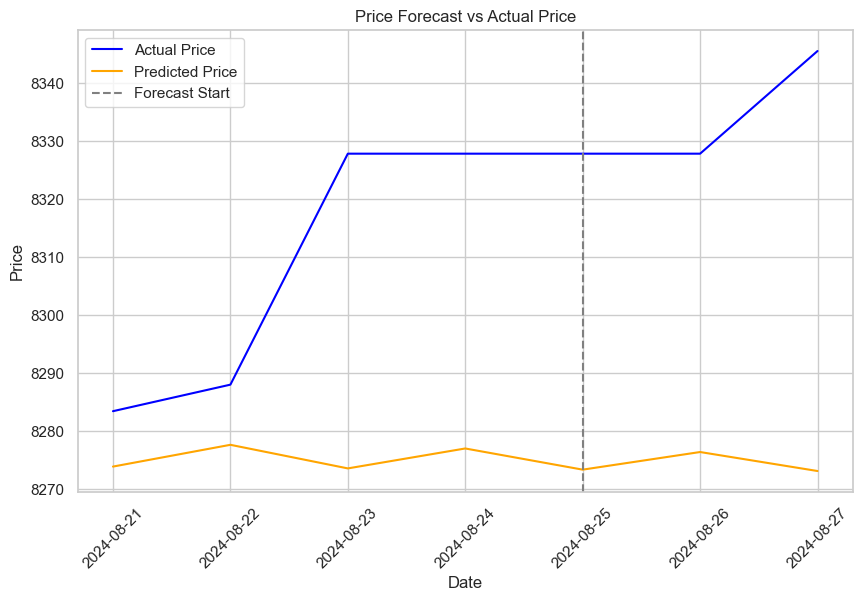

In [1619]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1620]:
import numpy as np
import pandas as pd
from sklearn.metrics import r2_score, mean_squared_error, mean_absolute_error, explained_variance_score, median_absolute_error

In [1621]:
def calculate_metrics_from_df(df, model_name):
    
    # Ensure DataFrame contains required columns
    if not all(col in df.columns for col in ['Price_Forecast', 'Price']):
        raise ValueError("DataFrame must contain 'Price_Forecast' and 'Price' columns.")
    
    # Extract true values and predicted values
    true_values = df['Price'].values
    predicted_values = df['Price_Forecast'].values

    # Calculate metrics
    r2 = r2_score(true_values, predicted_values)
    mae = mean_absolute_error(true_values, predicted_values)
    mse = mean_squared_error(true_values, predicted_values)
    rmse = np.sqrt(mse)
    
    # Calculate Adjusted R²
    n = len(true_values)
    p = 1  # Assuming a simple linear model with 1 predictor; adjust as needed
    adj_r2 = 1 - ((1 - r2) * (n - 1) / (n - p - 1))

    # Calculate MAPE
    mape = np.mean(np.abs((true_values - predicted_values) / true_values)) * 100

    # Calculate SMAPE
    smape = np.mean(np.abs(true_values - predicted_values) / (np.abs(true_values) + np.abs(predicted_values))) * 100

    # Calculate Median Absolute Error
    median_mae = median_absolute_error(true_values, predicted_values)

    # Calculate Explained Variance Score
    evs = explained_variance_score(true_values, predicted_values)

    # Compile results into a dictionary
    metrics = {
        'Model': model_name,
        'R² Score': r2,
        'Adjusted R²': adj_r2,
        'Mean Absolute Error (MAE)': mae,
        'Mean Squared Error (MSE)': mse,
        'Root Mean Squared Error (RMSE)': rmse,
        'Mean Absolute Percentage Error (MAPE)': mape,
        'Symmetric Mean Absolute Percentage Error (SMAPE)': smape,
        'Median Absolute Error': median_mae,
        'Explained Variance Score': evs
    }

    return metrics

In [1622]:
def append_metrics_to_dataframe(df, model_name, metrics_df=None):
    # Calculate metrics for the given DataFrame and model name
    metrics = calculate_metrics_from_df(df, model_name)
    print(metrics)
    # Convert the metrics dictionary to a DataFrame
    metrics_row = pd.DataFrame([metrics])

    # Append to the existing DataFrame or create a new one
    if metrics_df is None:
        metrics_df = metrics_row
    else:
        metrics_df = pd.concat([metrics_df, metrics_row], ignore_index=True)
    
    return metrics_df

In [1623]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'auto_arima_garch')
metrics_df

{'Model': 'auto_arima_garch', 'R² Score': -4.121446054139591, 'Adjusted R²': -5.145735264967509, 'Mean Absolute Error (MAE)': 43.287712433323186, 'Mean Squared Error (MSE)': 2364.0250699310213, 'Root Mean Squared Error (RMSE)': 48.62124093368063, 'Mean Absolute Percentage Error (MAPE)': 0.5197089988613955, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.26070864158033885, 'Median Absolute Error': 51.38366057948224, 'Explained Variance Score': -0.061971753188627465}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2364.02507,48.621241,0.519709,0.260709,51.383661,-0.061972


In [1624]:
all_model =all_model.append(metrics_df)
all_model

,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2364.02507,48.621241,0.519709,0.260709,51.383661,-0.061972


# Exponential Smoothing model only with stocks price

In [1625]:
ets_model = ExponentialSmoothing(
    train_df[target_columns] [:-forecast_duration],  # Target variable
    trend='add',         # 'add' for additive trend, 'mul' for multiplicative, or None for no trend
    seasonal='add',      # 'add' for additive seasonality, 'mul' for multiplicative, or None for no seasonality
    seasonal_periods=12  # Periods for seasonality, e.g., 12 for monthly data with yearly seasonality
)
ets_model_fit = ets_model.fit()


In [1626]:
# Forecast for the length of the test set
forecast = ets_model_fit.forecast(steps=forecast_duration)

future_df = forecast.to_frame().reset_index()
future_df.columns = ['date', 'Price_Forecast']

future_df

,date,Price_Forecast
0,2024-08-21,8276.052269
1,2024-08-22,8283.323244
2,2024-08-23,8294.344350
3,2024-08-24,8303.438176
4,2024-08-25,8316.615934
5,2024-08-26,8320.060771
6,2024-08-27,8330.738556


In [1627]:
merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='ETS'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,8276.052269,8283.43,ETS
1,2024-08-22,8283.323244,8288.00,ETS
2,2024-08-23,8294.344350,8327.78,ETS
3,2024-08-24,8303.438176,8327.78,ETS
4,2024-08-25,8316.615934,8327.78,ETS
5,2024-08-26,8320.060771,8327.78,ETS
6,2024-08-27,8330.738556,8345.46,ETS


In [1628]:
with open('ets_model.pkl', 'wb') as file:
    pickle.dump(ets_model, file)

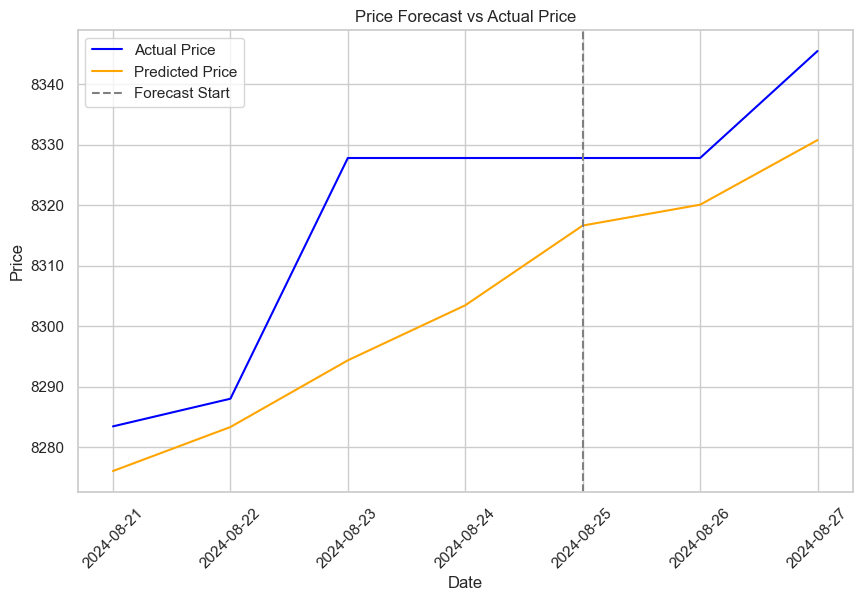

In [1629]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1630]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'ETS')
metrics_df

{'Model': 'ETS', 'R² Score': 0.32293089778638306, 'Adjusted R²': 0.18751707734365974, 'Mean Absolute Error (MAE)': 14.776671496278661, 'Mean Squared Error (MSE)': 312.53054601930853, 'Root Mean Squared Error (RMSE)': 17.67853348044765, 'Mean Absolute Percentage Error (MAPE)': 0.17749106991096028, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.08885836733963128, 'Median Absolute Error': 11.164065919005225, 'Explained Variance Score': 0.7959664273924245}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,ETS,0.322931,0.187517,14.776671,312.530546,17.678533,0.177491,0.088858,11.164066,0.795966


In [1631]:
all_model =all_model.append(metrics_df)
all_model

,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2364.025070,48.621241,0.519709,0.260709,51.383661,-0.061972
0,ETS,0.322931,0.187517,14.776671,312.530546,17.678533,0.177491,0.088858,11.164066,0.795966


# Catboost Regressor Model

In [1632]:
cb_model = CatBoostRegressor()
cb_parameters = {
    'iterations'        : [100, 200, 500, 1000],
    'learning_rate'     : [0.01, 0.05, 0.1],
    'depth'             : [2, 4, 6, 8, 10],
    'l2_leaf_reg'       : [1, 3, 5, 7, 10],
    'model_size_reg'    : [0.1, 0.5, 1.0],
    'early_stopping_rounds': [10, 50],
    'random_strength'   : [0.5, 1.0, 2.0],
    'bagging_temperature': [0.0, 0.5, 1.0],
    'verbose'           : [False]
}

# cb_parameters = {
#     'iterations'    : [100,200],
#     'learning_rate' : [0.01],
#     'depth'         : [2,8],
#     'l2_leaf_reg'   : [2,6],
#     'model_size_reg': [0.5],
    
#     # 'early_stopping_rounds':[10],
#     # 'random_strength' : [0.5,1],
#     # 'random_seed':[42],
#     'verbose' : [False],
# }


In [1633]:
CB_model_GS = grid_search_regression_model(cb_model, X_train, X_test, cb_parameters)
CB_model_GS.best_params_

Fitting 5 folds for each of 16200 candidates, totalling 81000 fits


KeyboardInterrupt: 

In [ ]:
CB_model_GS.best_params_

In [1540]:
import pickle
with open('CB_model_GS.pkl', 'wb') as file:
    pickle.dump(CB_model_GS, file)

In [ ]:
cb_best_model = CB_model_GS.best_estimator_
y_pred_train = cb_best_model.predict(y_train)
y_pred_train

In [ ]:
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

# Display the resulting DataFrame
print(future_df)

In [ ]:
merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='Cat'
all_result = all_result.append(merge_df)
merge_df

In [ ]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'Cat')
metrics_df

In [ ]:
all_model =all_model.append(metrics_df)
all_model

# Linear Regression Model

In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
LR_model = LinearRegression()
LR_parameters = {
    'fit_intercept': [True, False],
    'copy_X': [True, False],
    'n_jobs': [None, -1]  # None for single core, -1 for all available cores
}

# LR_parameters = {'regressor__fit_intercept': [True, False],
# #               'regressor__normalize': [True, False]
#                 }

# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', LR_model)
])

In [ ]:
LR_model_GS = grid_search_regression_model(pipeline,X_train, X_test, LR_parameters)

In [ ]:
LR_model_GS.best_params_

In [1528]:
with open('LR_model_GS.pkl', 'wb') as file:
    pickle.dump(LR_model_GS, file)

In [ ]:
LR_best_model = LR_model_GS.best_estimator_

y_pred_train = LR_best_model.predict(y_train)
y_pred_train

In [ ]:
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

# Display the resulting DataFrame
print(future_df)

In [ ]:
merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='LR'
all_result = all_result.append(merge_df)
merge_df

In [ ]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'LR')
metrics_df

In [ ]:
all_model =all_model.append(metrics_df)
all_model

# # Ridge Model

In [ ]:
ridge_model = Ridge()
# alpha', 'copy_X', 'fit_intercept', 'max_iter', 'normalize', 'positive', 'random_state', 'solver', 'tol'

ridge_parameters = {
    'regressor__alpha' : [0.01, 0.1, 1, 10, 100],
    'regressor__copy_X' : [True, False],
    'regressor__fit_intercept': [True, False],
    'regressor__max_iter' : [100, 1000, 10000],
    'regressor__positive' : [True, False],
    'regressor__solver' : ['auto', 'svd', 'cholesky', 'lsqr', 'sparse_cg', 'sag', 'saga']
}

# ridge_parameters = {
#     'regressor__alpha' : [0.01,0.1,1,10],
#     'regressor__copy_X' : [True],
#     'regressor__fit_intercept':[True],
#     'regressor__max_iter' : [2,10,20],
# #     'regressor__normalize':[False],
#     'regressor__positive' : [True],
# #     'regressor__random_state':[None,42],
#     'regressor__solver' : ['auto']
# }

In [ ]:
# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', ridge_model)
])

In [ ]:
ridge_model_GS = grid_search_regression_model(pipeline,X_train, X_test, ridge_parameters)

In [ ]:
ridge_model_GS.best_params_

In [ ]:
ridge_best_model = ridge_model_GS.best_estimator_

y_pred_train = ridge_best_model.predict(y_train)
y_pred_train

In [1529]:
with open('ridge_model_GS.pkl', 'wb') as file:
    pickle.dump(ridge_model_GS, file)

In [ ]:
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

# Display the resulting DataFrame
print(future_df)

In [ ]:
merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='Ridge'
all_result = all_result.append(merge_df)
merge_df

In [ ]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'Ridge')
all_model =all_model.append(metrics_df)
all_model

# Lasso Model

In [ ]:
lasso_model = Lasso()
# alpha', 'copy_X', 'fit_intercept', 'max_iter', 'normalize', 'positive', 'precompute', 'random_state', 'selection', 'tol', 'warm_start'].
lasso_parameters = {
    'regressor__alpha': [0.001, 0.01, 0.1, 1.0, 10.0],
    'regressor__copy_X': [True, False],
    'regressor__fit_intercept': [True, False],
    'regressor__max_iter': [10, 100, 1000],
    'regressor__positive': [True, False],
    'regressor__precompute': [True, False],
    'regressor__selection': ['cyclic', 'random'],
    'regressor__warm_start': [True, False]
}
# lasso_parameters = {
#      'regressor__alpha': [10, 40],
#     'regressor__copy_X': [True],
#     'regressor__fit_intercept': [True],
#     'regressor__max_iter': [30,  50],
#     'regressor__positive': [True],
#     'regressor__precompute': [True],
# #     'regressor__random_state': [None, 42],
#     'regressor__selection': ['cyclic', 'random'],
#     'regressor__warm_start': [True, False]
# }
# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', lasso_model)
])

In [ ]:
lass_model_GS = grid_search_regression_model(pipeline,X_train, X_test, lasso_parameters)

In [ ]:
lass_model_GS.best_params_

In [1530]:
with open('lass_model_GS.pkl', 'wb') as file:
    pickle.dump(lass_model_GS, file)

In [ ]:
lasso_best_model = lass_model_GS.best_estimator_

y_pred_train = lasso_best_model.predict(y_train)
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='Lasso'
all_result = all_result.append(merge_df)
merge_df

In [ ]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [ ]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'Lasso')
all_model =all_model.append(metrics_df)
all_model

#  Random Forest Regressor Model

In [1257]:
RF_model = RandomForestRegressor(random_state=42, n_jobs=-1)
rf_parameters = {
#     'regressor__n_estimators': [80, 120],
#     'regressor__criterion': ['squared_error', 'absolute_error'],  # Updated valid options
#     'regressor__max_depth': [1, 3],
#     'regressor__max_features': ['sqrt', 'log2', 0.5], 
#     'regressor__max_features': ['auto'],
#     'regressor__min_samples_split': [2, 5],
#     'regressor__warm_start': [True],
#     'regressor__ccp_alpha': [0, 1]
}
start = time.time()

# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', RF_model)
])

In [1258]:
RF_model_GS = grid_search_regression_model(pipeline,X_train, X_test, rf_parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [1531]:
RF_model_GS.best_params_

{}

In [1532]:
with open('RF_model_GS.pkl', 'wb') as file:
    pickle.dump(RF_model_GS, file)

In [1395]:
RF_best_model = RF_model_GS.best_estimator_

y_pred_train = RF_best_model.predict(y_train)
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='RF'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,8321.4639,8283.43,RF
1,2024-08-22,8316.3953,8288.00,RF
2,2024-08-23,8314.4147,8327.78,RF
3,2024-08-24,8313.2763,8327.78,RF
4,2024-08-25,8312.4504,8327.78,RF
5,2024-08-26,8316.6156,8327.78,RF
6,2024-08-27,8305.4698,8345.46,RF


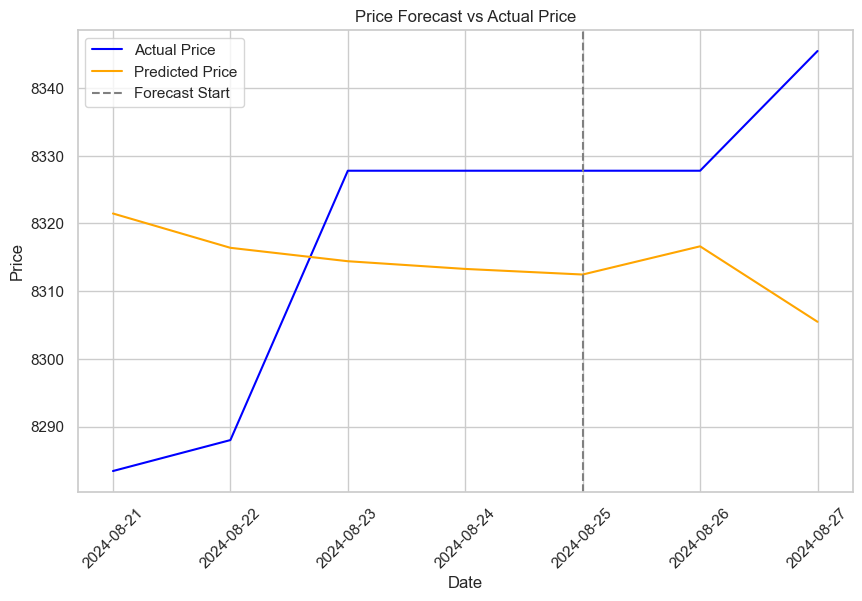

In [1352]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1353]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'RF')
all_model =all_model.append(metrics_df)
all_model

{'Model': 'RF', 'R² Score': -0.42386194959011503, 'Adjusted R²': -0.7086343395081378, 'Mean Absolute Error (MAE)': 22.96891428571767, 'Mean Squared Error (MSE)': 657.2451040914833, 'Root Mean Squared Error (RMSE)': 25.636792000784407, 'Mean Absolute Percentage Error (MAPE)': 0.27624855803175224, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.13812809537843967, 'Median Absolute Error': 15.329600000006394, 'Explained Variance Score': -0.38938731248278846}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2.364025e+03,48.621241,0.519709,0.260709,51.383661,-6.197175e-02
0,ETS,0.322931,0.187517,14.776671,3.125305e+02,17.678533,0.177491,0.088858,11.164066,7.959664e-01
0,Cat,-3820.034950,-4584.241940,1327.893992,1.763764e+06,1328.067787,15.962989,8.673944,1337.386849,-2.220446e-16
0,LR,-1.027270,-1.432724,26.274634,9.357741e+02,30.590425,0.315747,0.158061,20.289254,-7.706574e-01
0,Ridge,-2.897997,-3.677596,37.138190,1.799289e+03,42.418029,0.445881,0.223590,39.327064,9.001270e-02
0,Lasso,-3.688115,-4.625738,44.113795,2.164003e+03,46.518840,0.529920,0.265742,46.798768,5.277756e-01
0,RF,-0.423862,-0.708634,22.968914,6.572451e+02,25.636792,0.276249,0.138128,15.329600,-3.893873e-01


# XGB Regressor Model

In [1263]:
xgb_model = xgb.XGBRegressor(random_state=42, objective='reg:squarederror')
xgb_parameters = {
    'regressor__learning_rate': [0.01,0.1],
#     'regressor__random_state':[42,32],
    # 'booster' : ['gblinear'],
    'regressor__n_estimators' : [10,600], 
    # 'gamma': [ 0.01],
    'regressor__max_depth': [1,7],
    'regressor__subsample': [0.7,0.5],
    'regressor__colsample_bytree': [0.8,1]
}
start = time.time()  
# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', xgb_model)
])

In [1265]:
xgb_model_GS = grid_search_regression_model(pipeline,X_train, X_test, xgb_parameters)

Fitting 5 folds for each of 32 candidates, totalling 160 fits


In [1267]:
xgb_model_GS.best_params_

{'regressor__colsample_bytree': 1,
 'regressor__learning_rate': 0.1,
 'regressor__max_depth': 1,
 'regressor__n_estimators': 600,
 'regressor__subsample': 0.5}

In [1533]:
with open('xgb_model_GS.pkl', 'wb') as file:
    pickle.dump(xgb_model_GS, file)

In [1396]:
xgb_best_model = xgb_model_GS.best_estimator_

y_pred_train = xgb_best_model.predict(y_train)
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='xgb'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,8289.397461,8283.43,xgb
1,2024-08-22,8304.746094,8288.00,xgb
2,2024-08-23,8343.810547,8327.78,xgb
3,2024-08-24,8296.458008,8327.78,xgb
4,2024-08-25,8310.108398,8327.78,xgb
5,2024-08-26,8300.719727,8327.78,xgb
6,2024-08-27,8308.283203,8345.46,xgb


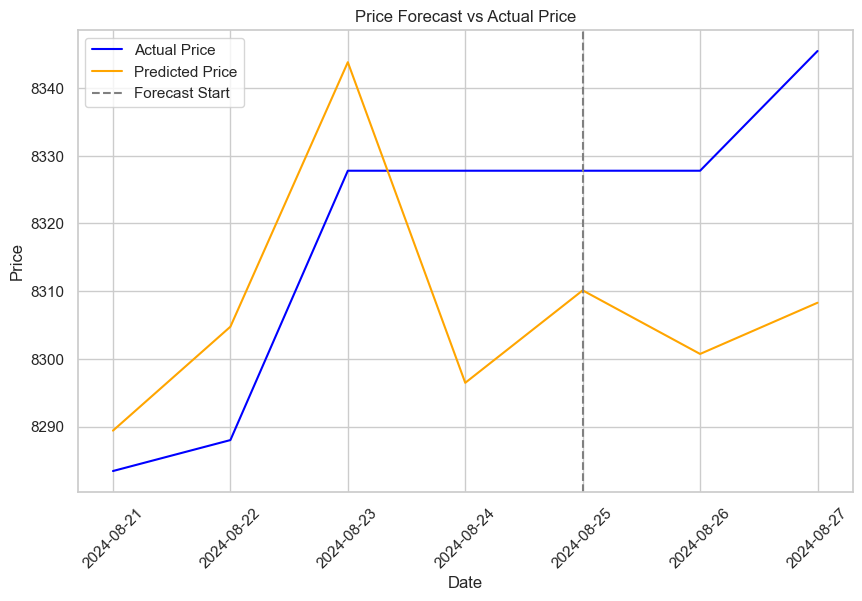

In [1355]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1356]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'xgb')
all_model =all_model.append(metrics_df)
all_model

{'Model': 'xgb', 'R² Score': -0.23198934566398277, 'Adjusted R²': -0.47838721479677937, 'Mean Absolute Error (MAE)': 21.71068080357145, 'Mean Squared Error (MSE)': 568.6779999729716, 'Root Mean Squared Error (RMSE)': 23.846970456914892, 'Mean Absolute Percentage Error (MAPE)': 0.2607594829800557, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.13052562085148867, 'Median Absolute Error': 17.671601562500655, 'Explained Variance Score': 0.013312213924691618}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2.364025e+03,48.621241,0.519709,0.260709,51.383661,-6.197175e-02
0,ETS,0.322931,0.187517,14.776671,3.125305e+02,17.678533,0.177491,0.088858,11.164066,7.959664e-01
0,Cat,-3820.034950,-4584.241940,1327.893992,1.763764e+06,1328.067787,15.962989,8.673944,1337.386849,-2.220446e-16
0,LR,-1.027270,-1.432724,26.274634,9.357741e+02,30.590425,0.315747,0.158061,20.289254,-7.706574e-01
0,Ridge,-2.897997,-3.677596,37.138190,1.799289e+03,42.418029,0.445881,0.223590,39.327064,9.001270e-02
0,Lasso,-3.688115,-4.625738,44.113795,2.164003e+03,46.518840,0.529920,0.265742,46.798768,5.277756e-01
0,RF,-0.423862,-0.708634,22.968914,6.572451e+02,25.636792,0.276249,0.138128,15.329600,-3.893873e-01
0,xgb,-0.231989,-0.478387,21.710681,5.686780e+02,23.846970,0.260759,0.130526,17.671602,1.331221e-02


#  ExtraTreesRegressor Model

In [1274]:
ETR_model = ExtraTreesRegressor()

ETR_parameters = {
#     'regressor__bootstrap':[True], 
#     'regressor__ccp_alpha':[0.001, 1,10], 
#     'regressor__criterion':['mse'],
#     'regressor__max_depth':[2,3,4], 
#     'regressor__max_features':['auto'],
#     'regressor__n_estimators':[90,120],
#     'regressor__min_samples_split':[ 8, 12],
# #     'regressor__random_state':[None,42], 
#     'regressor__verbose':[0],
#      'regressor__warm_start': [True],
}

# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', ETR_model)
])

In [1275]:
ETR_model_GS = grid_search_regression_model(pipeline,X_train, X_test, ETR_parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [1276]:
ETR_model_GS.best_params_

{}

In [1534]:
with open('ETR_model_GS.pkl', 'wb') as file:
    pickle.dump(ETR_model_GS, file)

In [1397]:
ETR_best_model = ETR_model_GS.best_estimator_

y_pred_train = ETR_best_model.predict(y_train)
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='ETR'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,8302.2053,8283.43,ETR
1,2024-08-22,8308.0038,8288.00,ETR
2,2024-08-23,8315.4333,8327.78,ETR
3,2024-08-24,8313.1944,8327.78,ETR
4,2024-08-25,8308.4969,8327.78,ETR
5,2024-08-26,8309.7629,8327.78,ETR
6,2024-08-27,8292.4885,8345.46,ETR


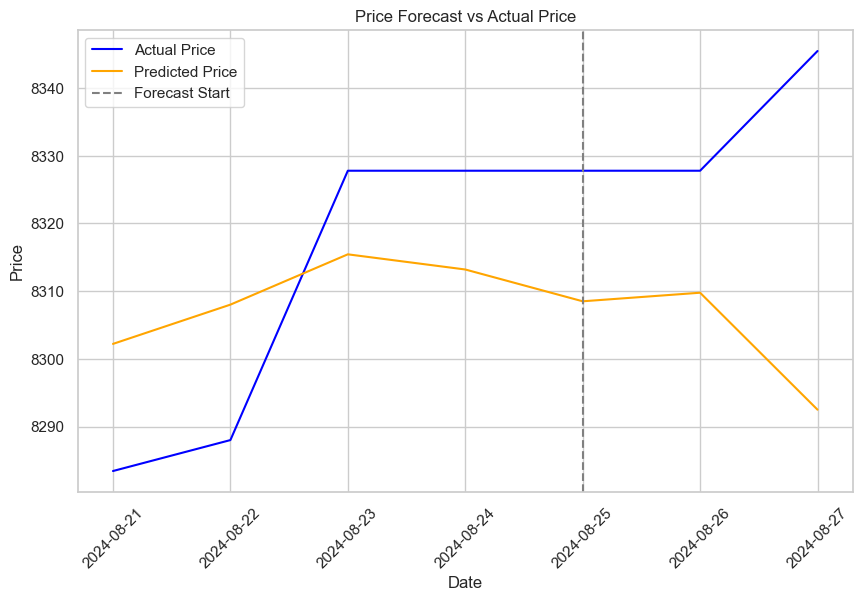

In [1358]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1359]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'ETR')
all_model =all_model.append(metrics_df)
all_model

{'Model': 'ETR', 'R² Score': -0.42991630689121463, 'Adjusted R²': -0.7158995682694573, 'Mean Absolute Error (MAE)': 22.28330000000304, 'Mean Squared Error (MSE)': 660.0397547215628, 'Root Mean Squared Error (RMSE)': 25.691238870898434, 'Mean Absolute Percentage Error (MAPE)': 0.26772255123785377, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.1340212416778659, 'Median Absolute Error': 18.77529999999024, 'Explained Variance Score': -0.15798926904656496}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2.364025e+03,48.621241,0.519709,0.260709,51.383661,-6.197175e-02
0,ETS,0.322931,0.187517,14.776671,3.125305e+02,17.678533,0.177491,0.088858,11.164066,7.959664e-01
0,Cat,-3820.034950,-4584.241940,1327.893992,1.763764e+06,1328.067787,15.962989,8.673944,1337.386849,-2.220446e-16
0,LR,-1.027270,-1.432724,26.274634,9.357741e+02,30.590425,0.315747,0.158061,20.289254,-7.706574e-01
0,Ridge,-2.897997,-3.677596,37.138190,1.799289e+03,42.418029,0.445881,0.223590,39.327064,9.001270e-02
0,Lasso,-3.688115,-4.625738,44.113795,2.164003e+03,46.518840,0.529920,0.265742,46.798768,5.277756e-01
0,RF,-0.423862,-0.708634,22.968914,6.572451e+02,25.636792,0.276249,0.138128,15.329600,-3.893873e-01
0,xgb,-0.231989,-0.478387,21.710681,5.686780e+02,23.846970,0.260759,0.130526,17.671602,1.331221e-02
0,ETR,-0.429916,-0.715900,22.283300,6.600398e+02,25.691239,0.267723,0.134021,18.775300,-1.579893e-01


# LGBMRegressor Model

In [1280]:
lgb_model = lgb.LGBMRegressor()

lgb_parameters = { 
#     'regressor__max_depth':[1,3], 
#     'regressor__n_estimators':[20,30,40],
# #     'regressor__random_state':[None,42], 
#     # 'regressor__verbose':[0],
#     'regressor__force_col_wise':[True],
#     'regressor__class_weight':[None,'balanced'],
#     'regressor__colsample_bytree':[0.5,0.8],
#     'regressor__reg_alpha':[0.1,0.01],
#     # 'regressor__reg_lambda ':[0.1,0.01],
#     "regressor__verbosity": [0]
}
# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', lgb_model)
])

In [1281]:
lgb_model_GS = grid_search_regression_model(pipeline,X_train, X_test, lgb_parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.035282 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 18767
[LightGBM] [Info] Number of data points in the train set: 3691, number of used features: 682
[LightGBM] [Info] Start training from score 7077.868564
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.085139 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 20703
[LightGBM] [Info] Number of data points in the train set: 3691, number of used features: 832
[LightGBM] [Info] Start training from score 6995.057490
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.065967 seconds.
You can set `forc

In [1282]:
lgb_model_GS.best_params_

{}

In [1535]:
with open('lgb_model_GS.pkl', 'wb') as file:
    pickle.dump(lgb_model_GS, file)

In [1398]:
lgb_best_model = lgb_model_GS.best_estimator_

y_pred_train = lgb_best_model.predict(y_train)
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='lgb'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,8330.435040,8283.43,lgb
1,2024-08-22,8316.470327,8288.00,lgb
2,2024-08-23,8334.612619,8327.78,lgb
3,2024-08-24,8308.937361,8327.78,lgb
4,2024-08-25,8306.744657,8327.78,lgb
5,2024-08-26,8310.340437,8327.78,lgb
6,2024-08-27,8297.173471,8345.46,lgb


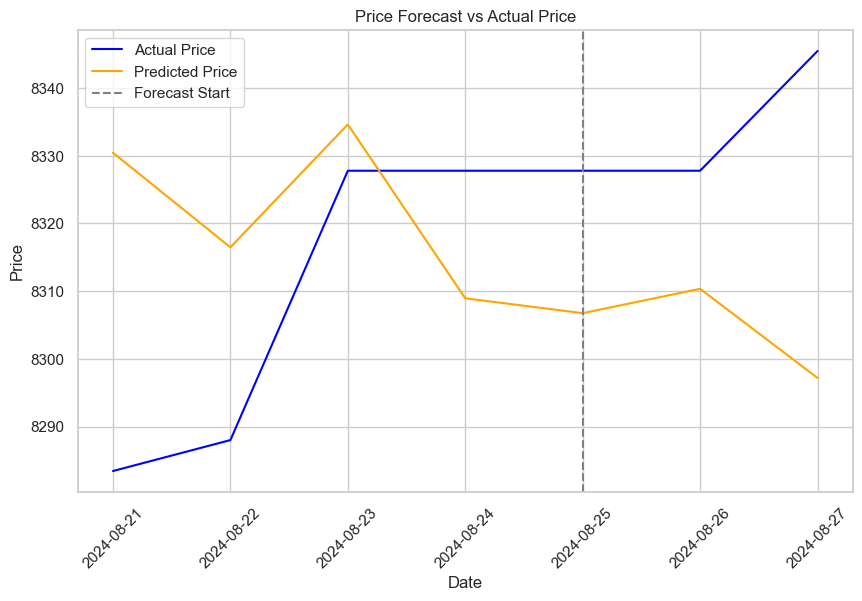

In [1361]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1362]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'lgb')
all_model =all_model.append(metrics_df)
all_model

{'Model': 'lgb', 'R² Score': -1.0116583555184437, 'Adjusted R²': -1.4139900266221326, 'Mean Absolute Error (MAE)': 26.844579702721603, 'Mean Squared Error (MSE)': 928.5679736366491, 'Root Mean Squared Error (RMSE)': 30.472413321505226, 'Mean Absolute Percentage Error (MAPE)': 0.32284041967941, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.16143776555997705, 'Median Absolute Error': 21.03534265745293, 'Explained Variance Score': -0.9876639257459188}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2.364025e+03,48.621241,0.519709,0.260709,51.383661,-6.197175e-02
0,ETS,0.322931,0.187517,14.776671,3.125305e+02,17.678533,0.177491,0.088858,11.164066,7.959664e-01
0,Cat,-3820.034950,-4584.241940,1327.893992,1.763764e+06,1328.067787,15.962989,8.673944,1337.386849,-2.220446e-16
0,LR,-1.027270,-1.432724,26.274634,9.357741e+02,30.590425,0.315747,0.158061,20.289254,-7.706574e-01
0,Ridge,-2.897997,-3.677596,37.138190,1.799289e+03,42.418029,0.445881,0.223590,39.327064,9.001270e-02
0,Lasso,-3.688115,-4.625738,44.113795,2.164003e+03,46.518840,0.529920,0.265742,46.798768,5.277756e-01
0,RF,-0.423862,-0.708634,22.968914,6.572451e+02,25.636792,0.276249,0.138128,15.329600,-3.893873e-01
0,xgb,-0.231989,-0.478387,21.710681,5.686780e+02,23.846970,0.260759,0.130526,17.671602,1.331221e-02
0,ETR,-0.429916,-0.715900,22.283300,6.600398e+02,25.691239,0.267723,0.134021,18.775300,-1.579893e-01
0,lgb,-1.011658,-1.413990,26.844580,9.285680e+02,30.472413,0.322840,0.161438,21.035343,-9.876639e-01


# ElasticNet Model

In [1286]:
es_model = ElasticNet()

# from sklearn.linear_model import ElasticNetCV
# es_model = ElasticNetCV()
es_parameters = {
#  'regressor__alpha' : [0.5,1,2],
#     # 'regressor__cv' : [5],
#     'regressor__warm_start':[True],
#     'regressor__l1_ratio':[0.9,1],
#     'regressor__normalize':[True],
# #     'regressor__random_state':[42],
#     'regressor__fit_intercept':[True],
#     'regressor__positive' : [True],
#     'regressor__precompute' : [True],
#     'regressor__selection' : ['cyclic','random']
}

In [1287]:
es_model_GS = grid_search_regression_model(pipeline,X_train, X_test, es_parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.045150 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 18767
[LightGBM] [Info] Number of data points in the train set: 3691, number of used features: 682
[LightGBM] [Info] Start training from score 7077.868564
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.069577 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 20703
[LightGBM] [Info] Number of data points in the train set: 3691, number of used features: 832
[LightGBM] [Info] Start training from score 6995.057490
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.094470 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not en

In [1288]:
es_model_GS.best_params_

{}

In [1536]:
with open('es_model_GS.pkl', 'wb') as file:
    pickle.dump(es_model_GS, file)

In [1399]:
es_best_model = es_model_GS.best_estimator_

y_pred_train = es_best_model.predict(y_train)
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='es'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,8330.435040,8283.43,es
1,2024-08-22,8316.470327,8288.00,es
2,2024-08-23,8334.612619,8327.78,es
3,2024-08-24,8308.937361,8327.78,es
4,2024-08-25,8306.744657,8327.78,es
5,2024-08-26,8310.340437,8327.78,es
6,2024-08-27,8297.173471,8345.46,es


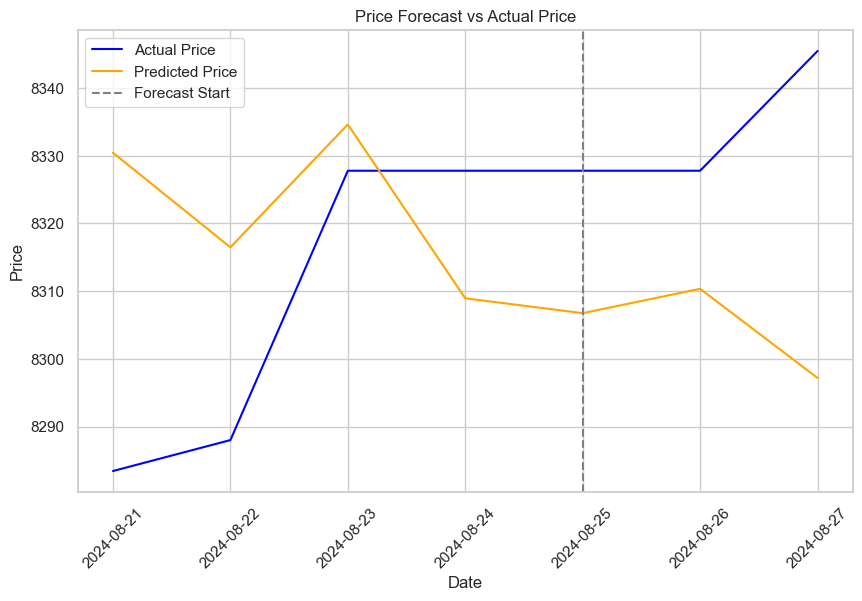

In [1364]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1365]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'es')
all_model =all_model.append(metrics_df)
all_model

{'Model': 'es', 'R² Score': -1.0116583555184437, 'Adjusted R²': -1.4139900266221326, 'Mean Absolute Error (MAE)': 26.844579702721603, 'Mean Squared Error (MSE)': 928.5679736366491, 'Root Mean Squared Error (RMSE)': 30.472413321505226, 'Mean Absolute Percentage Error (MAPE)': 0.32284041967941, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.16143776555997705, 'Median Absolute Error': 21.03534265745293, 'Explained Variance Score': -0.9876639257459188}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2.364025e+03,48.621241,0.519709,0.260709,51.383661,-6.197175e-02
0,ETS,0.322931,0.187517,14.776671,3.125305e+02,17.678533,0.177491,0.088858,11.164066,7.959664e-01
0,Cat,-3820.034950,-4584.241940,1327.893992,1.763764e+06,1328.067787,15.962989,8.673944,1337.386849,-2.220446e-16
0,LR,-1.027270,-1.432724,26.274634,9.357741e+02,30.590425,0.315747,0.158061,20.289254,-7.706574e-01
0,Ridge,-2.897997,-3.677596,37.138190,1.799289e+03,42.418029,0.445881,0.223590,39.327064,9.001270e-02
0,Lasso,-3.688115,-4.625738,44.113795,2.164003e+03,46.518840,0.529920,0.265742,46.798768,5.277756e-01
0,RF,-0.423862,-0.708634,22.968914,6.572451e+02,25.636792,0.276249,0.138128,15.329600,-3.893873e-01
0,xgb,-0.231989,-0.478387,21.710681,5.686780e+02,23.846970,0.260759,0.130526,17.671602,1.331221e-02
0,ETR,-0.429916,-0.715900,22.283300,6.600398e+02,25.691239,0.267723,0.134021,18.775300,-1.579893e-01
0,lgb,-1.011658,-1.413990,26.844580,9.285680e+02,30.472413,0.322840,0.161438,21.035343,-9.876639e-01


#  DecisionTreeRegressor Model

In [1292]:
dt_model = DecisionTreeRegressor()
dt_parameters = {
#     'regressor__ccp_alpha' : [0,0.1,0.01,1,10],
#     'regressor__max_depth': [2,3,4],
#     'regressor__min_samples_split': [2,3,10],
#     'regressor__min_samples_leaf': [1,5,10],
#     'regressor__criterion':['mse','mae','gini'],
#     'regressor__max_features':['auto'],
# #     'regressor__random_state':[None,42]
}
# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', dt_model)
])

In [1293]:
dt_model_GS = grid_search_regression_model(pipeline,X_train, X_test, dt_parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [1294]:
dt_model_GS.best_params_

{}

In [1537]:
with open('dt_model_GS.pkl', 'wb') as file:
    pickle.dump(dt_model_GS, file)

In [1400]:
dt_best_model = dt_model_GS.best_estimator_

y_pred_train = dt_best_model.predict(y_train)
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='dt'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,8317.59,8283.43,dt
1,2024-08-22,8317.59,8288.00,dt
2,2024-08-23,8317.59,8327.78,dt
3,2024-08-24,8317.59,8327.78,dt
4,2024-08-25,8317.59,8327.78,dt
5,2024-08-26,8317.59,8327.78,dt
6,2024-08-27,8317.59,8345.46,dt


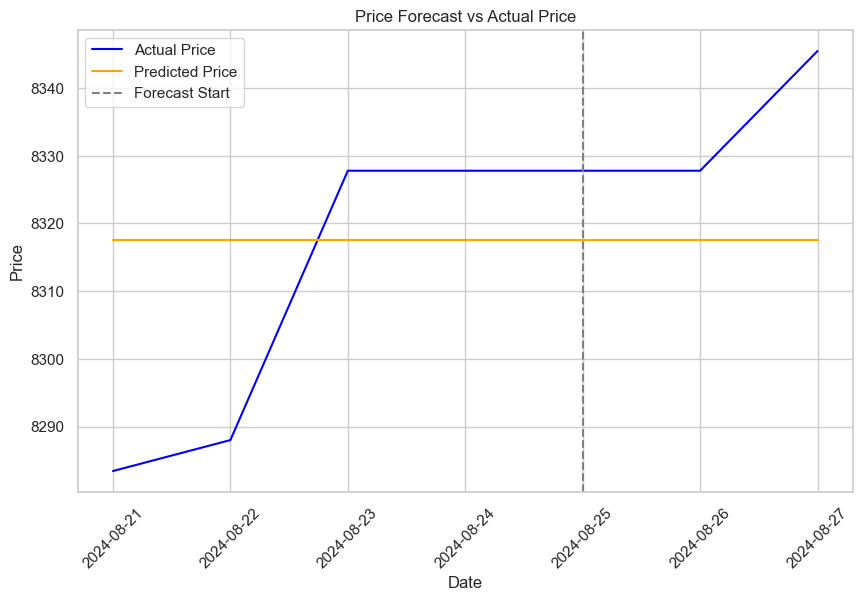

In [1367]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1368]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'dt')
all_model =all_model.append(metrics_df)
all_model

{'Model': 'dt', 'R² Score': -0.0010528926370940717, 'Adjusted R²': -0.20126347116451293, 'Mean Absolute Error (MAE)': 18.91142857142872, 'Mean Squared Error (MSE)': 462.0792857142834, 'Root Mean Squared Error (RMSE)': 21.496029533713507, 'Mean Absolute Percentage Error (MAPE)': 0.22754456448515034, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.11372752687102343, 'Median Absolute Error': 10.19000000000051, 'Explained Variance Score': 0.0}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2.364025e+03,48.621241,0.519709,0.260709,51.383661,-6.197175e-02
0,ETS,0.322931,0.187517,14.776671,3.125305e+02,17.678533,0.177491,0.088858,11.164066,7.959664e-01
0,Cat,-3820.034950,-4584.241940,1327.893992,1.763764e+06,1328.067787,15.962989,8.673944,1337.386849,-2.220446e-16
0,LR,-1.027270,-1.432724,26.274634,9.357741e+02,30.590425,0.315747,0.158061,20.289254,-7.706574e-01
0,Ridge,-2.897997,-3.677596,37.138190,1.799289e+03,42.418029,0.445881,0.223590,39.327064,9.001270e-02
0,Lasso,-3.688115,-4.625738,44.113795,2.164003e+03,46.518840,0.529920,0.265742,46.798768,5.277756e-01
0,RF,-0.423862,-0.708634,22.968914,6.572451e+02,25.636792,0.276249,0.138128,15.329600,-3.893873e-01
0,xgb,-0.231989,-0.478387,21.710681,5.686780e+02,23.846970,0.260759,0.130526,17.671602,1.331221e-02
0,ETR,-0.429916,-0.715900,22.283300,6.600398e+02,25.691239,0.267723,0.134021,18.775300,-1.579893e-01
0,lgb,-1.011658,-1.413990,26.844580,9.285680e+02,30.472413,0.322840,0.161438,21.035343,-9.876639e-01


# SVR MODEL

In [1299]:
from sklearn.svm import SVR

In [1300]:
svr_model = SVR(kernel='rbf')
svr_parameters = {
#     'regressor__C': [0.1, 1, 10, 100],
#               'regressor__epsilon': [0.01, 0.1, 1, 10],
#               'regressor__gamma': ['scale', 'auto']
}
# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', svr_model)
])

In [1301]:
svr_model_GS = grid_search_regression_model(pipeline,X_train, X_test, svr_parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [1302]:
svr_model_GS.best_params_

{}

In [1538]:
with open('svr_model_GS.pkl', 'wb') as file:
    pickle.dump(svr_model_GS, file)

In [1401]:
svr_best_model = svr_model_GS.best_estimator_

y_pred_train = svr_best_model.predict(y_train)
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='svr'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,6942.285954,8283.43,svr
1,2024-08-22,6942.120149,8288.00,svr
2,2024-08-23,6942.328324,8327.78,svr
3,2024-08-24,6942.090954,8327.78,svr
4,2024-08-25,6942.271124,8327.78,svr
5,2024-08-26,6942.235071,8327.78,svr
6,2024-08-27,6942.251385,8345.46,svr


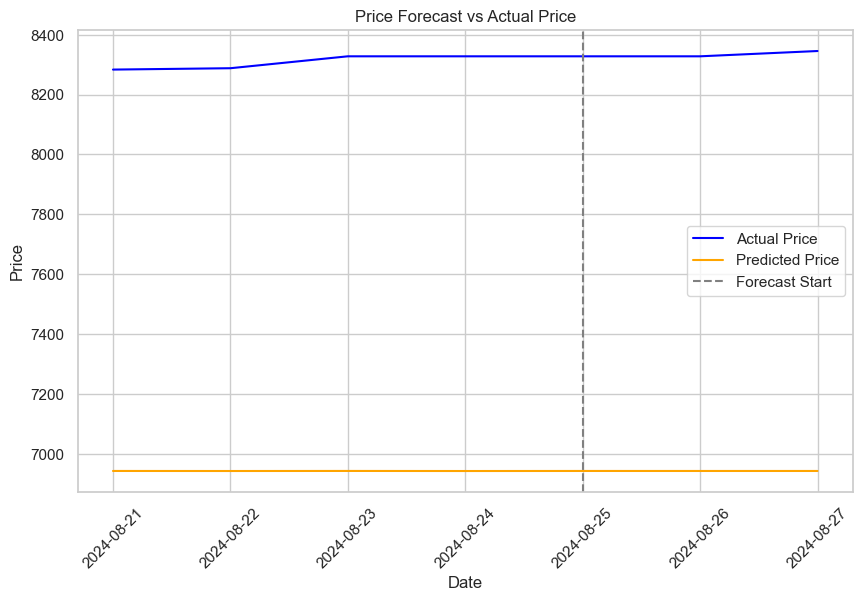

In [1370]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1371]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'svr')
all_model =all_model.append(metrics_df)
all_model

{'Model': 'svr', 'R² Score': -4102.189992425897, 'Adjusted R²': -4922.827990911076, 'Mean Absolute Error (MAE)': 1376.0610056722712, 'Mean Squared Error (MSE)': 1894004.9170184059, 'Root Mean Squared Error (RMSE)': 1376.2285119188623, 'Mean Absolute Percentage Error (MAPE)': 16.542043138392483, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 9.016954004406006, 'Median Absolute Error': 1385.508875964205, 'Explained Variance Score': 0.0012296343027535794}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2.364025e+03,48.621241,0.519709,0.260709,51.383661,-6.197175e-02
0,ETS,0.322931,0.187517,14.776671,3.125305e+02,17.678533,0.177491,0.088858,11.164066,7.959664e-01
0,Cat,-3820.034950,-4584.241940,1327.893992,1.763764e+06,1328.067787,15.962989,8.673944,1337.386849,-2.220446e-16
0,LR,-1.027270,-1.432724,26.274634,9.357741e+02,30.590425,0.315747,0.158061,20.289254,-7.706574e-01
0,Ridge,-2.897997,-3.677596,37.138190,1.799289e+03,42.418029,0.445881,0.223590,39.327064,9.001270e-02
0,Lasso,-3.688115,-4.625738,44.113795,2.164003e+03,46.518840,0.529920,0.265742,46.798768,5.277756e-01
0,RF,-0.423862,-0.708634,22.968914,6.572451e+02,25.636792,0.276249,0.138128,15.329600,-3.893873e-01
0,xgb,-0.231989,-0.478387,21.710681,5.686780e+02,23.846970,0.260759,0.130526,17.671602,1.331221e-02
0,ETR,-0.429916,-0.715900,22.283300,6.600398e+02,25.691239,0.267723,0.134021,18.775300,-1.579893e-01
0,lgb,-1.011658,-1.413990,26.844580,9.285680e+02,30.472413,0.322840,0.161438,21.035343,-9.876639e-01


# GradientBoostingRegressor Model

In [1306]:
from sklearn.ensemble import GradientBoostingRegressor

# Create a Gradient Boosting Regressor object
gb_model = GradientBoostingRegressor()
# Set up the parameter grid to search
gb_parameters = {
#     'regressor__n_estimators': [100,500],
#     'regressor__learning_rate': [ 0.01, 0.1],
#     'regressor__max_depth': [3,5],
#     'regressor__min_samples_split': [2, 10],
#     'regressor__min_samples_leaf': [1,  4],
# #     'regressor__random_state':[None,42],
#     'regressor__max_features' : ['auto'],
#     'regressor__warm_start' : [True]
}
# Final pipeline with preprocessor and regressor
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', gb_model)
])

In [1307]:
gb_model_GS = grid_search_regression_model(pipeline,X_train, X_test, gb_parameters)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


In [1308]:
gb_model_GS.best_params_

{}

In [1539]:
with open('gb_model_GS.pkl', 'wb') as file:
    pickle.dump(gb_model_GS, file)

In [1402]:
gb_best_model = gb_model_GS.best_estimator_

y_pred_train = gb_best_model.predict(y_train)
# Convert the array to a DataFrame
df_predicted = pd.DataFrame(y_pred_train, columns=['yhat'])

# Generate future dates starting from the day after the last date in the original DataFrame
forecast_duration = len(y_pred_train)  # Set forecast_duration to match the length of the forecasted values
future_dates = pd.date_range(start=Xtrain_df.date.max() + timedelta(days=1), periods=forecast_duration, freq='D')

# Create DataFrame for future dates
future_df = pd.DataFrame({'date': future_dates})

# Prepare the final forecast DataFrame
future_df['Price_Forecast'] = df_predicted['yhat'].values

merge_df = pd.merge(future_df,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
merge_df['model'] ='gb'
all_result = all_result.append(merge_df)
merge_df

,date,Price_Forecast,Price,model
0,2024-08-21,8304.130139,8283.43,gb
1,2024-08-22,8319.254592,8288.00,gb
2,2024-08-23,8322.782514,8327.78,gb
3,2024-08-24,8306.496059,8327.78,gb
4,2024-08-25,8307.110695,8327.78,gb
5,2024-08-26,8322.259236,8327.78,gb
6,2024-08-27,8288.878870,8345.46,gb


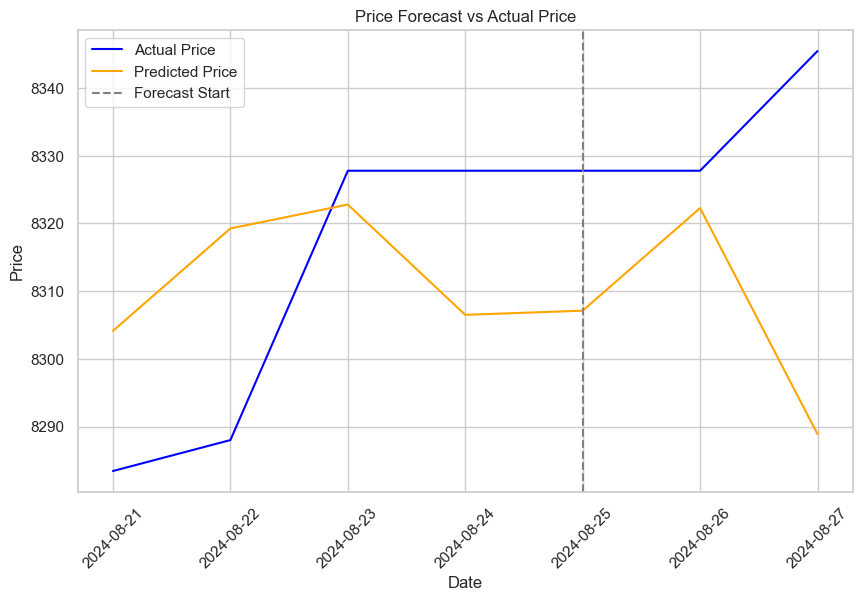

In [1373]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(merge_df['date'], merge_df['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(merge_df['date'], merge_df['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=merge_df['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1374]:
# Calculate and append metrics
metrics_df = append_metrics_to_dataframe(merge_df, 'gb')
all_model =all_model.append(metrics_df)
all_model

{'Model': 'gb', 'R² Score': -0.7153163937564673, 'Adjusted R²': -1.058379672507761, 'Mean Absolute Error (MAE)': 23.001051055877856, 'Mean Squared Error (MSE)': 791.77851623104, 'Root Mean Squared Error (RMSE)': 28.13855924227536, 'Mean Absolute Percentage Error (MAPE)': 0.2764385022555038, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.13835925016800066, 'Median Absolute Error': 20.700139478227356, 'Explained Variance Score': -0.571176352674899}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,auto_arima_garch,-4.121446,-5.145735,43.287712,2.364025e+03,48.621241,0.519709,0.260709,51.383661,-6.197175e-02
0,ETS,0.322931,0.187517,14.776671,3.125305e+02,17.678533,0.177491,0.088858,11.164066,7.959664e-01
0,Cat,-3820.034950,-4584.241940,1327.893992,1.763764e+06,1328.067787,15.962989,8.673944,1337.386849,-2.220446e-16
0,LR,-1.027270,-1.432724,26.274634,9.357741e+02,30.590425,0.315747,0.158061,20.289254,-7.706574e-01
0,Ridge,-2.897997,-3.677596,37.138190,1.799289e+03,42.418029,0.445881,0.223590,39.327064,9.001270e-02
0,Lasso,-3.688115,-4.625738,44.113795,2.164003e+03,46.518840,0.529920,0.265742,46.798768,5.277756e-01
0,RF,-0.423862,-0.708634,22.968914,6.572451e+02,25.636792,0.276249,0.138128,15.329600,-3.893873e-01
0,xgb,-0.231989,-0.478387,21.710681,5.686780e+02,23.846970,0.260759,0.130526,17.671602,1.331221e-02
0,ETR,-0.429916,-0.715900,22.283300,6.600398e+02,25.691239,0.267723,0.134021,18.775300,-1.579893e-01
0,lgb,-1.011658,-1.413990,26.844580,9.285680e+02,30.472413,0.322840,0.161438,21.035343,-9.876639e-01


In [1375]:
all_model_copy = all_model.copy()

In [1404]:
all_result_copy = all_result.copy()
all_result

,date,Price_Forecast,Price,model
0,2024-08-21,8273.889382,8283.43,auto_arima_garch
1,2024-08-22,8277.639244,8288.00,auto_arima_garch
2,2024-08-23,8273.575778,8327.78,auto_arima_garch
3,2024-08-24,8277.008316,8327.78,auto_arima_garch
4,2024-08-25,8273.361635,8327.78,auto_arima_garch
...,...,...,...,...
2,2024-08-23,8322.782514,8327.78,gb
3,2024-08-24,8306.496059,8327.78,gb
4,2024-08-25,8307.110695,8327.78,gb
5,2024-08-26,8322.259236,8327.78,gb


# Select Top 3 Model

In [1377]:
all_model = all_model.sort_values(by=['Root Mean Squared Error (RMSE)','Mean Absolute Percentage Error (MAPE)'])
all_model = all_model.sort_values(by=['R² Score'], ascending=False)
all_model

,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,ETS,0.322931,0.187517,14.776671,3.125305e+02,17.678533,0.177491,0.088858,11.164066,7.959664e-01
0,dt,-0.001053,-0.201263,18.911429,4.620793e+02,21.496030,0.227545,0.113728,10.190000,0.000000e+00
0,xgb,-0.231989,-0.478387,21.710681,5.686780e+02,23.846970,0.260759,0.130526,17.671602,1.331221e-02
0,RF,-0.423862,-0.708634,22.968914,6.572451e+02,25.636792,0.276249,0.138128,15.329600,-3.893873e-01
0,ETR,-0.429916,-0.715900,22.283300,6.600398e+02,25.691239,0.267723,0.134021,18.775300,-1.579893e-01
0,gb,-0.715316,-1.058380,23.001051,7.917785e+02,28.138559,0.276439,0.138359,20.700139,-5.711764e-01
0,lgb,-1.011658,-1.413990,26.844580,9.285680e+02,30.472413,0.322840,0.161438,21.035343,-9.876639e-01
0,es,-1.011658,-1.413990,26.844580,9.285680e+02,30.472413,0.322840,0.161438,21.035343,-9.876639e-01
0,LR,-1.027270,-1.432724,26.274634,9.357741e+02,30.590425,0.315747,0.158061,20.289254,-7.706574e-01
0,Ridge,-2.897997,-3.677596,37.138190,1.799289e+03,42.418029,0.445881,0.223590,39.327064,9.001270e-02


In [1407]:
# Select the top 3 models based on R² Score
top_3_models = all_model.sort_values(by='R² Score', ascending=False).head(3)
top_3_models['Weight'] = top_3_models['R² Score'] / top_3_models['R² Score'].sum()
top_3_models

,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score,Weight
0,ETS,0.322931,0.187517,14.776671,312.530546,17.678533,0.177491,0.088858,11.164066,0.795966,3.592566
0,dt,-0.001053,-0.201263,18.911429,462.079286,21.496030,0.227545,0.113728,10.190000,0.000000,-0.011713
0,xgb,-0.231989,-0.478387,21.710681,568.678000,23.846970,0.260759,0.130526,17.671602,0.013312,-2.580852


In [1409]:
top_3_forecasts = all_result[all_result['model'].isin(top_3_models['Model'])]
top_3_forecasts

,date,Price_Forecast,Price,model
0,2024-08-21,8276.052269,8283.43,ETS
1,2024-08-22,8283.323244,8288.00,ETS
2,2024-08-23,8294.344350,8327.78,ETS
3,2024-08-24,8303.438176,8327.78,ETS
4,2024-08-25,8316.615934,8327.78,ETS
5,2024-08-26,8320.060771,8327.78,ETS
6,2024-08-27,8330.738556,8345.46,ETS
0,2024-08-21,8289.397461,8283.43,xgb
1,2024-08-22,8304.746094,8288.00,xgb
2,2024-08-23,8343.810547,8327.78,xgb


In [1410]:
weighted_forecasts = pd.merge(top_3_forecasts, top_3_models[['Model', 'Weight']], left_on='model', right_on='Model', how='left')
weighted_forecasts

,date,Price_Forecast,Price,model,Model,Weight
0,2024-08-21,8276.052269,8283.43,ETS,ETS,3.592566
1,2024-08-22,8283.323244,8288.00,ETS,ETS,3.592566
2,2024-08-23,8294.344350,8327.78,ETS,ETS,3.592566
3,2024-08-24,8303.438176,8327.78,ETS,ETS,3.592566
4,2024-08-25,8316.615934,8327.78,ETS,ETS,3.592566
5,2024-08-26,8320.060771,8327.78,ETS,ETS,3.592566
6,2024-08-27,8330.738556,8345.46,ETS,ETS,3.592566
7,2024-08-21,8289.397461,8283.43,xgb,xgb,-2.580852
8,2024-08-22,8304.746094,8288.00,xgb,xgb,-2.580852
9,2024-08-23,8343.810547,8327.78,xgb,xgb,-2.580852


In [1411]:
weighted_forecasts['Weighted_Price_Forecast'] = weighted_forecasts['Price_Forecast'] * weighted_forecasts['Weight']
weighted_forecasts

,date,Price_Forecast,Price,model,Model,Weight,Weighted_Price_Forecast
0,2024-08-21,8276.052269,8283.43,ETS,ETS,3.592566,29732.259937
1,2024-08-22,8283.323244,8288.00,ETS,ETS,3.592566,29758.381391
2,2024-08-23,8294.344350,8327.78,ETS,ETS,3.592566,29797.975438
3,2024-08-24,8303.438176,8327.78,ETS,ETS,3.592566,29830.645605
4,2024-08-25,8316.615934,8327.78,ETS,ETS,3.592566,29877.987563
5,2024-08-26,8320.060771,8327.78,ETS,ETS,3.592566,29890.363366
6,2024-08-27,8330.738556,8345.46,ETS,ETS,3.592566,29928.724007
7,2024-08-21,8289.397461,8283.43,xgb,xgb,-2.580852,-21393.709773
8,2024-08-22,8304.746094,8288.00,xgb,xgb,-2.580852,-21433.322326
9,2024-08-23,8343.810547,8327.78,xgb,xgb,-2.580852,-21534.141906


In [1416]:
final_forecast = weighted_forecasts.groupby('date').agg({'Weighted_Price_Forecast': 'sum'}).reset_index()
final_forecast

,date,Weighted_Price_Forecast
0,2024-08-21,8241.123755
1,2024-08-22,8227.632656
2,2024-08-23,8166.407123
3,2024-08-24,8321.287195
4,2024-08-25,8333.399512
5,2024-08-26,8370.006090
6,2024-08-27,8388.846516


In [1425]:
final_result = pd.merge(final_forecast,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
final_result = final_result.rename(columns= {'Weighted_Price_Forecast':'Price_Forecast'})
final_result

,date,Price_Forecast,Price
0,2024-08-21,8241.123755,8283.43
1,2024-08-22,8227.632656,8288.00
2,2024-08-23,8166.407123,8327.78
3,2024-08-24,8321.287195,8327.78
4,2024-08-25,8333.399512,8327.78
5,2024-08-26,8370.006090,8327.78
6,2024-08-27,8388.846516,8345.46


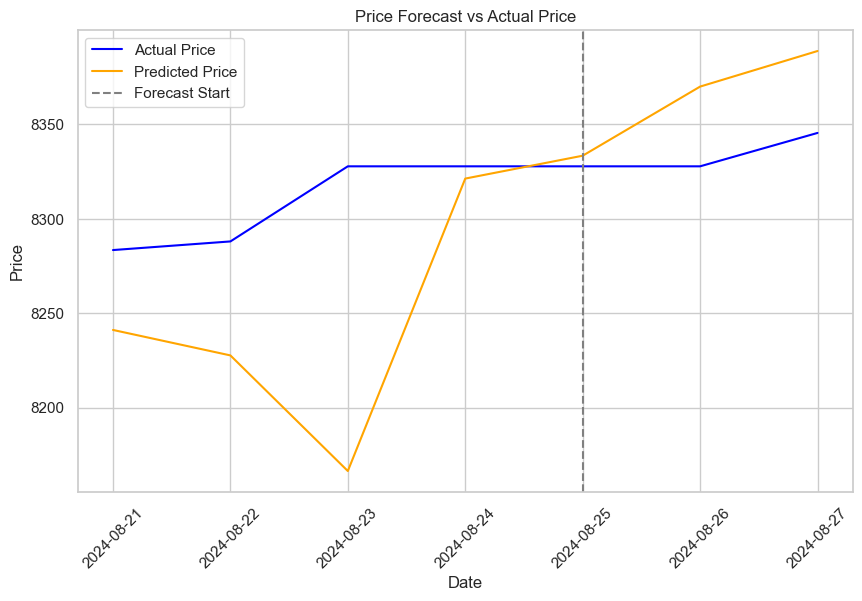

In [1426]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(final_result['date'], final_result['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(final_result['date'], final_result['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=final_result['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1427]:
metrics_df = append_metrics_to_dataframe(final_result, 'Final')
metrics_df

{'Model': 'Final', 'R² Score': -9.898403253581384, 'Adjusted R²': -12.07808390429766, 'Mean Absolute Error (MAE)': 51.68162681972314, 'Mean Squared Error (MSE)': 5030.629677893307, 'Root Mean Squared Error (RMSE)': 70.9269319644753, 'Mean Absolute Percentage Error (MAPE)': 0.6213210118031184, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.3121109183560125, 'Median Absolute Error': 42.30624457102567, 'Explained Variance Score': -8.47692679978178}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,Final,-9.898403,-12.078084,51.681627,5030.629678,70.926932,0.621321,0.312111,42.306245,-8.476927


# Select top 5 Models

In [1429]:
# Select the top 3 models based on R² Score
top_5_models = all_model.sort_values(by='R² Score', ascending=False).head(5)
top_5_models['Weight'] = top_5_models['R² Score'] / top_5_models['R² Score'].sum()
top_5_forecasts = all_result[all_result['model'].isin(top_5_models['Model'])]
weighted_forecasts = pd.merge(top_5_forecasts, top_5_models[['Model', 'Weight']], left_on='model', right_on='Model', how='left')
weighted_forecasts['Weighted_Price_Forecast'] = weighted_forecasts['Price_Forecast'] * weighted_forecasts['Weight']
weighted_forecasts

,date,Price_Forecast,Price,model,Model,Weight,Weighted_Price_Forecast
0,2024-08-21,8276.052269,8283.43,ETS,ETS,-0.422746,-3498.663943
1,2024-08-22,8283.323244,8288.00,ETS,ETS,-0.422746,-3501.737715
2,2024-08-23,8294.344350,8327.78,ETS,ETS,-0.422746,-3506.396838
3,2024-08-24,8303.438176,8327.78,ETS,ETS,-0.422746,-3510.241212
4,2024-08-25,8316.615934,8327.78,ETS,ETS,-0.422746,-3515.812050
5,2024-08-26,8320.060771,8327.78,ETS,ETS,-0.422746,-3517.268340
6,2024-08-27,8330.738556,8345.46,ETS,ETS,-0.422746,-3521.782325
7,2024-08-21,8321.463900,8283.43,RF,RF,0.554873,4617.358223
8,2024-08-22,8316.395300,8288.00,RF,RF,0.554873,4614.545792
9,2024-08-23,8314.414700,8327.78,RF,RF,0.554873,4613.446810


In [1430]:
final_forecast = weighted_forecasts.groupby('date').agg({'Weighted_Price_Forecast': 'sum'}).reset_index()
final_result = pd.merge(final_forecast,test_df[[target_columns,'date']][-forecast_duration:],on='date',how='inner')
final_result = final_result.rename(columns= {'Weighted_Price_Forecast':'Price_Forecast'})
final_result

,date,Price_Forecast,Price
0,2024-08-21,8320.078990,8283.43
1,2024-08-22,8322.117478,8288.00
2,2024-08-23,8332.404362,8327.78
3,2024-08-24,8312.287546,8327.78
4,2024-08-25,8307.760244,8327.78
5,2024-08-26,8306.476325,8327.78
6,2024-08-27,8288.352806,8345.46


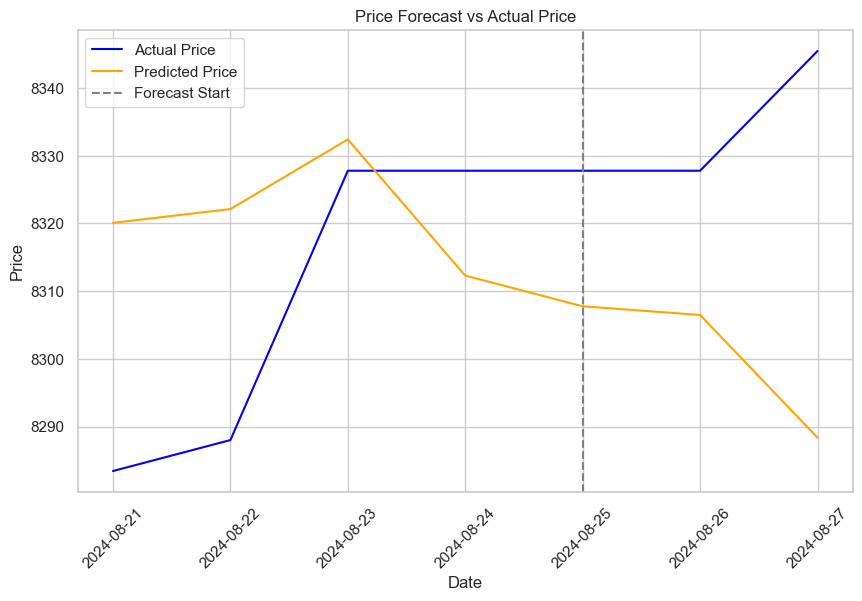

In [1431]:
plt.figure(figsize=(10, 6))

# Plot the actual prices
plt.plot(final_result['date'], final_result['Price'], label='Actual Price', color='blue')

# Plot the forecasted prices
plt.plot(final_result['date'], final_result['Price_Forecast'], label='Predicted Price', color='orange')

# Highlight the forecast with a different color or line style
plt.axvline(x=final_result['date'].iloc[len(merge_df)-3], color='gray', linestyle='--', label='Forecast Start')

plt.legend(loc='best')
plt.title('Price Forecast vs Actual Price')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.show()

In [1432]:
metrics_df = append_metrics_to_dataframe(final_result, 'Final')
metrics_df

{'Model': 'Final', 'R² Score': -1.130639006536763, 'Adjusted R²': -1.5567668078441157, 'Mean Absolute Error (MAE)': 27.044844262466672, 'Mean Squared Error (MSE)': 983.4886423053491, 'Root Mean Squared Error (RMSE)': 31.36062247955785, 'Mean Absolute Percentage Error (MAPE)': 0.32516452208036356, 'Symmetric Mean Absolute Percentage Error (SMAPE)': 0.16267525347019823, 'Median Absolute Error': 21.30367543997272, 'Explained Variance Score': -1.0649952867026622}


,Model,R² Score,Adjusted R²,Mean Absolute Error (MAE),Mean Squared Error (MSE),Root Mean Squared Error (RMSE),Mean Absolute Percentage Error (MAPE),Symmetric Mean Absolute Percentage Error (SMAPE),Median Absolute Error,Explained Variance Score
0,Final,-1.130639,-1.556767,27.044844,983.488642,31.360622,0.325165,0.162675,21.303675,-1.064995


# Retrain Model

In [1541]:
all_model_name = ['arima_model','ets_model','CB_model_GS','LR_model_GS','ridge_model_GS',
'lass_model_GS','RF_model_GS','xgb_model_GS','ETR_model_GS','lgb_model_GS','es_model_GS',
                  'dt_model_GS','svr_model_GS','gb_model_GS']

In [ ]:
# Load the model from the file
with open('rf_model.pkl', 'rb') as file:
    loaded_RF_model = pickle.load(file)

In [ ]:
loaded_RF_model.fit(X_new_train, y_new_train)